In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-18 03:54:36,833] A new study created in memory with name: no-name-692477f7-a5f0-425a-9ce7-ba1e9848fc92
[I 2025-05-18 04:00:37,533] Trial 0 finished with value: 0.06488744765520096 and parameters: {'lr': 0.00801727458178656, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.10252820208043022}. Best is trial 0 with value: 0.06488744765520096.


Cross Validation Accuracies:
[0.06019195541739464, 0.061817169189453125, 0.0721374899148941, 0.07304466515779495, 0.05724595859646797]
Mean Cross Validation Accuracy:
0.06488744765520096
Standard Deviation of Cross Validation Accuracy:
0.006464826716923393


[I 2025-05-18 04:09:30,070] Trial 1 finished with value: 0.06393875628709793 and parameters: {'lr': 0.13158563021174108, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2938029134630171}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.05883675441145897, 0.060913875699043274, 0.0709260031580925, 0.07119683176279068, 0.05782031640410423]
Mean Cross Validation Accuracy:
0.06393875628709793
Standard Deviation of Cross Validation Accuracy:
0.00590113397170234


[I 2025-05-18 04:20:37,157] Trial 2 finished with value: 0.30140066146850586 and parameters: {'lr': 0.0500160612937509, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.31024117164203546}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.283568799495697, 0.30750179290771484, 0.2621842622756958, 0.3263455331325531, 0.32740291953086853]
Mean Cross Validation Accuracy:
0.30140066146850586
Standard Deviation of Cross Validation Accuracy:
0.025264556669702856


[I 2025-05-18 04:28:55,719] Trial 3 finished with value: 0.2535289883613586 and parameters: {'lr': 0.04697932180815393, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.45345623425602544}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.2839319407939911, 0.21912997961044312, 0.27953779697418213, 0.26755961775779724, 0.21748560667037964]
Mean Cross Validation Accuracy:
0.2535289883613586
Standard Deviation of Cross Validation Accuracy:
0.029257728449443104


[I 2025-05-18 04:40:51,165] Trial 4 finished with value: 0.14275347143411637 and parameters: {'lr': 0.9604838376072142, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.19692100870027718}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.17552146315574646, 0.3032127320766449, 0.08136873692274094, 0.08393246680498123, 0.06973195821046829]
Mean Cross Validation Accuracy:
0.14275347143411637
Standard Deviation of Cross Validation Accuracy:
0.08874801768772068


[I 2025-05-18 04:49:45,687] Trial 5 finished with value: 0.49722005128860475 and parameters: {'lr': 0.0010957147065260317, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3220897635759461}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.5003769397735596, 0.5013766288757324, 0.4949047267436981, 0.4906403720378876, 0.498801589012146]
Mean Cross Validation Accuracy:
0.49722005128860475
Standard Deviation of Cross Validation Accuracy:
0.003959728538821865


[I 2025-05-18 04:57:07,826] Trial 6 finished with value: 0.06433831751346589 and parameters: {'lr': 0.14887665650653242, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.12982545584058972}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.06032436713576317, 0.06119658052921295, 0.07177704572677612, 0.0710480809211731, 0.05734551325440407]
Mean Cross Validation Accuracy:
0.06433831751346589
Standard Deviation of Cross Validation Accuracy:
0.00592008822125718


[I 2025-05-18 05:06:44,162] Trial 7 finished with value: 0.11495335698127747 and parameters: {'lr': 0.1890698277139123, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.22531817159274856}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.090273417532444, 0.11497264355421066, 0.11798522621393204, 0.12201332300901413, 0.1295221745967865]
Mean Cross Validation Accuracy:
0.11495335698127747
Standard Deviation of Cross Validation Accuracy:
0.01326940527107874


[I 2025-05-18 05:14:56,141] Trial 8 finished with value: 0.1783688485622406 and parameters: {'lr': 0.02784259571537621, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10702948900808412}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.19527529180049896, 0.1761663258075714, 0.157612144947052, 0.1758526861667633, 0.18693779408931732]
Mean Cross Validation Accuracy:
0.1783688485622406
Standard Deviation of Cross Validation Accuracy:
0.0126592067292425


[I 2025-05-18 05:24:59,156] Trial 9 finished with value: 0.06500025540590286 and parameters: {'lr': 0.03415488154115198, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4349695749875848}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.05933860316872597, 0.061472728848457336, 0.07245254516601562, 0.07318954169750214, 0.05854785814881325]
Mean Cross Validation Accuracy:
0.06500025540590286
Standard Deviation of Cross Validation Accuracy:
0.006461148700749249


[I 2025-05-18 05:37:25,889] Trial 10 finished with value: 9.370652866363525 and parameters: {'lr': 0.8565908030837033, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.39127297897271834}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[10.642868041992188, 8.26563549041748, 7.123755931854248, 13.665807723999023, 7.1551971435546875]
Mean Cross Validation Accuracy:
9.370652866363525
Standard Deviation of Cross Validation Accuracy:
2.49978959111946


[I 2025-05-18 05:45:50,966] Trial 11 finished with value: 0.061994298547506335 and parameters: {'lr': 0.22106824221608912, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.19845655029850248}. Best is trial 11 with value: 0.061994298547506335.


Cross Validation Accuracies:
[0.05395164713263512, 0.060077592730522156, 0.07071290910243988, 0.06883659213781357, 0.05639275163412094]
Mean Cross Validation Accuracy:
0.061994298547506335
Standard Deviation of Cross Validation Accuracy:
0.006671828570600514


[I 2025-05-18 05:54:35,633] Trial 12 finished with value: 0.06410023495554924 and parameters: {'lr': 0.22622985105858928, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24072417902620288}. Best is trial 11 with value: 0.061994298547506335.


Cross Validation Accuracies:
[0.05970020592212677, 0.05866717919707298, 0.07112358510494232, 0.07133574783802032, 0.0596744567155838]
Mean Cross Validation Accuracy:
0.06410023495554924
Standard Deviation of Cross Validation Accuracy:
0.005833454506420859


[I 2025-05-18 06:03:02,052] Trial 13 finished with value: 0.061559805274009706 and parameters: {'lr': 0.3304007944567223, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2567095094631814}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05849524587392807, 0.055294349789619446, 0.06804665923118591, 0.06731032580137253, 0.058652445673942566]
Mean Cross Validation Accuracy:
0.061559805274009706
Standard Deviation of Cross Validation Accuracy:
0.005142916627458801


[I 2025-05-18 06:13:39,455] Trial 14 finished with value: 0.06840882748365402 and parameters: {'lr': 0.4909274149965699, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1792308674074777}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06224217265844345, 0.059286557137966156, 0.07441384345293045, 0.07863079756498337, 0.06747076660394669]
Mean Cross Validation Accuracy:
0.06840882748365402
Standard Deviation of Cross Validation Accuracy:
0.00724806588466197


[I 2025-05-18 06:21:42,817] Trial 15 finished with value: 0.06963286101818085 and parameters: {'lr': 0.33418686193578445, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27062688051831957}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05774645507335663, 0.06525787711143494, 0.07408589869737625, 0.08334872871637344, 0.06772534549236298]
Mean Cross Validation Accuracy:
0.06963286101818085
Standard Deviation of Cross Validation Accuracy:
0.008625779005253166


[I 2025-05-18 06:29:18,493] Trial 16 finished with value: 0.21307488679885864 and parameters: {'lr': 0.009428969536125025, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36205631274576616}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.1730850487947464, 0.2433355748653412, 0.21310682594776154, 0.21669143438339233, 0.21915555000305176]
Mean Cross Validation Accuracy:
0.21307488679885864
Standard Deviation of Cross Validation Accuracy:
0.02264928823338763


[I 2025-05-18 06:38:40,016] Trial 17 finished with value: 8.489998054504394 and parameters: {'lr': 0.09244045975959028, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4995040169226376}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[8.247876167297363, 8.736071586608887, 8.580724716186523, 8.051109313964844, 8.834208488464355]
Mean Cross Validation Accuracy:
8.489998054504394
Standard Deviation of Cross Validation Accuracy:
0.296145460213847


[I 2025-05-18 06:48:00,995] Trial 18 finished with value: 0.06585060432553291 and parameters: {'lr': 0.4935625644101535, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.1744864945440218}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06573284417390823, 0.05909930169582367, 0.07291814684867859, 0.07293759286403656, 0.058565136045217514]
Mean Cross Validation Accuracy:
0.06585060432553291
Standard Deviation of Cross Validation Accuracy:
0.006306307423144955


[I 2025-05-18 06:59:17,715] Trial 19 finished with value: 0.0649413950741291 and parameters: {'lr': 0.010858433567081903, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2540192116263679}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058840855956077576, 0.06119191274046898, 0.0723644569516182, 0.07323139905929565, 0.05907835066318512]
Mean Cross Validation Accuracy:
0.0649413950741291
Standard Deviation of Cross Validation Accuracy:
0.006472657858671613


[I 2025-05-18 07:07:48,157] Trial 20 finished with value: 6.237134027481079 and parameters: {'lr': 0.08599680401094942, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21349045814864656}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[5.787493705749512, 7.133525371551514, 6.972131252288818, 7.8503193855285645, 3.4422004222869873]
Mean Cross Validation Accuracy:
6.237134027481079
Standard Deviation of Cross Validation Accuracy:
1.5466050328373036


[I 2025-05-18 07:18:56,857] Trial 21 finished with value: 0.06368011385202407 and parameters: {'lr': 0.08933658292565541, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2866402509437086}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.057796660810709, 0.0610058568418026, 0.07158569246530533, 0.07097874581813812, 0.057033613324165344]
Mean Cross Validation Accuracy:
0.06368011385202407
Standard Deviation of Cross Validation Accuracy:
0.0063515484930913736


[I 2025-05-18 07:27:28,556] Trial 22 finished with value: 0.06344835013151169 and parameters: {'lr': 0.3177586343320797, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34613223417175176}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058006178587675095, 0.06117036193609238, 0.07163554430007935, 0.06924067437648773, 0.05718899145722389]
Mean Cross Validation Accuracy:
0.06344835013151169
Standard Deviation of Cross Validation Accuracy:
0.005908759613610321


[I 2025-05-18 07:35:15,595] Trial 23 finished with value: 0.0646293506026268 and parameters: {'lr': 0.3690171608897182, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34303184499270817}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06975675374269485, 0.059637703001499176, 0.0675172433257103, 0.07028000056743622, 0.05595505237579346]
Mean Cross Validation Accuracy:
0.0646293506026268
Standard Deviation of Cross Validation Accuracy:
0.005774426861040086


[I 2025-05-18 07:43:27,933] Trial 24 finished with value: 0.062448196858167646 and parameters: {'lr': 0.26297593840947164, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3982537676461764}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05550241097807884, 0.0602293461561203, 0.0697249099612236, 0.07258845865726471, 0.05419585853815079]
Mean Cross Validation Accuracy:
0.062448196858167646
Standard Deviation of Cross Validation Accuracy:
0.007443705940140961


[I 2025-05-18 07:52:58,462] Trial 25 finished with value: 0.07132146432995796 and parameters: {'lr': 0.6661082492660174, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.15280380329257226}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05901453271508217, 0.07094933092594147, 0.07607419788837433, 0.08234361559152603, 0.06822564452886581]
Mean Cross Validation Accuracy:
0.07132146432995796
Standard Deviation of Cross Validation Accuracy:
0.007813570809746746


[I 2025-05-18 07:59:50,166] Trial 26 finished with value: 0.06564301550388336 and parameters: {'lr': 0.020050873550121362, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3939817210035001}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.0594334714114666, 0.06188765540719032, 0.07294229418039322, 0.07481259852647781, 0.059139057993888855]
Mean Cross Validation Accuracy:
0.06564301550388336
Standard Deviation of Cross Validation Accuracy:
0.006816499872939486


[I 2025-05-18 08:07:57,209] Trial 27 finished with value: 0.46843531131744387 and parameters: {'lr': 0.001960581114183357, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26046064192906176}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.46650031208992004, 0.4669668972492218, 0.4792225956916809, 0.4708382785320282, 0.4586484730243683]
Mean Cross Validation Accuracy:
0.46843531131744387
Standard Deviation of Cross Validation Accuracy:
0.0066906265964572645


[I 2025-05-18 08:19:13,041] Trial 28 finished with value: 2.6880752563476564 and parameters: {'lr': 0.26158236524246103, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3888981690445249}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[2.624256134033203, 3.0259878635406494, 2.707308053970337, 2.2502880096435547, 2.832536220550537]
Mean Cross Validation Accuracy:
2.6880752563476564
Standard Deviation of Cross Validation Accuracy:
0.25735359120576967


[I 2025-05-18 08:29:30,688] Trial 29 finished with value: 0.06612911447882652 and parameters: {'lr': 0.5617874715061403, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.42759776151206014}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06054496392607689, 0.059367600828409195, 0.07394786924123764, 0.0749402642250061, 0.061844874173402786]
Mean Cross Validation Accuracy:
0.06612911447882652
Standard Deviation of Cross Validation Accuracy:
0.006841415133135808


[I 2025-05-18 08:38:51,371] Trial 30 finished with value: 0.06564835011959076 and parameters: {'lr': 0.06530776318606044, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21991190453636664}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06044652685523033, 0.062324535101652145, 0.07188641279935837, 0.0735715925693512, 0.060012683272361755]
Mean Cross Validation Accuracy:
0.06564835011959076
Standard Deviation of Cross Validation Accuracy:
0.00585762151857675


[I 2025-05-18 08:48:22,078] Trial 31 finished with value: 0.06282037347555161 and parameters: {'lr': 0.3019034631971483, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3452564466268394}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05497997626662254, 0.0574941523373127, 0.06891710311174393, 0.07305417209863663, 0.05965646356344223]
Mean Cross Validation Accuracy:
0.06282037347555161
Standard Deviation of Cross Validation Accuracy:
0.006953438465303798


[I 2025-05-18 08:58:06,158] Trial 32 finished with value: 0.06310577169060708 and parameters: {'lr': 0.16183929134429414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3257672376111178}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.055459197610616684, 0.061689939349889755, 0.07064413279294968, 0.07075195014476776, 0.05698363855481148]
Mean Cross Validation Accuracy:
0.06310577169060708
Standard Deviation of Cross Validation Accuracy:
0.006530637389602818


[I 2025-05-18 09:06:30,574] Trial 33 finished with value: 0.06399635225534439 and parameters: {'lr': 0.11347027578102788, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36902216178098335}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05800241231918335, 0.061329569667577744, 0.07130253314971924, 0.07128710299730301, 0.058060143142938614]
Mean Cross Validation Accuracy:
0.06399635225534439
Standard Deviation of Cross Validation Accuracy:
0.0060796866629396155


[I 2025-05-18 09:16:53,959] Trial 34 finished with value: 0.06331027001142502 and parameters: {'lr': 0.21976257657312473, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28971169780976275}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05753563344478607, 0.060012444853782654, 0.07073034346103668, 0.07091039419174194, 0.05736253410577774]
Mean Cross Validation Accuracy:
0.06331027001142502
Standard Deviation of Cross Validation Accuracy:
0.0062034993061068095


[I 2025-05-18 09:25:32,885] Trial 35 finished with value: 2.5429806232452394 and parameters: {'lr': 0.4127715480894512, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4685086608886186}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[3.476539373397827, 2.2882814407348633, 2.332231044769287, 2.230196237564087, 2.387655019760132]
Mean Cross Validation Accuracy:
2.5429806232452394
Standard Deviation of Cross Validation Accuracy:
0.46963371118556985


[I 2025-05-18 09:34:31,590] Trial 36 finished with value: 0.06630076467990875 and parameters: {'lr': 0.827846451349423, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3034701383168448}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06430909037590027, 0.06267800182104111, 0.07354072481393814, 0.06760894507169724, 0.06336706131696701]
Mean Cross Validation Accuracy:
0.06630076467990875
Standard Deviation of Cross Validation Accuracy:
0.003995651420391147


[I 2025-05-18 09:44:03,346] Trial 37 finished with value: 0.06447402536869049 and parameters: {'lr': 0.13569806648120272, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4065843373746972}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058501485735177994, 0.060386016964912415, 0.07180647552013397, 0.07271439582109451, 0.05896175280213356]
Mean Cross Validation Accuracy:
0.06447402536869049
Standard Deviation of Cross Validation Accuracy:
0.0063943212563572485


[I 2025-05-18 09:54:27,711] Trial 38 finished with value: 0.3149576514959335 and parameters: {'lr': 0.05825092011587256, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.19530642938756398}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.33146587014198303, 0.38140496611595154, 0.2836551070213318, 0.34372544288635254, 0.23453687131404877]
Mean Cross Validation Accuracy:
0.3149576514959335
Standard Deviation of Cross Validation Accuracy:
0.05091699893003819


[I 2025-05-18 10:04:04,125] Trial 39 finished with value: 0.06475051641464233 and parameters: {'lr': 0.2508900102590645, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14697024039223938}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05788872018456459, 0.06259196996688843, 0.07246582955121994, 0.07182535529136658, 0.058980707079172134]
Mean Cross Validation Accuracy:
0.06475051641464233
Standard Deviation of Cross Validation Accuracy:
0.006238808731880709


[I 2025-05-18 10:12:32,318] Trial 40 finished with value: 0.06490047350525856 and parameters: {'lr': 0.03990472630919797, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3282097840773356}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05908101424574852, 0.06090138107538223, 0.07232442498207092, 0.07313572615385056, 0.05905982106924057]
Mean Cross Validation Accuracy:
0.06490047350525856
Standard Deviation of Cross Validation Accuracy:
0.006432829998225666


[I 2025-05-18 10:22:01,305] Trial 41 finished with value: 0.06374375075101853 and parameters: {'lr': 0.1677798790763544, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.31705131623258925}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.057088255882263184, 0.060442809015512466, 0.07077396661043167, 0.07290779054164886, 0.057505931705236435]
Mean Cross Validation Accuracy:
0.06374375075101853
Standard Deviation of Cross Validation Accuracy:
0.00674545439613013


[I 2025-05-18 10:32:00,884] Trial 42 finished with value: 0.06289417445659637 and parameters: {'lr': 0.1720147511813693, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36189958900224883}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05563803017139435, 0.05836831405758858, 0.07126735895872116, 0.07271204888820648, 0.056485120207071304]
Mean Cross Validation Accuracy:
0.06289417445659637
Standard Deviation of Cross Validation Accuracy:
0.007492821840586077


[I 2025-05-18 10:40:25,758] Trial 43 finished with value: 0.06236888021230698 and parameters: {'lr': 0.2809560581407, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3726576740300592}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05485251173377037, 0.0629425197839737, 0.06967189162969589, 0.06767737120389938, 0.05670010671019554]
Mean Cross Validation Accuracy:
0.06236888021230698
Standard Deviation of Cross Validation Accuracy:
0.0058390736054941455


[I 2025-05-18 10:48:47,469] Trial 44 finished with value: 0.06279607862234116 and parameters: {'lr': 0.3014504908366015, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.40639601559986577}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058607134968042374, 0.05775345861911774, 0.06922035664319992, 0.06701214611530304, 0.06138729676604271]
Mean Cross Validation Accuracy:
0.06279607862234116
Standard Deviation of Cross Validation Accuracy:
0.004560844328607009


[I 2025-05-18 10:58:03,405] Trial 45 finished with value: 0.06812917590141296 and parameters: {'lr': 0.6611476624485191, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.424361597936098}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06297197937965393, 0.06458921730518341, 0.07233645766973495, 0.0728355273604393, 0.06791269779205322]
Mean Cross Validation Accuracy:
0.06812917590141296
Standard Deviation of Cross Validation Accuracy:
0.003975570639111545


[I 2025-05-18 11:06:26,348] Trial 46 finished with value: 3.912150573730469 and parameters: {'lr': 0.41750075050854935, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4556161948911569}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[3.4955031871795654, 4.282827377319336, 4.054468154907227, 3.8078794479370117, 3.920074701309204]
Mean Cross Validation Accuracy:
3.912150573730469
Standard Deviation of Cross Validation Accuracy:
0.26160500408924886


[I 2025-05-18 11:14:13,166] Trial 47 finished with value: 0.06442804038524627 and parameters: {'lr': 0.0028990091175868002, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4127367802680315}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05714535713195801, 0.06084400787949562, 0.07165682315826416, 0.0725897029042244, 0.0599043108522892]
Mean Cross Validation Accuracy:
0.06442804038524627
Standard Deviation of Cross Validation Accuracy:
0.006406479980621545


[I 2025-05-18 11:24:31,878] Trial 48 finished with value: 0.07057872265577317 and parameters: {'lr': 0.9870619694343633, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4834121316228437}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.0576024055480957, 0.06895322352647781, 0.08158931881189346, 0.07480159401893616, 0.06994707137346268]
Mean Cross Validation Accuracy:
0.07057872265577317
Standard Deviation of Cross Validation Accuracy:
0.007880252619095156


[I 2025-05-18 11:32:53,008] Trial 49 finished with value: 0.0652527503669262 and parameters: {'lr': 0.02383700705436582, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.37460026475053193}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.059250906109809875, 0.061245713382959366, 0.07239539921283722, 0.07426995784044266, 0.05910177528858185]
Mean Cross Validation Accuracy:
0.0652527503669262
Standard Deviation of Cross Validation Accuracy:
0.00666693988946063


[I 2025-05-18 11:41:16,755] Trial 50 finished with value: 0.06485330238938332 and parameters: {'lr': 0.12020321001691085, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.23927029971016037}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05809452384710312, 0.06139281019568443, 0.07258570939302444, 0.07307539135217667, 0.05911807715892792]
Mean Cross Validation Accuracy:
0.06485330238938332
Standard Deviation of Cross Validation Accuracy:
0.006602147635918738


[I 2025-05-18 11:49:12,398] Trial 51 finished with value: 0.06292708739638328 and parameters: {'lr': 0.2934755576442336, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34009001132557276}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06357567757368088, 0.054713305085897446, 0.06786499917507172, 0.0693657323718071, 0.05911572277545929]
Mean Cross Validation Accuracy:
0.06292708739638328
Standard Deviation of Cross Validation Accuracy:
0.005445227473474885


[I 2025-05-18 11:57:25,996] Trial 52 finished with value: 0.06256780326366425 and parameters: {'lr': 0.21760016463606816, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3935824768624084}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.052909206598997116, 0.05940183624625206, 0.07070216536521912, 0.07243844121694565, 0.05738736689090729]
Mean Cross Validation Accuracy:
0.06256780326366425
Standard Deviation of Cross Validation Accuracy:
0.007664803951859637


[I 2025-05-18 12:05:46,036] Trial 53 finished with value: 0.06378706991672516 and parameters: {'lr': 0.203667937346176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4379937885182107}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05973130837082863, 0.06168077141046524, 0.06998350471258163, 0.07008988410234451, 0.05744988098740578]
Mean Cross Validation Accuracy:
0.06378706991672516
Standard Deviation of Cross Validation Accuracy:
0.00527573557863317


[I 2025-05-18 12:15:53,250] Trial 54 finished with value: 0.07027961164712906 and parameters: {'lr': 0.5052187983339571, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38238356898700343}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06775306910276413, 0.07748553156852722, 0.07027296721935272, 0.07784432172775269, 0.058042168617248535]
Mean Cross Validation Accuracy:
0.07027961164712906
Standard Deviation of Cross Validation Accuracy:
0.007284072951364086


[I 2025-05-18 12:24:43,276] Trial 55 finished with value: 5.742985486984253 and parameters: {'lr': 0.07188451023013734, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.41044335121835845}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[5.408886432647705, 3.844259023666382, 6.4406843185424805, 6.855564594268799, 6.165533065795898]
Mean Cross Validation Accuracy:
5.742985486984253
Standard Deviation of Cross Validation Accuracy:
1.0601836394224864


[I 2025-05-18 12:33:10,193] Trial 56 finished with value: 0.06848131865262985 and parameters: {'lr': 0.38636468937643265, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4555842235923777}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.0643060952425003, 0.059696927666664124, 0.07843012362718582, 0.0734776183962822, 0.06649582833051682]
Mean Cross Validation Accuracy:
0.06848131865262985
Standard Deviation of Cross Validation Accuracy:
0.006670560979230822


[I 2025-05-18 12:42:48,482] Trial 57 finished with value: 0.06391464397311211 and parameters: {'lr': 0.10794489865742841, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.20237143971604443}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05887996777892113, 0.059369612485170364, 0.07185417413711548, 0.07206756621599197, 0.05740189924836159]
Mean Cross Validation Accuracy:
0.06391464397311211
Standard Deviation of Cross Validation Accuracy:
0.006601930017503453


[I 2025-05-18 12:52:13,098] Trial 58 finished with value: 0.06336144581437111 and parameters: {'lr': 0.2226373094290418, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.27887406026495914}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058131929486989975, 0.0601477287709713, 0.07091478258371353, 0.06955362111330032, 0.05805916711688042]
Mean Cross Validation Accuracy:
0.06336144581437111
Standard Deviation of Cross Validation Accuracy:
0.005677779652699059


[I 2025-05-18 13:01:05,779] Trial 59 finished with value: 0.07044721394777298 and parameters: {'lr': 0.684406013860476, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2377714530928587}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06531509011983871, 0.061318837106227875, 0.07671400904655457, 0.07421370595693588, 0.07467442750930786]
Mean Cross Validation Accuracy:
0.07044721394777298
Standard Deviation of Cross Validation Accuracy:
0.00601655177168007


[I 2025-05-18 13:11:24,718] Trial 60 finished with value: 0.06604119837284088 and parameters: {'lr': 0.013498611556595756, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10496899041650659}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06098903715610504, 0.06261031329631805, 0.07292444258928299, 0.07369308918714523, 0.05998910963535309]
Mean Cross Validation Accuracy:
0.06604119837284088
Standard Deviation of Cross Validation Accuracy:
0.005997558960641278


[I 2025-05-18 13:22:05,103] Trial 61 finished with value: 0.06250576451420783 and parameters: {'lr': 0.30703972029595744, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3568793429596774}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.051764726638793945, 0.06240944564342499, 0.06929881870746613, 0.06988921761512756, 0.05916661396622658]
Mean Cross Validation Accuracy:
0.06250576451420783
Standard Deviation of Cross Validation Accuracy:
0.0067407724084715005


[I 2025-05-18 13:28:59,651] Trial 62 finished with value: 0.06317013055086136 and parameters: {'lr': 0.33161354870236476, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.35834313897402587}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05248035490512848, 0.062023404985666275, 0.07263125479221344, 0.06907439231872559, 0.05964124575257301]
Mean Cross Validation Accuracy:
0.06317013055086136
Standard Deviation of Cross Validation Accuracy:
0.007105103654857254


[I 2025-05-18 13:37:50,018] Trial 63 finished with value: 0.0640125997364521 and parameters: {'lr': 0.27346880308435734, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38781113629634323}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05766350030899048, 0.05996708944439888, 0.06957797706127167, 0.07180878520011902, 0.06104564666748047]
Mean Cross Validation Accuracy:
0.0640125997364521
Standard Deviation of Cross Validation Accuracy:
0.005607743933666896


[I 2025-05-18 13:45:32,158] Trial 64 finished with value: 0.06411662399768829 and parameters: {'lr': 0.1477953485992593, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.39927589635554417}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05949058756232262, 0.05999009683728218, 0.07088682055473328, 0.07045896351337433, 0.059756651520729065]
Mean Cross Validation Accuracy:
0.06411662399768829
Standard Deviation of Cross Validation Accuracy:
0.005357212548704754


[I 2025-05-18 13:54:11,568] Trial 65 finished with value: 0.0662318579852581 and parameters: {'lr': 0.1953760403026004, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4416448482836735}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05703750625252724, 0.06207813322544098, 0.07812082767486572, 0.06998559087514877, 0.0639372318983078]
Mean Cross Validation Accuracy:
0.0662318579852581
Standard Deviation of Cross Validation Accuracy:
0.007245591113683651


[I 2025-05-18 14:03:39,861] Trial 66 finished with value: 44.392581176757815 and parameters: {'lr': 0.46079273854481856, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4205014467428877}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[32.79408645629883, 51.21134948730469, 46.79539489746094, 48.28770446777344, 42.87437057495117]
Mean Cross Validation Accuracy:
44.392581176757815
Standard Deviation of Cross Validation Accuracy:
6.391731278980412


[I 2025-05-18 14:12:01,982] Trial 67 finished with value: 0.07461954951286316 and parameters: {'lr': 0.5786138246888854, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3805296637148668}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.07899945974349976, 0.07024052739143372, 0.07734184712171555, 0.07896258682012558, 0.0675533264875412]
Mean Cross Validation Accuracy:
0.07461954951286316
Standard Deviation of Cross Validation Accuracy:
0.004786728183956771


[I 2025-05-18 14:20:56,346] Trial 68 finished with value: 0.06440909281373024 and parameters: {'lr': 0.33398172027741374, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3558829430043008}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05618954822421074, 0.06263933330774307, 0.0698397308588028, 0.06744395941495895, 0.06593289226293564]
Mean Cross Validation Accuracy:
0.06440909281373024
Standard Deviation of Cross Validation Accuracy:
0.004726884208299859


[I 2025-05-18 14:29:51,861] Trial 69 finished with value: 0.06223162263631821 and parameters: {'lr': 0.2495927052404069, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1807057145726661}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05491333827376366, 0.05866803228855133, 0.06974838674068451, 0.06950943917036057, 0.05831891670823097]
Mean Cross Validation Accuracy:
0.06223162263631821
Standard Deviation of Cross Validation Accuracy:
0.006181166329447328


[I 2025-05-18 14:38:07,355] Trial 70 finished with value: 0.06290715783834458 and parameters: {'lr': 0.2247511332251749, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.15321882415805696}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05692275986075401, 0.0598924495279789, 0.06988891214132309, 0.06942731887102127, 0.0584043487906456]
Mean Cross Validation Accuracy:
0.06290715783834458
Standard Deviation of Cross Validation Accuracy:
0.005593463465689434


[I 2025-05-18 14:46:53,400] Trial 71 finished with value: 0.06598576158285141 and parameters: {'lr': 0.3710255385926689, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.190224698672131}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05217015743255615, 0.06470316648483276, 0.0760272964835167, 0.07306066900491714, 0.0639675185084343]
Mean Cross Validation Accuracy:
0.06598576158285141
Standard Deviation of Cross Validation Accuracy:
0.008336378248647663


[I 2025-05-18 14:53:57,970] Trial 72 finished with value: 0.06294811069965363 and parameters: {'lr': 0.26030859213937724, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.17330664327620726}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05539434775710106, 0.06337226182222366, 0.06933622807264328, 0.0702679306268692, 0.05636978521943092]
Mean Cross Validation Accuracy:
0.06294811069965363
Standard Deviation of Cross Validation Accuracy:
0.006243419131033245


[I 2025-05-18 14:58:11,189] Trial 73 finished with value: 0.06447460204362869 and parameters: {'lr': 0.13217355887531304, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21226855907405398}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05885070934891701, 0.06124882772564888, 0.07163462042808533, 0.07229951024055481, 0.05833934247493744]
Mean Cross Validation Accuracy:
0.06447460204362869
Standard Deviation of Cross Validation Accuracy:
0.0061995201511643745


[I 2025-05-18 15:02:12,913] Trial 74 finished with value: 0.06309549435973168 and parameters: {'lr': 0.17508648452759773, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.39963588105186865}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.055323585867881775, 0.06107110157608986, 0.07069788873195648, 0.07055965065956116, 0.0578252449631691]
Mean Cross Validation Accuracy:
0.06309549435973168
Standard Deviation of Cross Validation Accuracy:
0.006415392207951708


[I 2025-05-18 15:06:30,881] Trial 75 finished with value: 0.06397442519664764 and parameters: {'lr': 0.09683721141226351, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2529787212427863}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05850660428404808, 0.06001174449920654, 0.07199367880821228, 0.07195304334163666, 0.05740705505013466]
Mean Cross Validation Accuracy:
0.06397442519664764
Standard Deviation of Cross Validation Accuracy:
0.0065832671292236624


[I 2025-05-18 15:10:46,302] Trial 76 finished with value: 0.3994839072227478 and parameters: {'lr': 0.005044885374071596, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.12630430760560674}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.38857361674308777, 0.4105406105518341, 0.40114524960517883, 0.38227108120918274, 0.41488897800445557]
Mean Cross Validation Accuracy:
0.3994839072227478
Standard Deviation of Cross Validation Accuracy:
0.012471108776146078


[I 2025-05-18 15:14:43,775] Trial 77 finished with value: 0.06409207880496978 and parameters: {'lr': 0.45473477354428604, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.16344188232865814}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.060986604541540146, 0.0569632314145565, 0.07106570899486542, 0.06730615347623825, 0.06413869559764862]
Mean Cross Validation Accuracy:
0.06409207880496978
Standard Deviation of Cross Validation Accuracy:
0.004887297876330009


[I 2025-05-18 15:22:06,242] Trial 78 finished with value: 3.0914495944976808 and parameters: {'lr': 0.5806391828017474, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3073888967973354}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[2.744436740875244, 3.81148624420166, 3.264272451400757, 2.8919990062713623, 2.74505352973938]
Mean Cross Validation Accuracy:
3.0914495944976808
Standard Deviation of Cross Validation Accuracy:
0.4070649108405489


[I 2025-05-18 15:25:57,946] Trial 79 finished with value: 0.07120460271835327 and parameters: {'lr': 0.25895005867268567, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.33581912173086864}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06424275040626526, 0.06828512996435165, 0.0786348208785057, 0.08029212802648544, 0.0645681843161583]
Mean Cross Validation Accuracy:
0.07120460271835327
Standard Deviation of Cross Validation Accuracy:
0.006911208521222275


[I 2025-05-18 15:30:43,570] Trial 80 finished with value: 0.11392291933298111 and parameters: {'lr': 0.1923765351217901, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1854087462723668}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.11252224445343018, 0.11417703330516815, 0.12085799872875214, 0.11466867476701736, 0.10738864541053772]
Mean Cross Validation Accuracy:
0.11392291933298111
Standard Deviation of Cross Validation Accuracy:
0.004321450615606566


[I 2025-05-18 15:34:39,873] Trial 81 finished with value: 0.06128101721405983 and parameters: {'lr': 0.29999887991116414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36944959061462074}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05505802482366562, 0.05934920534491539, 0.06947251409292221, 0.06619785726070404, 0.05632748454809189]
Mean Cross Validation Accuracy:
0.06128101721405983
Standard Deviation of Cross Validation Accuracy:
0.005626205727169589


[I 2025-05-18 15:38:34,842] Trial 82 finished with value: 0.06247733533382416 and parameters: {'lr': 0.3115572270984407, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.35086241737997287}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.052935656160116196, 0.06551234424114227, 0.06911185383796692, 0.06758180260658264, 0.05724501982331276]
Mean Cross Validation Accuracy:
0.06247733533382416
Standard Deviation of Cross Validation Accuracy:
0.006288155024225879


[I 2025-05-18 15:42:49,470] Trial 83 finished with value: 0.06685225442051887 and parameters: {'lr': 0.7926944700363632, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3743702165600973}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05037318542599678, 0.07351738214492798, 0.06941509246826172, 0.07349437475204468, 0.06746123731136322]
Mean Cross Validation Accuracy:
0.06685225442051887
Standard Deviation of Cross Validation Accuracy:
0.008567851586339182


[I 2025-05-18 15:48:10,348] Trial 84 finished with value: 0.06334156841039658 and parameters: {'lr': 0.38393501970254984, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3516189589540548}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05890320613980293, 0.059994958341121674, 0.07071052491664886, 0.06984727084636688, 0.057251881808042526]
Mean Cross Validation Accuracy:
0.06334156841039658
Standard Deviation of Cross Validation Accuracy:
0.005737749135194386


[I 2025-05-18 15:53:01,093] Trial 85 finished with value: 0.0633099615573883 and parameters: {'lr': 0.32901974727550704, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3667650997389288}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.053821682929992676, 0.06547342985868454, 0.07198190689086914, 0.06764453649520874, 0.05762825161218643]
Mean Cross Validation Accuracy:
0.0633099615573883
Standard Deviation of Cross Validation Accuracy:
0.006648022714486966


[I 2025-05-18 15:57:38,811] Trial 86 finished with value: 0.06347956731915474 and parameters: {'lr': 0.14442864445847142, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2937074335010094}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.0580889917910099, 0.05896366015076637, 0.07096928358078003, 0.07158692926168442, 0.057788971811532974]
Mean Cross Validation Accuracy:
0.06347956731915474
Standard Deviation of Cross Validation Accuracy:
0.0063821589866805


[I 2025-05-18 16:02:31,101] Trial 87 finished with value: 0.06424214839935302 and parameters: {'lr': 0.2333270311775556, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.32937447907823947}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.06530670821666718, 0.057742562144994736, 0.0711871013045311, 0.07144787162542343, 0.0555264987051487]
Mean Cross Validation Accuracy:
0.06424214839935302
Standard Deviation of Cross Validation Accuracy:
0.006625636222136543


[I 2025-05-18 16:07:39,350] Trial 88 finished with value: 0.06811161935329438 and parameters: {'lr': 0.5090214914180174, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3756912068809029}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05597608909010887, 0.06888773292303085, 0.07549528032541275, 0.08416163176298141, 0.05603736266493797]
Mean Cross Validation Accuracy:
0.06811161935329438
Standard Deviation of Cross Validation Accuracy:
0.011007111058951224


[I 2025-05-18 16:12:24,481] Trial 89 finished with value: 0.06415899768471718 and parameters: {'lr': 0.2748801515877212, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.312999715305984}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.057196274399757385, 0.06256713718175888, 0.0707707479596138, 0.07261458784341812, 0.057646241039037704]
Mean Cross Validation Accuracy:
0.06415899768471718
Standard Deviation of Cross Validation Accuracy:
0.00645974892947331


[I 2025-05-18 16:17:07,632] Trial 90 finished with value: 0.06443301290273666 and parameters: {'lr': 0.07543755756252377, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.22534857939317637}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05812021717429161, 0.06122985854744911, 0.07163166999816895, 0.07257289439439774, 0.058610424399375916]
Mean Cross Validation Accuracy:
0.06443301290273666
Standard Deviation of Cross Validation Accuracy:
0.00635755392093916


[I 2025-05-18 16:22:31,546] Trial 91 finished with value: 0.06433726400136948 and parameters: {'lr': 0.3147330612733011, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38537771145201444}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.059928011149168015, 0.06071515381336212, 0.07197969406843185, 0.07004037499427795, 0.05902308598160744]
Mean Cross Validation Accuracy:
0.06433726400136948
Standard Deviation of Cross Validation Accuracy:
0.005508791034007515


[I 2025-05-18 16:27:50,583] Trial 92 finished with value: 0.0647309273481369 and parameters: {'lr': 0.41440953263143193, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4009016253026756}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.059835974127054214, 0.06624608486890793, 0.06837791204452515, 0.07164179533720016, 0.057552870362997055]
Mean Cross Validation Accuracy:
0.0647309273481369
Standard Deviation of Cross Validation Accuracy:
0.00526956099061774


[I 2025-05-18 16:33:37,291] Trial 93 finished with value: 0.06295393407344818 and parameters: {'lr': 0.1859952184383608, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.41579474029464775}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.0549776665866375, 0.05932988226413727, 0.07018857449293137, 0.07103513926267624, 0.059238407760858536]
Mean Cross Validation Accuracy:
0.06295393407344818
Standard Deviation of Cross Validation Accuracy:
0.0064529935630975995


[I 2025-05-18 16:39:23,803] Trial 94 finished with value: 0.06304896995425224 and parameters: {'lr': 0.22885941920246305, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3490104482713444}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05517788231372833, 0.0606464184820652, 0.07044114172458649, 0.0719624012708664, 0.0570170059800148]
Mean Cross Validation Accuracy:
0.06304896995425224
Standard Deviation of Cross Validation Accuracy:
0.006902236230757958


[I 2025-05-18 16:46:35,680] Trial 95 finished with value: 0.06392512917518615 and parameters: {'lr': 0.29990530427231205, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.43069625021753233}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05677536502480507, 0.05896308273077011, 0.06962786614894867, 0.07208716124296188, 0.06217217072844505]
Mean Cross Validation Accuracy:
0.06392512917518615
Standard Deviation of Cross Validation Accuracy:
0.005965800400716316


[I 2025-05-18 16:55:44,644] Trial 96 finished with value: 0.06417458429932595 and parameters: {'lr': 0.15466168052038576, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.36514870476832123}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05884445831179619, 0.0603489875793457, 0.07108862698078156, 0.07286138087511063, 0.05772946774959564]
Mean Cross Validation Accuracy:
0.06417458429932595
Standard Deviation of Cross Validation Accuracy:
0.006447470536520899


[I 2025-05-18 17:03:12,164] Trial 97 finished with value: 1.9530031204223632 and parameters: {'lr': 0.3685181906198885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.39748862979486893}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[1.5247485637664795, 3.0631749629974365, 2.09649920463562, 1.9978744983673096, 1.0827183723449707]
Mean Cross Validation Accuracy:
1.9530031204223632
Standard Deviation of Cross Validation Accuracy:
0.6627040960824685


[I 2025-05-18 17:10:01,045] Trial 98 finished with value: 0.06526934206485749 and parameters: {'lr': 0.1221833686225114, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2681471075971739}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.060030363500118256, 0.061932697892189026, 0.07219909131526947, 0.07336331158876419, 0.05882124602794647]
Mean Cross Validation Accuracy:
0.06526934206485749
Standard Deviation of Cross Validation Accuracy:
0.006224014790559917


[I 2025-05-18 17:16:10,638] Trial 99 finished with value: 7.862067604064942 and parameters: {'lr': 0.6970317967234316, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.33532001094753616}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[9.798720359802246, 8.012755393981934, 9.009007453918457, 6.5557098388671875, 5.934144973754883]
Mean Cross Validation Accuracy:
7.862067604064942
Standard Deviation of Cross Validation Accuracy:
1.4499833105709248
Number of finished trials: 100
Best trial: {'lr': 0.29999887991116414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36944959061462074}
Best hyperparameters:  {'lr': 0.29999887991116414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36944959061462074}
Fold 1:
Epoch 1/100
84/84 [==============================] - 28s 154ms/step - loss: 0.1344 - val_loss: 0.0776
Epoch 2/100
84/84 [==============================] - 8s 100ms/step - loss: 0.0751 - val_loss: 0.0712
Epoch 3/100
84/84 [==============================] - 5s 62ms/step - loss: 0.0689 - val_loss: 0.0602
Epoch 4/100
84/84 [==============================] - 5s 63ms/step - loss: 0

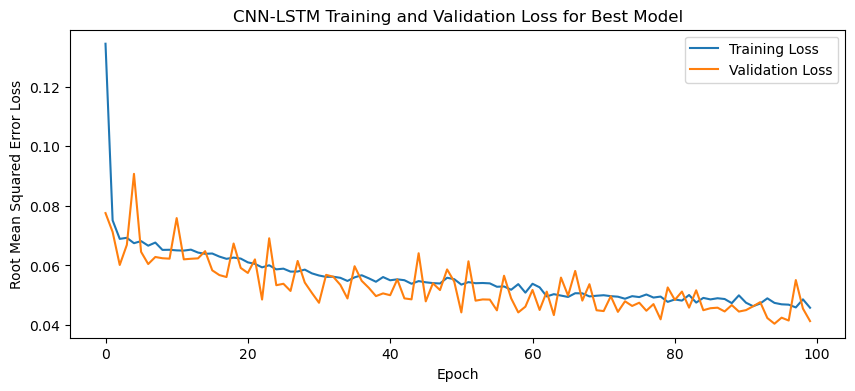

1/1 - 2s - loss: 0.0490 - 2s/epoch - 2s/step
Test Loss: 0.04904920980334282
1/1 [==============================] - 0s 39ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Specific Humidity\tPredicted Specific Humidity\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

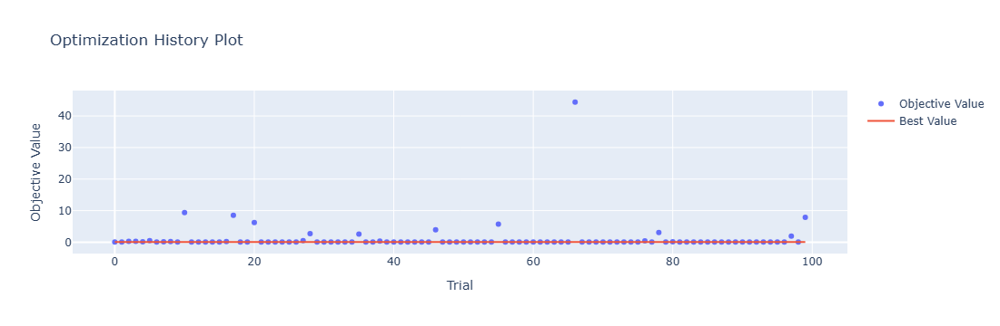

In [4]:
optuna.visualization.plot_optimization_history(study)

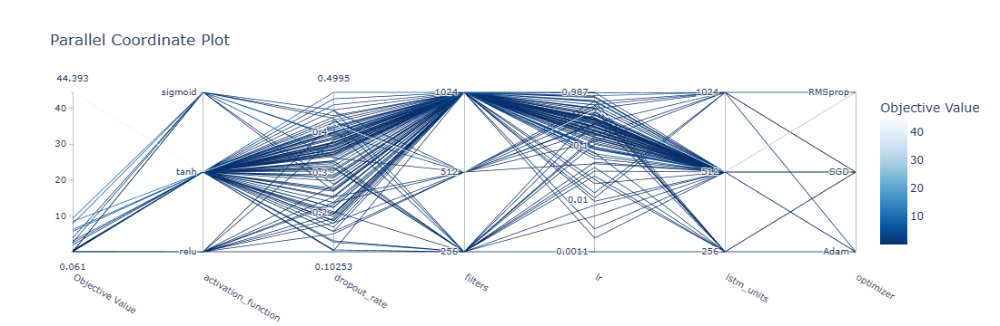

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

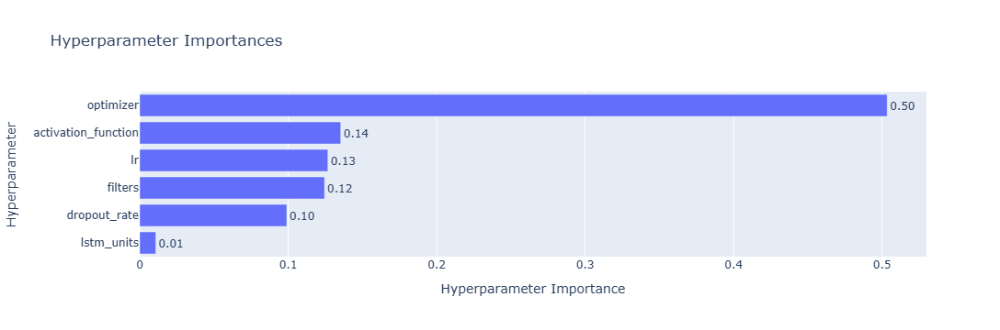

In [6]:
optuna.visualization.plot_param_importances(study)

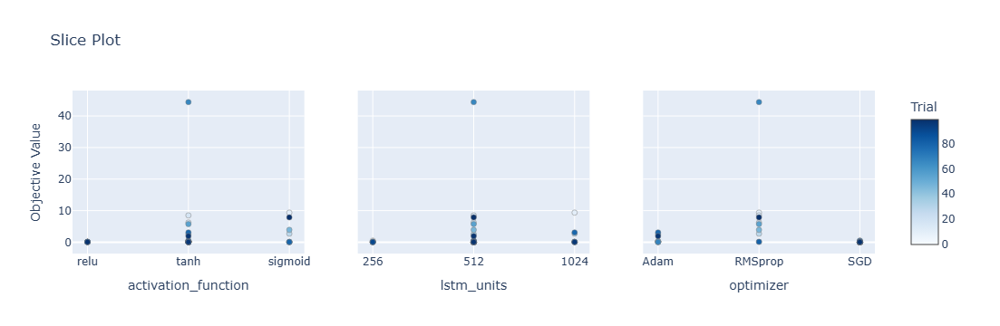

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

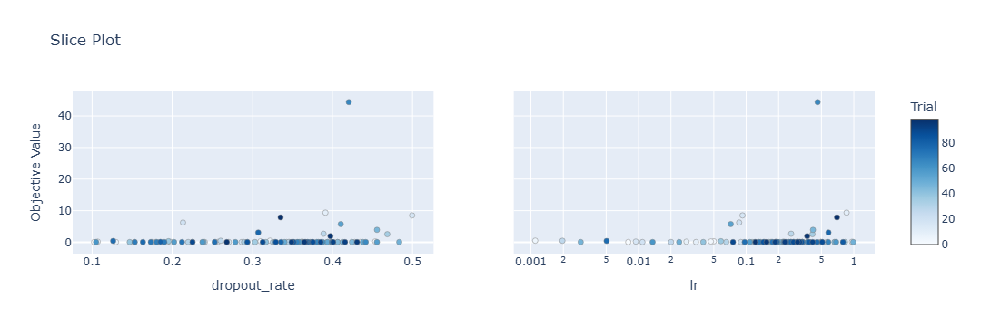

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[ 5.39  4.3   6.51 ... 13.73  8.35  9.05]
 [ 8.03  6.78  8.21 ... 17.14 11.74 12.27]
 [ 5.48  4.27  5.49 ... 13.3   9.17  8.6 ]
 ...
 [ 4.55  3.1   4.22 ... 12.8   7.91  6.65]
 [ 4.44  3.4   5.39 ... 12.34  7.74  6.78]
 [ 4.14  2.75  4.12 ... 10.6   7.07  6.41]]
Epoch 1/100
84/84 [==============================] - 30s 125ms/step - loss: 0.1272 - accuracy: 0.1310 - mae: 0.1081 - rmse: 0.1272 - mape: 22.8593 - pearson: 0.5751 - val_loss: 0.0697 - val_accuracy: 0.7000 - val_mae: 0.0533 - val_rmse: 0.0697 - val_mape: 11.5435 - val_pearson: 0.7548
Epoch 2/100
84/84 [==============================] - 7s 79ms/step - loss: 0.0759 - accuracy: 0.3571 - mae: 0.0603 - rmse: 0.0759 - mape: 13.4442 - pearson: 0.7362 - val_loss: 0.0694 - val_accuracy: 0.0000e+00 - val_mae: 0.0555 - val_rmse: 0.0694 - val_mape: 11.8036 - val_pearson: 0.7815
Epoch 3/100
84/84 [==============================] - 6s 66ms/step - loss: 0.0713 - accuracy: 0.4167 - mae: 0.0567 - rmse: 0.0713 - mape: 12.7417 - pearson: 0.7528

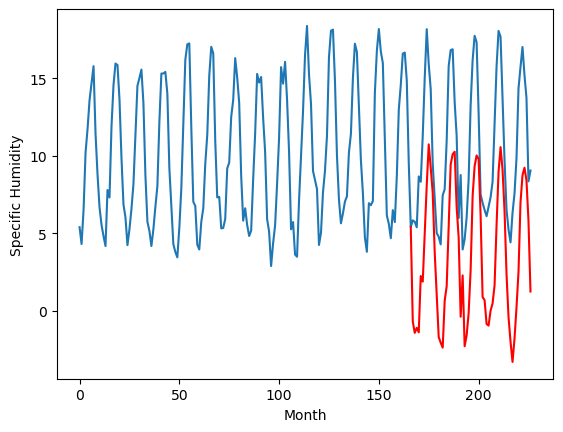

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.86		-0.56		0.30
-0.53		-0.89		-0.36
-0.97		-0.81		0.16
-0.24		-0.85		-0.61
3.64		2.24		-1.40
1.85		1.90		0.05
4.17		4.51		0.34
7.85		7.78		-0.07
9.51		10.13		0.62
9.45		9.76		0.31
7.35		8.11		0.76
4.79		5.04		0.25
1.46		1.35		-0.11
-2.06		-1.85		0.21
-1.71		-2.34		-0.63
-1.00		-2.14		-1.14
1.21		0.24		-0.97
1.43		1.12		-0.31
3.92		4.17		0.25
8.67		8.50		-0.17
9.47		9.22		-0.25
9.63		9.72		0.09
7.47		6.63		-0.84
4.39		4.74		0.35
-1.27		-0.95		0.32
2.37		2.07		-0.30
-2.39		-2.54		-0.15
-1.17		-1.52		-0.35
0.74		-0.28		-1.02
2.04		1.93		-0.11
6.28		6.55		0.27
8.89		8.26		-0.63
9.79		9.55		-0.24
9.22		9.20		-0.02
6.16		6.01		-0.15
1.02		0.85		-0.17
0.82		0.79		-0.03
-0.38		-1.12		-0.74
-0.29		-1.02		-0.73
1.40		0.07		-1.33
1.78		0.10		-1.68
2.57		1.72		-0.85
4.76		4.08		-0.68
8.09		7.58		-0.51
9.76		10.04		0.28
10.54		8.38		-2.16
6.52		5.93		-0.59
1.82		1.79		-0.03
-0.36		-1.13		-0.77
-1.80		-

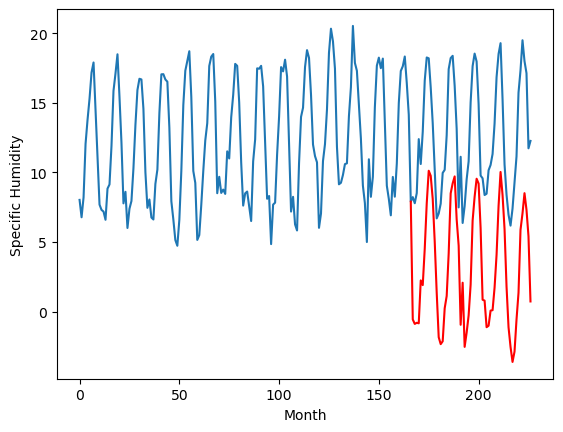

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		2.22		-0.01
2.48		1.89		-0.59
2.31		1.98		-0.33
2.86		1.90		-0.96
5.46		4.79		-0.67
4.21		4.50		0.29
7.07		7.20		0.13
10.98		10.56		-0.42
13.38		13.03		-0.35
13.47		12.55		-0.92
10.38		10.72		0.34
7.63		7.63		-0.00
4.30		4.10		-0.20
1.14		1.13		-0.01
1.52		0.57		-0.95
1.67		0.65		-1.02
3.52		2.99		-0.53
3.76		3.95		0.19
6.52		6.87		0.35
11.14		11.30		0.16
13.05		12.09		-0.96
13.25		12.65		-0.60
10.25		9.47		-0.78
7.53		7.68		0.15
1.66		1.94		0.28
4.06		4.68		0.62
0.65		0.37		-0.28
1.86		1.33		-0.53
2.57		2.57		-0.00
4.02		4.64		0.62
8.16		9.27		1.11
10.94		10.98		0.04
13.14		12.45		-0.69
12.44		12.10		-0.34
8.71		8.90		0.19
3.71		3.77		0.06
3.39		3.62		0.23
2.06		1.72		-0.34
2.43		1.93		-0.50
3.54		2.81		-0.73
2.90		2.80		-0.10
4.34		4.50		0.16
7.12		6.69		-0.43
9.70		10.25		0.55
12.56		12.91		0.35
12.65		11.21		-1.44
9.07		8.82		-0.25
5.16		4.74		-0.42
2.63		1.72		-0.91
1.82		0.49		-1.

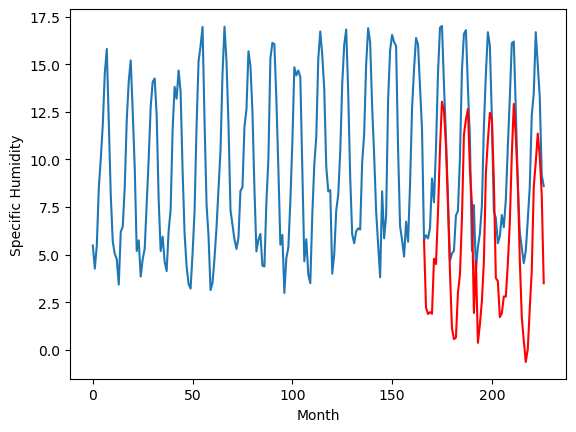

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.48		0.10		0.58
0.06		-0.50		-0.56
0.30		-0.25		-0.55
0.44		-0.42		-0.86
4.75		3.26		-1.49
3.60		2.84		-0.76
5.75		5.73		-0.02
8.24		8.78		0.54
10.99		11.26		0.27
9.74		10.22		0.48
8.39		8.79		0.40
4.58		5.21		0.63
1.53		1.96		0.43
-1.54		-1.14		0.40
-1.47		-1.49		-0.02
-1.56		-1.51		0.05
1.89		1.35		-0.54
2.46		2.22		-0.24
5.97		5.98		0.01
9.87		10.00		0.13
10.71		10.59		-0.12
10.33		10.80		0.47
8.02		7.45		-0.57
5.59		5.42		-0.17
-0.62		0.14		0.76
2.43		3.25		0.82
-2.69		-1.70		0.99
-1.48		-0.82		0.66
-0.39		0.55		0.94
2.53		3.31		0.78
6.77		8.05		1.28
8.78		9.89		1.11
9.99		10.59		0.60
9.27		10.35		1.08
5.89		6.84		0.95
0.79		1.55		0.76
0.27		1.48		1.21
-0.23		-0.18		0.05
-0.04		-0.33		-0.29
0.63		0.86		0.23
1.71		1.23		-0.48
2.11		2.47		0.36
4.96		6.04		1.08
9.11		9.46		0.35
10.14		11.15		1.01
9.89		9.61		-0.28
7.71		6.96		-0.75
3.14		2.79		-0.35
0.15		0.07		-0.08
-1.25		-1.65		-0.40
-2

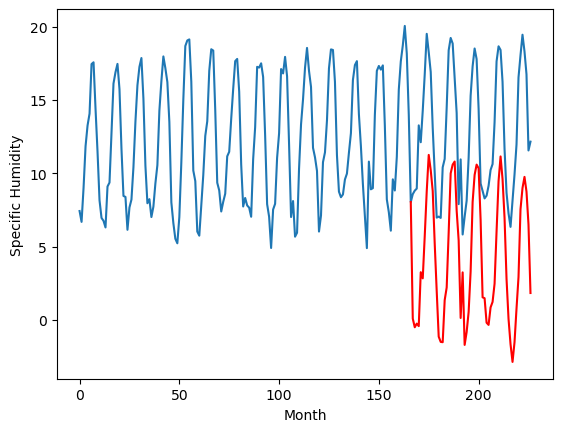

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.29		3.34		-0.95
3.04		2.41		-0.63
3.83		2.86		-0.97
3.22		2.46		-0.76
7.67		6.40		-1.27
7.39		6.05		-1.34
9.97		9.31		-0.66
12.33		12.10		-0.23
15.19		14.73		-0.46
12.92		12.81		-0.11
11.61		11.33		-0.28
7.33		7.25		-0.08
5.48		4.97		-0.51
2.70		2.46		-0.24
2.63		2.24		-0.39
2.23		1.72		-0.51
5.07		5.00		-0.07
6.47		5.91		-0.56
10.48		10.19		-0.29
14.17		13.79		-0.38
14.88		14.41		-0.47
14.80		14.30		-0.50
10.57		10.63		0.06
8.48		8.65		0.17
4.26		4.14		-0.12
7.02		6.64		-0.38
1.52		2.09		0.57
1.78		2.60		0.82
3.33		4.12		0.79
7.25		7.17		-0.08
10.95		11.85		0.90
11.92		13.91		1.99
11.68		14.18		2.50
12.77		14.05		1.28
9.94		10.34		0.40
5.14		5.16		0.02
5.13		4.80		-0.33
4.05		3.53		-0.52
3.29		3.29		-0.00
3.63		4.25		0.62
5.82		5.00		-0.82
6.58		5.86		-0.72
10.52		10.61		0.09
14.64		13.88		-0.76
13.22		14.80		1.58
11.40		13.55		2.15
11.36		10.83		-0.53
7.61		6.84		-0.77
4.81		4.28		-0.53
2

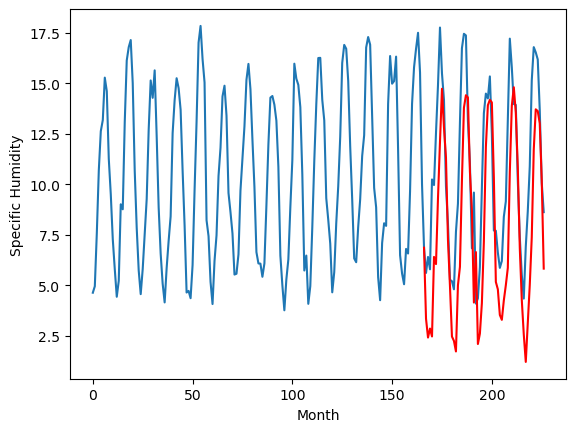

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.81		-1.18		-0.37
-0.85		-1.36		-0.51
-1.33		-1.33		0.00
-1.44		-1.40		0.04
0.32		0.89		0.57
0.66		0.75		0.09
3.79		3.31		-0.48
7.52		6.79		-0.73
11.00		9.25		-1.75
11.03		9.09		-1.94
8.13		6.98		-1.15
4.43		4.25		-0.18
1.48		0.67		-0.81
-2.28		-2.03		0.25
-2.89		-2.71		0.18
-2.30		-2.63		-0.33
-0.73		-0.66		0.07
0.28		0.39		0.11
2.78		2.70		-0.08
8.04		7.29		-0.75
9.16		8.26		-0.90
10.32		9.00		-1.32
6.23		5.97		-0.26
3.91		4.38		0.47
-1.35		-1.42		-0.07
0.07		0.85		0.78
-3.04		-2.82		0.22
-1.66		-1.92		-0.26
-0.33		-0.75		-0.42
0.80		0.78		-0.02
5.58		5.23		-0.35
6.67		6.86		0.19
11.00		8.82		-2.18
9.21		8.46		-0.75
6.51		5.50		-1.01
1.87		0.64		-1.23
1.21		0.30		-0.91
-2.14		-1.64		0.50
-1.39		-1.17		0.22
-0.46		-0.64		-0.18
-0.68		-0.86		-0.18
2.00		1.14		-0.86
2.76		2.44		-0.32
6.66		6.04		-0.62
11.01		9.29		-1.72
10.12		7.50		-2.62
7.00		5.36		-1.64
2.60		1.44		-1.16
-0.42		-1.77		-1.

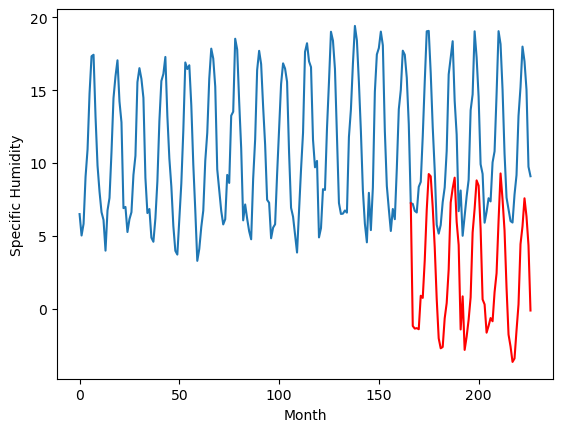

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.38		0.76		-0.62
1.50		0.51		-0.99
1.42		0.57		-0.85
1.78		0.47		-1.31
3.41		2.95		-0.46
3.19		2.77		-0.42
6.29		5.43		-0.86
10.01		8.89		-1.12
12.80		11.40		-1.40
12.74		11.05		-1.69
9.21		8.98		-0.23
6.49		6.08		-0.41
3.64		2.61		-1.03
0.77		-0.12		-0.89
0.62		-0.77		-1.39
0.67		-0.74		-1.41
2.26		1.37		-0.89
2.86		2.41		-0.45
5.86		4.94		-0.92
10.24		9.49		-0.75
11.68		10.42		-1.26
12.21		11.10		-1.11
8.89		7.96		-0.93
6.78		6.33		-0.45
1.03		0.54		-0.49
2.87		2.89		0.02
0.09		-0.93		-1.02
1.37		-0.03		-1.40
2.38		1.17		-1.21
3.38		2.88		-0.50
7.74		7.41		-0.33
9.62		9.08		-0.54
13.24		10.89		-2.35
11.89		10.54		-1.35
8.45		7.47		-0.98
3.89		2.51		-1.38
3.29		2.21		-1.08
1.11		0.30		-0.81
1.97		0.69		-1.28
2.65		1.30		-1.35
2.24		1.15		-1.09
4.45		3.05		-1.40
6.04		4.67		-1.37
8.77		8.28		-0.49
12.51		11.35		-1.16
12.14		9.59		-2.55
9.20		7.36		-1.84
4.94		3.39		-1.55
1.61		0.23		-1.38
1.

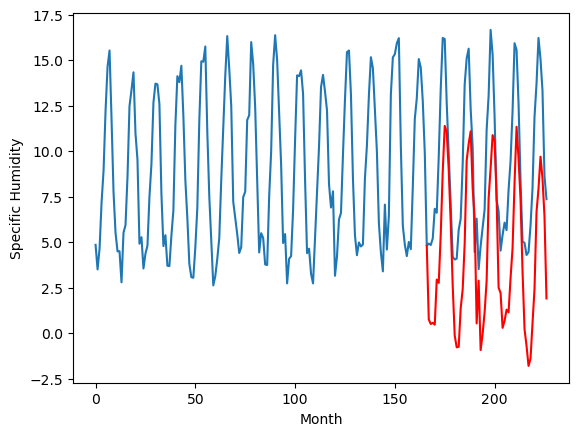

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		-0.74		-0.69
0.20		-0.98		-1.18
0.23		-0.91		-1.14
0.45		-1.04		-1.49
1.75		1.24		-0.51
1.69		1.11		-0.58
3.68		3.80		0.12
8.35		7.29		-1.06
11.16		9.86		-1.30
11.40		9.49		-1.91
7.50		7.29		-0.21
4.79		4.43		-0.36
2.25		1.07		-1.18
-0.62		-1.46		-0.84
-0.93		-2.16		-1.23
-0.90		-2.21		-1.31
0.72		-0.16		-0.88
1.42		0.94		-0.48
4.44		3.29		-1.15
8.71		7.89		-0.82
10.21		8.89		-1.32
10.49		9.62		-0.87
7.00		6.46		-0.54
5.12		4.92		-0.20
-0.67		-0.85		-0.18
1.10		1.24		0.14
-1.41		-2.28		-0.87
-0.18		-1.46		-1.28
0.81		-0.27		-1.08
1.71		1.29		-0.42
6.00		5.77		-0.23
7.45		7.43		-0.02
10.82		9.39		-1.43
9.75		9.05		-0.70
6.96		6.02		-0.94
2.54		1.15		-1.39
1.84		0.75		-1.09
-0.50		-1.13		-0.63
0.43		-0.65		-1.08
0.79		-0.23		-1.02
0.71		-0.41		-1.12
2.99		1.56		-1.43
4.31		2.98		-1.33
6.93		6.60		-0.33
11.28		9.85		-1.43
10.22		8.05		-2.17
7.42		5.92		-1.50
3.67		2.03		-1.64
0.15		-1.21	

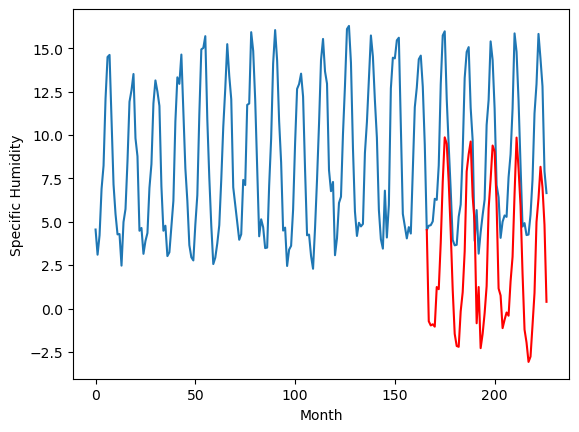

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.27		0.16		-1.11
1.36		-0.58		-1.94
0.96		-0.27		-1.23
0.95		-0.64		-1.59
3.21		2.57		-0.64
3.45		2.35		-1.10
6.67		5.59		-1.08
10.32		8.76		-1.56
13.41		11.51		-1.90
11.38		9.89		-1.49
8.66		7.87		-0.79
4.21		4.08		-0.13
2.45		1.73		-0.72
0.54		-0.55		-1.09
0.31		-0.99		-1.30
-0.37		-1.55		-1.18
2.69		1.34		-1.35
3.42		2.39		-1.03
6.33		5.93		-0.40
11.31		10.00		-1.31
12.81		10.84		-1.97
13.00		11.07		-1.93
9.19		7.40		-1.79
6.77		5.66		-1.11
1.48		0.60		-0.88
3.07		2.63		-0.44
-0.21		-1.23		-1.02
0.38		-0.69		-1.07
2.06		0.74		-1.32
3.64		3.18		-0.46
7.83		7.88		0.05
10.01		9.86		-0.15
13.67		10.88		-2.79
12.70		10.64		-2.06
8.25		7.12		-1.13
3.02		1.99		-1.03
2.02		1.53		-0.49
1.09		0.06		-1.03
1.69		0.16		-1.53
1.76		0.78		-0.98
2.20		1.16		-1.04
3.42		2.45		-0.97
6.91		5.99		-0.92
9.19		9.48		0.29
12.74		11.35		-1.39
12.74		9.96		-2.78
8.67		7.42		-1.25
4.61		3.48		-1.13
1.95		0.57		-1.

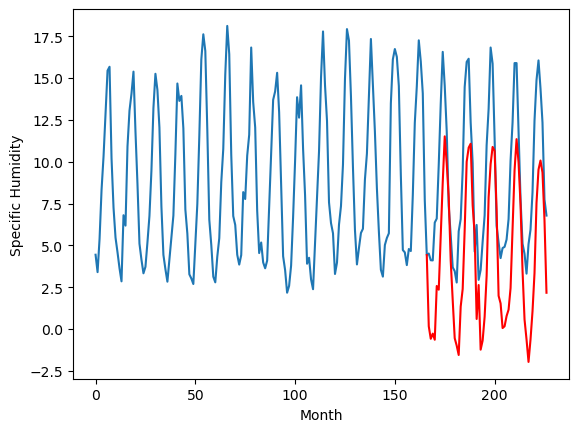

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.78		-0.32		-1.10
1.19		-0.74		-1.93
0.69		-0.59		-1.28
0.37		-0.90		-1.27
2.33		1.37		-0.96
2.39		1.33		-1.06
5.53		4.29		-1.24
8.22		7.73		-0.49
11.36		10.48		-0.88
10.14		9.53		-0.61
7.35		7.09		-0.26
4.01		3.93		-0.08
1.96		1.26		-0.70
0.30		-0.76		-1.06
-0.03		-1.44		-1.41
-0.48		-1.87		-1.39
1.32		0.37		-0.95
2.64		1.56		-1.08
4.73		4.06		-0.67
9.50		8.53		-0.97
10.43		9.61		-0.82
10.85		10.23		-0.62
7.68		6.81		-0.87
6.37		5.38		-0.99
0.85		-0.06		-0.91
1.69		1.45		-0.24
-0.60		-1.58		-0.98
0.14		-1.01		-1.15
1.42		0.26		-1.16
3.04		1.86		-1.18
7.65		6.33		-1.32
9.33		8.12		-1.21
12.91		10.01		-2.90
11.37		9.73		-1.64
8.31		6.60		-1.71
2.52		1.79		-0.73
1.80		1.15		-0.65
0.87		-0.49		-1.36
1.48		0.01		-1.47
1.25		0.15		-1.10
1.35		0.13		-1.22
3.08		1.95		-1.13
5.52		3.84		-1.68
8.14		7.44		-0.70
11.96		10.44		-1.52
10.66		8.81		-1.85
7.94		6.66		-1.28
4.70		2.91		-1.79
1.35		-0.34		-

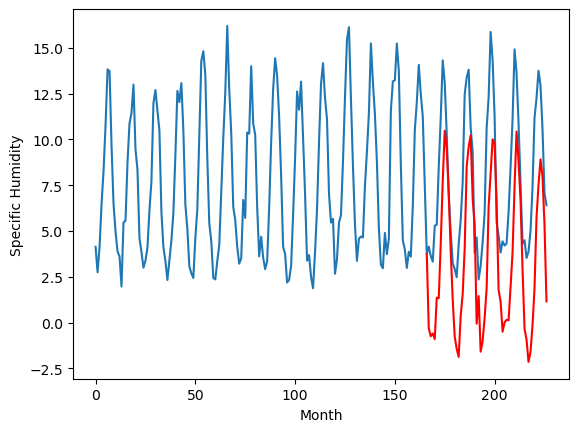

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.49		-0.06		-0.55
0.61		-0.51		-1.12
0.23		-0.36		-0.59
-0.28		-0.76		-0.48
1.32		1.10		-0.22
1.68		1.22		-0.46
4.58		4.25		-0.33
7.68		7.70		0.02
10.73		10.54		-0.19
9.16		9.45		0.29
6.50		6.70		0.20
3.05		3.59		0.54
1.64		1.33		-0.31
0.11		-0.19		-0.30
-0.27		-0.92		-0.65
-1.01		-1.59		-0.58
0.61		0.52		-0.09
2.21		1.83		-0.38
3.73		4.01		0.28
8.86		8.49		-0.37
9.93		9.72		-0.21
10.42		10.38		-0.04
6.80		6.92		0.12
5.81		5.68		-0.13
0.96		0.45		-0.51
0.96		1.29		0.33
-1.11		-1.03		0.08
-0.51		-0.66		-0.15
0.74		0.60		-0.14
1.68		1.90		0.22
5.40		6.20		0.80
6.67		8.00		1.33
9.16		10.17		1.01
10.15		9.94		-0.21
7.55		6.91		-0.64
2.53		2.34		-0.19
1.39		1.40		0.01
0.22		-0.10		-0.32
0.62		0.58		-0.04
0.06		0.31		0.25
0.52		0.25		-0.27
2.16		2.17		0.01
3.37		3.77		0.40
6.38		7.34		0.96
10.21		10.56		0.35
9.46		8.97		-0.49
8.15		6.99		-1.16
4.39		3.44		-0.95
0.98		0.08		-0.90
1.51		-0.14		-1.6

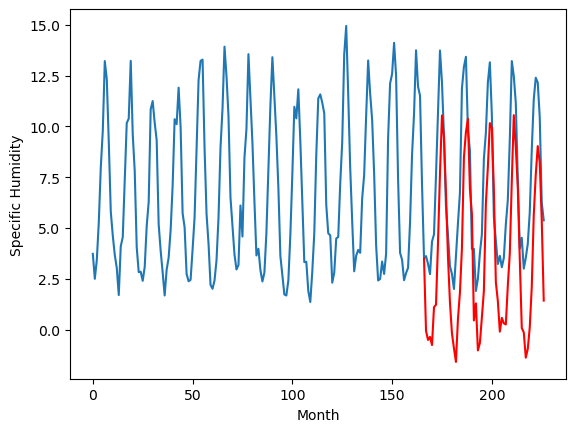

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.03  -0.698909
1                 1   -0.86  -0.564577
2                 2    2.23   2.219170
3                 3   -0.48   0.097080
4                 4    4.29   3.343702
5                 5   -0.81  -1.181421
6                 6    1.38   0.761446
7                 7   -0.05  -0.736311
8                 8    1.27   0.164583
9                 9    0.78  -0.315581
10               10    0.49  -0.062559


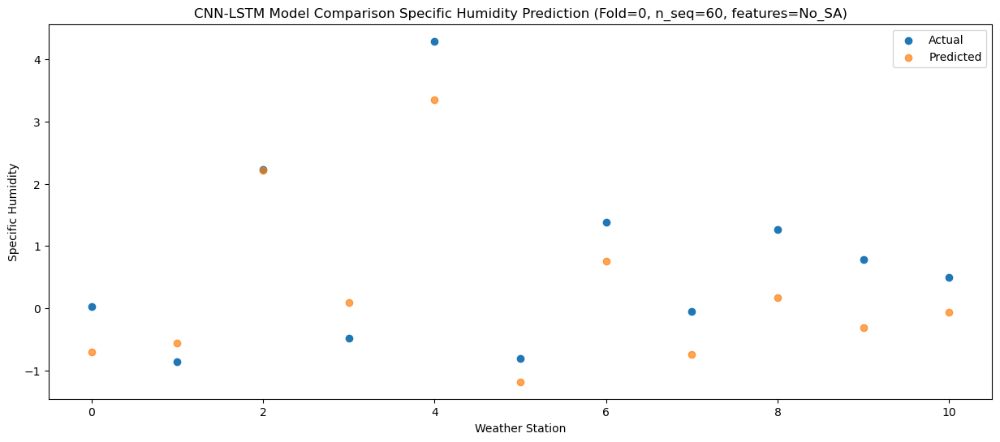

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.46  -1.436505
1                 1   -0.53  -0.889482
2                 2    2.48   1.885815
3                 3    0.06  -0.495686
4                 4    3.04   2.411622
5                 5   -0.85  -1.360489
6                 6    1.50   0.508510
7                 7    0.20  -0.975373
8                 8    1.36  -0.582273
9                 9    1.19  -0.742695
10               10    0.61  -0.509084


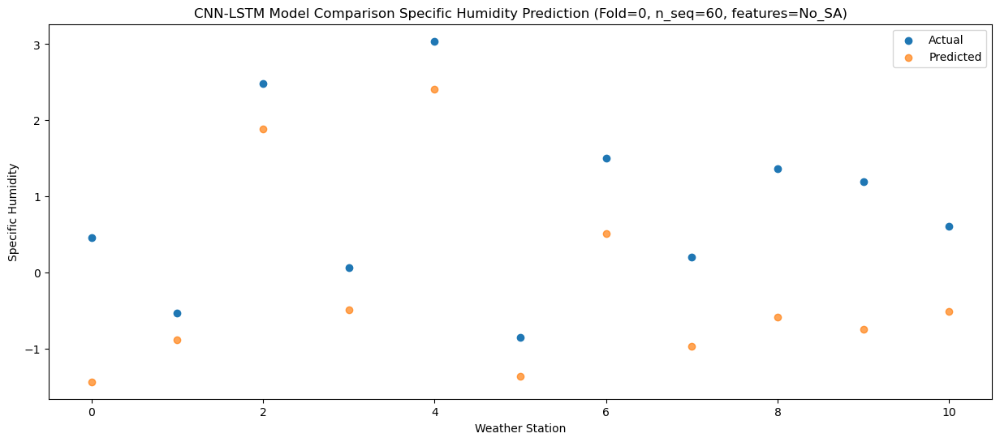

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.37  -1.109234
1                 1   -0.97  -0.805813
2                 2    2.31   1.984539
3                 3    0.30  -0.245503
4                 4    3.83   2.856433
5                 5   -1.33  -1.329386
6                 6    1.42   0.572804
7                 7    0.23  -0.908320
8                 8    0.96  -0.272598
9                 9    0.69  -0.593782
10               10    0.23  -0.358848


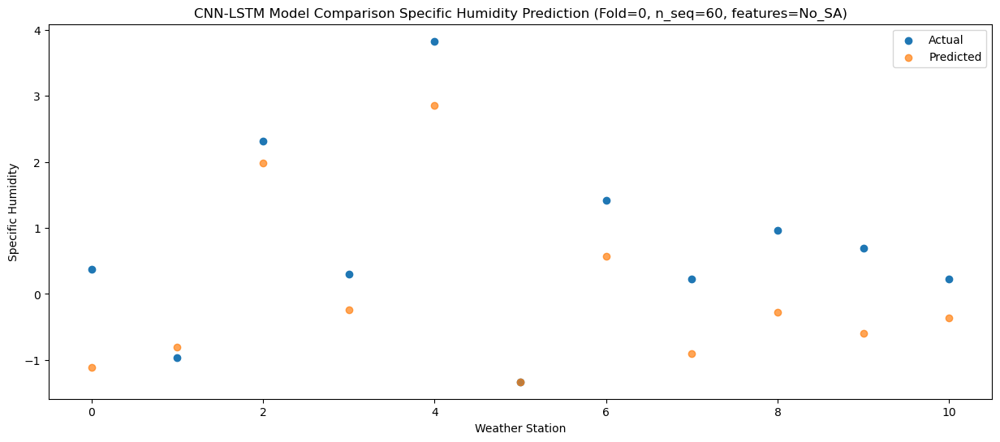

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.01  -1.402773
1                 1   -0.24  -0.845954
2                 2    2.86   1.895441
3                 3    0.44  -0.416865
4                 4    3.22   2.464871
5                 5   -1.44  -1.404472
6                 6    1.78   0.471341
7                 7    0.45  -1.044981
8                 8    0.95  -0.640989
9                 9    0.37  -0.897527
10               10   -0.28  -0.759909


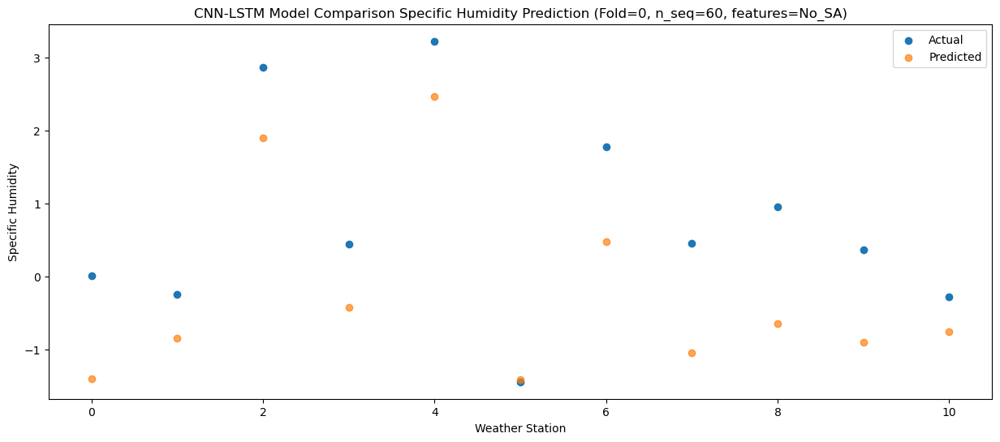

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.30   2.234477
1                 1    3.64   2.241442
2                 2    5.46   4.791351
3                 3    4.75   3.261264
4                 4    7.67   6.403313
5                 5    0.32   0.893757
6                 6    3.41   2.951619
7                 7    1.75   1.237076
8                 8    3.21   2.573298
9                 9    2.33   1.365198
10               10    1.32   1.103786


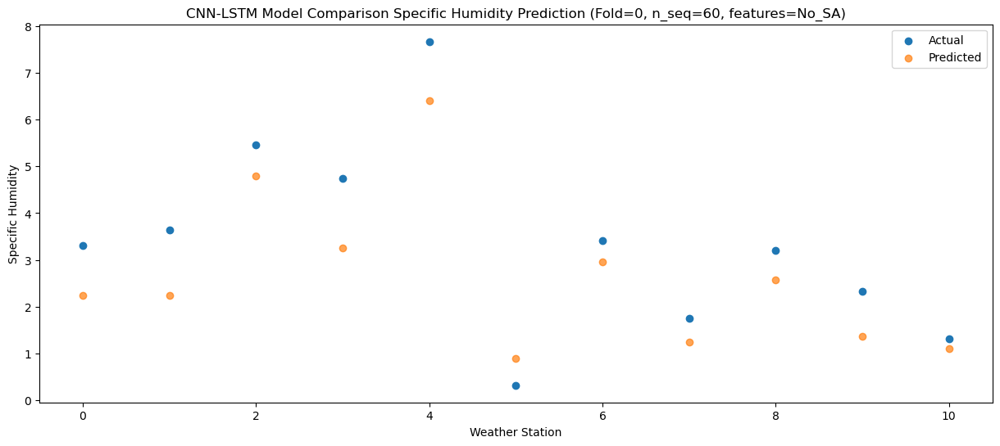

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    2.95   1.869985
1                 1    1.85   1.901303
2                 2    4.21   4.504403
3                 3    3.60   2.838830
4                 4    7.39   6.049175
5                 5    0.66   0.747243
6                 6    3.19   2.767819
7                 7    1.69   1.112913
8                 8    3.45   2.351240
9                 9    2.39   1.331581
10               10    1.68   1.222797


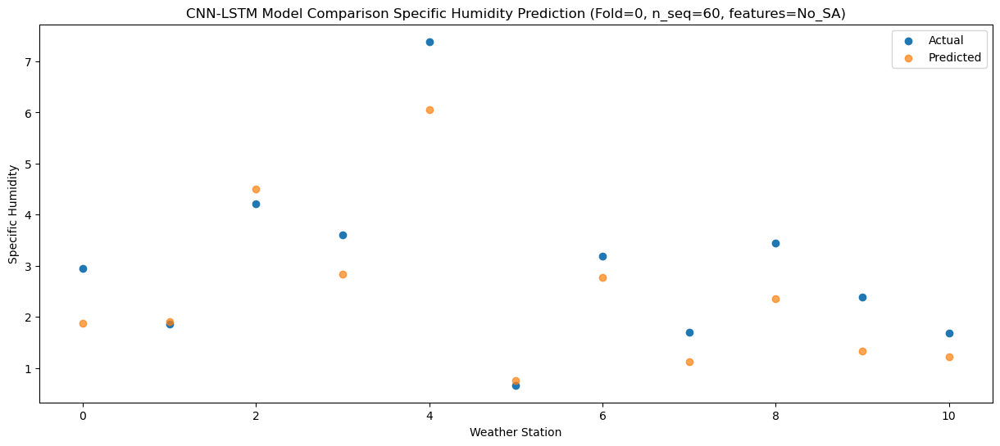

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    5.92   5.003349
1                 1    4.17   4.512349
2                 2    7.07   7.202689
3                 3    5.75   5.725373
4                 4    9.97   9.308497
5                 5    3.79   3.313887
6                 6    6.29   5.429318
7                 7    3.68   3.796349
8                 8    6.67   5.587156
9                 9    5.53   4.293668
10               10    4.58   4.254659


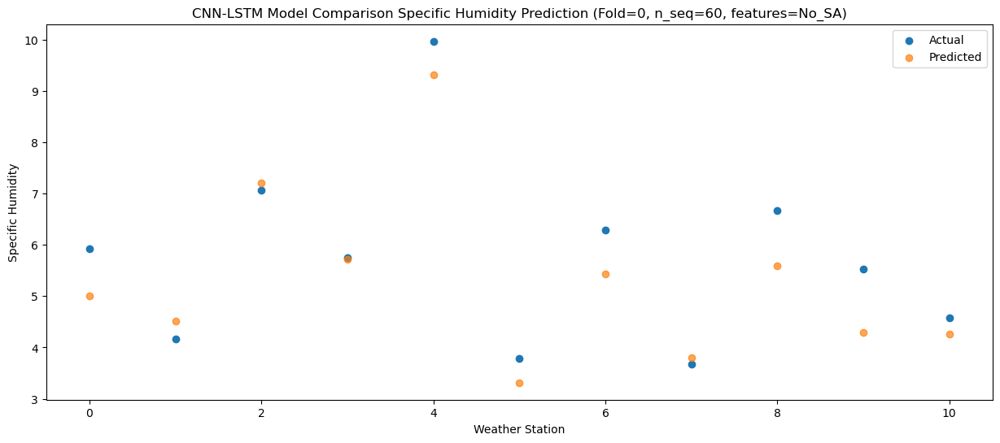

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.68   8.080407
1                 1    7.85   7.778555
2                 2   10.98  10.561259
3                 3    8.24   8.779472
4                 4   12.33  12.096310
5                 5    7.52   6.787742
6                 6   10.01   8.887598
7                 7    8.35   7.293679
8                 8   10.32   8.758141
9                 9    8.22   7.733089
10               10    7.68   7.701824


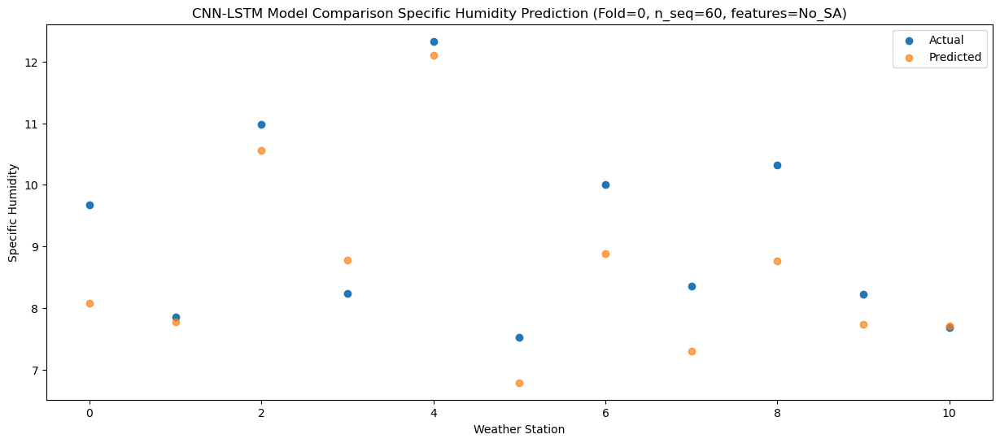

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.81  10.738217
1                 1    9.51  10.126379
2                 2   13.38  13.026348
3                 3   10.99  11.255903
4                 4   15.19  14.729975
5                 5   11.00   9.249409
6                 6   12.80  11.395883
7                 7   11.16   9.862257
8                 8   13.41  11.513034
9                 9   11.36  10.479003
10               10   10.73  10.542769


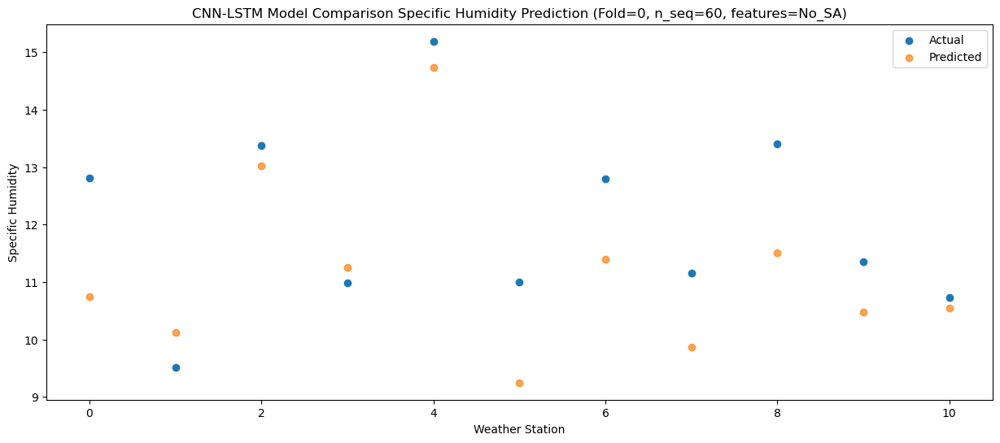

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.56   9.246106
1                 1    9.45   9.758635
2                 2   13.47  12.552161
3                 3    9.74  10.218909
4                 4   12.92  12.805501
5                 5   11.03   9.091071
6                 6   12.74  11.051704
7                 7   11.40   9.494520
8                 8   11.38   9.888999
9                 9   10.14   9.529408
10               10    9.16   9.448932


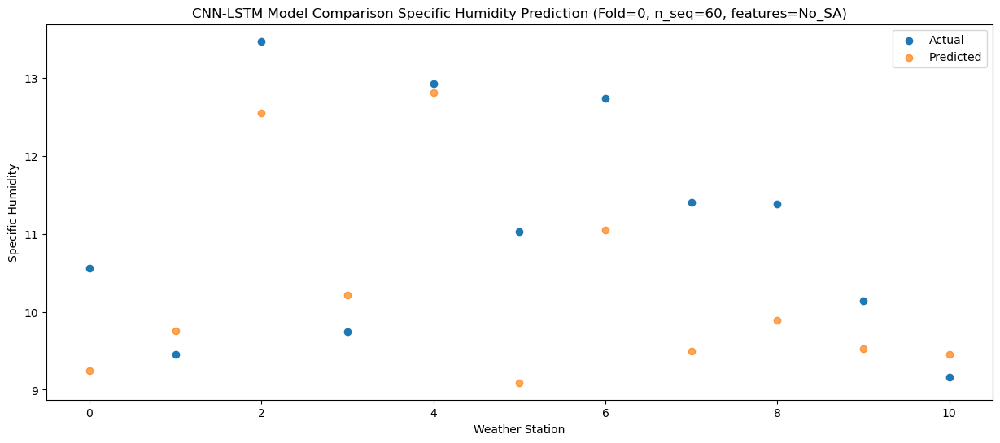

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.92   7.597492
1                 1    7.35   8.111124
2                 2   10.38  10.715429
3                 3    8.39   8.793537
4                 4   11.61  11.330521
5                 5    8.13   6.982623
6                 6    9.21   8.978776
7                 7    7.50   7.287127
8                 8    8.66   7.866107
9                 9    7.35   7.088895
10               10    6.50   6.703501


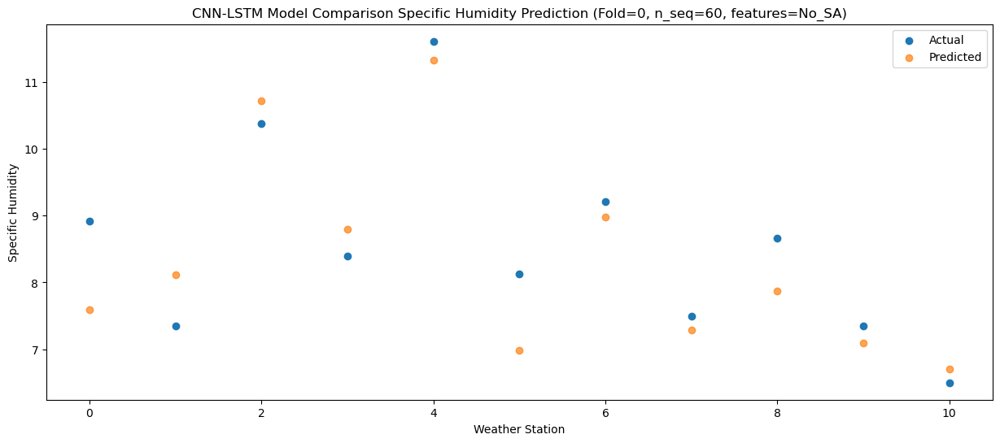

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.11   3.763882
1                 1    4.79   5.043625
2                 2    7.63   7.628056
3                 3    4.58   5.210324
4                 4    7.33   7.245690
5                 5    4.43   4.245764
6                 6    6.49   6.079280
7                 7    4.79   4.430577
8                 8    4.21   4.078452
9                 9    4.01   3.926752
10               10    3.05   3.593935


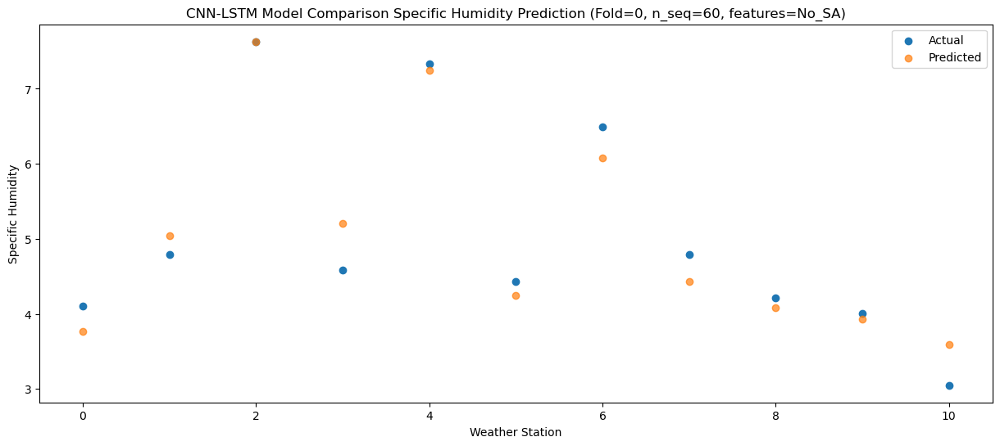

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.87   1.023304
1                 1    1.46   1.348419
2                 2    4.30   4.102768
3                 3    1.53   1.964530
4                 4    5.48   4.966001
5                 5    1.48   0.674584
6                 6    3.64   2.608884
7                 7    2.25   1.073252
8                 8    2.45   1.727443
9                 9    1.96   1.260865
10               10    1.64   1.329607


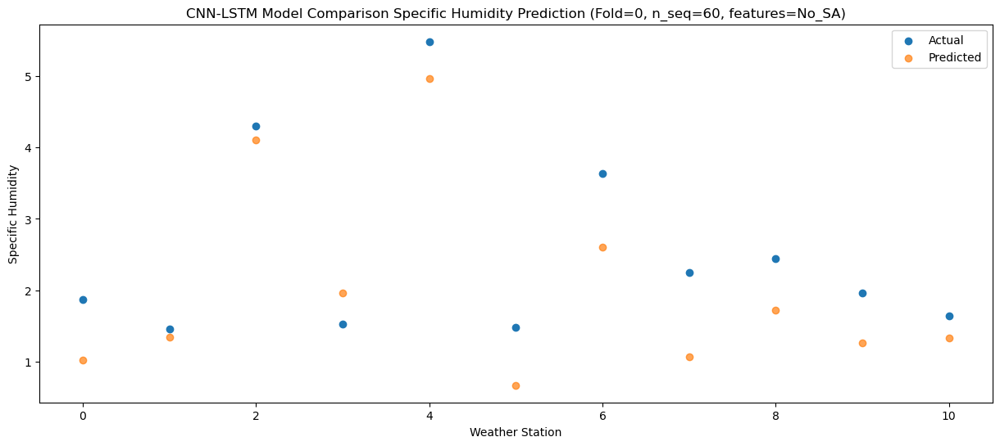

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.36  -1.704291
1                 1   -2.06  -1.845285
2                 2    1.14   1.127676
3                 3   -1.54  -1.135941
4                 4    2.70   2.459961
5                 5   -2.28  -2.031494
6                 6    0.77  -0.120742
7                 7   -0.62  -1.461044
8                 8    0.54  -0.546559
9                 9    0.30  -0.758537
10               10    0.11  -0.186323


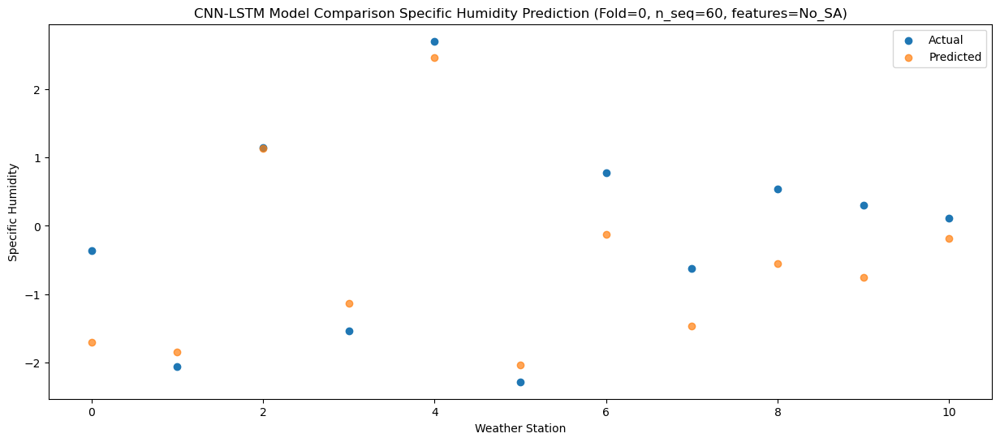

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.60  -2.072939
1                 1   -1.71  -2.344040
2                 2    1.52   0.567130
3                 3   -1.47  -1.492047
4                 4    2.63   2.243119
5                 5   -2.89  -2.713982
6                 6    0.62  -0.774693
7                 7   -0.93  -2.159988
8                 8    0.31  -0.991503
9                 9   -0.03  -1.435655
10               10   -0.27  -0.918528


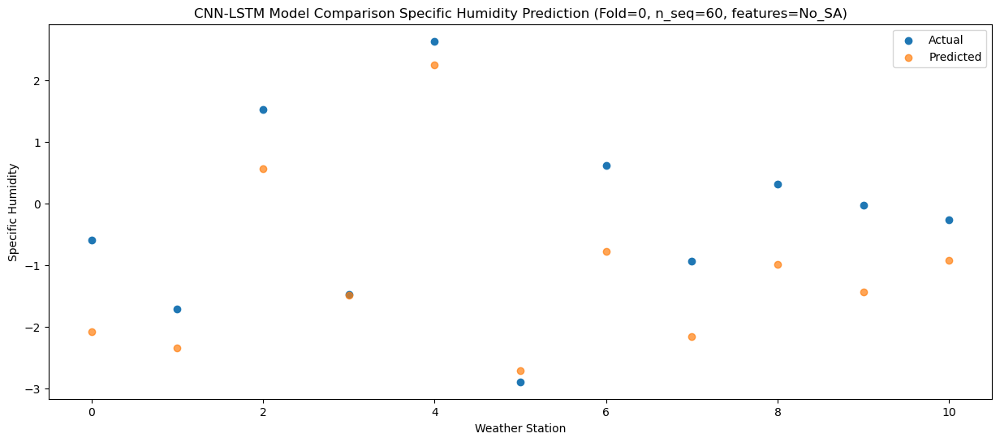

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -2.393082
1                 1   -1.00  -2.137765
2                 2    1.67   0.649501
3                 3   -1.56  -1.514183
4                 4    2.23   1.722189
5                 5   -2.30  -2.626126
6                 6    0.67  -0.743420
7                 7   -0.90  -2.206131
8                 8   -0.37  -1.548904
9                 9   -0.48  -1.871294
10               10   -1.01  -1.591027


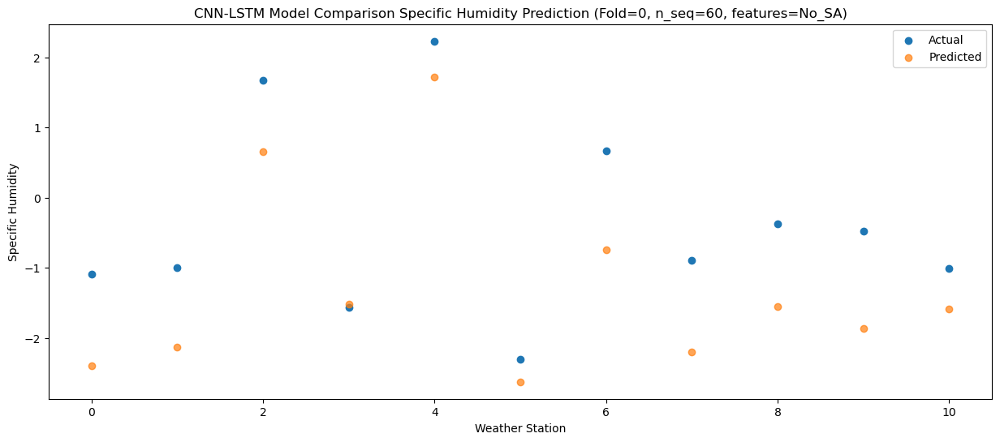

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.08   0.636324
1                 1    1.21   0.235555
2                 2    3.52   2.992009
3                 3    1.89   1.354611
4                 4    5.07   4.996763
5                 5   -0.73  -0.657921
6                 6    2.26   1.374678
7                 7    0.72  -0.161097
8                 8    2.69   1.342342
9                 9    1.32   0.370888
10               10    0.61   0.521422


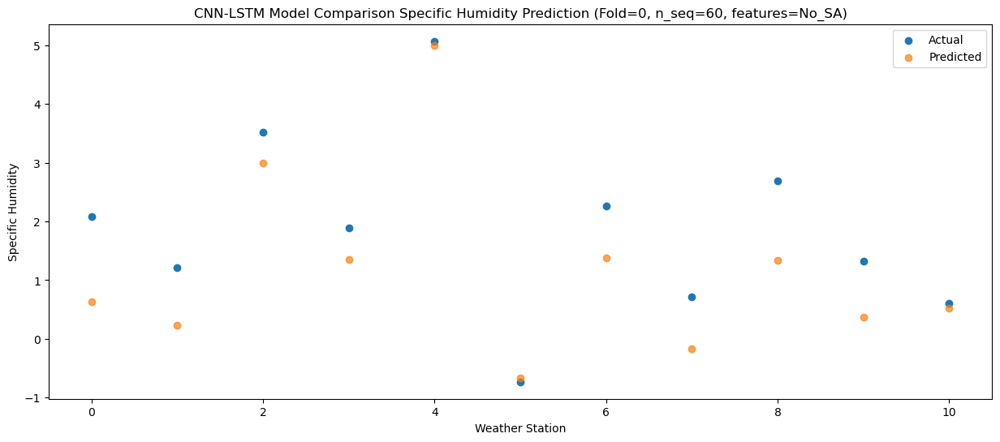

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.47   1.579833
1                 1    1.43   1.117786
2                 2    3.76   3.949240
3                 3    2.46   2.216511
4                 4    6.47   5.910501
5                 5    0.28   0.389464
6                 6    2.86   2.412575
7                 7    1.42   0.936260
8                 8    3.42   2.392505
9                 9    2.64   1.562601
10               10    2.21   1.829999


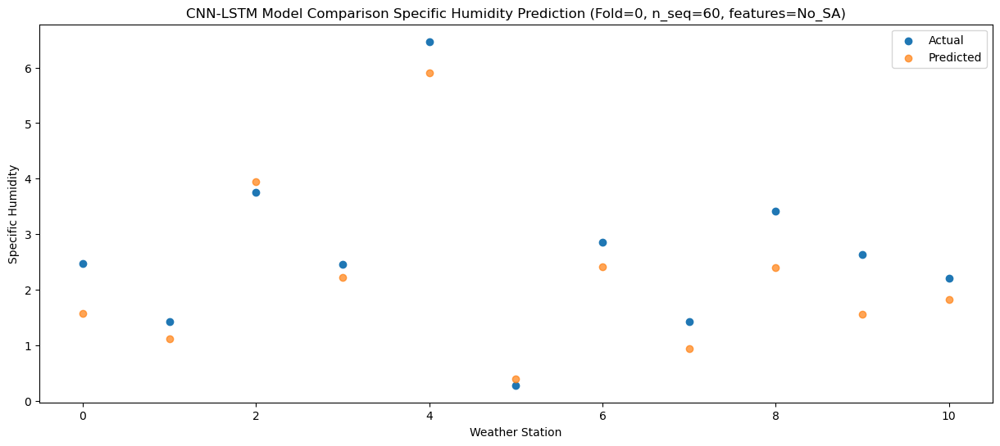

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.62   5.441894
1                 1    3.92   4.173253
2                 2    6.52   6.871111
3                 3    5.97   5.978524
4                 4   10.48  10.187136
5                 5    2.78   2.704731
6                 6    5.86   4.936597
7                 7    4.44   3.291692
8                 8    6.33   5.925642
9                 9    4.73   4.057643
10               10    3.73   4.008658


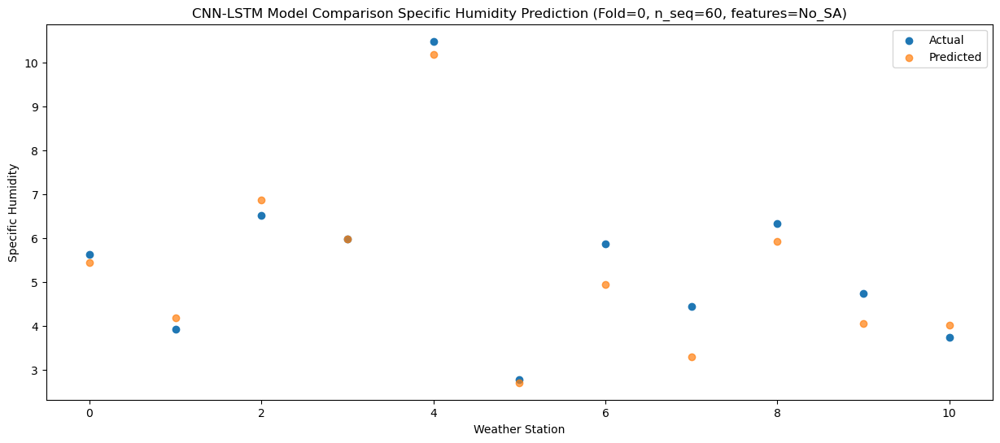

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.43   9.437923
1                 1    8.67   8.501178
2                 2   11.14  11.295802
3                 3    9.87  10.002898
4                 4   14.17  13.788757
5                 5    8.04   7.294034
6                 6   10.24   9.490380
7                 7    8.71   7.893944
8                 8   11.31   9.996715
9                 9    9.50   8.531571
10               10    8.86   8.487729


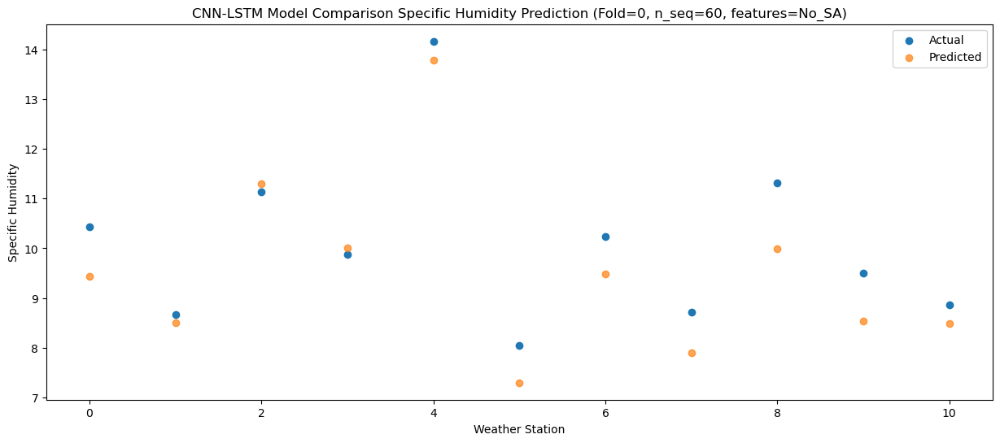

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.46  10.106197
1                 1    9.47   9.219683
2                 2   13.05  12.093395
3                 3   10.71  10.592867
4                 4   14.88  14.409208
5                 5    9.16   8.264469
6                 6   11.68  10.418126
7                 7   10.21   8.892104
8                 8   12.81  10.837446
9                 9   10.43   9.610531
10               10    9.93   9.723596


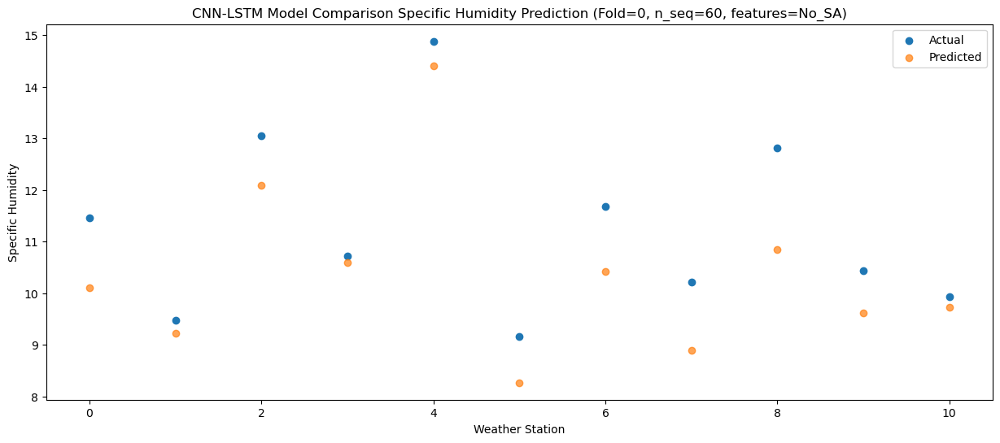

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.51  10.262853
1                 1    9.63   9.716105
2                 2   13.25  12.648401
3                 3   10.33  10.804771
4                 4   14.80  14.295439
5                 5   10.32   9.000697
6                 6   12.21  11.098926
7                 7   10.49   9.619469
8                 8   13.00  11.071609
9                 9   10.85  10.228922
10               10   10.42  10.383118


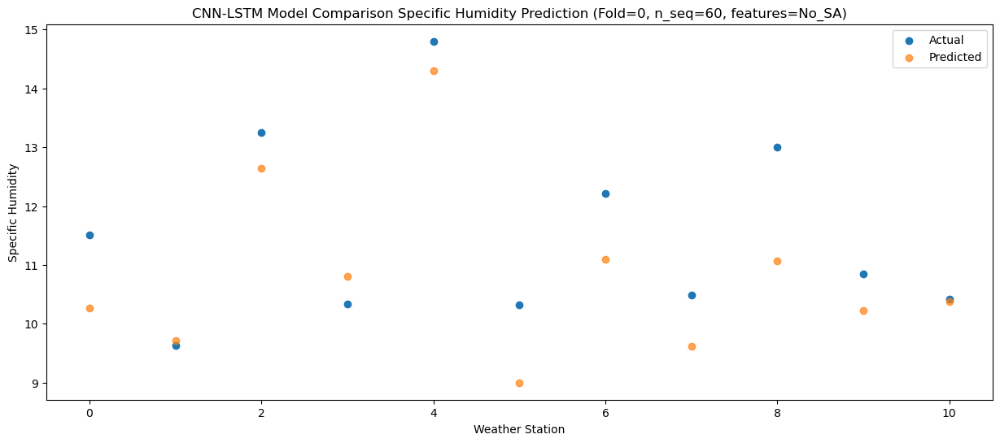

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.09   6.670136
1                 1    7.47   6.630616
2                 2   10.25   9.469268
3                 3    8.02   7.450339
4                 4   10.57  10.630112
5                 5    6.23   5.967571
6                 6    8.89   7.964281
7                 7    7.00   6.464250
8                 8    9.19   7.395737
9                 9    7.68   6.811627
10               10    6.80   6.919579


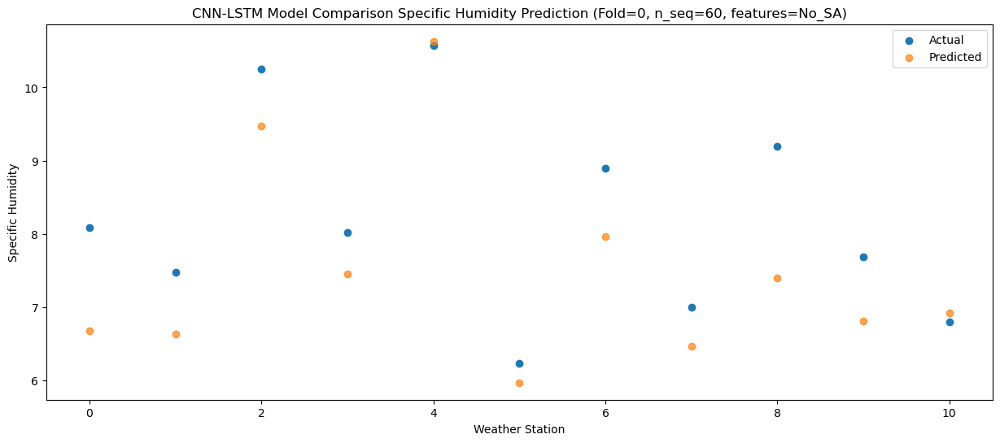

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.91   4.732711
1                 1    4.39   4.741722
2                 2    7.53   7.678528
3                 3    5.59   5.424652
4                 4    8.48   8.652780
5                 5    3.91   4.380884
6                 6    6.78   6.329504
7                 7    5.12   4.919572
8                 8    6.77   5.661982
9                 9    6.37   5.377737
10               10    5.81   5.680824


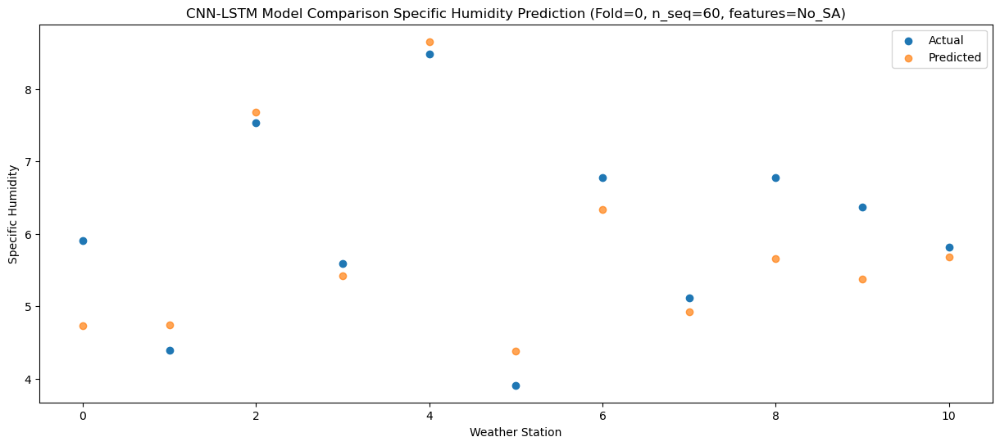

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.61  -0.398427
1                 1   -1.27  -0.951752
2                 2    1.66   1.938811
3                 3   -0.62   0.137342
4                 4    4.26   4.143777
5                 5   -1.35  -1.422171
6                 6    1.03   0.539447
7                 7   -0.67  -0.849541
8                 8    1.48   0.601537
9                 9    0.85  -0.055599
10               10    0.96   0.449121


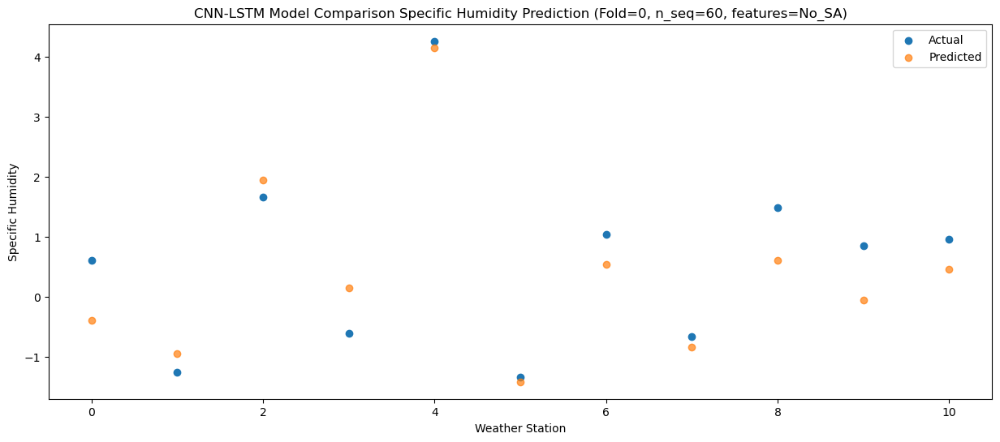

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    3.39   2.273821
1                 1    2.37   2.074122
2                 2    4.06   4.677671
3                 3    2.43   3.246776
4                 4    7.02   6.642131
5                 5    0.07   0.851946
6                 6    2.87   2.890930
7                 7    1.10   1.238785
8                 8    3.07   2.629966
9                 9    1.69   1.453812
10               10    0.96   1.291581


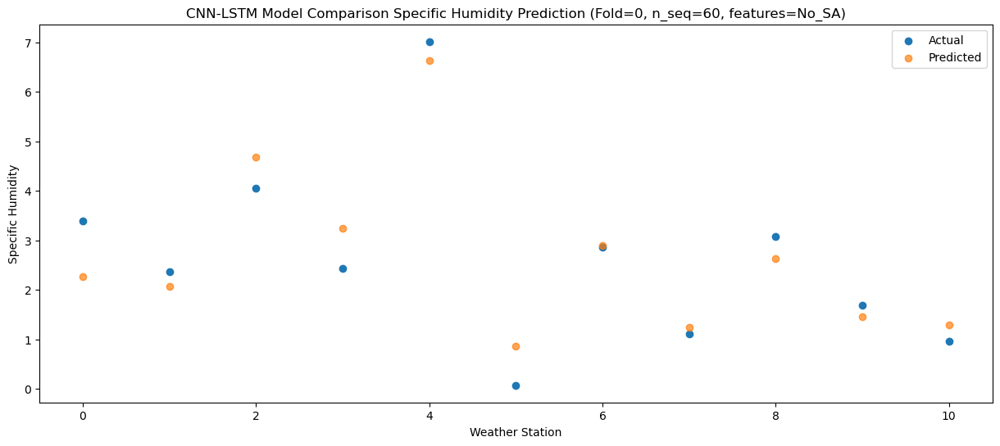

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.303161
1                 1   -2.39  -2.539769
2                 2    0.65   0.373013
3                 3   -2.69  -1.698113
4                 4    1.52   2.091415
5                 5   -3.04  -2.824540
6                 6    0.09  -0.925102
7                 7   -1.41  -2.283519
8                 8   -0.21  -1.231840
9                 9   -0.60  -1.582937
10               10   -1.11  -1.026408


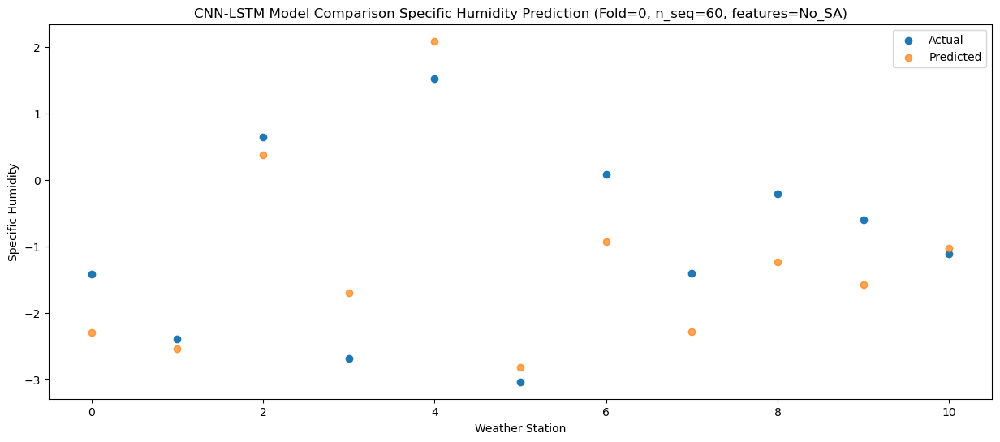

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.76  -1.601416
1                 1   -1.17  -1.515682
2                 2    1.86   1.325976
3                 3   -1.48  -0.820803
4                 4    1.78   2.604102
5                 5   -1.66  -1.918233
6                 6    1.37  -0.031050
7                 7   -0.18  -1.456347
8                 8    0.38  -0.686627
9                 9    0.14  -1.010405
10               10   -0.51  -0.658281


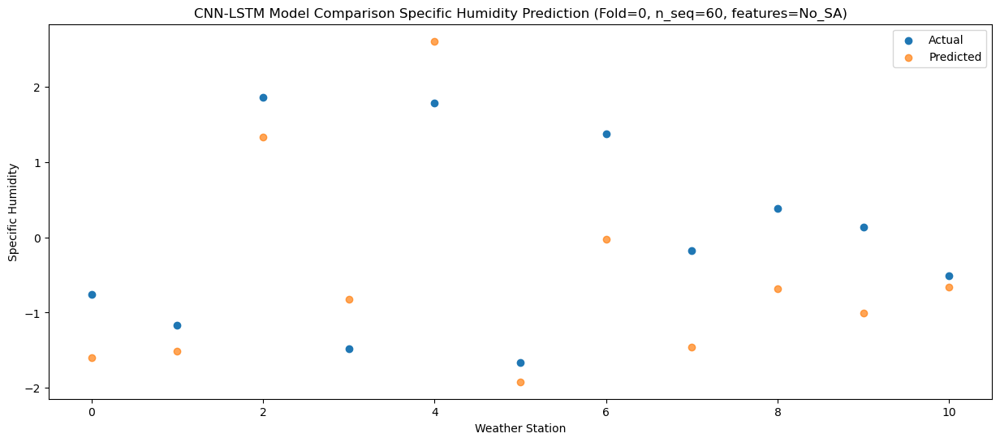

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.64  -0.174160
1                 1    0.74  -0.275235
2                 2    2.57   2.569344
3                 3   -0.39   0.547592
4                 4    3.33   4.118904
5                 5   -0.33  -0.753529
6                 6    2.38   1.168831
7                 7    0.81  -0.267031
8                 8    2.06   0.735442
9                 9    1.42   0.258931
10               10    0.74   0.603130


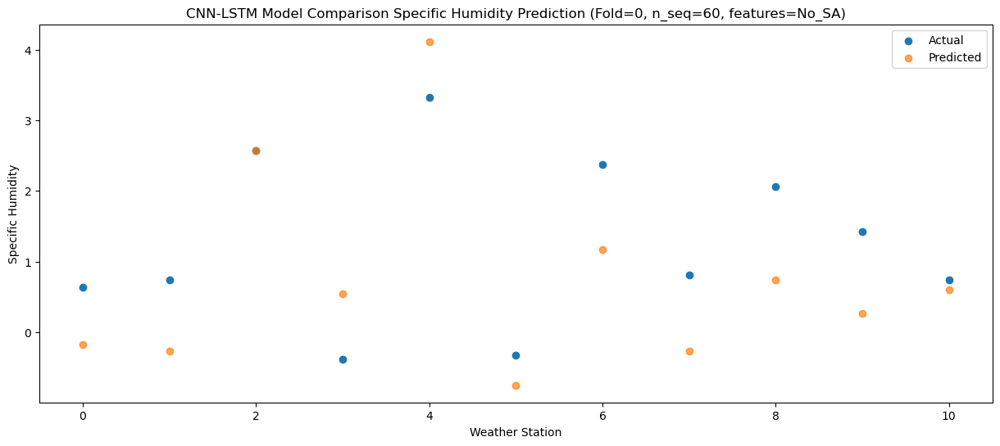

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.11   2.603510
1                 1    2.04   1.931074
2                 2    4.02   4.636152
3                 3    2.53   3.312482
4                 4    7.25   7.170878
5                 5    0.80   0.784952
6                 6    3.38   2.880718
7                 7    1.71   1.287892
8                 8    3.64   3.175162
9                 9    3.04   1.862093
10               10    1.68   1.898792


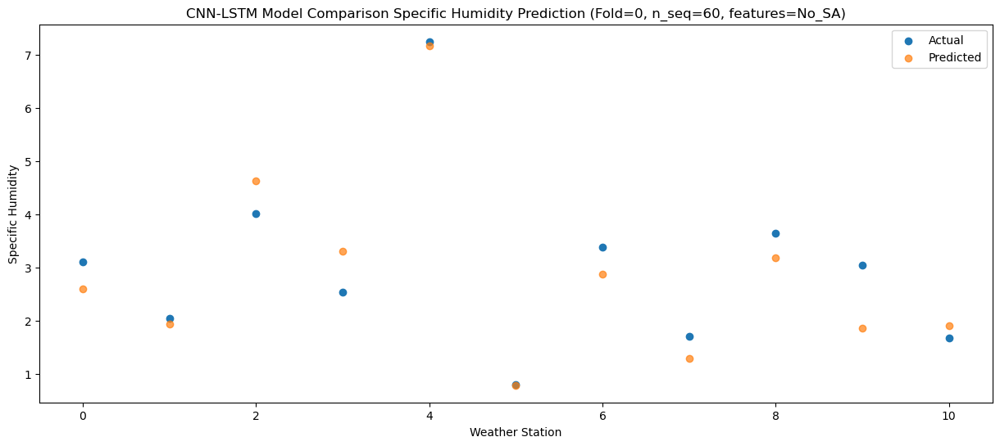

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.88   7.393839
1                 1    6.28   6.545052
2                 2    8.16   9.269264
3                 3    6.77   8.046384
4                 4   10.95  11.850407
5                 5    5.58   5.234068
6                 6    7.74   7.412512
7                 7    6.00   5.772223
8                 8    7.83   7.877222
9                 9    7.65   6.331224
10               10    5.40   6.204358


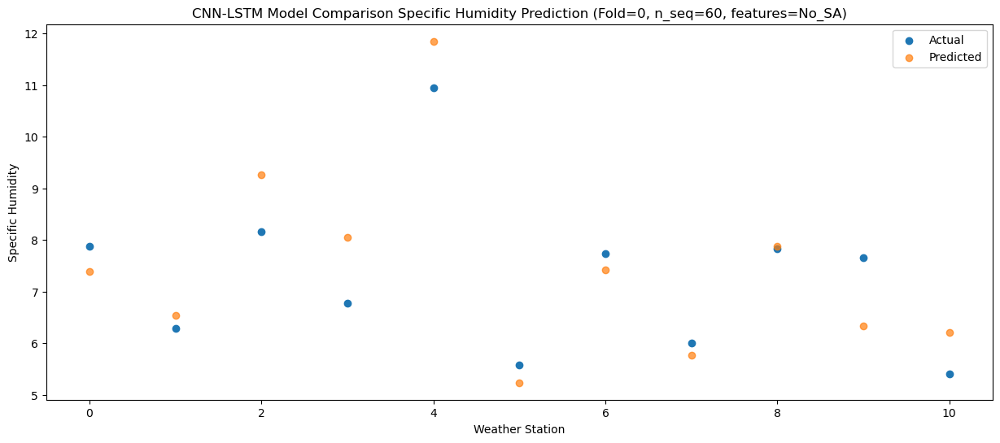

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.80   9.332680
1                 1    8.89   8.256479
2                 2   10.94  10.983863
3                 3    8.78   9.892089
4                 4   11.92  13.912921
5                 5    6.67   6.861930
6                 6    9.62   9.083130
7                 7    7.45   7.430044
8                 8   10.01   9.856742
9                 9    9.33   8.116216
10               10    6.67   8.003648


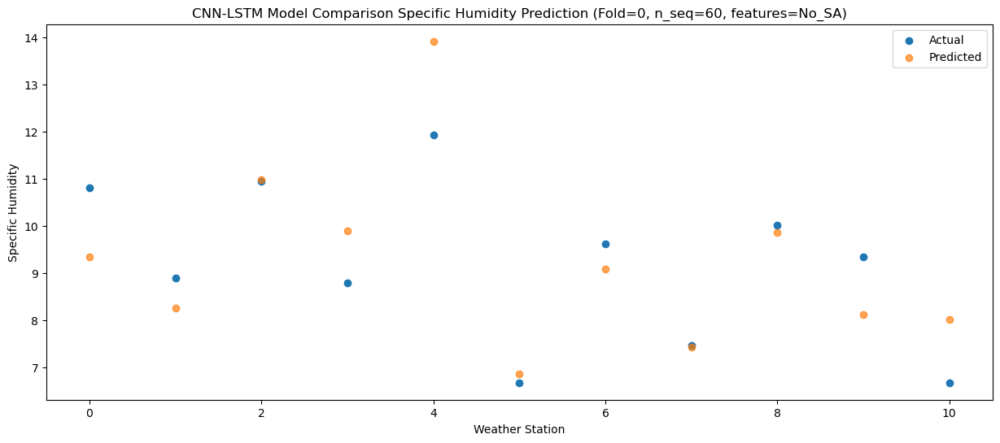

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.38  10.022854
1                 1    9.79   9.552004
2                 2   13.14  12.446348
3                 3    9.99  10.594203
4                 4   11.68  14.182095
5                 5   11.00   8.815345
6                 6   13.24  10.891428
7                 7   10.82   9.389530
8                 8   13.67  10.880805
9                 9   12.91  10.010709
10               10    9.16  10.167090


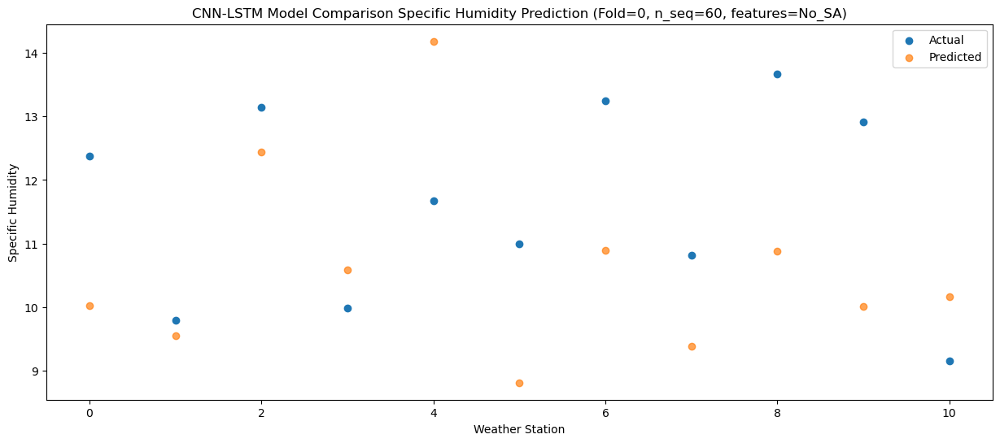

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.96   9.796948
1                 1    9.22   9.204214
2                 2   12.44  12.100044
3                 3    9.27  10.345194
4                 4   12.77  14.050951
5                 5    9.21   8.456968
6                 6   11.89  10.537254
7                 7    9.75   9.049283
8                 8   12.70  10.644666
9                 9   11.37   9.732882
10               10   10.15   9.936475


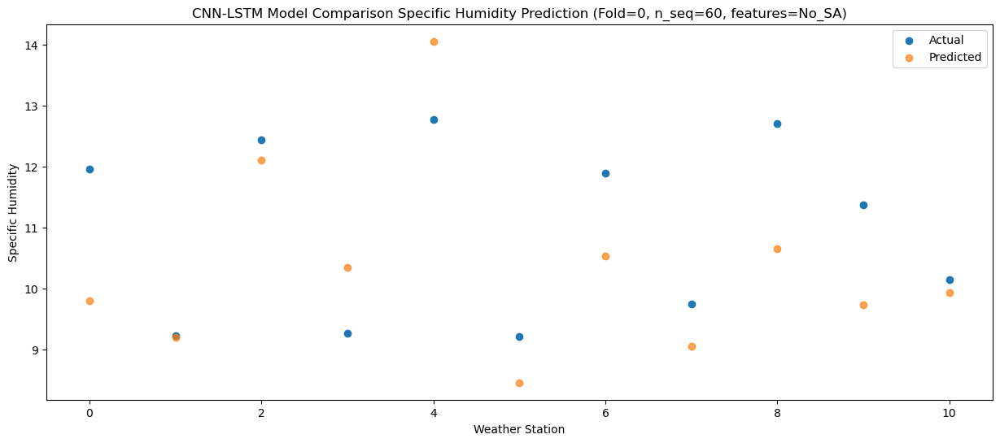

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.41   6.176990
1                 1    6.16   6.011759
2                 2    8.71   8.895126
3                 3    5.89   6.840956
4                 4    9.94  10.341967
5                 5    6.51   5.501162
6                 6    8.45   7.469345
7                 7    6.96   6.022213
8                 8    8.25   7.118829
9                 9    8.31   6.595979
10               10    7.55   6.905325


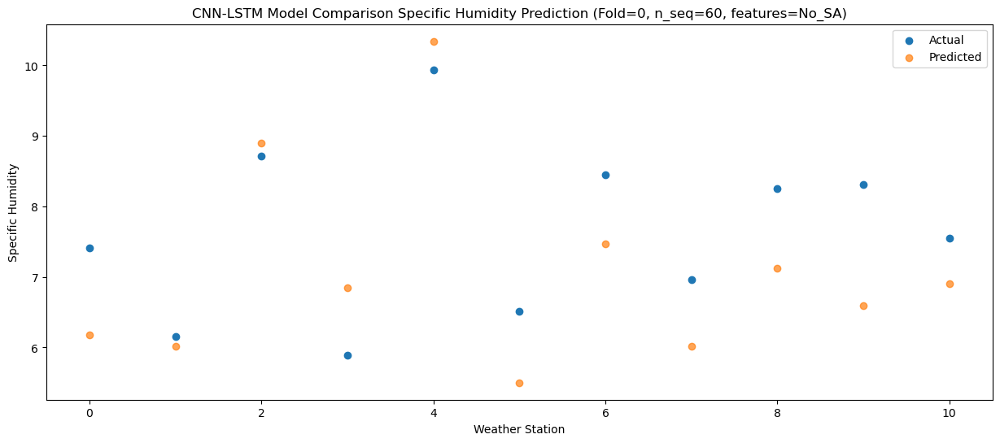

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   0.882645
1                 1    1.02   0.851422
2                 2    3.71   3.769666
3                 3    0.79   1.545434
4                 4    5.14   5.163865
5                 5    1.87   0.641389
6                 6    3.89   2.508605
7                 7    2.54   1.153061
8                 8    3.02   1.985635
9                 9    2.52   1.793021
10               10    2.53   2.335542


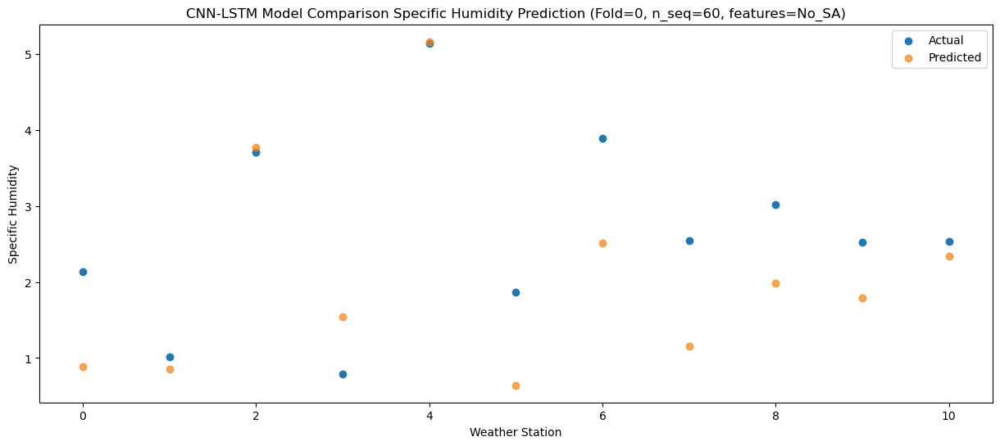

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.59   0.671481
1                 1    0.82   0.785980
2                 2    3.39   3.615560
3                 3    0.27   1.484783
4                 4    5.13   4.799300
5                 5    1.21   0.300473
6                 6    3.29   2.208676
7                 7    1.84   0.750618
8                 8    2.02   1.530917
9                 9    1.80   1.149652
10               10    1.39   1.404232


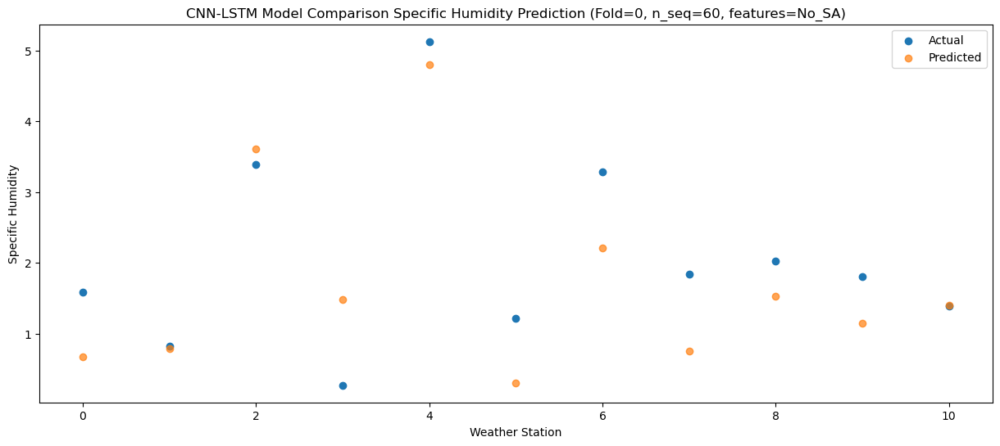

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.13  -0.867581
1                 1   -0.38  -1.124746
2                 2    2.06   1.722481
3                 3   -0.23  -0.184017
4                 4    4.05   3.529882
5                 5   -2.14  -1.642567
6                 6    1.11   0.298714
7                 7   -0.50  -1.129849
8                 8    1.09   0.059160
9                 9    0.87  -0.493703
10               10    0.22  -0.099599


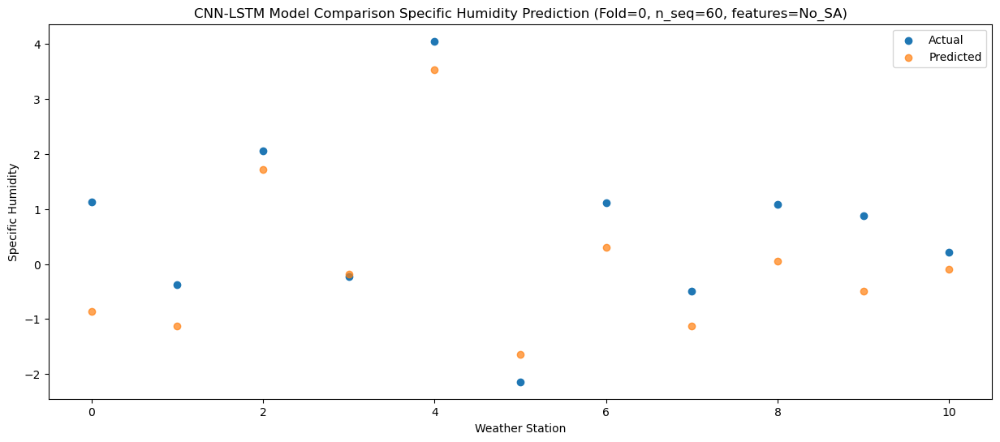

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.73  -0.966026
1                 1   -0.29  -1.020237
2                 2    2.43   1.925241
3                 3   -0.04  -0.333410
4                 4    3.29   3.287369
5                 5   -1.39  -1.173903
6                 6    1.97   0.690442
7                 7    0.43  -0.647662
8                 8    1.69   0.164478
9                 9    1.48   0.013820
10               10    0.62   0.577926


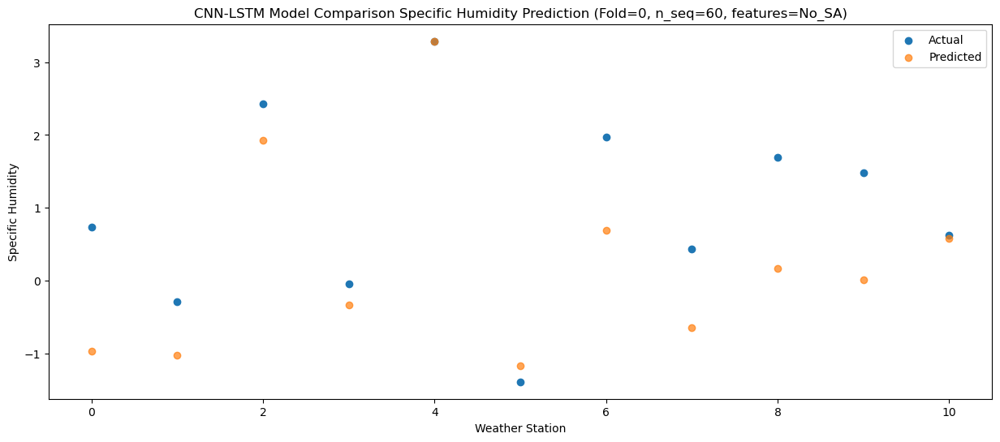

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.35   0.000710
1                 1    1.40   0.067607
2                 2    3.54   2.809225
3                 3    0.63   0.859438
4                 4    3.63   4.251317
5                 5   -0.46  -0.638436
6                 6    2.65   1.296451
7                 7    0.79  -0.229732
8                 8    1.76   0.775453
9                 9    1.25   0.153228
10               10    0.06   0.307639


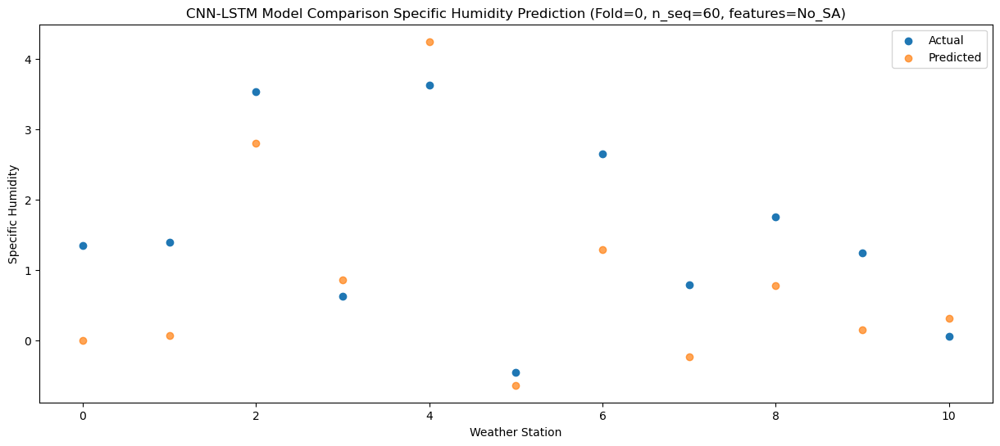

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.95   0.461790
1                 1    1.78   0.098621
2                 2    2.90   2.795344
3                 3    1.71   1.233244
4                 4    5.82   5.000650
5                 5   -0.68  -0.858790
6                 6    2.24   1.148950
7                 7    0.71  -0.414756
8                 8    2.20   1.157974
9                 9    1.35   0.125518
10               10    0.52   0.253602


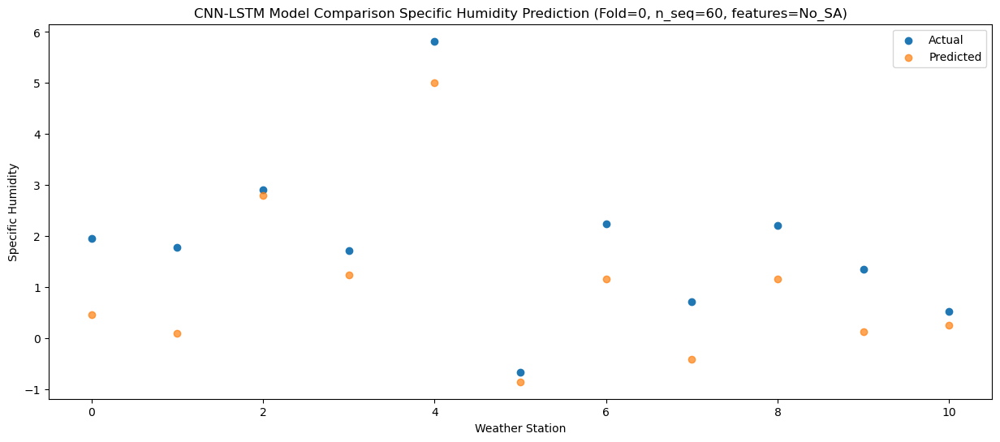

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.94   1.632880
1                 1    2.57   1.720426
2                 2    4.34   4.499696
3                 3    2.11   2.472175
4                 4    6.58   5.860587
5                 5    2.00   1.137843
6                 6    4.45   3.047712
7                 7    2.99   1.560939
8                 8    3.42   2.448530
9                 9    3.08   1.954111
10               10    2.16   2.167440


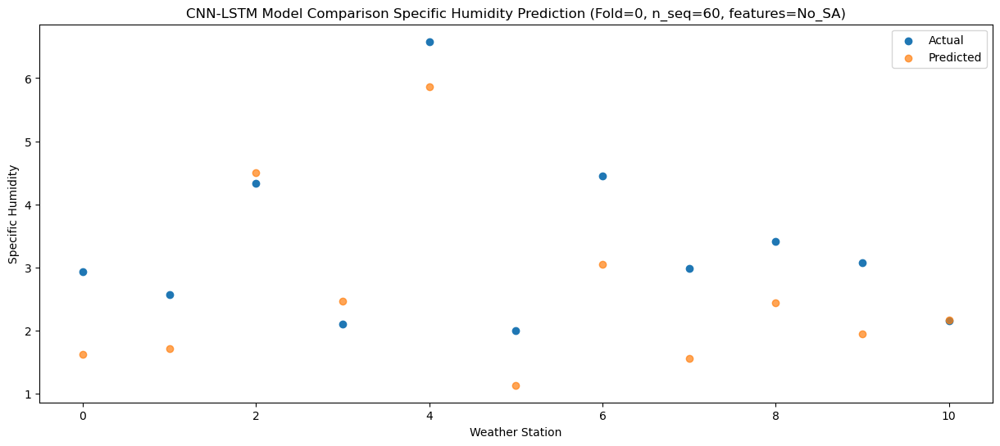

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.62   5.515671
1                 1    4.76   4.078340
2                 2    7.12   6.691395
3                 3    4.96   6.041698
4                 4   10.52  10.605172
5                 5    2.76   2.438835
6                 6    6.04   4.674175
7                 7    4.31   2.980051
8                 8    6.91   5.991982
9                 9    5.52   3.843760
10               10    3.37   3.768687


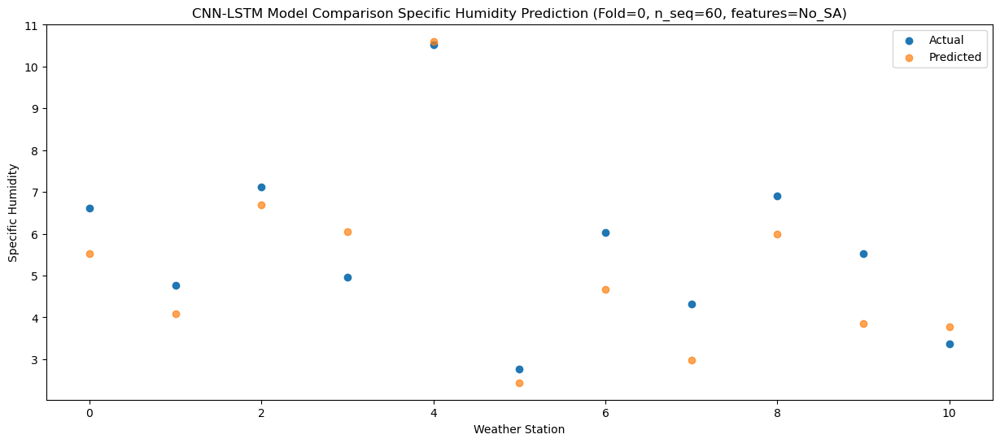

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.41   8.968983
1                 1    8.09   7.582898
2                 2    9.70  10.254476
3                 3    9.11   9.462412
4                 4   14.64  13.878833
5                 5    6.66   6.037051
6                 6    8.77   8.278580
7                 7    6.93   6.602416
8                 8    9.19   9.477623
9                 9    8.14   7.435003
10               10    6.38   7.340005


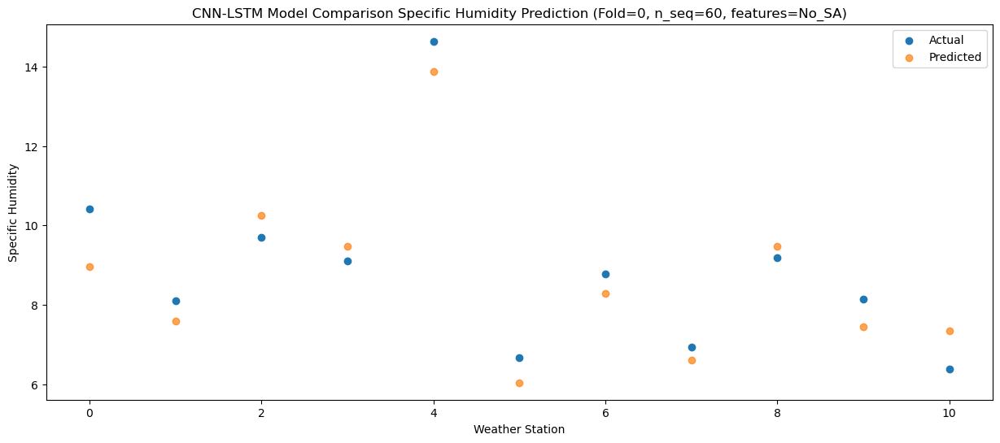

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.70  10.560160
1                 1    9.76  10.037547
2                 2   12.56  12.911654
3                 3   10.14  11.151245
4                 4   13.22  14.803821
5                 5   11.01   9.291104
6                 6   12.51  11.346899
7                 7   11.28   9.847177
8                 8   12.74  11.345798
9                 9   11.96  10.438616
10               10   10.21  10.557045


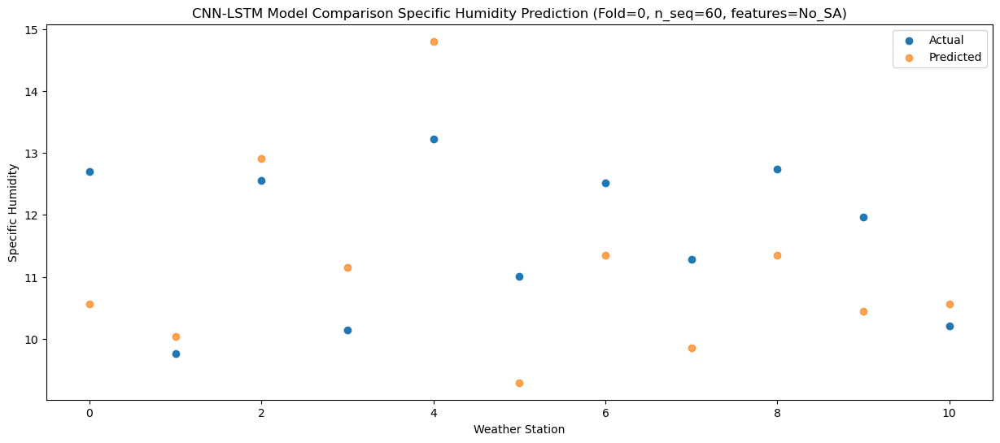

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.32   9.097429
1                 1   10.54   8.382760
2                 2   12.65  11.213775
3                 3    9.89   9.608187
4                 4   11.40  13.549858
5                 5   10.12   7.498731
6                 6   12.14   9.587161
7                 7   10.22   8.054333
8                 8   12.74   9.960644
9                 9   10.66   8.811514
10               10    9.46   8.972615


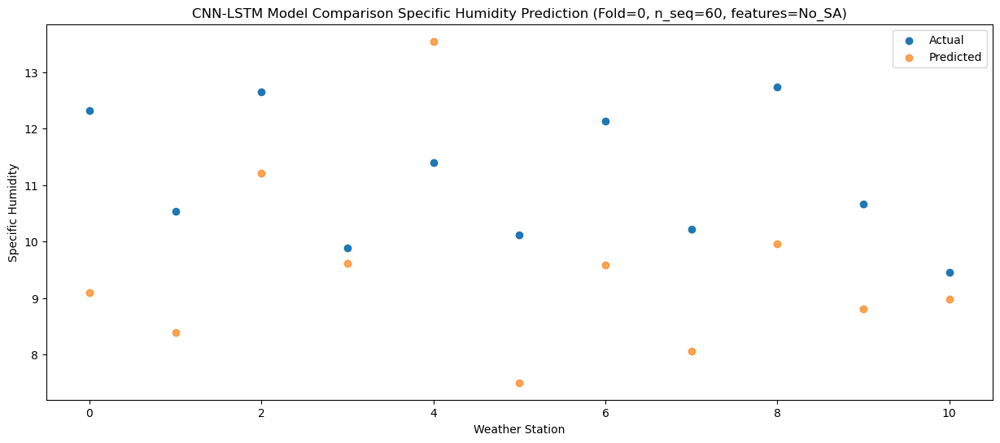

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.35   6.433347
1                 1    6.52   5.934495
2                 2    9.07   8.824883
3                 3    7.71   6.962633
4                 4   11.36  10.828572
5                 5    7.00   5.361323
6                 6    9.20   7.362655
7                 7    7.42   5.915410
8                 8    8.67   7.420303
9                 9    7.94   6.657587
10               10    8.15   6.985616


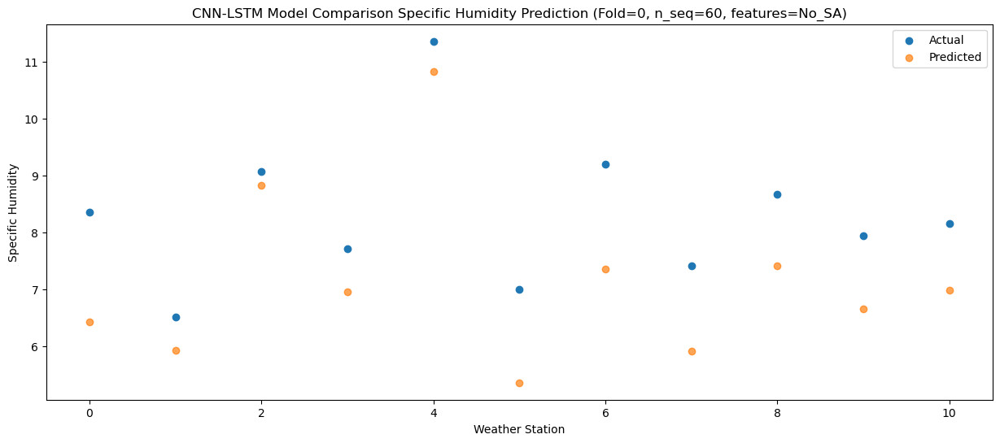

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.32   2.333989
1                 1    1.82   1.790013
2                 2    5.16   4.738509
3                 3    3.14   2.790109
4                 4    7.61   6.837327
5                 5    2.60   1.439037
6                 6    4.94   3.393812
7                 7    3.67   2.025182
8                 8    4.61   3.480151
9                 9    4.70   2.906768
10               10    4.39   3.442893


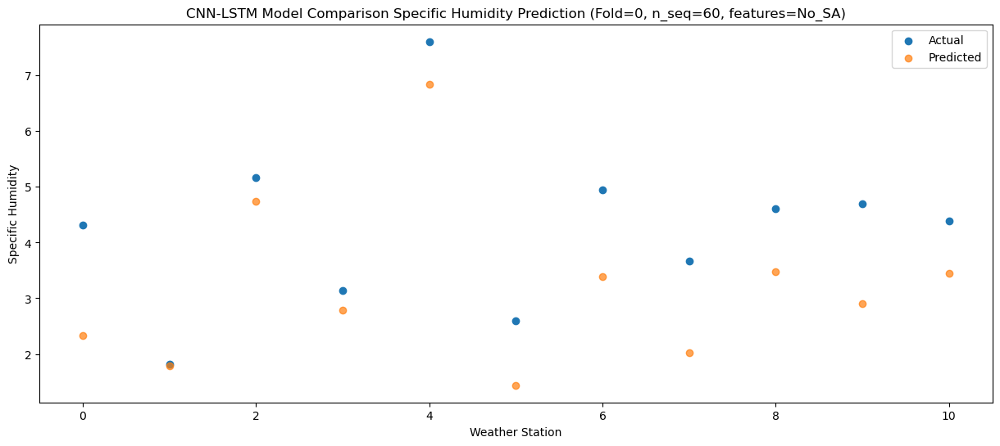

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.14  -0.427901
1                 1   -0.36  -1.126634
2                 2    2.63   1.718246
3                 3    0.15   0.074999
4                 4    4.81   4.277568
5                 5   -0.42  -1.769547
6                 6    1.61   0.228148
7                 7    0.15  -1.214342
8                 8    1.95   0.570156
9                 9    1.35  -0.342646
10               10    0.98   0.077424


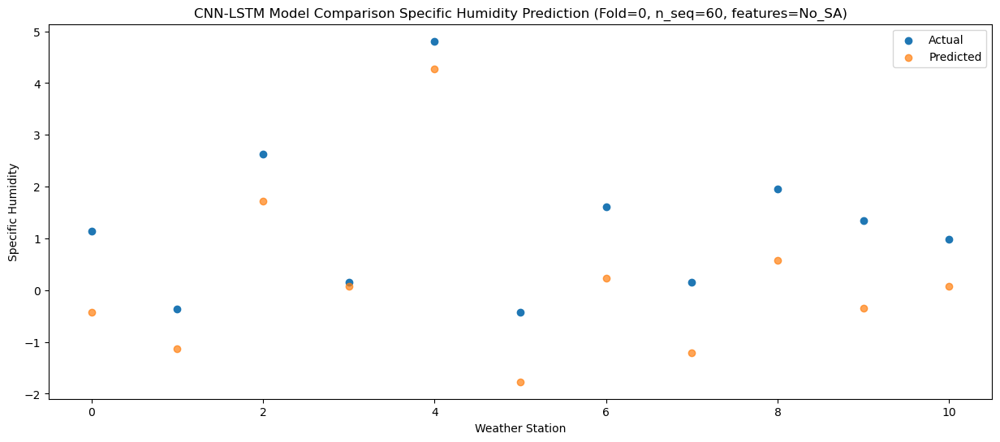

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -2.000865
1                 1   -1.80  -2.538807
2                 2    1.82   0.493634
3                 3   -1.25  -1.649186
4                 4    2.95   2.560094
5                 5   -1.24  -2.585802
6                 6    1.54  -0.688035
7                 7    0.35  -1.960618
8                 8    1.34  -0.622271
9                 9    1.54  -0.920740
10               10    1.51  -0.137929


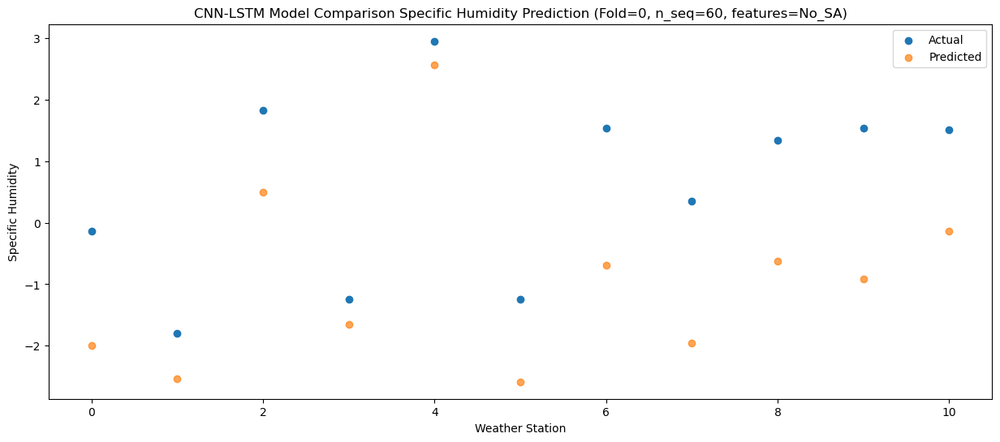

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.96  -3.314298
1                 1   -2.58  -3.622184
2                 2    1.02  -0.630774
3                 3   -2.17  -2.858185
4                 4    1.77   1.204100
5                 5   -2.03  -3.650173
6                 6    0.87  -1.795048
7                 7   -0.34  -3.077257
8                 8    0.16  -1.964320
9                 9    0.57  -2.144820
10               10   -0.01  -1.381118


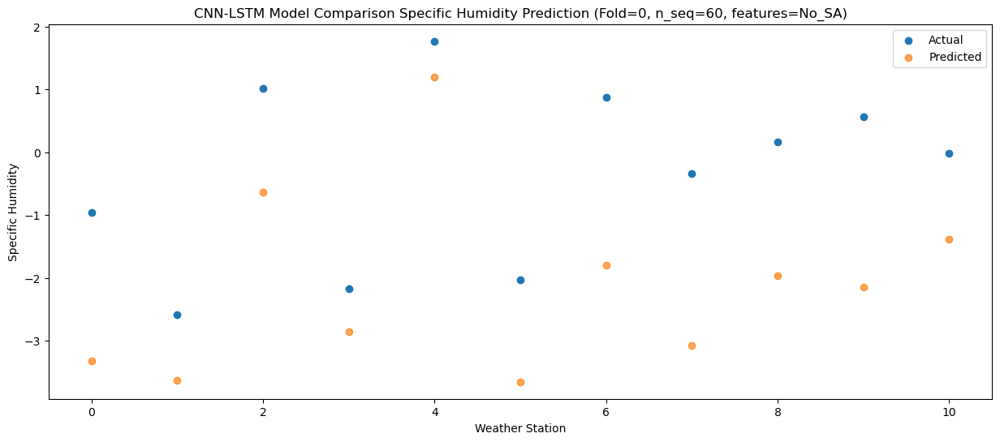

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.94  -1.810023
1                 1   -1.36  -2.882718
2                 2    1.66   0.037888
3                 3   -0.39  -1.515355
4                 4    4.34   3.119451
5                 5   -2.13  -3.413342
6                 6    1.03  -1.396301
7                 7   -0.31  -2.770613
8                 8    1.92  -0.621667
9                 9    0.92  -1.593373
10               10    0.52  -0.952736


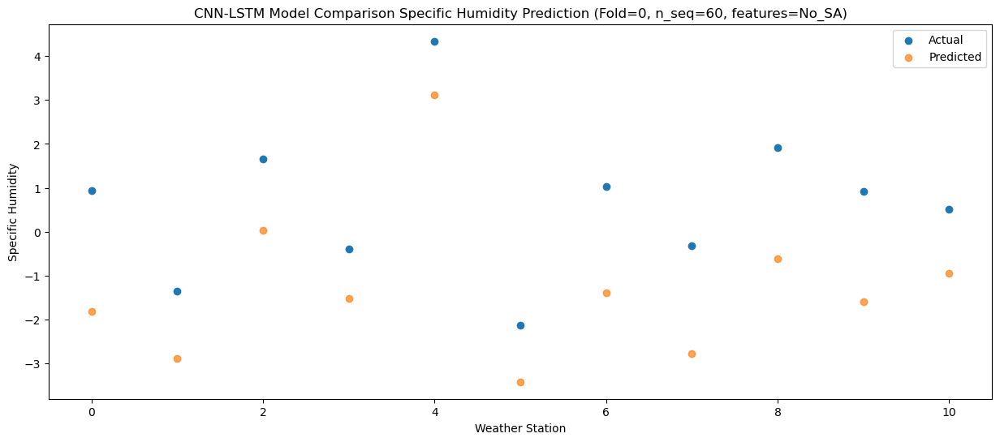

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.20   0.221727
1                 1    0.49  -0.574231
2                 2    3.29   2.184771
3                 3    1.40   0.778507
4                 4    6.08   5.016603
5                 5   -0.21  -1.493463
6                 6    2.48   0.552825
7                 7    0.83  -0.967939
8                 8    2.79   1.062180
9                 9    2.05  -0.147658
10               10    1.21   0.116447


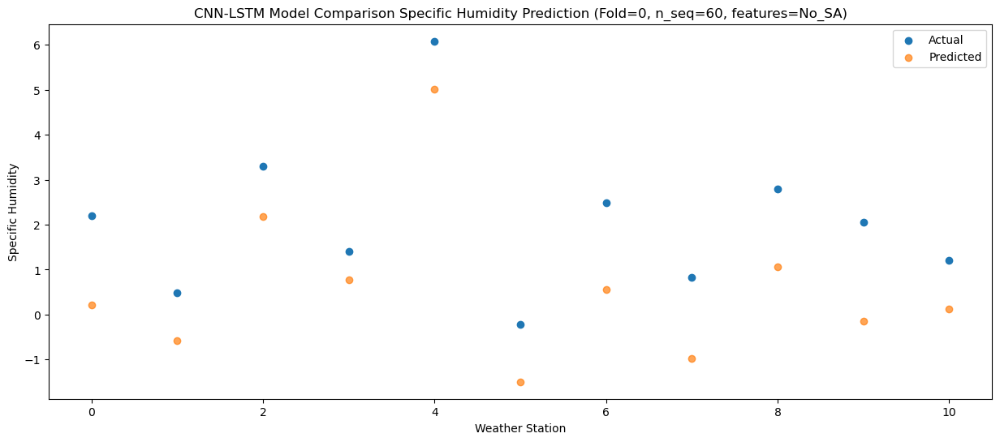

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.51   2.508372
1                 1    2.40   1.346174
2                 2    5.03   4.140174
3                 3    3.45   2.928937
4                 4    8.32   7.377795
5                 5    1.13   0.298358
6                 6    4.54   2.430622
7                 7    2.85   0.896575
8                 8    5.02   3.345136
9                 9    4.42   1.863220
10               10    2.77   2.100720


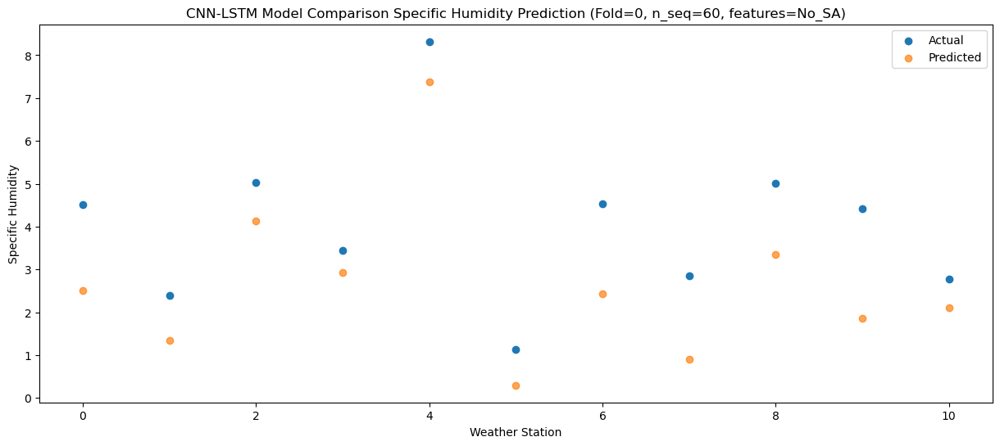

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.98   6.989176
1                 1    6.98   5.877266
2                 2    8.78   8.567485
3                 3    8.02   7.553309
4                 4   12.57  11.711983
5                 5    5.19   4.438848
6                 6    8.45   6.649571
7                 7    6.67   4.987965
8                 8    9.30   7.531232
9                 9    8.22   5.733973
10               10    5.82   5.634273


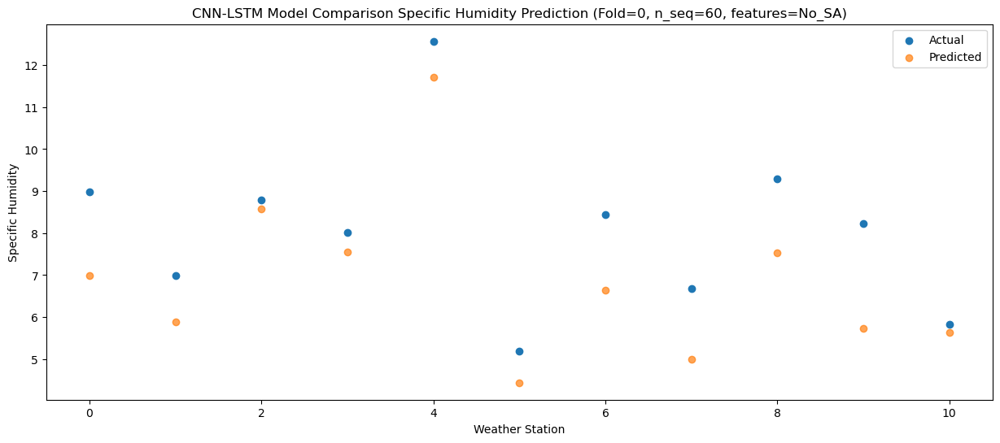

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.37   8.745882
1                 1    8.58   7.057042
2                 2    9.91   9.852608
3                 3    9.53   8.997588
4                 4   14.22  13.710219
5                 5    7.16   5.662468
6                 6   10.27   7.949687
7                 7    8.36   6.342743
8                 8   11.72   9.523442
9                 9    9.29   7.502281
10               10    8.32   7.615854


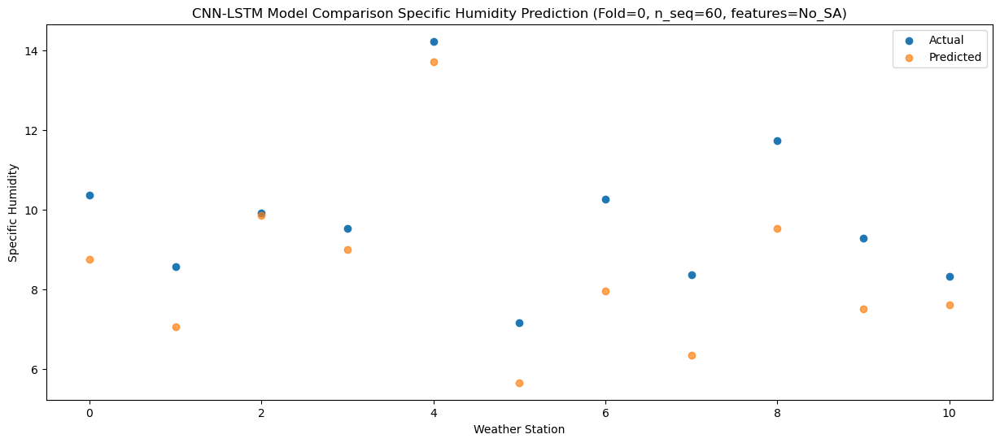

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.66   9.233892
1                 1   10.75   8.512294
2                 2   13.14  11.356747
3                 3   10.93   9.756868
4                 4   13.96  13.624186
5                 5    9.95   7.584392
6                 6   12.80   9.703944
7                 7   11.25   8.164309
8                 8   12.90  10.068466
9                 9   10.79   8.913077
10               10    9.39   9.034467


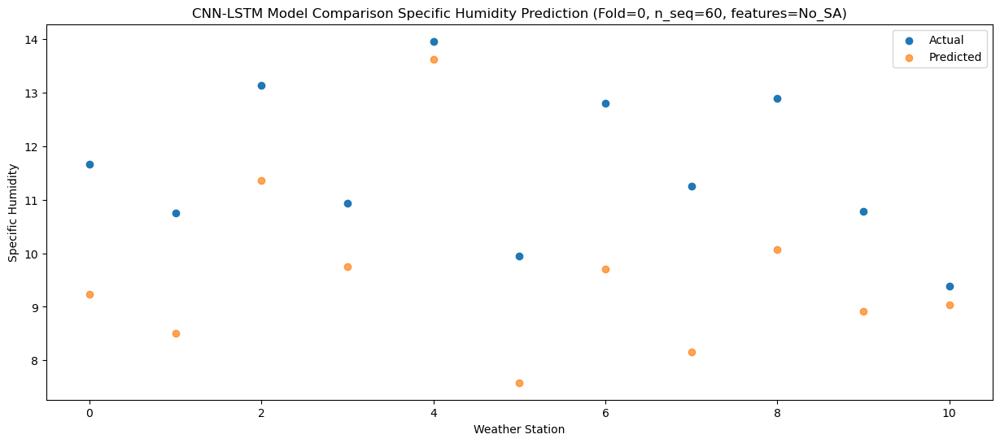

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.83   8.394080
1                 1    9.25   7.314861
2                 2   11.45  10.179076
3                 3    9.79   8.752257
4                 4   13.61  13.015624
5                 5    8.94   6.336828
6                 6   11.64   8.501859
7                 7    9.82   6.974517
8                 8   11.23   9.351034
9                 9    9.99   7.982371
10               10    9.15   8.226278


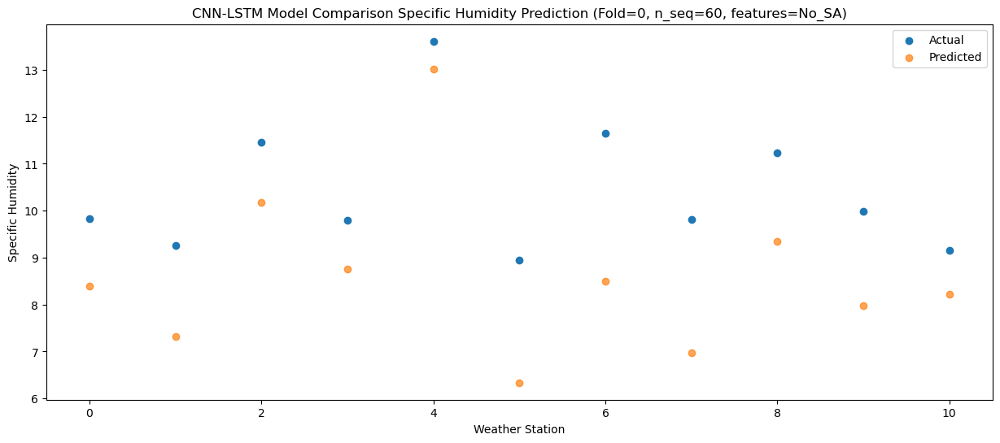

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.36   5.787123
1                 1    8.38   5.415634
2                 2    9.76   8.130253
3                 3    8.23   6.516842
4                 4   11.12  10.194307
5                 5    6.99   4.354337
6                 6    9.91   6.426202
7                 7    8.23   4.819415
8                 8    9.19   6.515218
9                 9    7.64   5.382682
10               10    7.44   5.404833


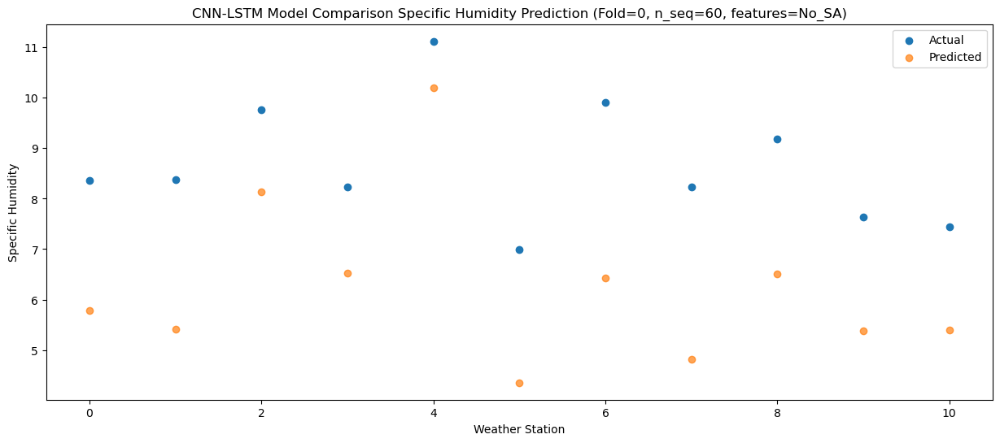

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.98   1.233167
1                 1    2.98   0.727021
2                 2    5.63   3.501771
3                 3    3.04   1.840000
4                 4    7.51   5.823270
5                 5    1.70  -0.120583
6                 6    5.21   1.912115
7                 7    3.34   0.385760
8                 8    4.59   2.168073
9                 9    4.11   1.161596
10               10    3.24   1.428448


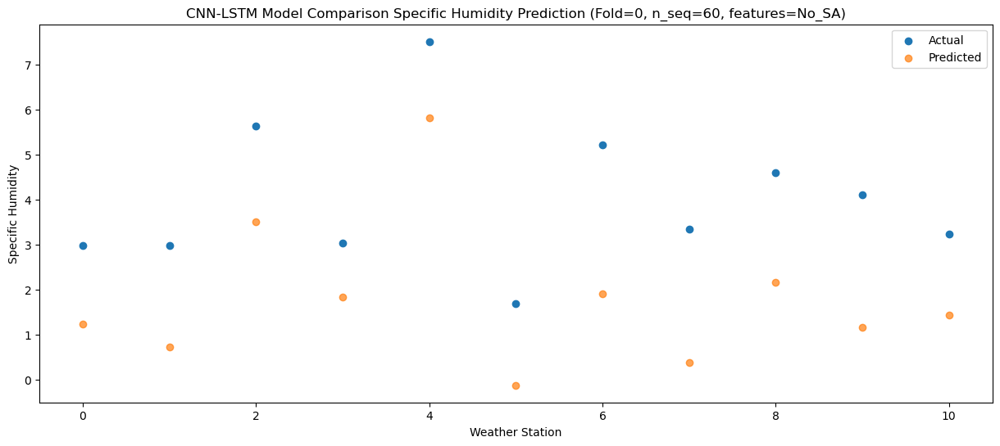

f, t:
[[ 3.000e-02 -8.600e-01  2.230e+00 -4.800e-01  4.290e+00 -8.100e-01
   1.380e+00 -5.000e-02  1.270e+00  7.800e-01  4.900e-01]
 [ 4.600e-01 -5.300e-01  2.480e+00  6.000e-02  3.040e+00 -8.500e-01
   1.500e+00  2.000e-01  1.360e+00  1.190e+00  6.100e-01]
 [ 3.700e-01 -9.700e-01  2.310e+00  3.000e-01  3.830e+00 -1.330e+00
   1.420e+00  2.300e-01  9.600e-01  6.900e-01  2.300e-01]
 [ 1.000e-02 -2.400e-01  2.860e+00  4.400e-01  3.220e+00 -1.440e+00
   1.780e+00  4.500e-01  9.500e-01  3.700e-01 -2.800e-01]
 [ 3.300e+00  3.640e+00  5.460e+00  4.750e+00  7.670e+00  3.200e-01
   3.410e+00  1.750e+00  3.210e+00  2.330e+00  1.320e+00]
 [ 2.950e+00  1.850e+00  4.210e+00  3.600e+00  7.390e+00  6.600e-01
   3.190e+00  1.690e+00  3.450e+00  2.390e+00  1.680e+00]
 [ 5.920e+00  4.170e+00  7.070e+00  5.750e+00  9.970e+00  3.790e+00
   6.290e+00  3.680e+00  6.670e+00  5.530e+00  4.580e+00]
 [ 9.680e+00  7.850e+00  1.098e+01  8.240e+00  1.233e+01  7.520e+00
   1.001e+01  8.350e+00  1.032e+01  8.220e+0

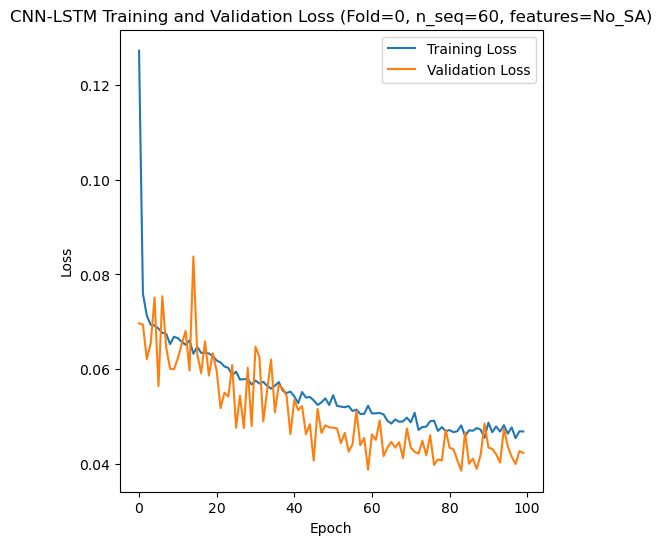

[[ 6.43  5.26  5.95 ... 15.04 10.09  9.76]
 [ 4.92  3.81  4.91 ... 12.52  8.69  7.9 ]
 [ 5.77  4.38  5.81 ... 14.28  9.78  9.52]
 ...
 [ 4.32  3.52  5.54 ... 12.    6.96  7.01]
 [ 3.07  3.12  5.08 ... 11.47  8.11  7.14]
 [ 2.37  2.06  3.5  ...  9.32  6.33  5.39]]
Epoch 1/100
84/84 [==============================] - 13s 79ms/step - loss: 0.1251 - accuracy: 0.3690 - mae: 0.1057 - rmse: 0.1251 - mape: 22.6133 - pearson: 0.6070 - val_loss: 0.0753 - val_accuracy: 0.5000 - val_mae: 0.0599 - val_rmse: 0.0753 - val_mape: 13.9324 - val_pearson: 0.7023
Epoch 2/100
84/84 [==============================] - 3s 32ms/step - loss: 0.0741 - accuracy: 0.3452 - mae: 0.0588 - rmse: 0.0741 - mape: 13.3322 - pearson: 0.7491 - val_loss: 0.0696 - val_accuracy: 0.1000 - val_mae: 0.0540 - val_rmse: 0.0696 - val_mape: 12.0331 - val_pearson: 0.7471
Epoch 3/100
84/84 [==============================] - 3s 32ms/step - loss: 0.0702 - accuracy: 0.5119 - mae: 0.0554 - rmse: 0.0702 - mape: 12.4045 - pearson: 0.7637 - va

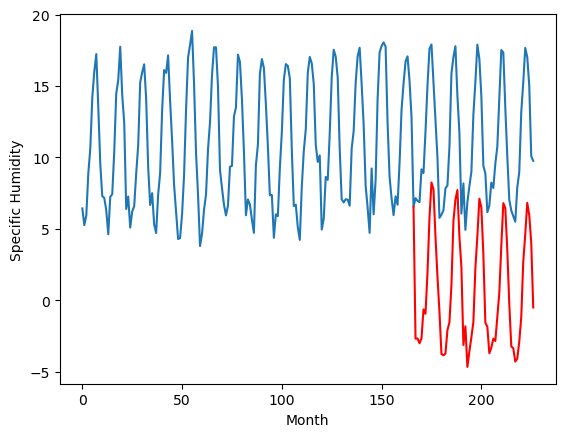

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.11		1.55		0.44
1.16		1.47		0.31
0.91		1.17		0.26
1.43		1.46		0.03
3.66		3.63		-0.03
2.07		3.29		1.22
5.08		6.25		1.17
8.88		10.05		1.17
10.92		12.55		1.63
10.97		11.84		0.87
8.07		8.57		0.50
5.40		5.55		0.15
2.34		3.23		0.89
-0.25		0.31		0.56
-0.23		0.25		0.48
-0.04		0.27		0.31
1.49		2.06		0.57
1.85		2.61		0.76
4.77		5.38		0.61
8.75		9.79		1.04
10.62		11.29		0.67
10.83		11.86		1.03
7.88		8.50		0.62
5.84		6.31		0.47
0.25		0.96		0.71
2.42		2.27		-0.15
-0.58		-0.67		-0.09
0.37		0.36		-0.01
1.05		1.38		0.33
2.11		2.61		0.50
6.28		6.44		0.16
8.68		8.72		0.04
11.35		11.19		-0.16
10.94		10.61		-0.33
7.58		7.27		-0.31
2.69		2.42		-0.27
2.21		2.10		-0.11
0.62		0.32		-0.30
1.03		0.65		-0.38
2.15		1.28		-0.87
1.28		1.21		-0.07
2.88		2.79		-0.09
5.62		4.83		-0.79
7.97		8.12		0.15
10.93		10.86		-0.07
11.06		10.52		-0.54
7.95		7.52		-0.43
4.10		3.72		-0.38
1.09		0.79		-0.30
0.51		0.55		0.04
-0.26		-0.42	

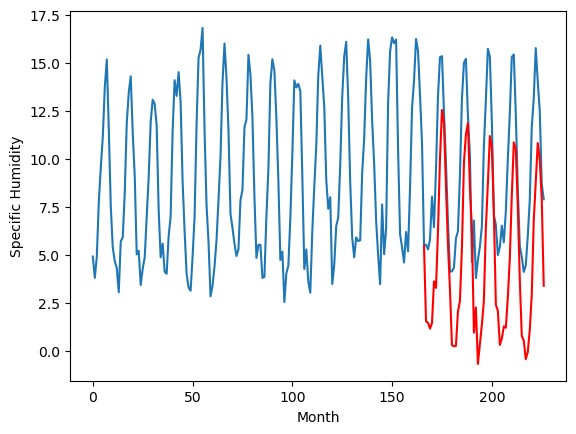

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		0.05		0.10
0.86		-0.09		-0.95
0.35		-0.34		-0.69
0.74		-0.05		-0.79
3.90		2.45		-1.45
2.28		1.98		-0.30
5.05		4.95		-0.10
8.90		8.64		-0.26
11.45		11.03		-0.42
10.97		10.20		-0.77
8.02		7.11		-0.91
5.26		3.90		-1.36
2.08		1.55		-0.53
-0.69		-1.54		-0.85
-0.54		-1.49		-0.95
-0.54		-1.47		-0.93
2.08		0.54		-1.54
1.79		0.94		-0.85
4.63		4.03		-0.60
9.15		8.27		-0.88
10.74		9.70		-1.04
10.96		10.06		-0.90
8.20		6.70		-1.50
5.45		4.33		-1.12
-0.05		-0.92		-0.87
2.59		0.74		-1.85
-1.29		-2.62		-1.33
-0.26		-1.58		-1.32
0.53		-0.53		-1.06
2.29		0.98		-1.31
6.65		4.85		-1.80
9.74		7.21		-2.53
11.37		9.42		-1.95
10.50		8.82		-1.68
6.99		5.34		-1.65
1.88		0.39		-1.49
1.51		0.13		-1.38
0.82		-1.55		-2.37
0.79		-1.35		-2.14
1.84		-0.51		-2.35
1.37		-0.47		-1.84
2.73		0.91		-1.82
6.03		3.48		-2.55
8.68		6.70		-1.98
11.82		8.95		-2.87
11.75		8.70		-3.05
7.94		5.51		-2.43
3.43		1.58		-1.85
0.88		-1.1

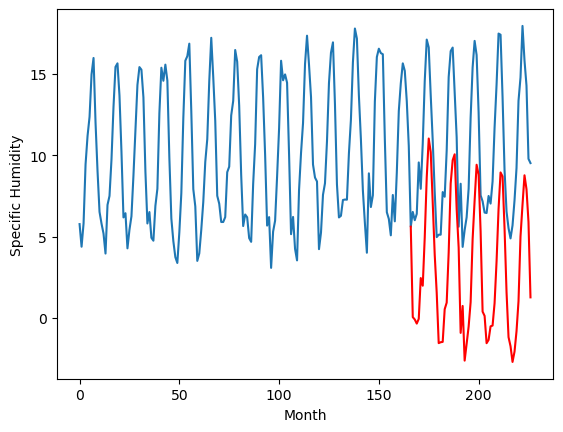

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.89		2.09		0.20
0.69		1.72		1.03
1.59		1.59		0.00
0.89		1.69		0.80
5.25		4.43		-0.82
4.91		3.99		-0.92
6.89		6.82		-0.07
9.01		9.97		0.96
11.52		12.02		0.50
10.41		10.91		0.50
8.83		8.22		-0.61
5.43		4.90		-0.53
3.33		2.99		-0.34
0.78		0.24		-0.54
0.44		0.47		0.03
0.51		0.26		-0.25
3.15		2.38		-0.77
4.49		2.63		-1.86
8.38		5.99		-2.39
11.57		9.54		-2.03
12.05		10.95		-1.10
12.39		10.84		-1.55
9.30		7.63		-1.67
7.05		5.27		-1.78
2.60		1.18		-1.42
5.52		2.55		-2.97
-0.13		-0.70		-0.57
0.04		0.03		-0.01
1.72		1.13		-0.59
5.88		2.79		-3.09
9.69		6.29		-3.40
10.74		8.75		-1.99
11.66		10.35		-1.31
11.91		9.96		-1.95
8.62		6.54		-2.08
3.66		2.06		-1.60
3.16		1.47		-1.69
2.35		0.27		-2.08
1.93		0.23		-1.70
2.71		1.00		-1.71
4.26		1.41		-2.85
4.63		2.35		-2.28
8.41		5.85		-2.56
11.81		8.69		-3.12
12.37		9.78		-2.59
10.70		9.84		-0.86
9.50		6.74		-2.76
6.08		3.08		-3.00
2.75		0.69		-2.06
1.11		-0.14		

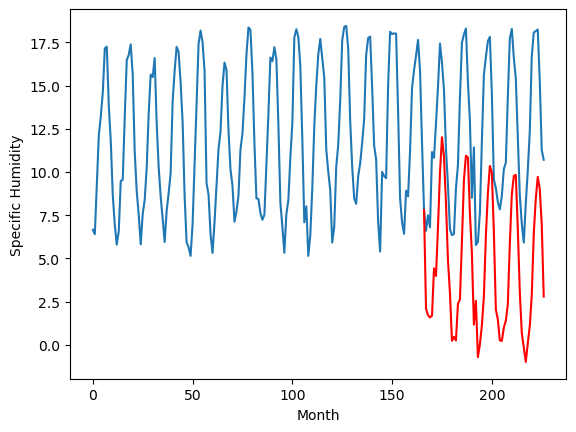

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.44		2.99		0.55
1.20		2.60		1.40
2.11		2.47		0.36
1.43		2.56		1.13
6.16		5.34		-0.82
5.85		4.89		-0.96
7.97		7.76		-0.21
10.26		10.92		0.66
12.86		13.00		0.14
11.41		11.81		0.40
9.92		9.12		-0.80
6.07		5.72		-0.35
3.59		3.84		0.25
0.77		1.09		0.32
0.52		1.32		0.80
0.56		1.08		0.52
3.28		3.25		-0.03
4.54		3.51		-1.03
8.57		6.92		-1.65
11.98		10.48		-1.50
12.16		11.88		-0.28
12.20		11.76		-0.44
9.10		8.51		-0.59
7.15		6.12		-1.03
2.56		2.01		-0.55
5.49		3.40		-2.09
-0.05		0.10		0.15
0.15		0.82		0.67
1.85		1.94		0.09
5.95		3.65		-2.30
9.83		7.19		-2.64
10.95		9.67		-1.28
11.70		11.23		-0.47
12.08		10.85		-1.23
8.73		7.39		-1.34
3.83		2.86		-0.97
3.45		2.28		-1.17
2.63		1.08		-1.55
2.15		1.03		-1.12
2.75		1.80		-0.95
4.45		2.23		-2.22
4.90		3.16		-1.74
8.57		6.75		-1.82
11.83		9.61		-2.22
11.91		10.66		-1.25
10.51		10.70		0.19
9.76		7.57		-2.19
6.37		3.89		-2.48
3.03		1.50		-1.53
1.31		0.63		-0.

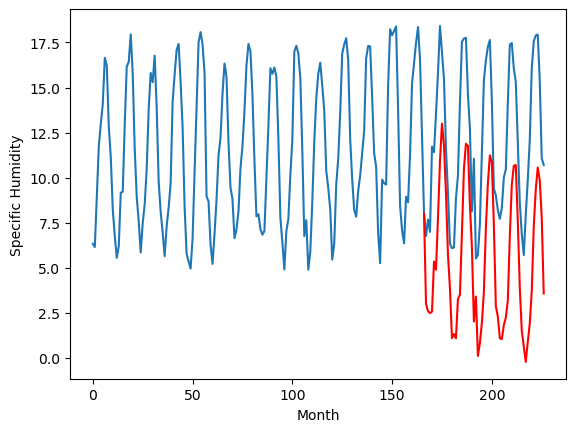

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.76		4.57		-0.19
3.28		4.36		1.08
3.00		4.20		1.20
3.18		4.11		0.93
5.85		6.05		0.20
4.84		6.05		1.21
7.52		8.13		0.61
9.34		10.35		1.01
10.33		11.60		1.27
9.10		11.22		2.12
8.67		8.99		0.32
5.16		6.64		1.48
4.60		5.25		0.65
2.16		3.42		1.26
2.99		3.83		0.84
2.36		3.54		1.18
3.15		4.79		1.64
4.45		4.93		0.48
8.76		7.44		-1.32
10.93		9.93		-1.00
12.26		11.50		-0.76
12.48		11.12		-1.36
8.94		8.76		-0.18
5.83		7.03		1.20
3.99		4.98		0.99
2.94		4.99		2.05
1.67		3.27		1.60
1.55		3.47		1.92
2.10		4.52		2.42
4.37		5.27		0.90
6.14		7.51		1.37
8.74		9.79		1.05
9.69		11.23		1.54
11.80		11.19		-0.61
10.53		8.61		-1.92
7.34		5.63		-1.71
4.47		4.25		-0.22
3.80		3.66		-0.14
2.25		3.66		1.41
2.28		3.89		1.61
3.33		4.42		1.09
3.59		5.11		1.52
7.96		8.19		0.23
7.91		10.17		2.26
10.08		10.59		0.51
10.23		11.30		1.07
9.87		9.01		-0.86
7.89		6.34		-1.55
5.26		4.38		-0.88
3.39		4.08		0.69
2.24		3.69		1.45
2.65		

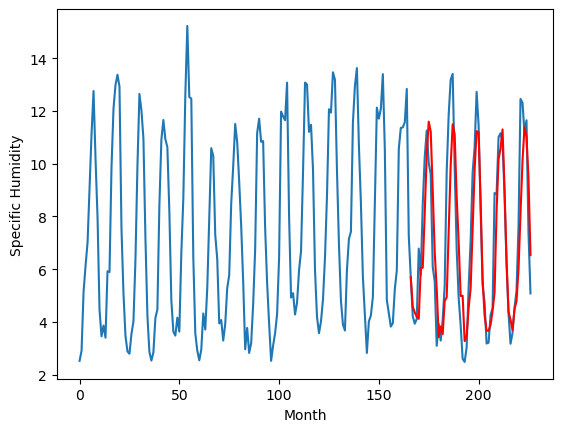

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.55		-2.39		0.16
-2.52		-2.44		0.08
-2.94		-2.77		0.17
-2.46		-2.47		-0.01
-0.49		-0.42		0.07
-1.14		-0.72		0.42
2.06		2.24		0.18
5.70		6.08		0.38
8.14		8.62		0.48
8.16		7.98		-0.18
4.85		4.63		-0.22
2.36		1.70		-0.66
-0.75		-0.64		0.11
-3.47		-3.51		-0.04
-3.58		-3.62		-0.04
-3.46		-3.58		-0.12
-1.90		-1.88		0.02
-1.28		-1.28		0.00
1.65		1.38		-0.27
6.00		5.86		-0.14
8.50		7.38		-1.12
8.79		8.03		-0.76
5.44		4.68		-0.76
3.31		2.55		-0.76
-2.62		-2.86		-0.24
-0.75		-1.66		-0.91
-3.75		-4.46		-0.71
-2.62		-3.43		-0.81
-1.87		-2.41		-0.54
-0.68		-1.28		-0.60
3.58		2.53		-1.05
6.30		4.78		-1.52
9.29		7.36		-1.93
8.20		6.78		-1.42
4.72		3.48		-1.24
-0.34		-1.34		-1.00
-0.83		-1.68		-0.85
-2.73		-3.50		-0.77
-2.37		-3.12		-0.75
-1.17		-2.55		-1.38
-1.93		-2.67		-0.74
-0.12		-1.01		-0.89
2.44		0.82		-1.62
5.02		4.13		-0.89
8.64		7.07		-1.57
8.53		6.69		-1.84
5.56		3.76		-1.80
1.31		-0.01		-1.32
-

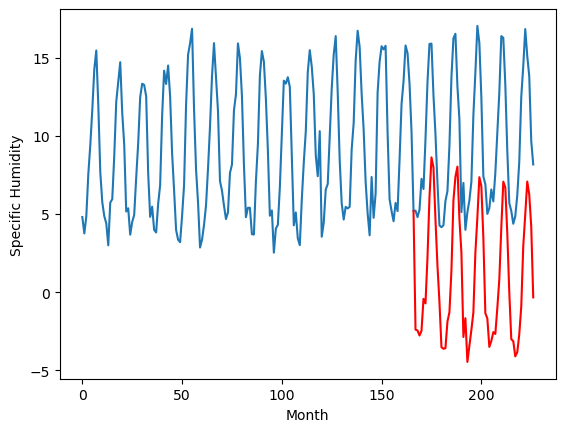

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.26		0.96		-0.30
0.93		0.48		-0.45
0.85		0.33		-0.52
0.73		0.36		-0.37
3.39		3.05		-0.34
3.65		2.64		-1.01
6.55		5.84		-0.71
10.38		9.30		-1.08
13.46		11.81		-1.65
11.29		10.25		-1.04
9.49		7.17		-2.32
4.67		3.51		-1.16
2.65		1.77		-0.88
0.33		-0.86		-1.19
0.20		-0.82		-1.02
-0.32		-1.18		-0.86
2.41		1.08		-1.33
3.64		1.61		-2.03
6.85		5.03		-1.82
11.61		9.00		-2.61
12.24		10.41		-1.83
12.09		10.53		-1.56
8.84		6.90		-1.94
6.11		4.55		-1.56
1.55		-0.09		-1.64
3.19		1.07		-2.12
-0.56		-2.08		-1.52
0.12		-1.35		-1.47
1.65		-0.21		-1.86
3.84		1.56		-2.28
8.29		5.42		-2.87
11.05		7.91		-3.14
12.02		9.66		-2.36
11.93		9.27		-2.66
7.97		5.69		-2.28
3.43		0.84		-2.59
2.18		0.33		-1.85
1.27		-1.06		-2.33
1.39		-1.00		-2.39
1.49		-0.41		-1.90
2.25		-0.03		-2.28
3.45		1.12		-2.33
7.49		4.52		-2.97
10.41		7.67		-2.74
12.98		9.26		-3.72
12.56		9.00		-3.56
8.07		5.90		-2.17
4.82		2.11		-2.71
2.11		-0.60	

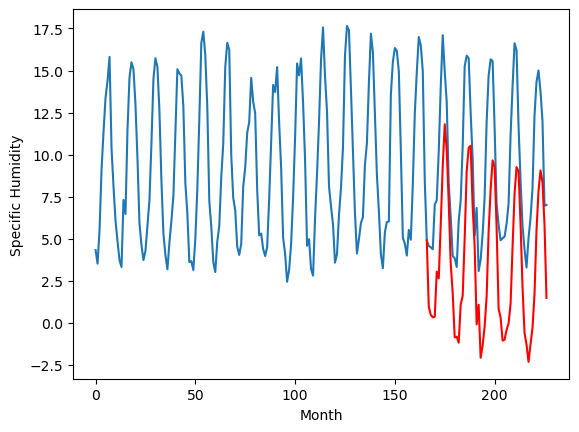

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.02		1.59		-0.43
1.18		1.01		-0.17
1.63		0.94		-0.69
1.01		0.83		-0.18
4.03		3.52		-0.51
4.22		3.21		-1.01
7.55		6.14		-1.41
9.69		9.05		-0.64
13.05		11.12		-1.93
10.15		9.58		-0.57
8.67		6.89		-1.78
4.00		3.38		-0.62
2.89		2.01		-0.88
0.61		-0.26		-0.87
0.77		-0.06		-0.83
-0.04		-0.56		-0.52
2.57		1.60		-0.97
3.73		1.97		-1.76
7.95		5.40		-2.55
11.09		8.68		-2.41
12.14		10.10		-2.04
11.72		9.84		-1.88
8.15		6.51		-1.64
5.71		4.27		-1.44
2.18		0.82		-1.36
1.57		1.57		0.00
-0.41		-1.23		-0.82
0.12		-0.79		-0.91
1.21		0.38		-0.83
4.33		2.05		-2.28
8.57		5.40		-3.17
10.47		7.92		-2.55
9.83		9.24		-0.59
10.57		9.04		-1.53
7.83		5.68		-2.15
3.88		1.45		-2.43
2.90		0.57		-2.33
1.16		-0.36		-1.52
0.68		-0.47		-1.15
1.01		0.01		-1.00
2.43		0.66		-1.77
3.65		1.47		-2.18
8.70		5.41		-3.29
11.28		8.12		-3.16
11.51		8.77		-2.74
9.68		8.87		-0.81
8.73		5.97		-2.76
5.30		2.55		-2.75
2.63		0.20		-2.43
1.58

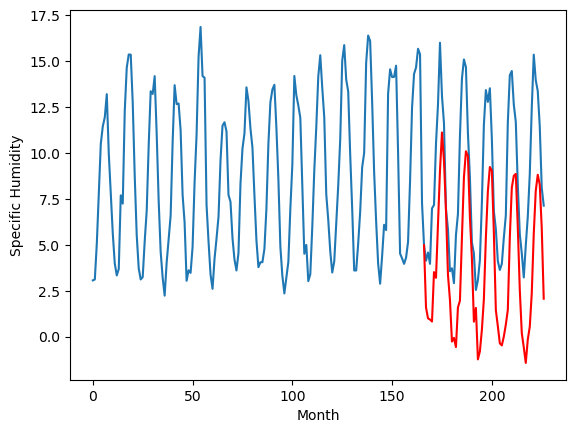

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		1.39		0.04
0.70		1.04		0.34
0.55		0.92		0.37
0.56		0.78		0.22
2.45		2.83		0.38
2.61		2.81		0.20
5.43		5.08		-0.35
7.14		7.36		0.22
10.03		8.77		-1.26
8.71		8.07		-0.64
5.92		5.74		-0.18
2.40		3.13		0.73
2.08		1.89		-0.19
0.22		0.12		-0.10
0.41		0.48		0.07
-0.33		0.07		0.40
1.49		1.49		0.00
1.66		1.72		0.06
6.81		4.41		-2.40
9.80		6.97		-2.83
11.04		8.52		-2.52
10.01		8.12		-1.89
7.05		5.55		-1.50
3.61		3.77		0.16
1.25		1.63		0.38
0.27		1.59		1.32
-0.37		-0.19		0.18
-0.45		-0.03		0.42
0.51		1.07		0.56
1.48		1.98		0.50
4.04		4.38		0.34
8.22		6.73		-1.49
8.87		8.08		-0.79
9.28		8.06		-1.22
7.28		5.36		-1.92
3.89		2.22		-1.67
1.91		0.85		-1.06
0.70		0.28		-0.42
0.39		0.23		-0.16
0.25		0.43		0.18
1.04		1.04		0.00
1.56		1.73		0.17
7.29		5.08		-2.21
8.90		7.16		-1.74
10.83		7.52		-3.31
8.92		8.12		-0.80
7.27		5.78		-1.49
4.16		3.05		-1.11
1.84		1.02		-0.82
1.40		0.65		-0.75
0.66		0.18		-0.48


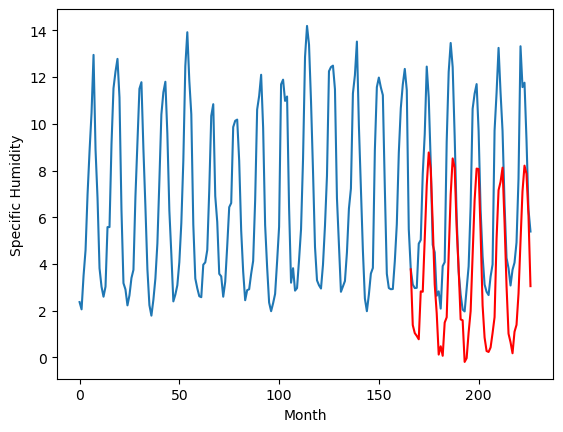

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-2.07		-0.25
-1.83		-2.11		-0.28
-1.98		-2.52		-0.54
-1.91		-2.34		-0.43
-0.96		-1.16		-0.20
-0.67		-1.05		-0.38
1.90		1.97		0.07
5.54		6.00		0.46
9.18		8.89		-0.29
9.09		8.27		-0.82
5.61		4.45		-1.16
2.69		1.87		-0.82
0.31		-0.13		-0.44
-1.85		-2.28		-0.43
-2.58		-2.73		-0.15
-2.54		-2.84		-0.30
-1.30		-1.67		-0.37
0.07		-0.60		-0.67
1.60		1.33		-0.27
6.92		6.14		-0.78
8.78		7.87		-0.91
9.12		8.98		-0.14
5.93		5.53		-0.40
4.07		3.91		-0.16
-1.12		-1.46		-0.34
-1.24		-1.47		-0.23
-2.85		-2.99		-0.14
-2.11		-2.14		-0.03
-1.09		-1.18		-0.09
-0.43		-0.69		-0.26
3.70		2.95		-0.75
5.29		5.03		-0.26
8.92		8.13		-0.79
8.49		7.73		-0.76
5.24		4.78		-0.46
1.80		0.30		-1.50
0.30		-0.33		-0.63
-1.83		-2.27		-0.44
-0.97		-1.61		-0.64
-1.77		-1.74		0.03
-1.74		-2.03		-0.29
0.87		0.11		-0.76
1.17		0.85		-0.32
4.46		4.29		-0.17
9.17		8.31		-0.86
6.88		7.62		0.74
5.62		5.29		-0.33
2.57		1.94		-0.63
-

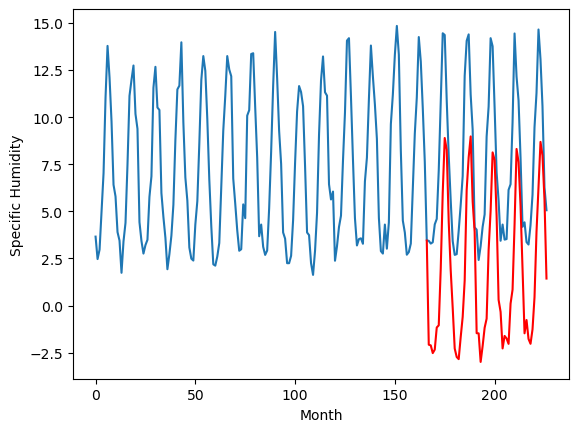

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.88  -2.686981
1                 1    1.11   1.552242
2                 2   -0.05   0.054490
3                 3    1.89   2.092048
4                 4    2.44   2.994056
5                 5    4.76   4.568879
6                 6   -2.55  -2.392948
7                 7    1.26   0.955601
8                 8    2.02   1.591161
9                 9    1.35   1.385815
10               10   -1.82  -2.073989


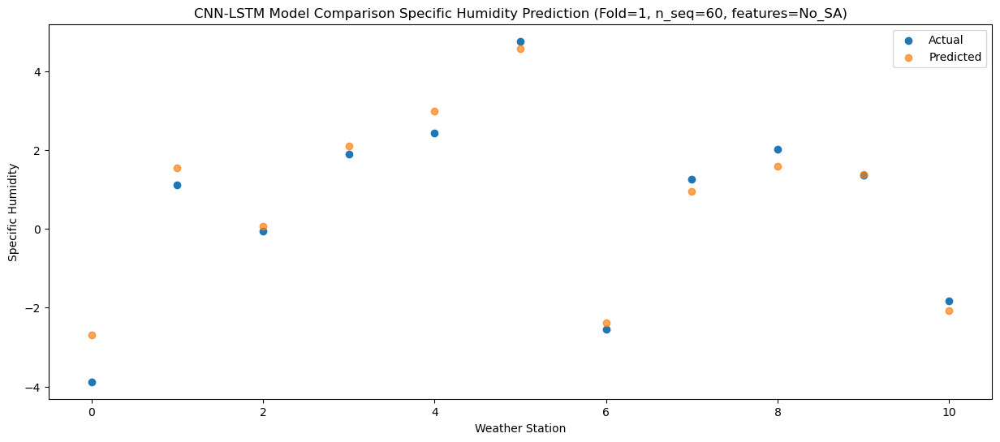

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.28  -2.674412
1                 1    1.16   1.471621
2                 2    0.86  -0.091213
3                 3    0.69   1.722869
4                 4    1.20   2.595338
5                 5    3.28   4.355648
6                 6   -2.52  -2.443689
7                 7    0.93   0.475112
8                 8    1.18   1.005441
9                 9    0.70   1.044039
10               10   -1.83  -2.111542


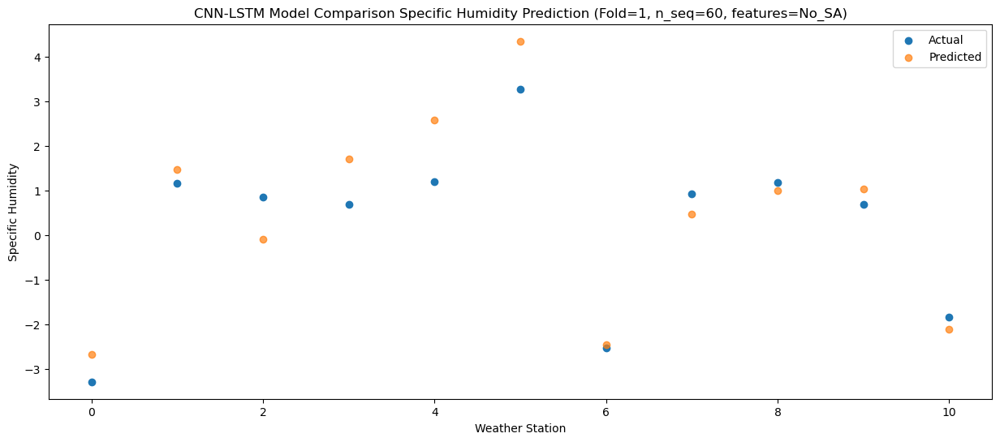

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -3.012248
1                 1    0.91   1.168811
2                 2    0.35  -0.344440
3                 3    1.59   1.592038
4                 4    2.11   2.472723
5                 5    3.00   4.197752
6                 6   -2.94  -2.767295
7                 7    0.85   0.329002
8                 8    1.63   0.937500
9                 9    0.55   0.921045
10               10   -1.98  -2.521024


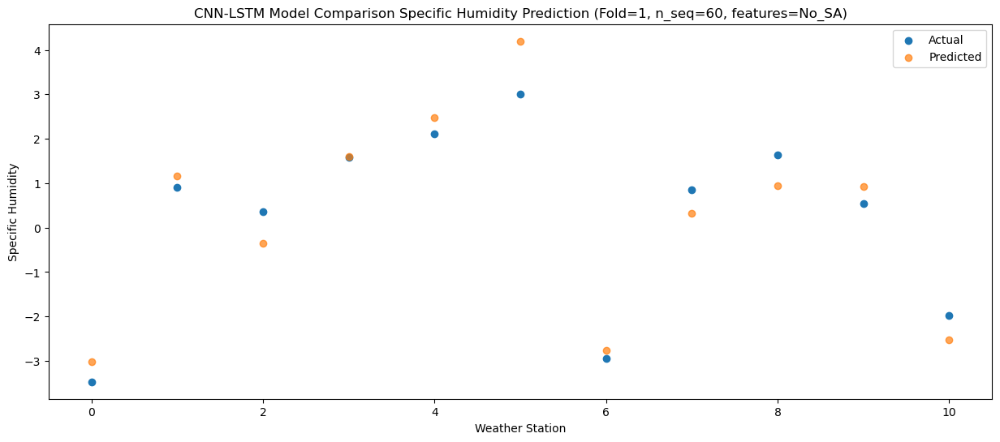

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -2.661123
1                 1    1.43   1.462134
2                 2    0.74  -0.052531
3                 3    0.89   1.693411
4                 4    1.43   2.560591
5                 5    3.18   4.113945
6                 6   -2.46  -2.466589
7                 7    0.73   0.362454
8                 8    1.01   0.830460
9                 9    0.56   0.778010
10               10   -1.91  -2.335309


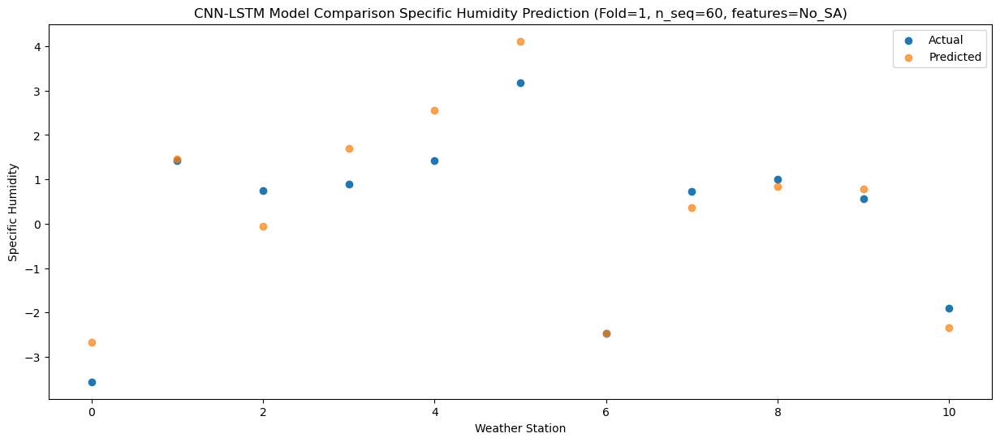

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.26  -0.636165
1                 1    3.66   3.630024
2                 2    3.90   2.453911
3                 3    5.25   4.428437
4                 4    6.16   5.342479
5                 5    5.85   6.048460
6                 6   -0.49  -0.419770
7                 7    3.39   3.050772
8                 8    4.03   3.523479
9                 9    2.45   2.829052
10               10   -0.96  -1.161564


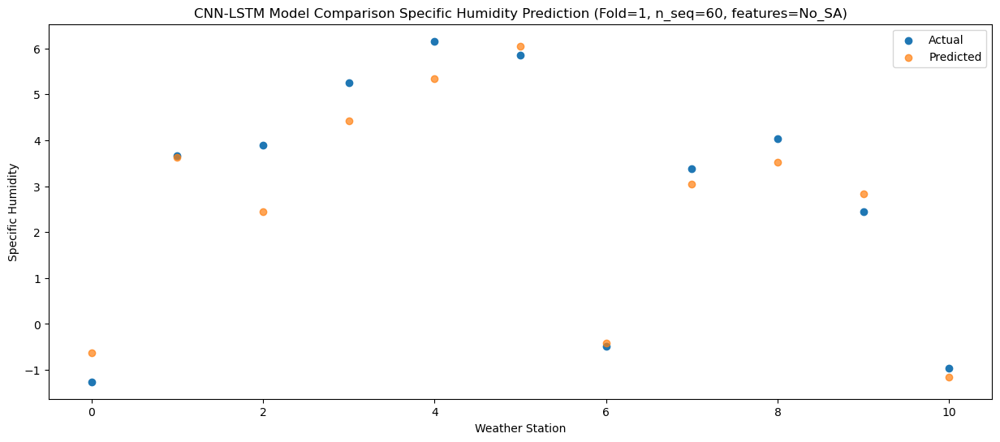

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.52  -0.947514
1                 1    2.07   3.290613
2                 2    2.28   1.984622
3                 3    4.91   3.990220
4                 4    5.85   4.890765
5                 5    4.84   6.053195
6                 6   -1.14  -0.716552
7                 7    3.65   2.643854
8                 8    4.22   3.209826
9                 9    2.61   2.812146
10               10   -0.67  -1.046842


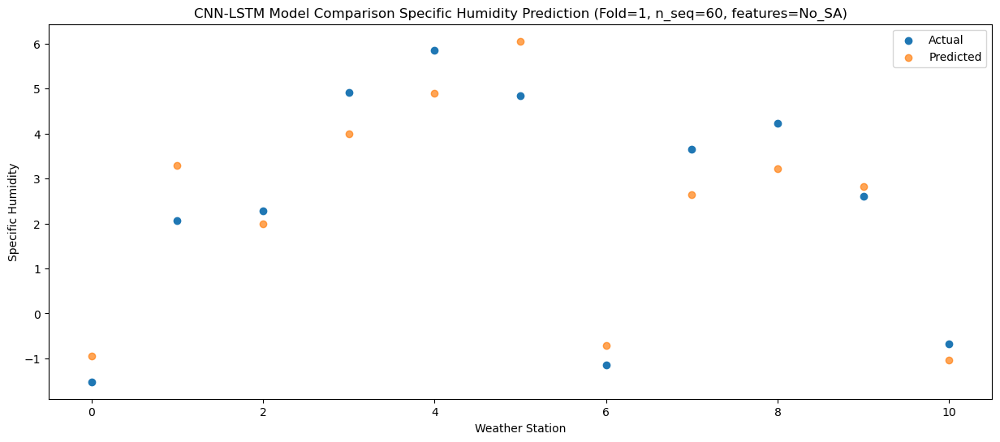

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    1.38   1.929300
1                 1    5.08   6.250461
2                 2    5.05   4.952162
3                 3    6.89   6.822914
4                 4    7.97   7.763608
5                 5    7.52   8.134657
6                 6    2.06   2.235968
7                 7    6.55   5.835926
8                 8    7.55   6.135798
9                 9    5.43   5.079586
10               10    1.90   1.967013


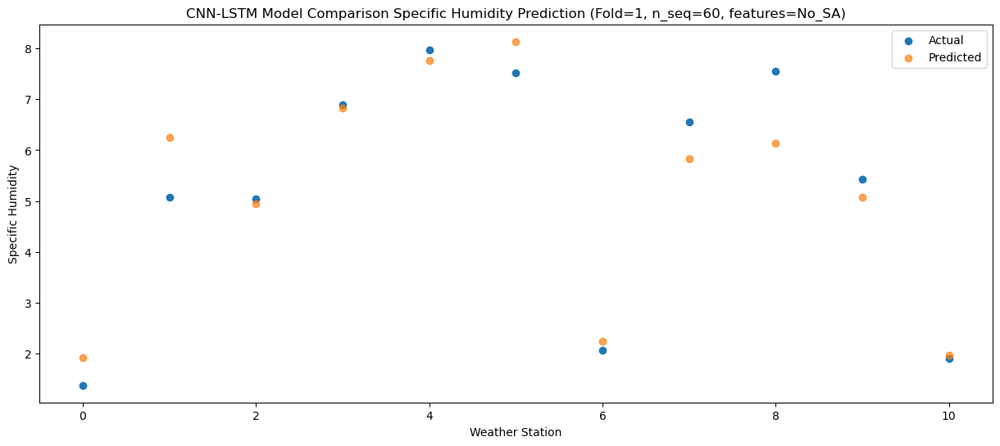

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    4.62   5.775795
1                 1    8.88  10.048560
2                 2    8.90   8.642331
3                 3    9.01   9.967254
4                 4   10.26  10.917680
5                 5    9.34  10.347713
6                 6    5.70   6.080592
7                 7   10.38   9.302458
8                 8    9.69   9.046259
9                 9    7.14   7.361924
10               10    5.54   5.999482


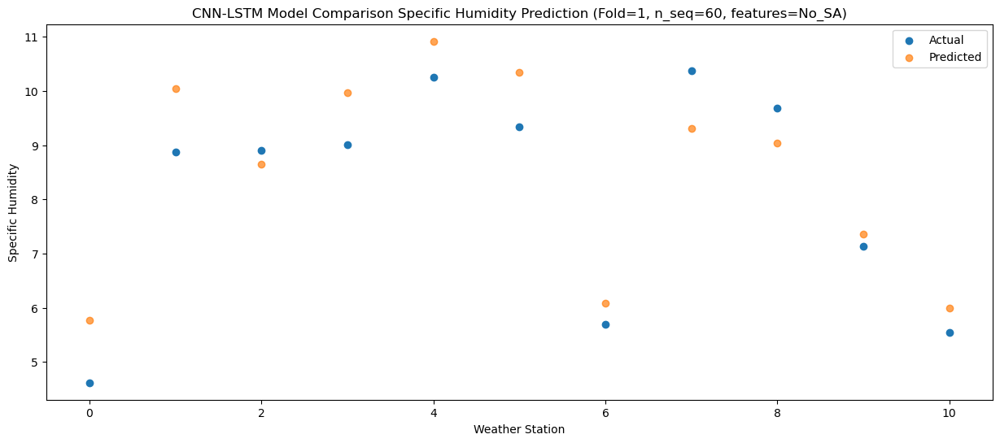

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    7.19   8.247427
1                 1   10.92  12.551347
2                 2   11.45  11.029856
3                 3   11.52  12.016206
4                 4   12.86  12.997431
5                 5   10.33  11.597076
6                 6    8.14   8.622651
7                 7   13.46  11.806074
8                 8   13.05  11.123705
9                 9   10.03   8.773329
10               10    9.18   8.893167


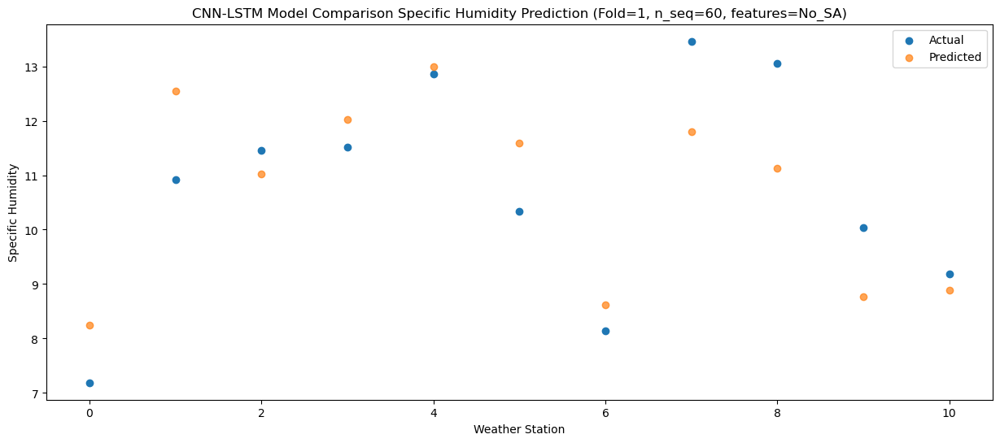

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    7.48   7.764478
1                 1   10.97  11.844768
2                 2   10.97  10.199584
3                 3   10.41  10.905400
4                 4   11.41  11.809111
5                 5    9.10  11.223377
6                 6    8.16   7.975083
7                 7   11.29  10.254899
8                 8   10.15   9.579994
9                 9    8.71   8.065261
10               10    9.09   8.266774


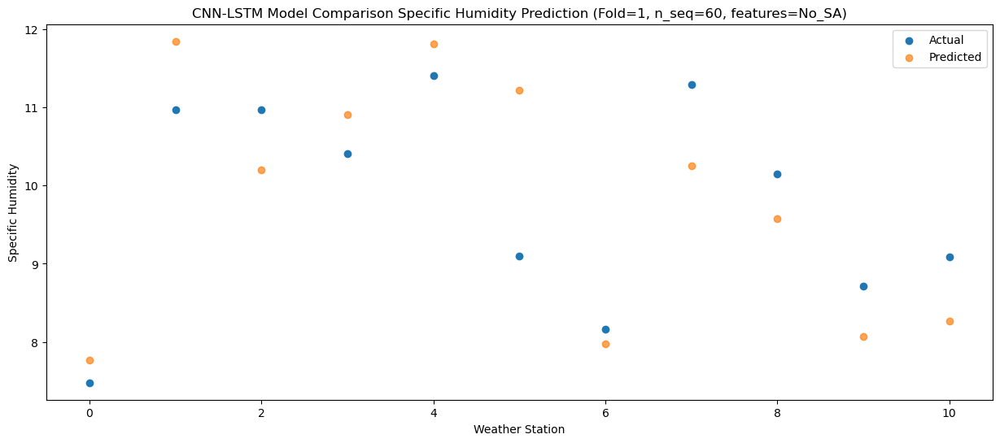

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.86   4.469959
1                 1    8.07   8.567785
2                 2    8.02   7.106102
3                 3    8.83   8.222622
4                 4    9.92   9.117012
5                 5    8.67   8.988004
6                 6    4.85   4.632651
7                 7    9.49   7.171603
8                 8    8.67   6.889050
9                 9    5.92   5.735690
10               10    5.61   4.450333


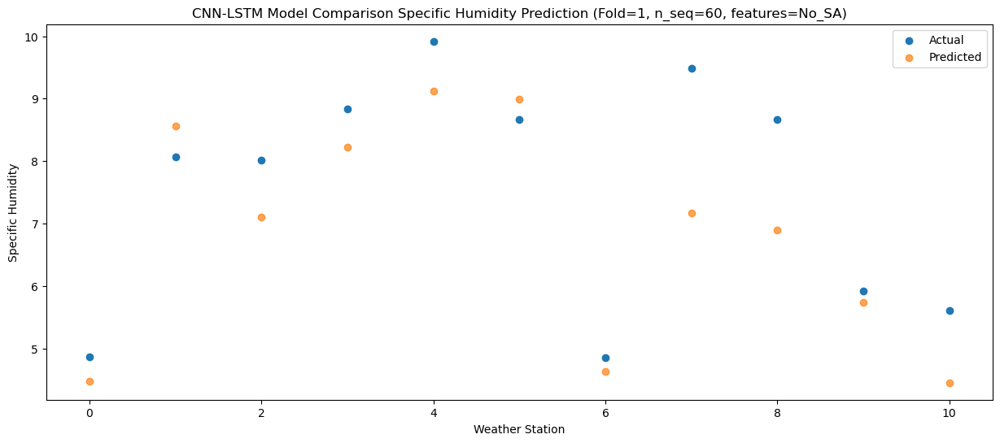

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.18   1.647415
1                 1    5.40   5.554522
2                 2    5.26   3.895049
3                 3    5.43   4.896005
4                 4    6.07   5.720731
5                 5    5.16   6.640998
6                 6    2.36   1.696429
7                 7    4.67   3.507662
8                 8    4.00   3.378006
9                 9    2.40   3.129373
10               10    2.69   1.865408


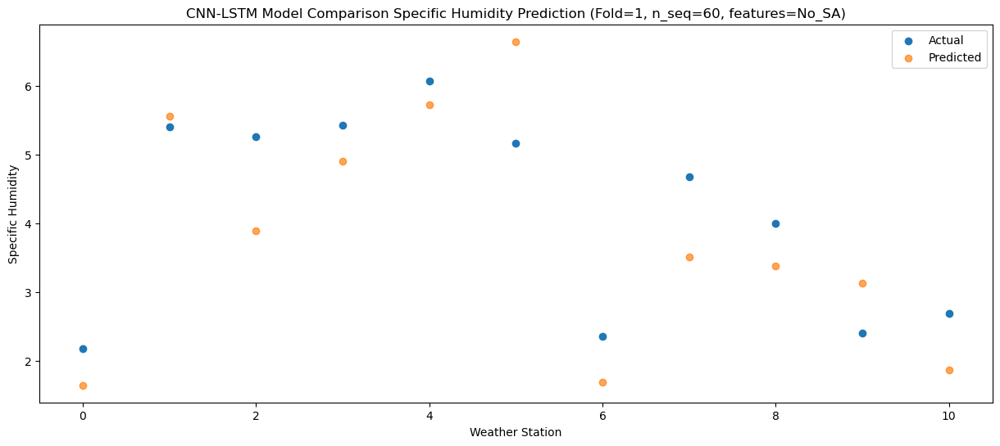

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -0.810107
1                 1    2.34   3.227357
2                 2    2.08   1.548929
3                 3    3.33   2.993691
4                 4    3.59   3.843599
5                 5    4.60   5.251857
6                 6   -0.75  -0.640482
7                 7    2.65   1.774245
8                 8    2.89   2.005044
9                 9    2.08   1.893240
10               10    0.31  -0.130708


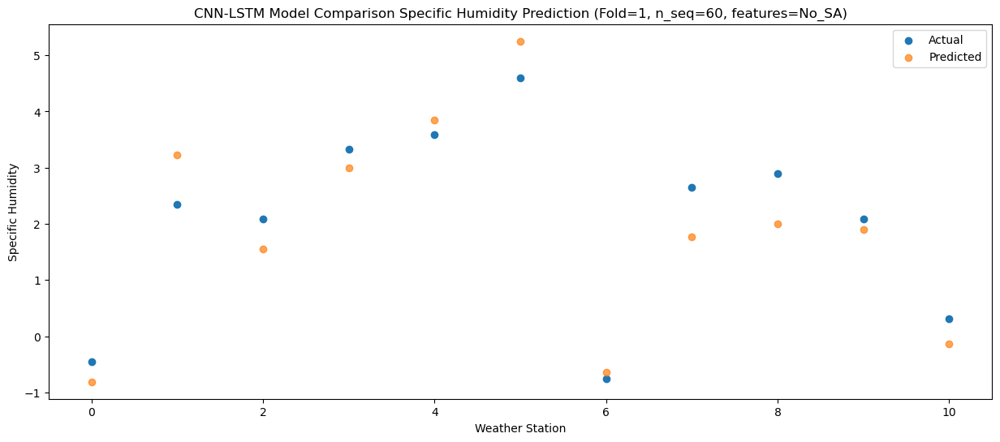

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.66  -3.765341
1                 1   -0.25   0.310204
2                 2   -0.69  -1.543497
3                 3    0.78   0.241370
4                 4    0.77   1.090614
5                 5    2.16   3.421590
6                 6   -3.47  -3.510674
7                 7    0.33  -0.858937
8                 8    0.61  -0.259480
9                 9    0.22   0.123141
10               10   -1.85  -2.275796


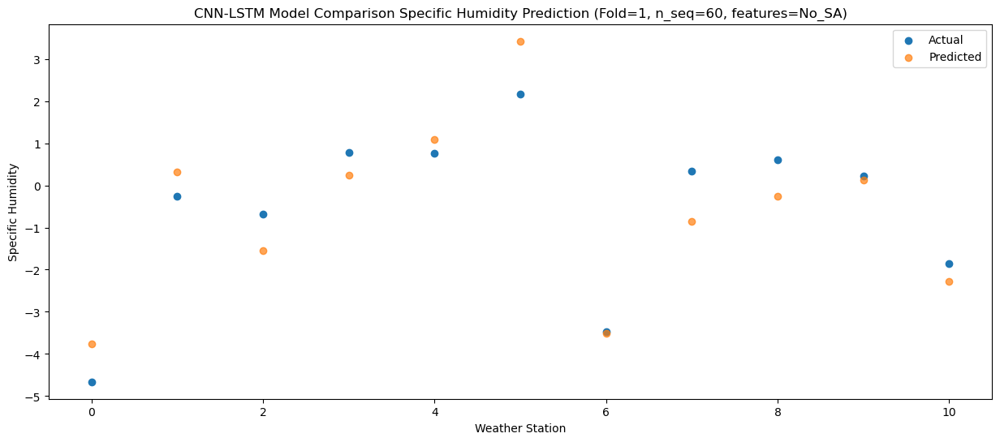

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -4.44  -3.850669
1                 1   -0.23   0.245929
2                 2   -0.54  -1.490141
3                 3    0.44   0.471295
4                 4    0.52   1.316045
5                 5    2.99   3.826852
6                 6   -3.58  -3.617069
7                 7    0.20  -0.821347
8                 8    0.77  -0.057517
9                 9    0.41   0.478461
10               10   -2.58  -2.727006


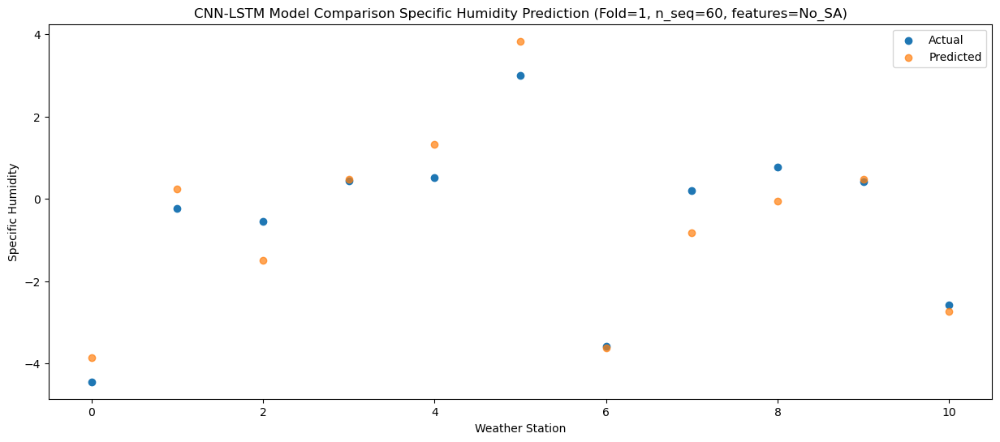

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -4.12  -3.732825
1                 1   -0.04   0.274676
2                 2   -0.54  -1.468961
3                 3    0.51   0.260140
4                 4    0.56   1.079390
5                 5    2.36   3.538287
6                 6   -3.46  -3.576039
7                 7   -0.32  -1.182784
8                 8   -0.04  -0.559353
9                 9   -0.33   0.071294
10               10   -2.54  -2.840554


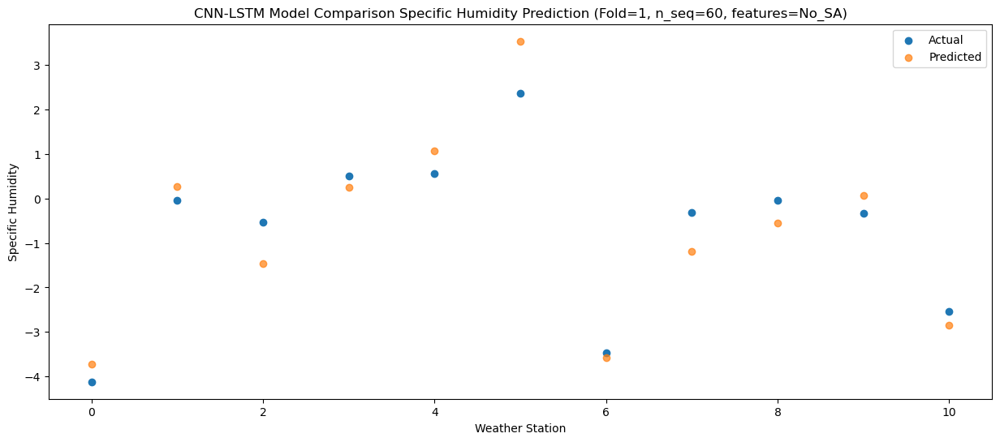

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.59  -2.093137
1                 1    1.49   2.055115
2                 2    2.08   0.540206
3                 3    3.15   2.380973
4                 4    3.28   3.250075
5                 5    3.15   4.788052
6                 6   -1.90  -1.879626
7                 7    2.41   1.081454
8                 8    2.57   1.597890
9                 9    1.49   1.493893
10               10   -1.30  -1.674160


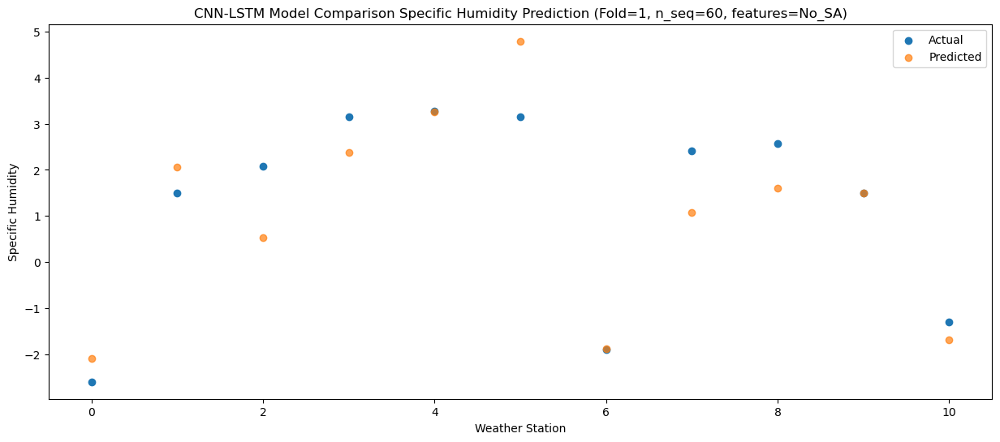

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -2.39  -1.541781
1                 1    1.85   2.609277
2                 2    1.79   0.942399
3                 3    4.49   2.628572
4                 4    4.54   3.505150
5                 5    4.45   4.933033
6                 6   -1.28  -1.275349
7                 7    3.64   1.609285
8                 8    3.73   1.965121
9                 9    1.66   1.717173
10               10    0.07  -0.599174


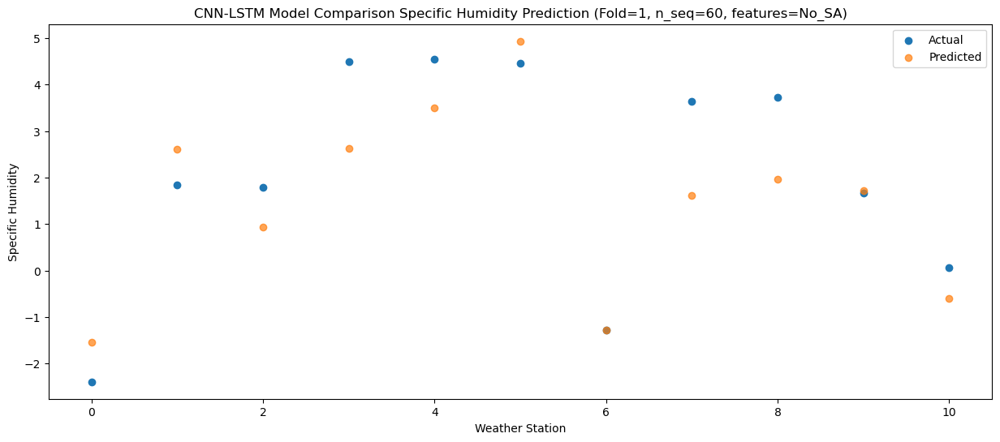

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    0.29   1.054060
1                 1    4.77   5.379667
2                 2    4.63   4.027771
3                 3    8.38   5.986216
4                 4    8.57   6.921352
5                 5    8.76   7.435584
6                 6    1.65   1.379362
7                 7    6.85   5.031531
8                 8    7.95   5.400505
9                 9    6.81   4.405416
10               10    1.60   1.331978


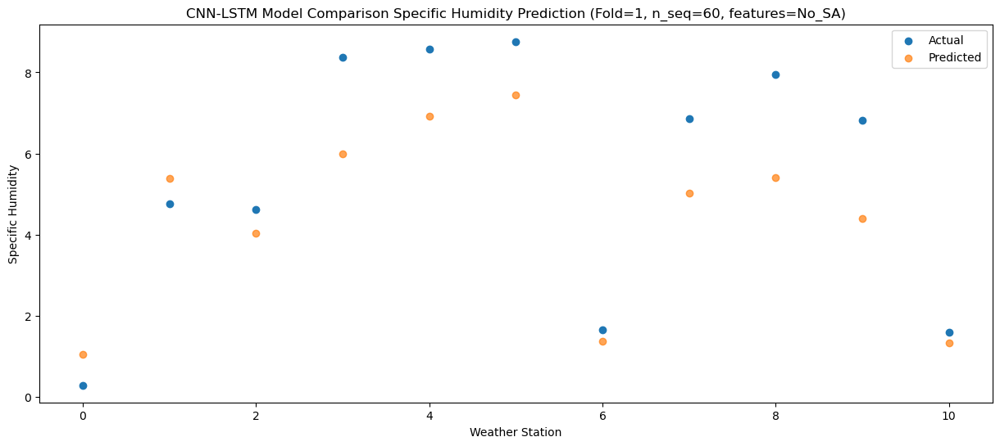

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.45   5.529349
1                 1    8.75   9.790305
2                 2    9.15   8.267845
3                 3   11.57   9.536413
4                 4   11.98  10.480287
5                 5   10.93   9.928220
6                 6    6.00   5.859237
7                 7   11.61   8.998319
8                 8   11.09   8.675299
9                 9    9.80   6.970049
10               10    6.92   6.138362


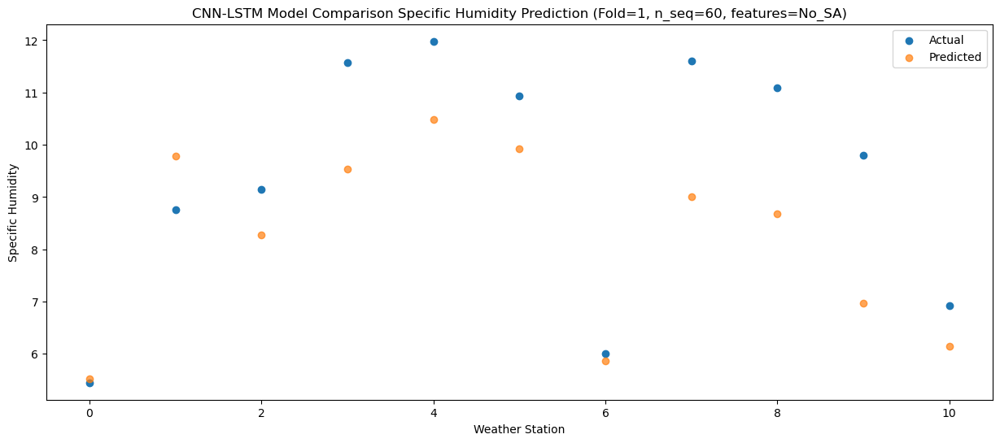

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    6.60   7.049872
1                 1   10.62  11.288447
2                 2   10.74   9.696023
3                 3   12.05  10.947921
4                 4   12.16  11.882525
5                 5   12.26  11.498079
6                 6    8.50   7.380789
7                 7   12.24  10.413573
8                 8   12.14  10.101767
9                 9   11.04   8.518965
10               10    8.78   7.865111


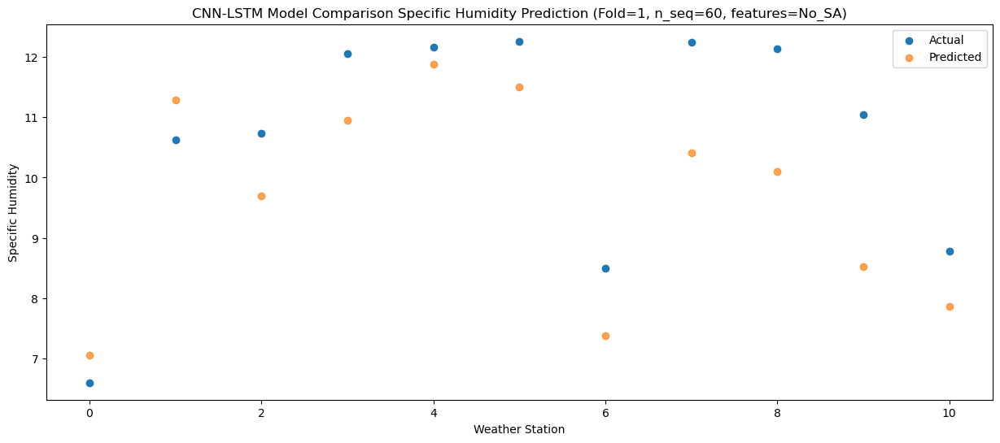

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.36   7.717335
1                 1   10.83  11.862396
2                 2   10.96  10.061069
3                 3   12.39  10.842553
4                 4   12.20  11.762693
5                 5   12.48  11.122306
6                 6    8.79   8.034577
7                 7   12.09  10.526748
8                 8   11.72   9.835408
9                 9   10.01   8.124551
10               10    9.12   8.976565


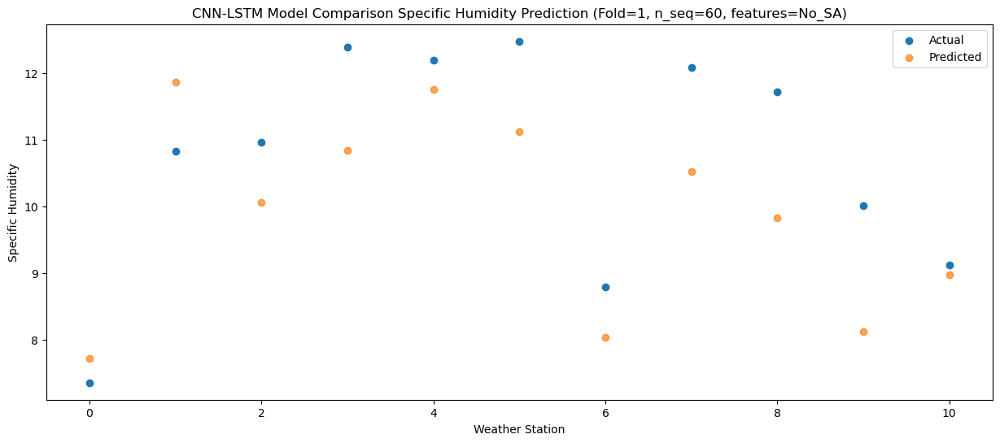

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.88   4.454761
1                 1    7.88   8.504982
2                 2    8.20   6.698349
3                 3    9.30   7.629607
4                 4    9.10   8.505333
5                 5    8.94   8.756287
6                 6    5.44   4.683196
7                 7    8.84   6.900240
8                 8    8.15   6.513914
9                 9    7.05   5.549695
10               10    5.93   5.527469


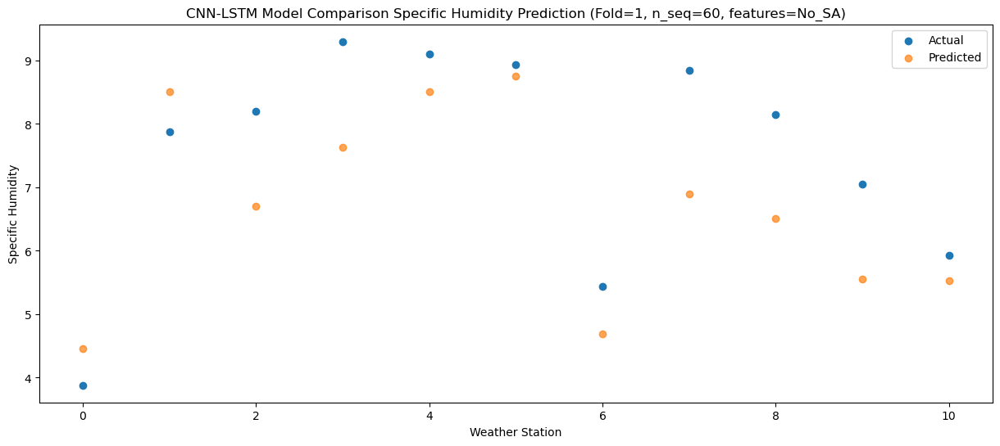

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.30   2.310460
1                 1    5.84   6.311573
2                 2    5.45   4.328386
3                 3    7.05   5.268576
4                 4    7.15   6.119890
5                 5    5.83   7.028998
6                 6    3.31   2.548519
7                 7    6.11   4.547781
8                 8    5.71   4.274720
9                 9    3.61   3.765759
10               10    4.07   3.905258


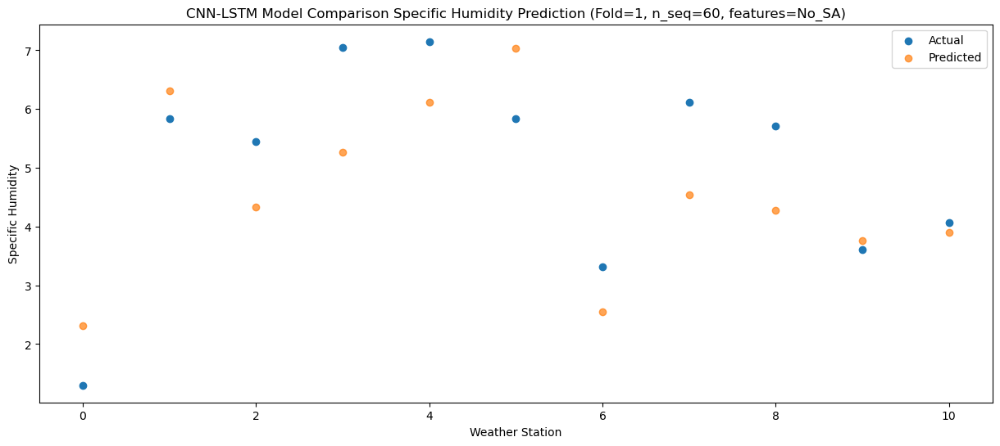

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -4.36  -3.130453
1                 1    0.25   0.959470
2                 2   -0.05  -0.916210
3                 3    2.60   1.177749
4                 4    2.56   2.010137
5                 5    3.99   4.980904
6                 6   -2.62  -2.861364
7                 7    1.55  -0.090182
8                 8    2.18   0.821324
9                 9    1.25   1.628511
10               10   -1.12  -1.464433


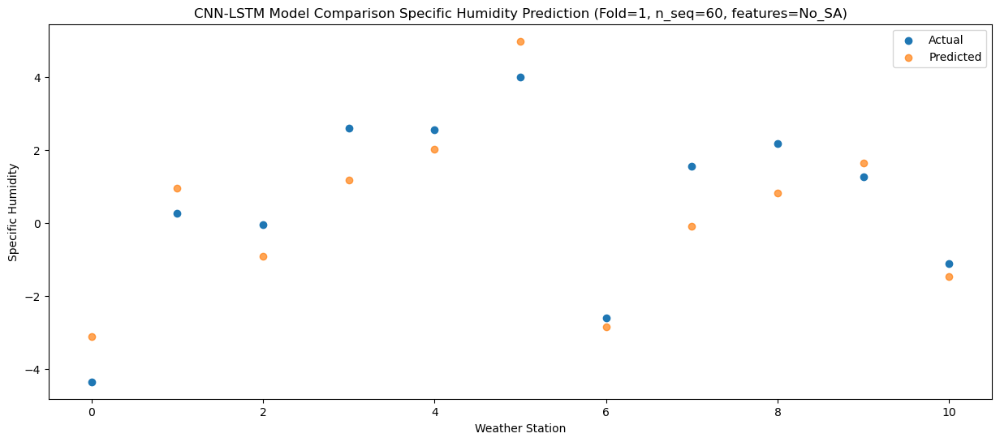

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -2.25  -1.826376
1                 1    2.42   2.268121
2                 2    2.59   0.739487
3                 3    5.52   2.549494
4                 4    5.49   3.398869
5                 5    2.94   4.990993
6                 6   -0.75  -1.657888
7                 7    3.19   1.074478
8                 8    1.57   1.572896
9                 9    0.27   1.589417
10               10   -1.24  -1.473493


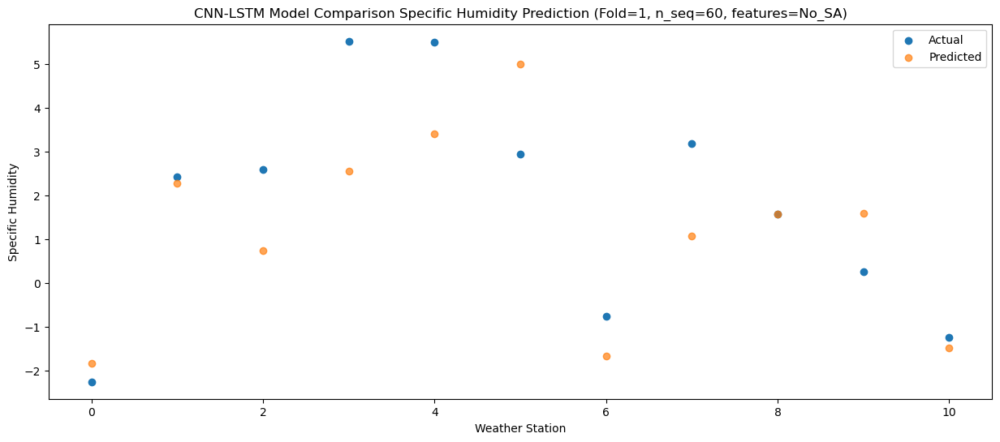

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.50  -4.667471
1                 1   -0.58  -0.668254
2                 2   -1.29  -2.620112
3                 3   -0.13  -0.702881
4                 4   -0.05   0.101107
5                 5    1.67   3.269614
6                 6   -3.75  -4.456646
7                 7   -0.56  -2.075336
8                 8   -0.41  -1.228872
9                 9   -0.37  -0.191208
10               10   -2.85  -2.988800


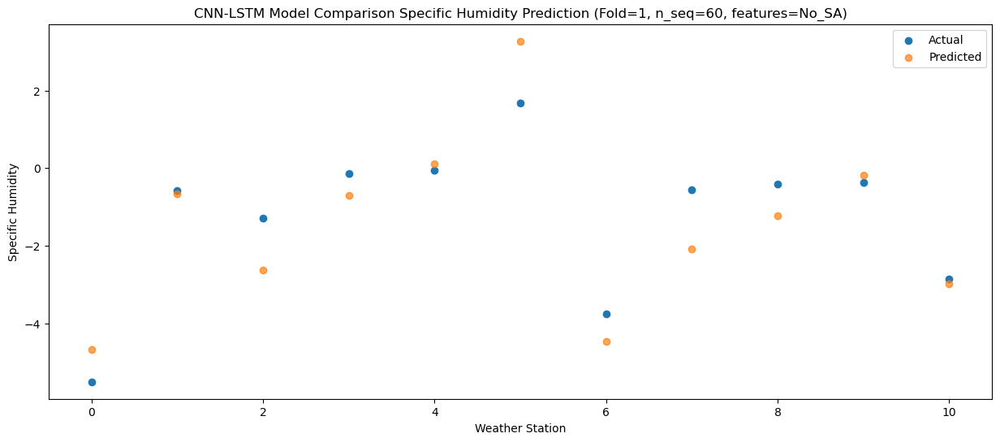

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -3.583357
1                 1    0.37   0.357810
2                 2   -0.26  -1.581971
3                 3    0.04   0.025511
4                 4    0.15   0.823570
5                 5    1.55   3.467120
6                 6   -2.62  -3.425701
7                 7    0.12  -1.350852
8                 8    0.12  -0.793516
9                 9   -0.45  -0.029161
10               10   -2.11  -2.144197


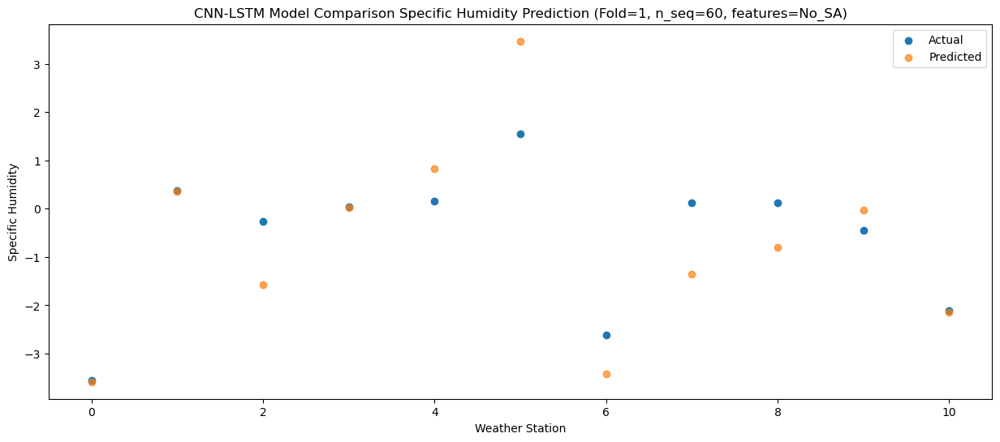

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.45  -2.590524
1                 1    1.05   1.381362
2                 2    0.53  -0.529026
3                 3    1.72   1.131719
4                 4    1.85   1.938231
5                 5    2.10   4.523218
6                 6   -1.87  -2.414800
7                 7    1.65  -0.209475
8                 8    1.21   0.376941
9                 9    0.51   1.070262
10               10   -1.09  -1.176556


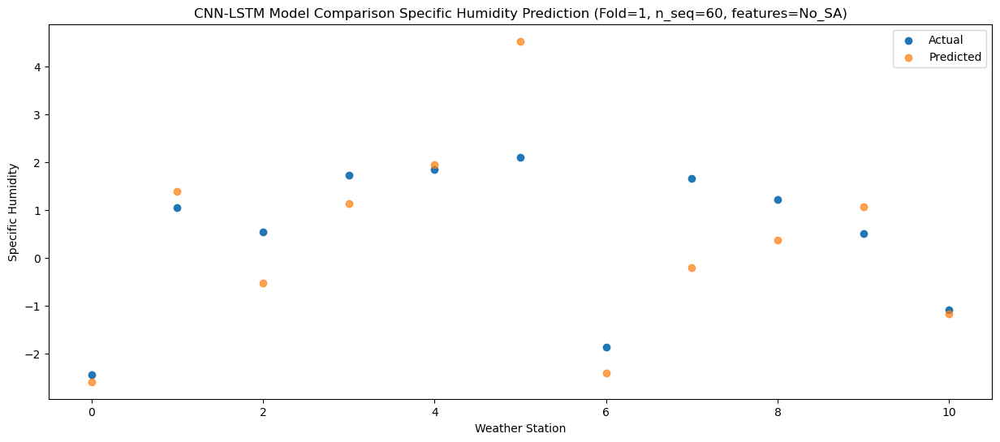

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -1.519363
1                 1    2.11   2.612078
2                 2    2.29   0.975422
3                 3    5.88   2.787070
4                 4    5.95   3.649330
5                 5    4.37   5.266659
6                 6   -0.68  -1.284125
7                 7    3.84   1.564264
8                 8    4.33   2.054284
9                 9    1.48   1.981243
10               10   -0.43  -0.693416


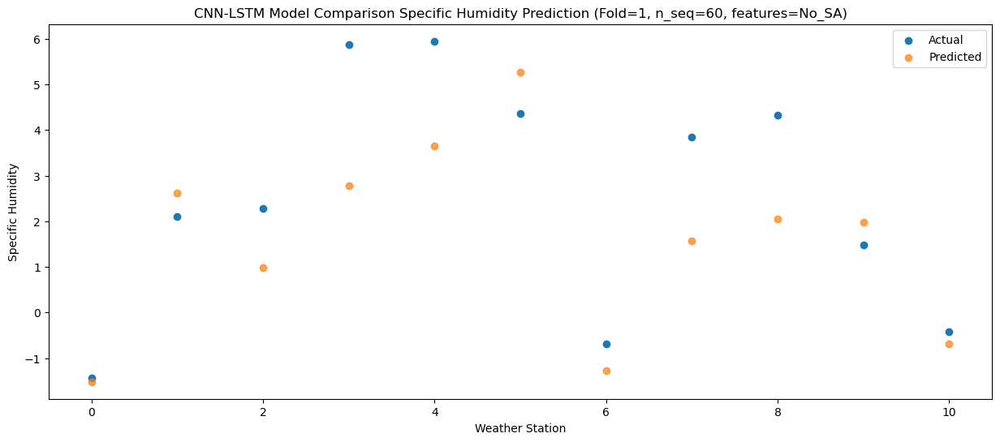

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    2.55   2.250299
1                 1    6.28   6.435114
2                 2    6.65   4.846696
3                 3    9.69   6.292983
4                 4    9.83   7.194105
5                 5    6.14   7.514350
6                 6    3.58   2.525446
7                 7    8.29   5.422105
8                 8    8.57   5.398673
9                 9    4.04   4.383334
10               10    3.70   2.954968


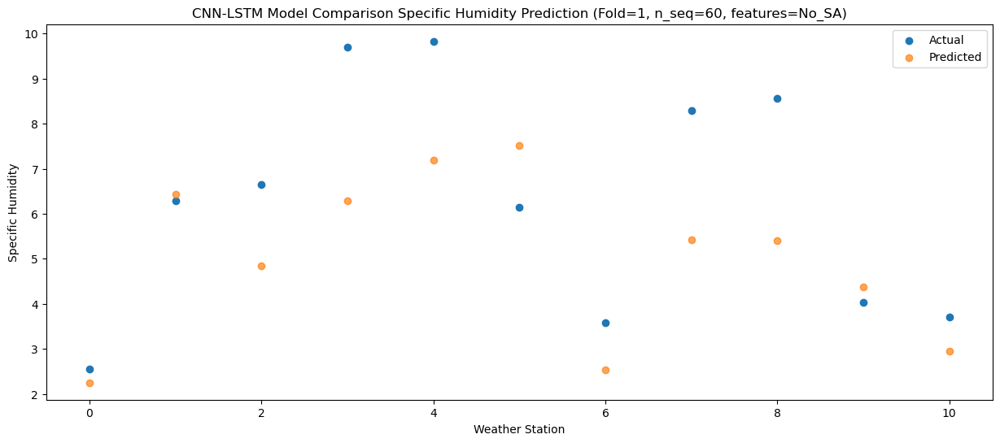

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.85   4.479683
1                 1    8.68   8.719498
2                 2    9.74   7.214642
3                 3   10.74   8.751498
4                 4   10.95   9.667619
5                 5    8.74   9.791460
6                 6    6.30   4.778420
7                 7   11.05   7.907376
8                 8   10.47   7.922821
9                 9    8.22   6.730235
10               10    5.29   5.028572


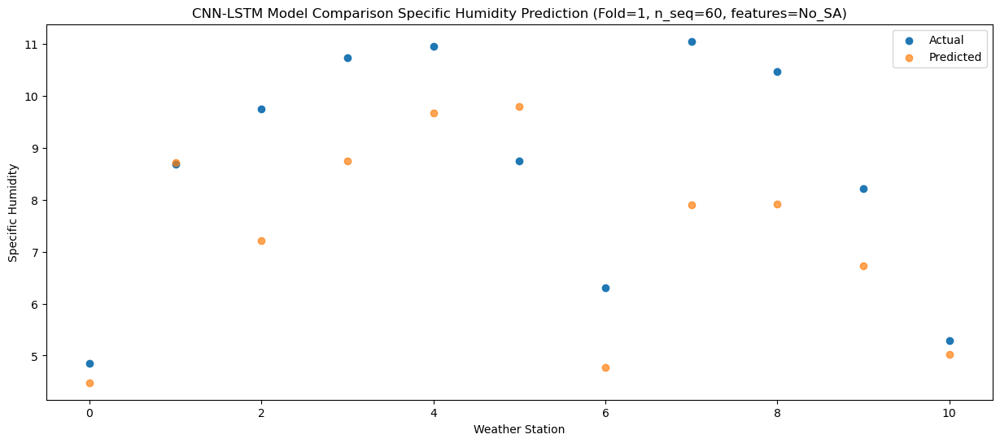

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    7.47   7.108459
1                 1   11.35  11.191694
2                 2   11.37   9.417515
3                 3   11.66  10.353279
4                 4   11.70  11.234049
5                 5    9.69  11.234222
6                 6    9.29   7.355138
7                 7   12.02   9.660856
8                 8    9.83   9.244010
9                 9    8.87   8.084053
10               10    8.92   8.128353


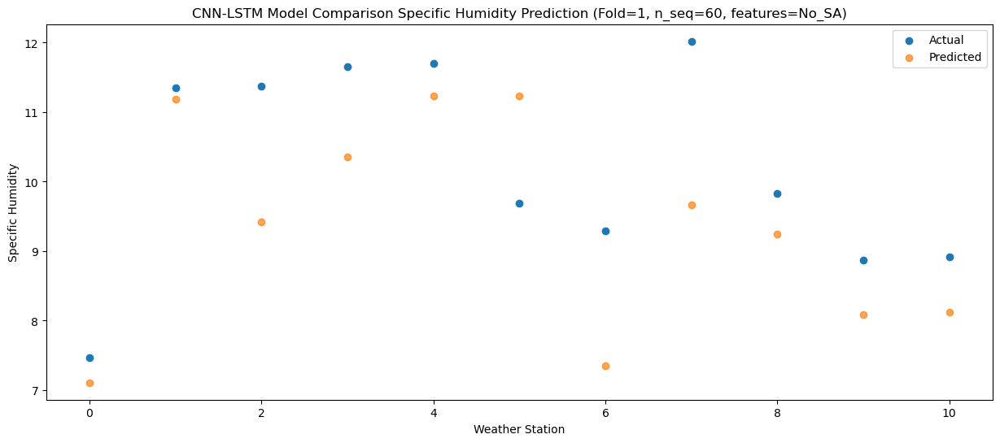

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.47   6.497316
1                 1   10.94  10.613612
2                 2   10.50   8.816168
3                 3   11.91   9.961530
4                 4   12.08  10.845306
5                 5   11.80  11.192927
6                 6    8.20   6.778737
7                 7   11.93   9.266706
8                 8   10.57   9.040154
9                 9    9.28   8.063572
10               10    8.49   7.729890


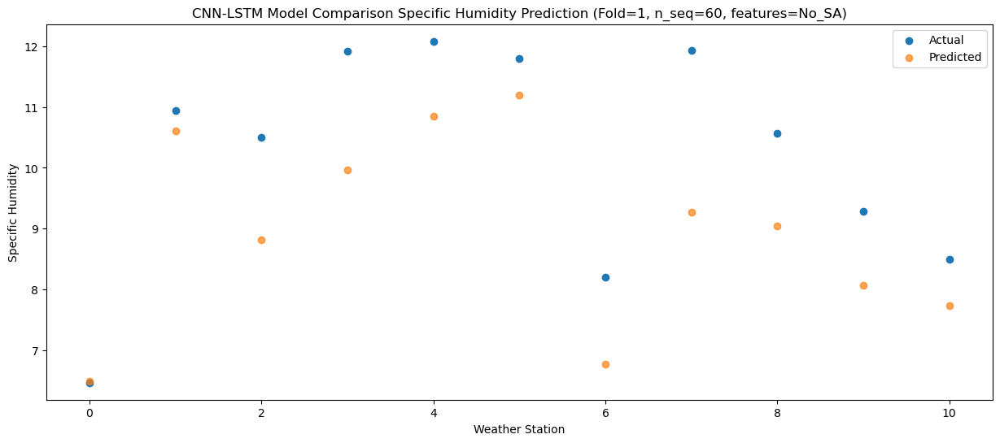

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.85   3.232823
1                 1    7.58   7.268769
2                 2    6.99   5.337333
3                 3    8.62   6.541375
4                 4    8.73   7.388079
5                 5   10.53   8.606379
6                 6    4.72   3.481199
7                 7    7.97   5.691080
8                 8    7.83   5.679098
9                 9    7.28   5.357353
10               10    5.24   4.777845


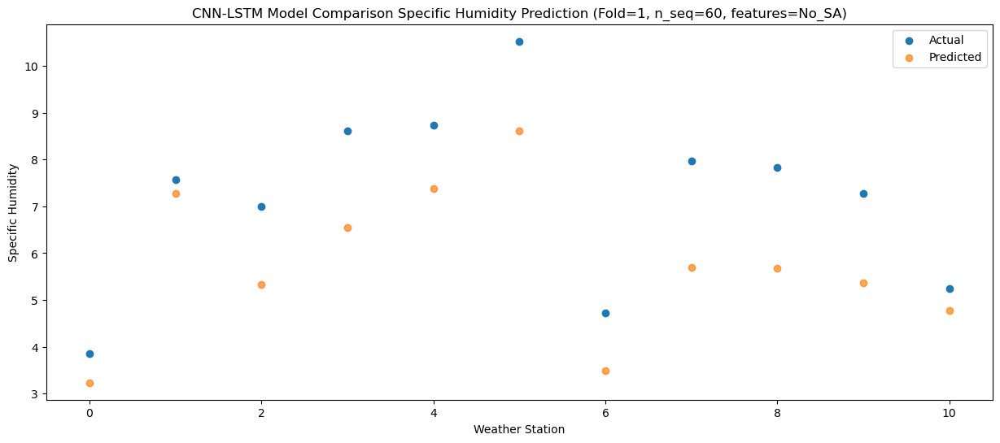

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.01  -1.560708
1                 1    2.69   2.418427
2                 2    1.88   0.391988
3                 3    3.66   2.059153
4                 4    3.83   2.861777
5                 5    7.34   5.633538
6                 6   -0.34  -1.343206
7                 7    3.43   0.840465
8                 8    3.88   1.451748
9                 9    3.89   2.224670
10               10    1.80   0.304431


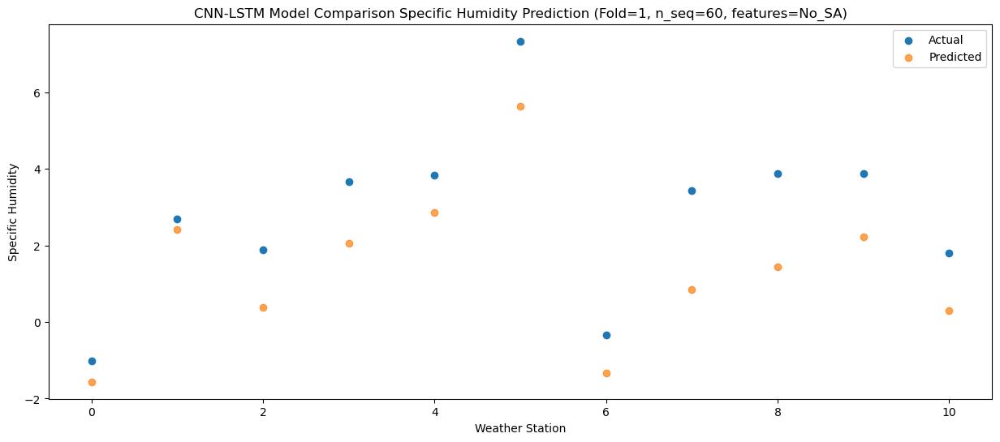

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.54  -1.861476
1                 1    2.21   2.096348
2                 2    1.51   0.129646
3                 3    3.16   1.468325
4                 4    3.45   2.280099
5                 5    4.47   4.245740
6                 6   -0.83  -1.677908
7                 7    2.18   0.326272
8                 8    2.90   0.574315
9                 9    1.91   0.850356
10               10    0.30  -0.334867


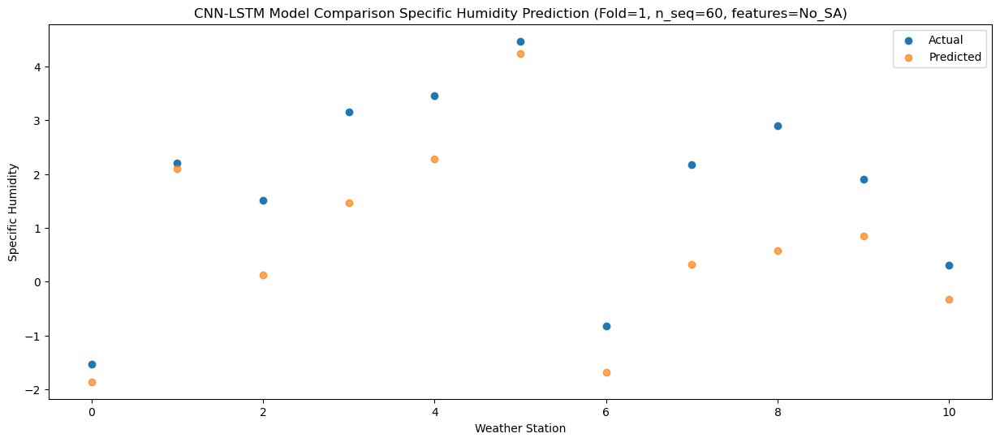

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -4.26  -3.709851
1                 1    0.62   0.319608
2                 2    0.82  -1.549353
3                 3    2.35   0.267787
4                 4    2.63   1.083513
5                 5    3.80   3.664901
6                 6   -2.73  -3.497906
7                 7    1.27  -1.055598
8                 8    1.16  -0.359850
9                 9    0.70   0.275572
10               10   -1.83  -2.273515


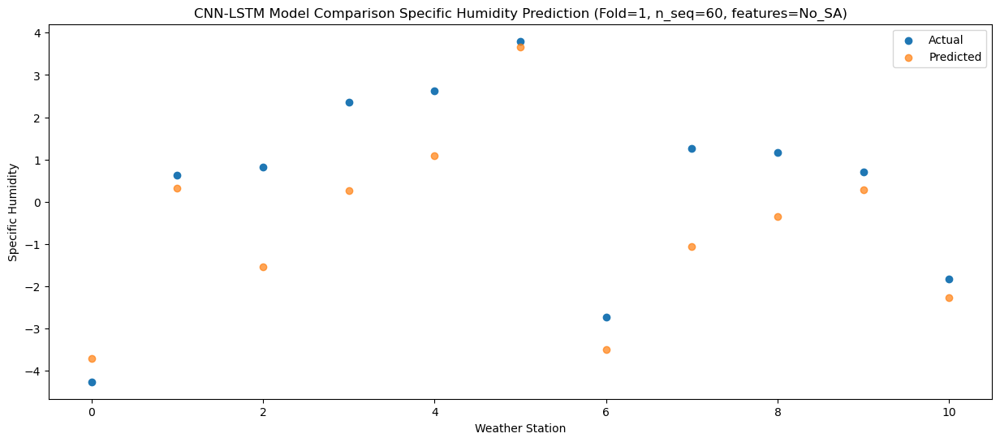

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -3.80  -3.319473
1                 1    1.03   0.650875
2                 2    0.79  -1.347799
3                 3    1.93   0.231053
4                 4    2.15   1.033259
5                 5    2.25   3.661327
6                 6   -2.37  -3.118235
7                 7    1.39  -1.003444
8                 8    0.68  -0.469020
9                 9    0.39   0.234852
10               10   -0.97  -1.609374


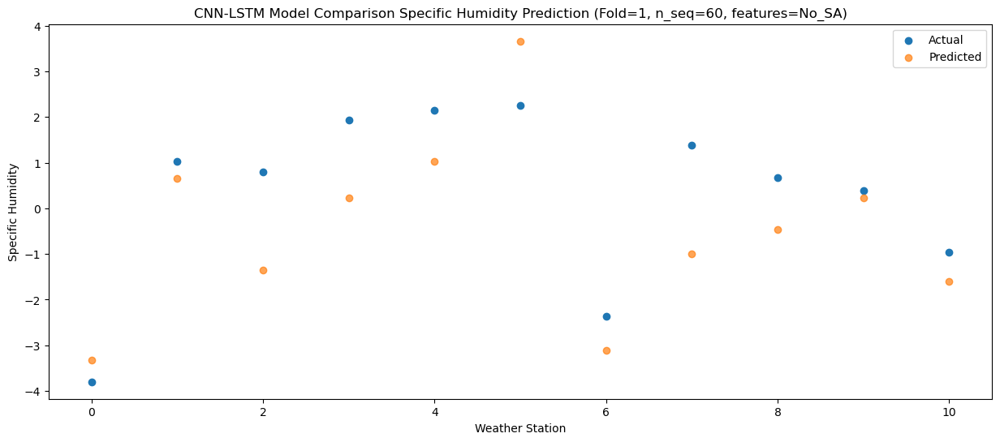

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.19  -2.684989
1                 1    2.15   1.283855
2                 2    1.84  -0.512490
3                 3    2.71   0.998470
4                 4    2.75   1.804470
5                 5    2.28   3.888182
6                 6   -1.17  -2.548337
7                 7    1.49  -0.414267
8                 8    1.01   0.012760
9                 9    0.25   0.426888
10               10   -1.77  -1.741639


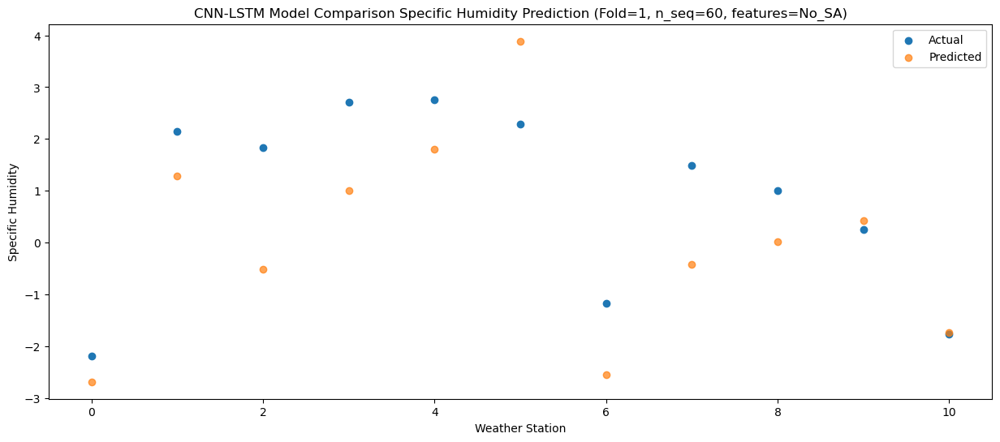

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.57  -2.853129
1                 1    1.28   1.214122
2                 2    1.37  -0.465355
3                 3    4.26   1.405763
4                 4    4.45   2.234508
5                 5    3.33   4.418140
6                 6   -1.93  -2.668095
7                 7    2.25  -0.029517
8                 8    2.43   0.660467
9                 9    1.04   1.044215
10               10   -1.74  -2.031247


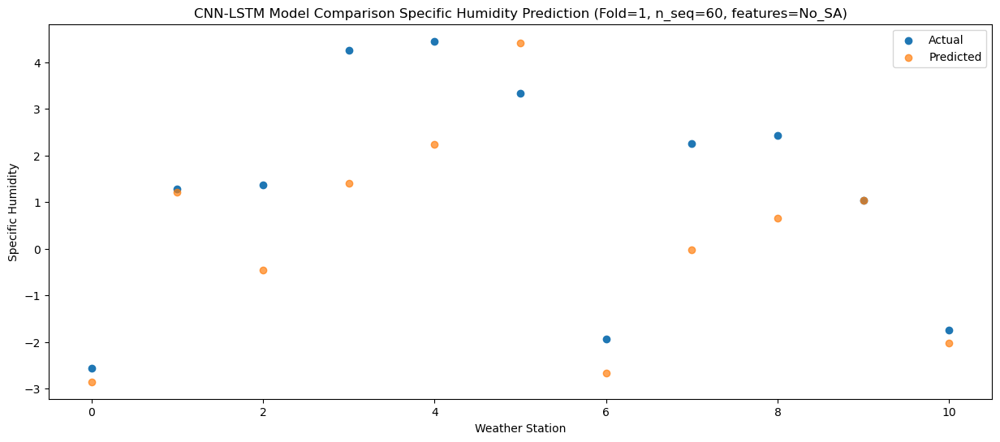

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.87  -1.180451
1                 1    2.88   2.792889
2                 2    2.73   0.905558
3                 3    4.63   2.346128
4                 4    4.90   3.161240
5                 5    3.59   5.106001
6                 6   -0.12  -1.009627
7                 7    3.45   1.120261
8                 8    3.65   1.469047
9                 9    1.56   1.725243
10               10    0.87   0.105373


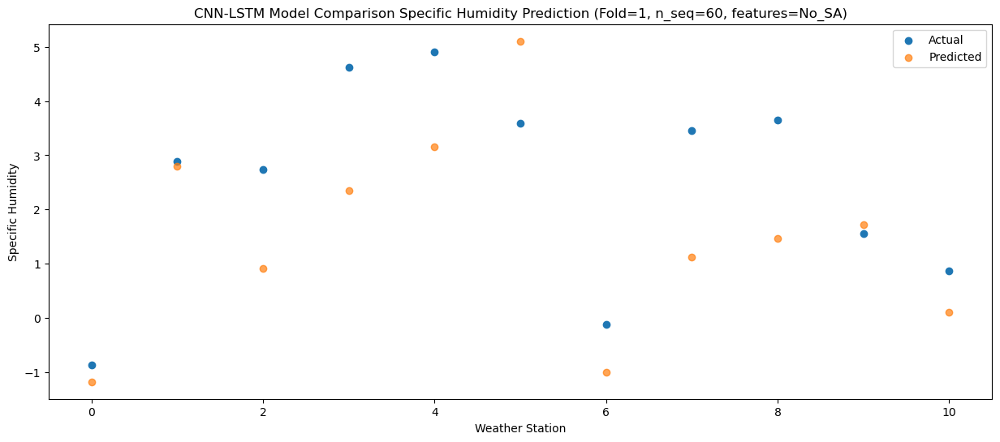

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.33   0.531847
1                 1    5.62   4.832987
2                 2    6.03   3.479051
3                 3    8.41   5.847013
4                 4    8.57   6.747396
5                 5    7.96   8.190557
6                 6    2.44   0.823964
7                 7    7.49   4.521944
8                 8    8.70   5.407191
9                 9    7.29   5.076707
10               10    1.17   0.847015


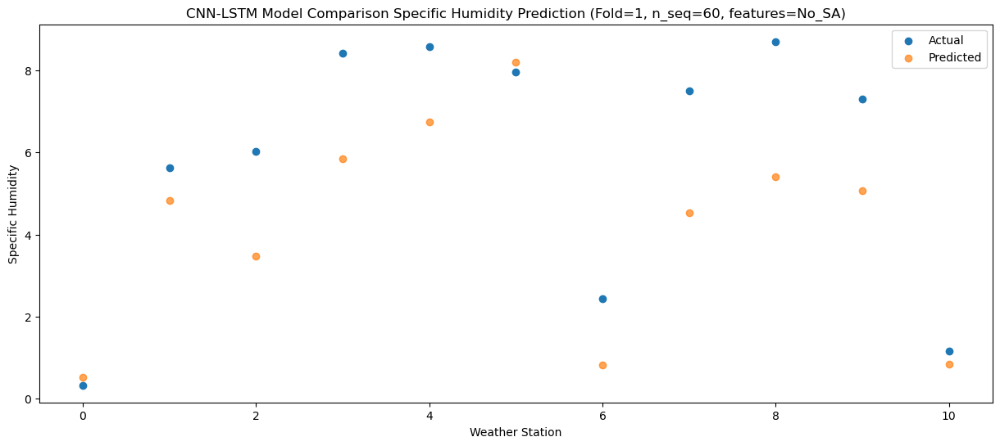

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    3.68   3.818385
1                 1    7.97   8.115997
2                 2    8.68   6.702141
3                 3   11.81   8.690367
4                 4   11.83   9.609480
5                 5    7.91  10.171541
6                 6    5.02   4.132950
7                 7   10.41   7.673258
8                 8   11.28   8.119081
9                 9    8.90   7.161047
10               10    4.46   4.294112


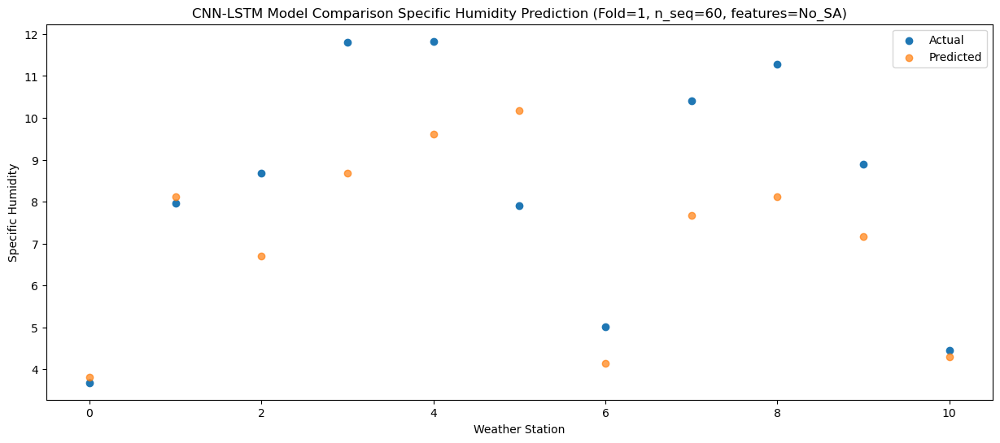

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    7.09   6.799953
1                 1   10.93  10.862070
2                 2   11.82   8.946014
3                 3   12.37   9.776031
4                 4   11.91  10.655830
5                 5   10.08  10.594935
6                 6    8.64   7.072534
7                 7   12.98   9.259431
8                 8   11.51   8.765794
9                 9   10.83   7.518205
10               10    9.17   8.311517


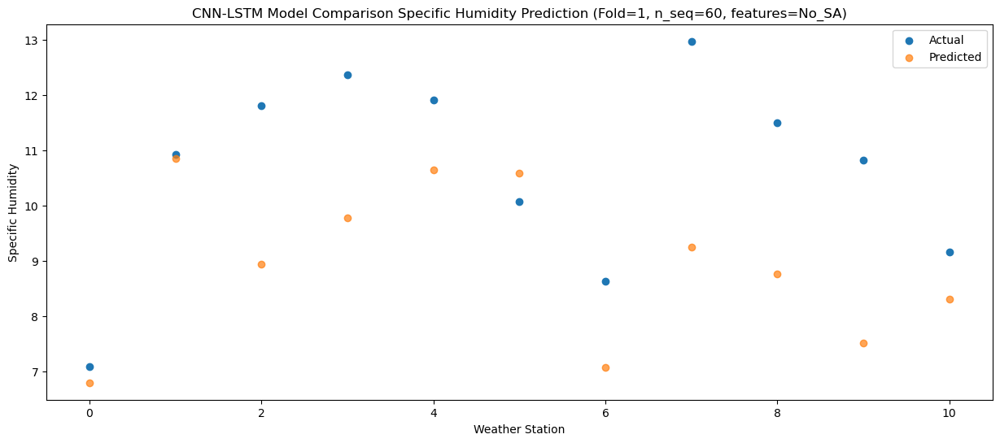

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    6.92   6.460512
1                 1   11.06  10.519878
2                 2   11.75   8.703064
3                 3   10.70   9.836419
4                 4   10.51  10.697314
5                 5   10.23  11.302199
6                 6    8.53   6.692925
7                 7   12.56   9.001415
8                 8    9.68   8.869942
9                 9    8.92   8.124382
10               10    6.88   7.619001


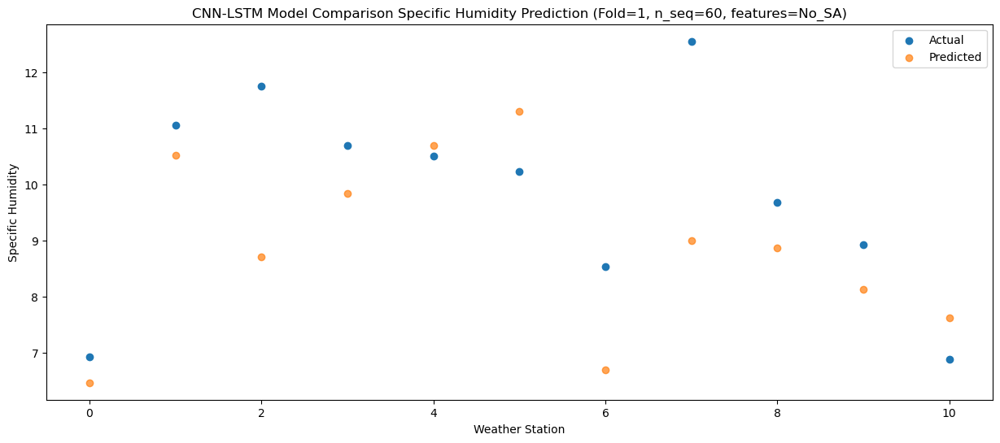

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    3.06   3.505159
1                 1    7.95   7.520197
2                 2    7.94   5.511245
3                 3    9.50   6.736708
4                 4    9.76   7.573009
5                 5    9.87   9.011998
6                 6    5.56   3.755734
7                 7    8.07   5.896138
8                 8    8.73   5.971895
9                 9    7.27   5.784346
10               10    5.62   5.289650


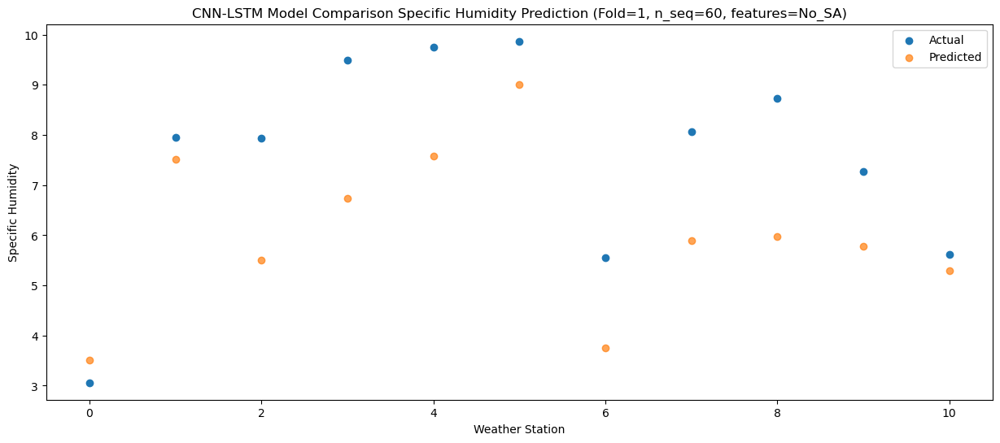

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   -0.34  -0.271199
1                 1    4.10   3.716707
2                 2    3.43   1.584250
3                 3    6.08   3.075415
4                 4    6.37   3.886499
5                 5    7.89   6.341228
6                 6    1.31  -0.012185
7                 7    4.82   2.106992
8                 8    5.30   2.554034
9                 9    4.16   3.046838
10               10    2.57   1.937884


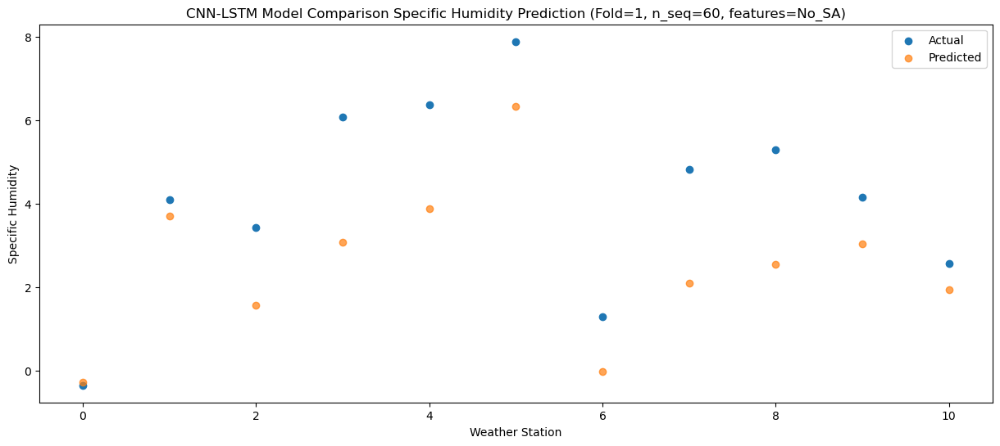

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -3.40  -3.233091
1                 1    1.09   0.785336
2                 2    0.88  -1.176553
3                 3    2.75   0.693939
4                 4    3.03   1.499614
5                 5    5.26   4.381460
6                 6   -2.04  -3.005362
7                 7    2.11  -0.601200
8                 8    2.63   0.201720
9                 9    1.84   1.015211
10               10   -1.09  -1.470277


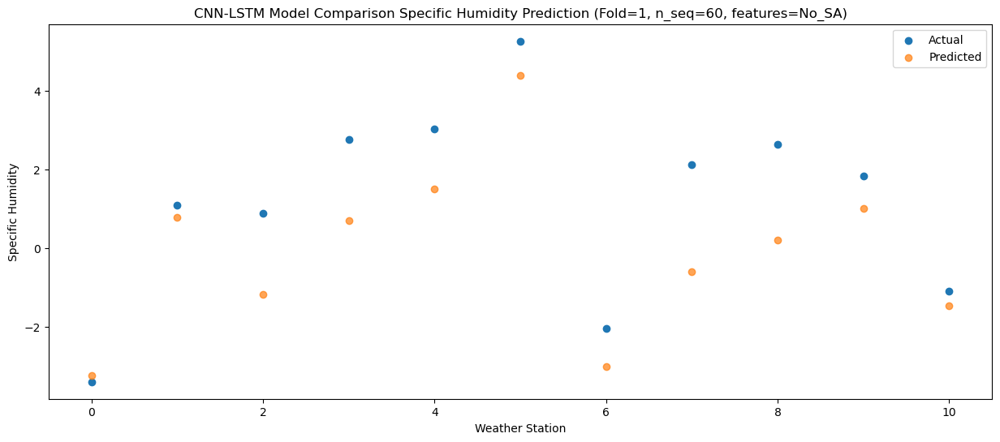

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -4.15  -3.357007
1                 1    0.51   0.545518
2                 2   -0.14  -1.734666
3                 3    1.11  -0.141526
4                 4    1.31   0.629122
5                 5    3.39   4.077311
6                 6   -2.54  -3.132245
7                 7    0.72  -1.285847
8                 8    1.58  -0.576487
9                 9    1.40   0.652981
10               10   -0.85  -0.764459


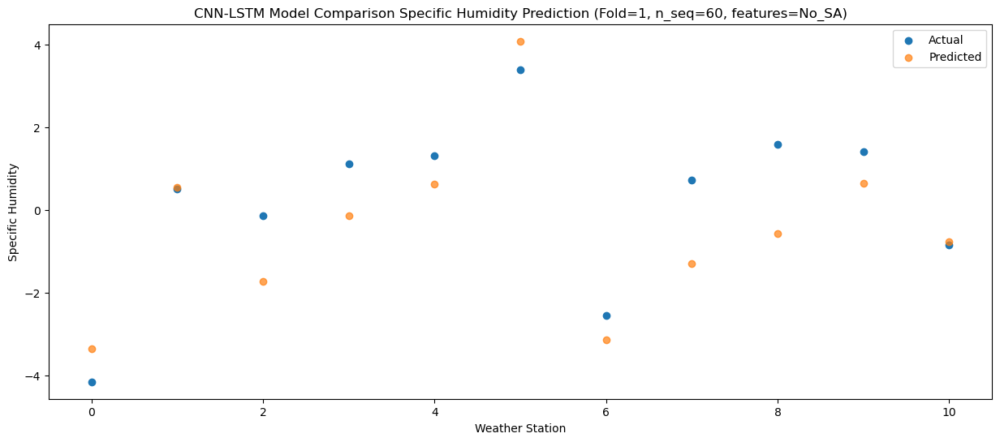

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.54  -4.292328
1                 1   -0.26  -0.423124
2                 2   -0.77  -2.700194
3                 3    0.01  -0.981674
4                 4    0.14  -0.230709
5                 5    2.24   3.692025
6                 6   -3.36  -4.101867
7                 7   -0.35  -2.322832
8                 8    0.27  -1.423030
9                 9    0.66   0.179621
10               10   -1.90  -1.768761


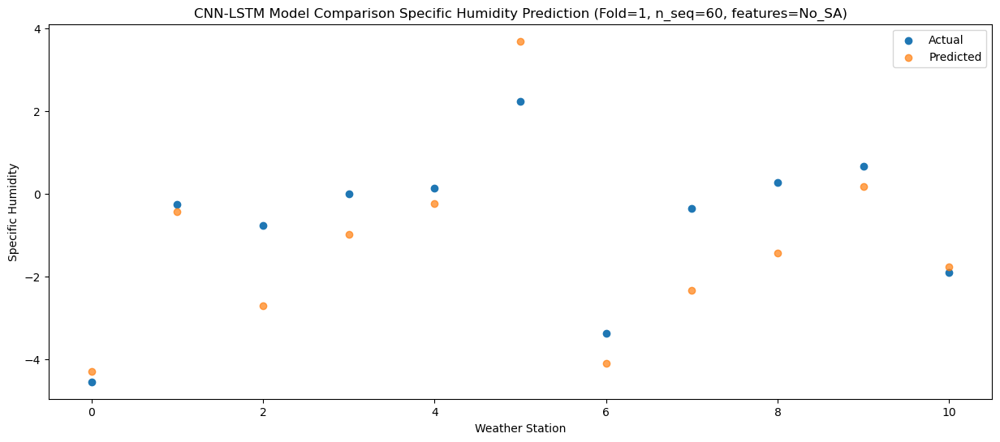

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -4.93  -4.086211
1                 1    0.08  -0.051495
2                 2    0.03  -2.068447
3                 3    2.26   0.079228
4                 4    2.39   0.875414
5                 5    2.65   4.477371
6                 6   -2.88  -3.831269
7                 7    1.40  -1.281303
8                 8    2.02  -0.156167
9                 9    1.33   1.100630
10               10   -2.03  -2.027183


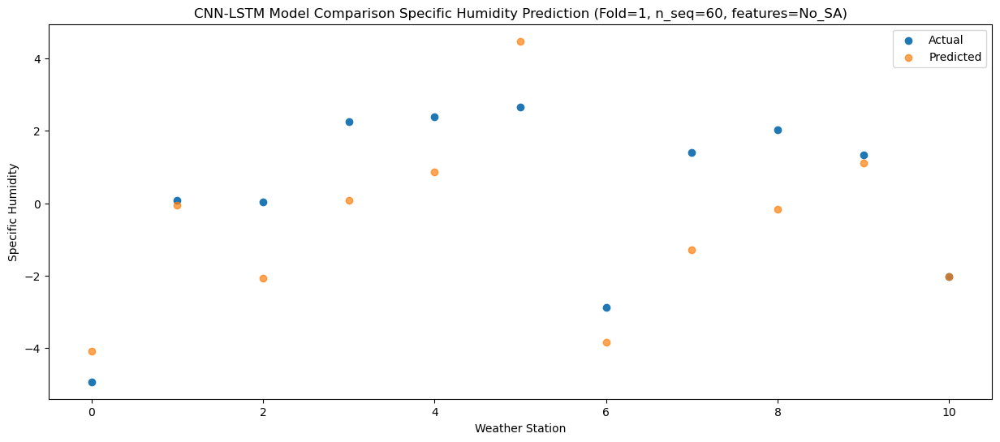

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.52  -2.901941
1                 1    1.59   1.111018
2                 2    1.57  -0.814851
3                 3    4.17   1.091593
4                 4    4.32   1.893189
5                 5    3.61   4.792447
6                 6   -1.54  -2.691494
7                 7    2.59  -0.294930
8                 8    3.57   0.545150
9                 9    1.64   1.395120
10               10   -1.00  -1.259236


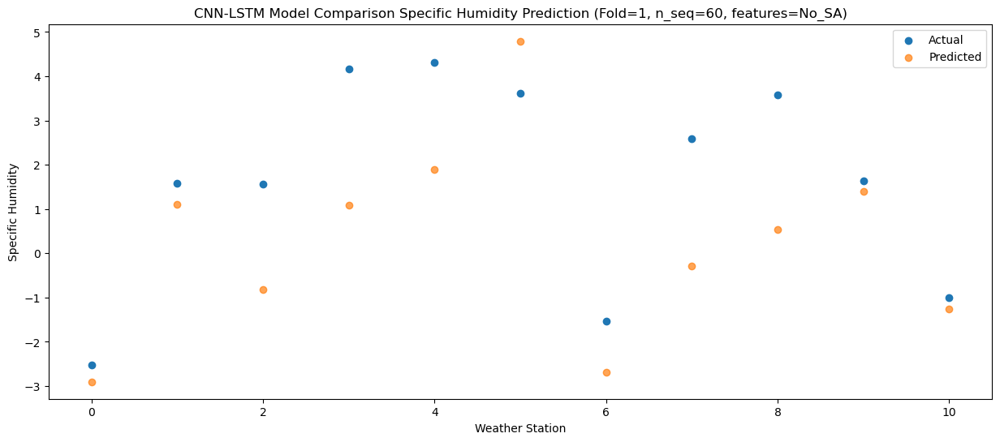

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -1.45  -1.163727
1                 1    3.48   2.911541
2                 2    3.56   1.031205
3                 3    6.42   2.876519
4                 4    6.52   3.707589
5                 5    4.25   5.999470
6                 6    0.61  -0.908934
7                 7    4.36   1.694016
8                 8    5.89   2.368830
9                 9    2.50   2.728072
10               10    0.61   0.443821


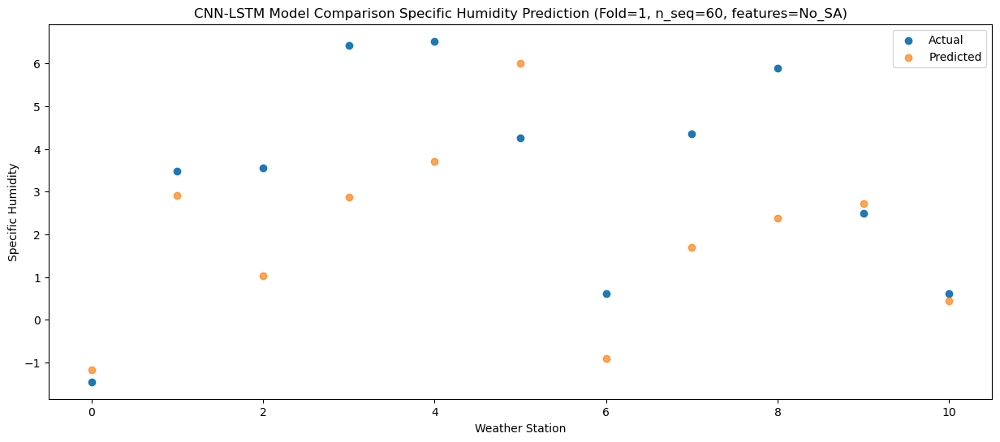

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    2.75   2.694516
1                 1    7.28   6.794991
2                 2    7.69   5.010873
3                 3   10.77   6.409581
4                 4   10.50   7.273240
5                 5    6.68   8.113298
6                 6    4.75   2.948795
7                 7    8.67   5.496497
8                 8    9.49   5.596780
9                 9    5.23   4.964764
10               10    4.19   3.915737


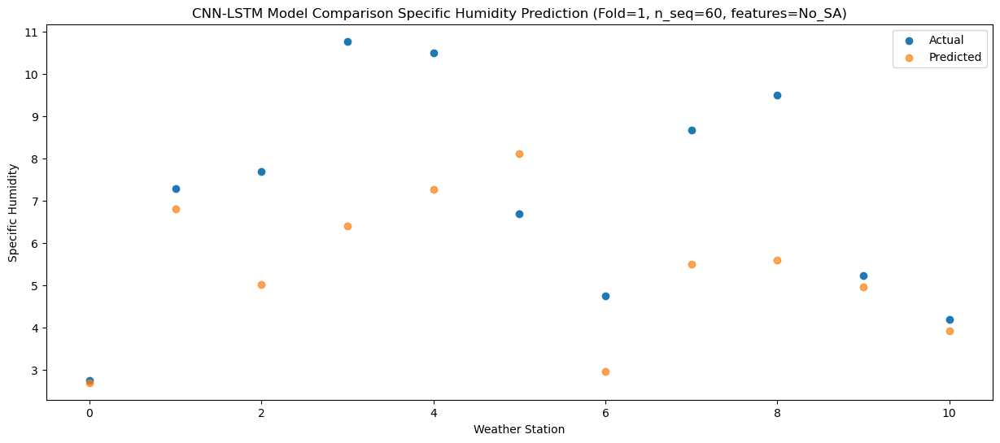

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    4.82   4.618781
1                 1    8.79   8.803950
2                 2    9.12   6.951146
3                 3   12.16   8.436880
4                 4   12.01   9.327726
5                 5   11.53  10.102385
6                 6    6.71   4.972285
7                 7   10.69   7.832247
8                 8   12.40   7.946890
9                 9   10.90   7.113129
10               10    6.01   6.285214


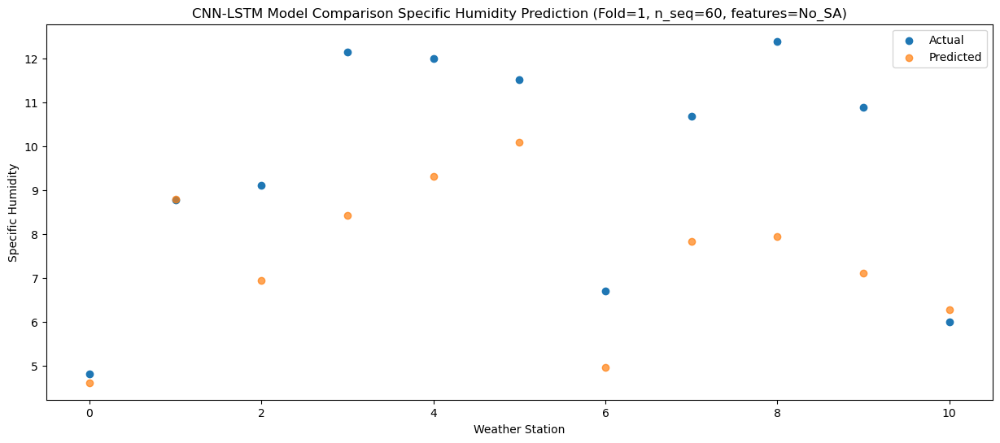

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    7.24   6.822038
1                 1   11.39  10.826201
2                 2   12.29   8.769782
3                 3   12.24   9.717598
4                 4   12.33  10.560581
5                 5   11.38  11.384501
6                 6    9.09   7.080352
7                 7   11.36   9.058115
8                 8   11.01   8.819933
9                 9    9.15   8.209900
10               10    9.38   8.685926


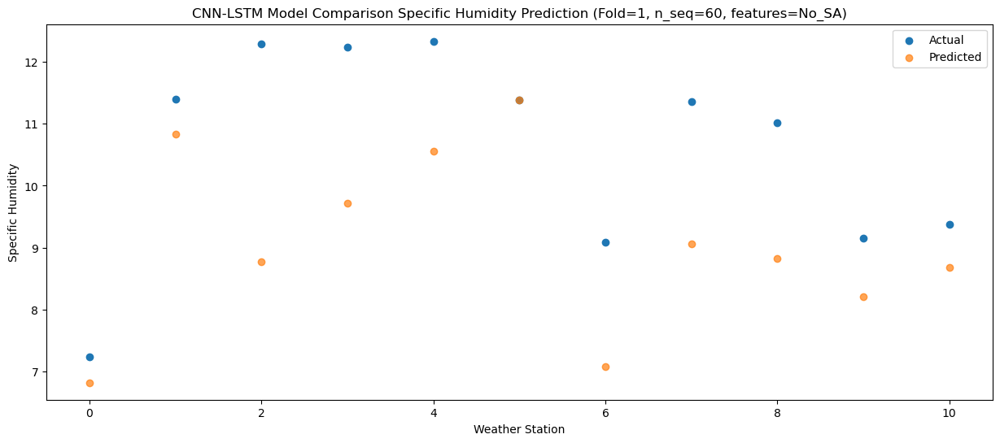

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    6.60   5.963830
1                 1    9.66   9.991593
2                 2   10.17   7.915842
3                 3   12.33   9.024504
4                 4   12.38   9.866821
5                 5   10.24  11.019804
6                 6    7.37   6.246941
7                 7   10.12   8.356042
8                 8   10.42   8.290541
9                 9    9.34   7.863241
10               10    7.80   7.960290


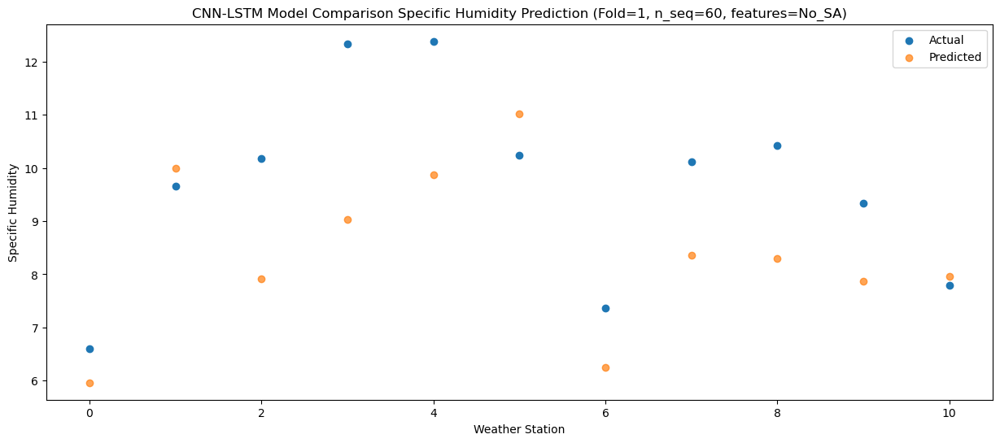

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    4.61   4.045356
1                 1    8.14   7.951069
2                 2    8.62   5.902437
3                 3    9.41   6.978245
4                 4    9.84   7.771160
5                 5   10.72   9.473618
6                 6    6.08   4.205352
7                 7    8.36   5.875231
8                 8    8.51   5.928425
9                 9    6.90   6.074777
10               10    5.31   5.622052


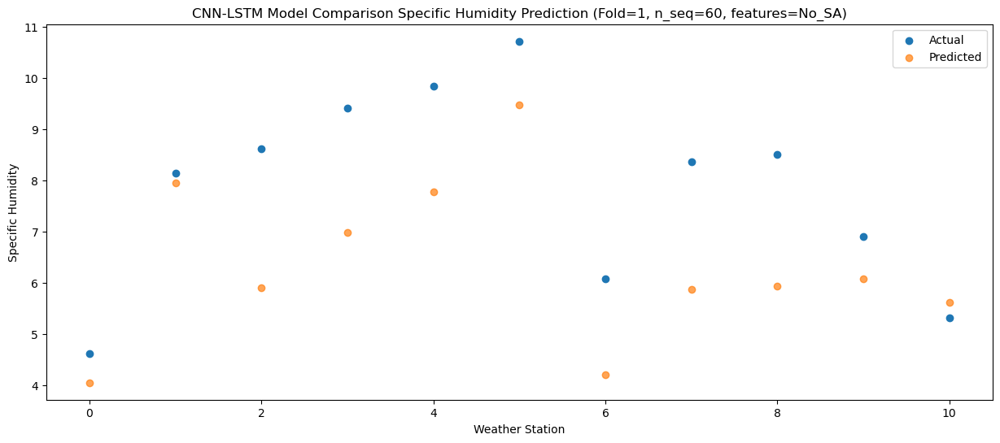

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   -0.34  -0.504960
1                 1    4.31   3.397929
2                 2    4.12   1.268422
3                 3    5.36   2.800792
4                 4    5.51   3.570423
5                 5    6.45   6.531423
6                 6    1.94  -0.329603
7                 7    3.32   1.483686
8                 8    5.15   2.073976
9                 9    3.91   3.052111
10               10    1.00   1.435159


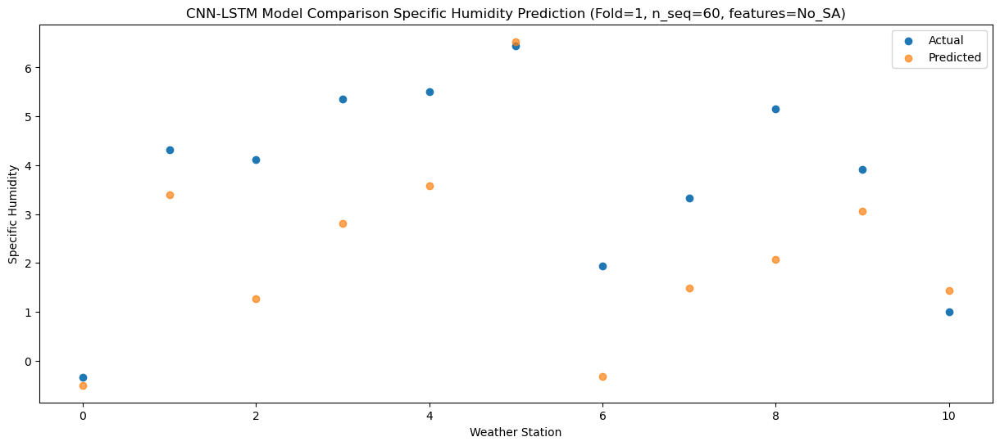

f, t:
[[-3.880e+00  1.110e+00 -5.000e-02  1.890e+00  2.440e+00  4.760e+00
  -2.550e+00  1.260e+00  2.020e+00  1.350e+00 -1.820e+00]
 [-3.280e+00  1.160e+00  8.600e-01  6.900e-01  1.200e+00  3.280e+00
  -2.520e+00  9.300e-01  1.180e+00  7.000e-01 -1.830e+00]
 [-3.470e+00  9.100e-01  3.500e-01  1.590e+00  2.110e+00  3.000e+00
  -2.940e+00  8.500e-01  1.630e+00  5.500e-01 -1.980e+00]
 [-3.560e+00  1.430e+00  7.400e-01  8.900e-01  1.430e+00  3.180e+00
  -2.460e+00  7.300e-01  1.010e+00  5.600e-01 -1.910e+00]
 [-1.260e+00  3.660e+00  3.900e+00  5.250e+00  6.160e+00  5.850e+00
  -4.900e-01  3.390e+00  4.030e+00  2.450e+00 -9.600e-01]
 [-1.520e+00  2.070e+00  2.280e+00  4.910e+00  5.850e+00  4.840e+00
  -1.140e+00  3.650e+00  4.220e+00  2.610e+00 -6.700e-01]
 [ 1.380e+00  5.080e+00  5.050e+00  6.890e+00  7.970e+00  7.520e+00
   2.060e+00  6.550e+00  7.550e+00  5.430e+00  1.900e+00]
 [ 4.620e+00  8.880e+00  8.900e+00  9.010e+00  1.026e+01  9.340e+00
   5.700e+00  1.038e+01  9.690e+00  7.140e+0

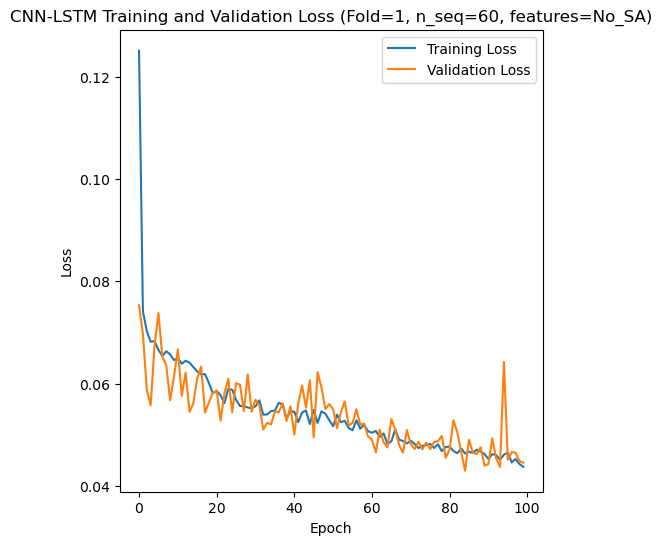

[[ 4.97  3.84  5.83 ... 12.86  8.48  8.25]
 [ 2.46  2.06  3.48 ...  9.57  6.71  5.1 ]
 [ 8.78  8.15  9.01 ... 20.36 15.38 12.95]
 ...
 [ 1.89  2.51  2.73 ...  7.42  4.53  3.35]
 [ 5.04  4.9   5.93 ... 10.09  8.19  4.88]
 [ 5.06  3.79  4.84 ... 13.58  8.96  7.8 ]]
Epoch 1/100
84/84 [==============================] - 19s 89ms/step - loss: 0.1410 - accuracy: 0.2381 - mae: 0.1208 - rmse: 0.1410 - mape: 25.5944 - pearson: 0.5819 - val_loss: 0.0615 - val_accuracy: 0.1000 - val_mae: 0.0461 - val_rmse: 0.0615 - val_mape: 9.8990 - val_pearson: 0.8303
Epoch 2/100
84/84 [==============================] - 3s 32ms/step - loss: 0.0754 - accuracy: 0.3810 - mae: 0.0594 - rmse: 0.0754 - mape: 13.3499 - pearson: 0.7385 - val_loss: 0.0568 - val_accuracy: 0.8000 - val_mae: 0.0445 - val_rmse: 0.0568 - val_mape: 10.0152 - val_pearson: 0.8582
Epoch 3/100
84/84 [==============================] - 3s 32ms/step - loss: 0.0713 - accuracy: 0.4762 - mae: 0.0559 - rmse: 0.0713 - mape: 12.5740 - pearson: 0.7583 - val

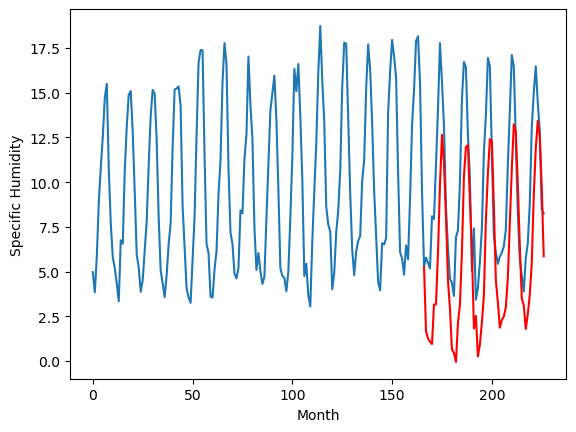

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.34		2.42		-0.92
2.83		2.10		-0.73
2.81		1.88		-0.93
2.87		1.68		-1.19
4.66		3.38		-1.28
4.95		3.60		-1.35
7.85		6.28		-1.57
9.27		9.67		0.40
14.08		11.99		-2.09
12.65		10.70		-1.95
8.59		7.91		-0.68
4.86		4.89		0.03
4.64		3.57		-1.07
2.91		1.81		-1.10
2.86		1.66		-1.20
2.18		1.13		-1.05
4.03		2.93		-1.10
4.15		3.87		-0.28
9.27		6.42		-2.85
12.18		10.21		-1.97
13.79		11.85		-1.94
12.17		11.83		-0.34
9.35		9.03		-0.32
5.96		6.72		0.76
3.53		3.14		-0.39
2.47		3.21		0.74
2.14		1.77		-0.37
2.05		2.24		0.19
2.93		3.43		0.50
4.08		4.44		0.36
6.47		8.02		1.55
10.83		10.58		-0.25
12.17		12.51		0.34
11.67		12.49		0.82
9.10		9.38		0.28
5.42		5.94		0.52
3.92		4.33		0.41
2.73		3.19		0.46
2.72		3.70		0.98
2.64		3.60		0.96
3.33		4.07		0.74
3.95		5.61		1.66
9.73		8.53		-1.20
12.38		11.13		-1.25
14.44		13.33		-1.11
12.55		13.13		0.58
9.96		10.60		0.64
6.50		7.61		1.11
3.94		4.88		0.94
3.55		4.74		1.19
2.96	

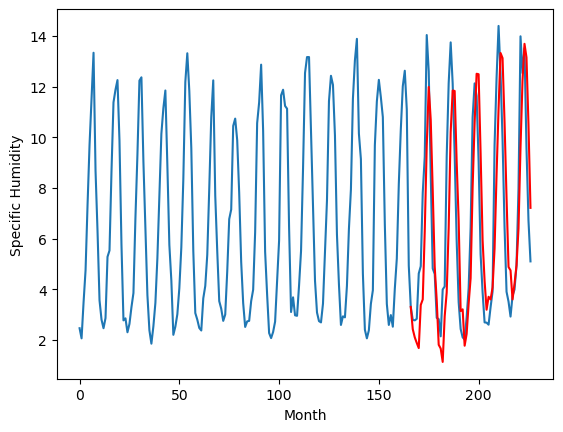

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.46		-2.00		0.46
-2.15		-1.86		0.29
-3.71		-2.33		1.38
-2.83		-2.01		0.82
-1.66		-0.31		1.35
-0.18		-0.21		-0.03
0.93		1.51		0.58
4.27		4.93		0.66
5.29		6.62		1.33
5.99		7.26		1.27
5.29		4.71		-0.58
2.70		2.83		0.13
-0.25		-0.01		0.24
-4.92		-3.13		1.79
-4.43		-3.14		1.29
-2.30		-2.57		-0.27
-2.08		-1.54		0.54
-1.11		-0.94		0.17
0.20		1.17		0.97
3.98		5.09		1.11
4.38		6.75		2.37
5.00		6.89		1.89
3.72		5.05		1.33
1.06		2.48		1.42
-2.89		-1.74		1.15
-1.49		-0.31		1.18
-5.14		-2.64		2.50
-3.95		-1.48		2.47
-2.14		-0.41		1.73
-0.78		0.24		1.02
2.32		3.55		1.23
4.25		5.74		1.49
5.08		8.06		2.98
4.97		7.67		2.70
4.82		5.13		0.31
0.43		1.72		1.29
0.32		0.60		0.28
-3.34		-1.27		2.07
-3.72		-0.81		2.91
-1.87		-0.05		1.82
-1.48		-0.02		1.46
0.03		1.91		1.88
0.84		3.53		2.69
4.00		6.00		2.00
4.97		8.73		3.76
5.69		8.61		2.92
3.30		5.91		2.61
0.38		2.80		2.42
-2.12		0.28		2.40
-2.69		-0.25		2.44
-3.76	

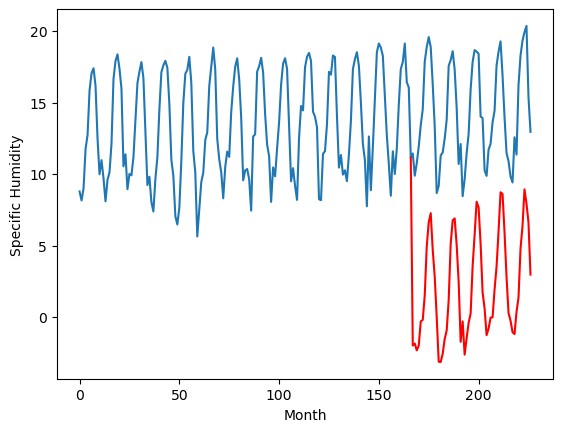

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.49		5.30		0.81
3.93		5.18		1.25
3.75		4.80		1.05
3.77		4.71		0.94
4.29		5.92		1.63
4.67		6.18		1.51
6.92		8.81		1.89
10.93		12.66		1.73
14.31		15.31		1.00
13.48		14.45		0.97
10.39		11.12		0.73
7.88		8.38		0.50
6.01		6.68		0.67
4.09		4.66		0.57
3.01		4.33		1.32
3.18		4.00		0.82
3.82		5.45		1.63
5.17		6.56		1.39
6.85		8.61		1.76
11.45		13.02		1.57
14.05		14.85		0.80
14.79		15.27		0.48
12.13		12.30		0.17
9.17		10.09		0.92
4.72		5.58		0.86
4.36		5.65		1.29
3.03		4.39		1.36
3.60		5.11		1.51
4.36		6.23		1.87
5.06		6.81		1.75
8.36		10.57		2.21
10.62		12.90		2.28
13.98		15.61		1.63
14.66		15.40		0.74
10.86		12.42		1.56
7.99		8.65		0.66
6.17		7.17		1.00
4.08		5.50		1.42
4.59		6.23		1.64
3.83		6.10		2.27
4.08		6.19		2.11
6.16		8.24		2.08
6.97		9.93		2.96
10.87		12.84		1.97
15.13		16.30		1.17
12.79		15.72		2.93
11.78		13.23		1.45
8.42		10.14		1.72
4.59		6.99		2.40
4.88		7.27		2.39
3.55		6.12		2.57
3.5

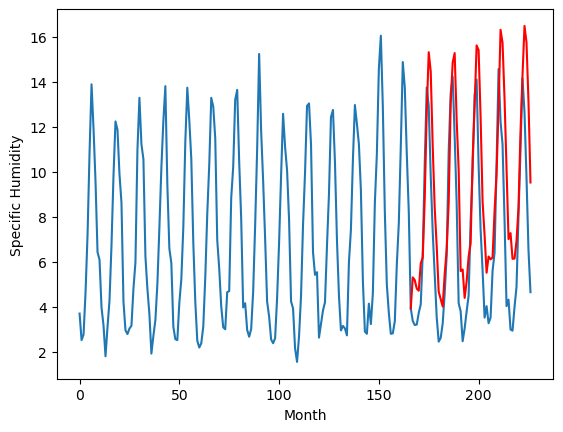

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.07		-0.54		1.53
-1.27		-0.72		0.55
-1.24		-0.99		0.25
-0.92		-0.84		0.08
2.57		1.52		-1.05
1.61		1.44		-0.17
3.73		3.73		-0.00
7.07		7.35		0.28
9.20		9.57		0.37
8.47		9.09		0.62
6.67		6.45		-0.22
3.46		3.57		0.11
0.73		1.14		0.41
-2.55		-1.86		0.69
-2.42		-1.91		0.51
-2.44		-1.77		0.67
0.85		0.04		-0.81
0.87		0.77		-0.10
4.07		3.59		-0.48
7.96		7.66		-0.30
8.99		9.23		0.24
8.59		9.27		0.68
6.45		6.82		0.37
3.92		3.95		0.03
-1.74		-0.50		1.24
1.54		1.05		-0.49
-3.37		-1.80		1.57
-1.91		-0.81		1.10
-1.06		0.39		1.45
1.37		1.78		0.41
5.40		5.70		0.30
7.70		8.12		0.42
8.99		10.04		1.05
9.39		9.78		0.39
5.88		6.49		0.61
0.70		2.53		1.83
0.26		1.54		1.28
-0.29		-0.14		0.15
-0.38		0.18		0.56
0.92		0.93		0.01
1.80		1.31		-0.49
2.35		3.00		0.65
5.41		5.69		0.28
8.72		8.51		-0.21
10.06		10.85		0.79
10.09		10.63		0.54
7.74		7.62		-0.12
2.51		4.14		1.63
-0.01		1.50		1.51
-1.60		0.73		2.33
-2.47		-0.35

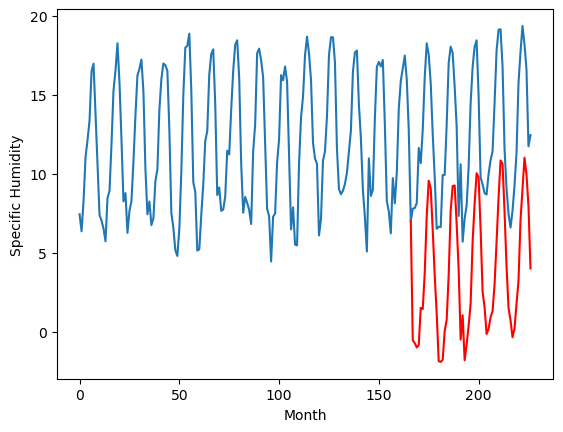

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.77		3.99		0.22
2.58		3.57		0.99
3.41		3.44		0.03
2.74		3.36		0.62
7.35		5.88		-1.47
6.83		5.82		-1.01
8.91		8.53		-0.38
11.03		12.13		1.10
13.61		14.62		1.01
12.17		13.24		1.07
10.72		10.57		-0.15
6.85		7.11		0.26
4.79		5.28		0.49
2.47		2.80		0.33
2.34		2.72		0.38
2.29		2.40		0.11
5.28		4.65		-0.63
6.85		5.50		-1.35
11.68		8.63		-3.05
14.32		12.61		-1.71
13.28		14.14		0.86
13.41		14.06		0.65
9.85		11.21		1.36
8.26		8.38		0.12
4.07		4.19		0.12
6.94		5.29		-1.65
1.31		2.63		1.32
1.53		3.34		1.81
3.15		4.62		1.47
7.11		6.30		-0.81
10.76		10.40		-0.36
11.79		13.00		1.21
12.89		14.64		1.75
13.35		14.55		1.20
9.99		10.93		0.94
5.17		6.90		1.73
5.03		5.76		0.73
4.12		4.41		0.29
3.74		4.70		0.96
4.19		5.15		0.96
5.97		5.79		-0.18
6.52		7.25		0.73
10.22		10.68		0.46
13.68		13.55		-0.13
13.39		15.53		2.14
11.96		15.31		3.35
11.41		12.30		0.89
7.88		8.83		0.95
4.71		6.14		1.43
2.78		5.42		2.64
1.77		4

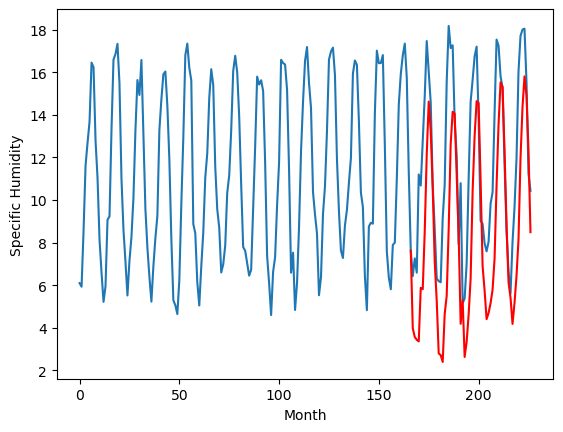

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		2.84		-0.05
1.79		2.36		0.57
2.47		2.26		-0.21
1.91		2.11		0.20
6.13		4.63		-1.50
5.71		4.57		-1.14
8.65		7.47		-1.18
10.93		11.13		0.20
13.84		13.79		-0.05
11.14		12.09		0.95
10.20		9.31		-0.89
5.71		5.63		-0.08
4.12		4.02		-0.10
1.41		1.70		0.29
1.31		1.58		0.27
0.98		1.09		0.11
3.84		3.47		-0.37
5.16		4.39		-0.77
9.36		7.60		-1.76
13.11		11.64		-1.47
13.93		13.18		-0.75
14.31		13.11		-1.20
9.86		10.05		0.19
7.25		7.25		-0.00
3.26		3.03		-0.23
5.76		3.95		-1.81
0.47		1.39		0.92
0.94		2.01		1.07
2.57		3.30		0.73
6.47		5.07		-1.40
10.56		9.28		-1.28
11.36		11.93		0.57
10.68		13.56		2.88
11.74		13.51		1.77
9.07		9.76		0.69
4.29		5.63		1.34
3.84		4.45		0.61
2.67		3.17		0.50
1.89		3.47		1.58
2.29		3.80		1.51
4.20		4.48		0.28
4.87		5.92		1.05
8.76		9.50		0.74
12.66		12.46		-0.20
11.95		14.45		2.50
9.90		14.18		4.28
9.27		11.17		1.90
6.12		7.66		1.54
3.50		4.89		1.39
1.68		4.24		2.56
0.56		2

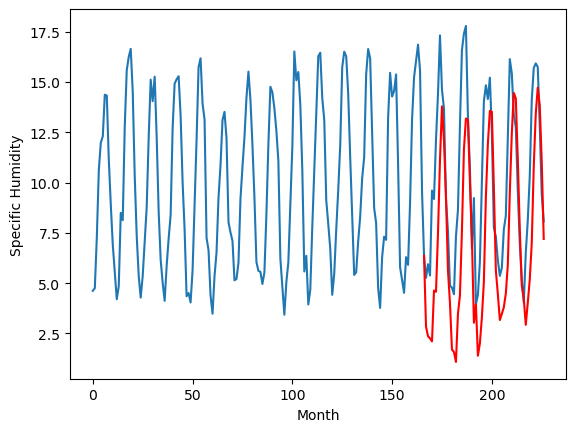

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.55		2.77		-0.78
3.10		2.63		-0.47
2.15		2.37		0.22
2.68		2.20		-0.48
4.14		3.39		-0.75
2.74		3.82		1.08
2.98		5.82		2.84
4.66		8.47		3.81
8.10		9.81		1.71
6.37		9.49		3.12
5.72		7.36		1.64
2.65		5.37		2.72
2.70		3.92		1.22
1.44		2.39		0.95
1.72		2.46		0.74
1.59		2.25		0.66
1.68		3.36		1.68
1.98		4.00		2.02
2.10		6.05		3.95
4.76		8.99		4.23
10.00		10.58		0.58
10.29		10.28		-0.01
7.53		8.39		0.86
3.82		6.43		2.61
2.17		4.08		1.91
2.30		3.84		1.54
2.02		3.06		1.04
1.03		3.45		2.42
1.43		4.57		3.14
1.44		4.92		3.48
1.37		7.52		6.15
6.87		9.89		3.02
9.43		11.62		2.19
11.40		11.68		0.28
8.36		9.39		1.03
6.28		7.07		0.79
2.31		5.10		2.79
3.13		4.28		1.15
2.24		4.83		2.59
2.12		4.67		2.55
2.46		5.06		2.60
1.62		6.44		4.82
3.62		9.08		5.46
3.42		10.92		7.50
6.77		12.44		5.67
8.96		12.65		3.69
7.15		10.57		3.42
4.70		8.25		3.55
3.78		6.03		2.25
2.26		5.91		3.65
2.68		5.14		2.46
2.70		5.44		2.74
2.92	

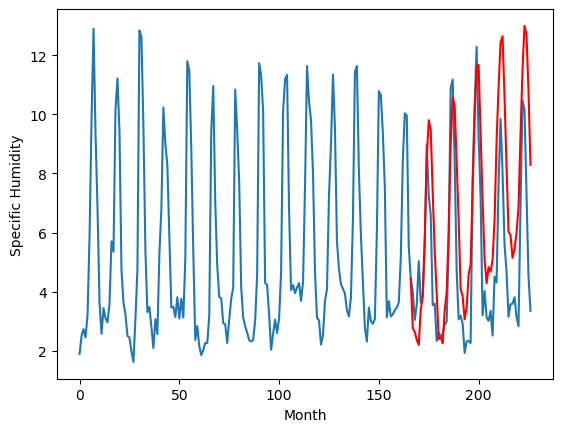

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		0.93		-1.30
2.05		0.89		-1.16
1.84		0.63		-1.21
1.12		0.40		-0.72
2.76		1.21		-1.55
4.17		1.80		-2.37
4.93		3.32		-1.61
4.91		5.26		0.35
5.68		5.76		0.08
6.76		6.03		-0.73
4.98		4.50		-0.48
3.85		3.23		-0.62
1.61		1.87		0.26
0.04		0.72		0.68
0.89		0.96		0.07
1.42		0.88		-0.54
1.53		1.51		-0.02
2.85		1.92		-0.93
4.33		3.63		-0.70
5.58		5.74		0.16
6.73		7.25		0.52
6.13		6.65		0.52
5.67		5.45		-0.22
2.87		3.81		0.94
2.33		2.71		0.38
2.15		2.06		-0.09
0.79		1.90		1.11
0.05		2.12		2.07
1.79		3.21		1.42
2.63		3.06		0.43
3.89		4.82		0.93
5.66		7.08		1.42
6.55		8.49		1.94
6.65		8.67		2.02
7.50		7.01		-0.49
5.73		5.68		-0.05
1.09		3.35		2.26
1.94		2.94		1.00
2.03		3.50		1.47
0.62		3.21		2.59
2.54		3.59		1.05
3.24		4.76		1.52
4.64		7.41		2.77
5.02		8.57		3.55
6.36		9.31		2.95
6.97		9.88		2.91
6.72		8.19		1.47
4.42		6.47		2.05
1.39		4.72		3.33
2.18		4.60		2.42
2.15		4.11		1.96
3.12		4.27		1.15
1.5

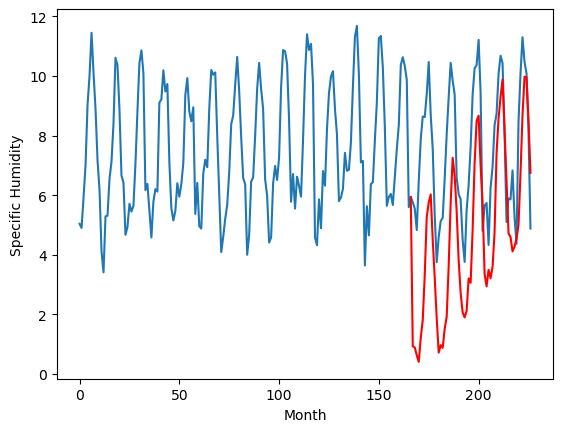

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.17		0.94		1.11
-0.06		0.87		0.93
-0.08		0.47		0.55
0.31		0.55		0.24
1.94		2.15		0.21
1.85		2.26		0.41
5.18		4.67		-0.51
8.69		8.52		-0.17
11.54		11.02		-0.52
11.53		10.56		-0.97
7.81		7.40		-0.41
5.19		4.74		-0.45
2.54		2.56		0.02
-0.68		-0.02		0.66
-0.80		-0.26		0.54
-0.73		-0.29		0.44
1.00		1.16		0.16
1.53		2.12		0.59
4.24		4.37		0.13
8.74		8.78		0.04
10.26		10.55		0.29
10.84		10.91		0.07
7.24		8.19		0.95
5.08		5.70		0.62
-0.48		1.00		1.48
1.37		1.77		0.40
-1.41		-0.17		1.24
-0.10		0.77		0.87
0.86		1.88		1.02
1.90		2.69		0.79
6.22		6.53		0.31
8.02		8.85		0.83
11.60		11.42		-0.18
10.03		11.11		1.08
6.60		8.08		1.48
2.24		4.16		1.92
1.77		2.96		1.19
-0.47		1.12		1.59
0.39		1.70		1.31
1.15		2.00		0.85
0.84		2.08		1.24
2.97		4.12		1.15
4.50		5.89		1.39
7.36		8.82		1.46
11.20		12.11		0.91
10.71		11.61		0.90
7.57		8.89		1.32
3.38		5.60		2.22
0.27		2.60		2.33
0.18		2.48		2.30
-0.51		1.38		1.89

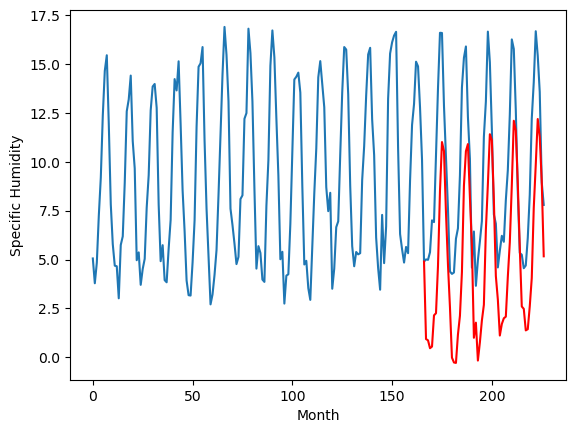

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.52		1.23		0.71
0.97		1.12		0.15
0.77		0.74		-0.03
0.88		0.75		-0.13
2.73		2.26		-0.47
2.16		2.41		0.25
4.95		4.95		0.00
8.39		8.82		0.43
11.09		11.41		0.32
10.85		10.71		-0.14
8.24		7.47		-0.77
5.05		4.70		-0.35
1.93		2.75		0.82
0.14		0.40		0.26
0.15		0.12		-0.03
0.39		-0.06		-0.45
1.42		1.44		0.02
2.03		2.47		0.44
4.70		4.70		0.00
8.80		9.12		0.32
10.21		10.91		0.70
10.60		11.28		0.68
7.39		8.42		1.03
5.66		6.01		0.35
0.30		1.38		1.08
1.86		1.89		0.03
-0.56		0.17		0.73
0.34		1.00		0.66
0.96		2.12		1.16
2.23		2.91		0.68
6.39		6.77		0.38
8.35		9.12		0.77
11.56		11.70		0.14
10.57		11.44		0.87
7.09		8.38		1.29
2.43		4.47		2.04
1.81		3.17		1.36
0.72		1.42		0.70
0.99		2.04		1.05
1.39		2.17		0.78
0.99		2.28		1.29
2.63		4.30		1.67
5.22		6.14		0.92
7.06		9.09		2.03
10.37		12.39		2.02
10.48		11.87		1.39
8.06		9.21		1.15
3.95		5.96		2.01
1.00		2.91		1.91
0.79		2.91		2.12
0.17		1.76		1.59
0.57		1.86	

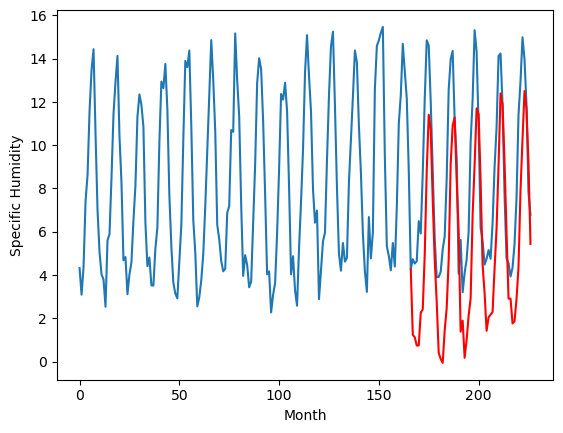

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.661489
1                 1    3.34   2.420689
2                 2   -2.46  -1.995563
3                 3    4.49   5.297293
4                 4   -2.07  -0.539059
5                 5    3.77   3.986185
6                 6    2.89   2.841180
7                 7    3.55   2.766103
8                 8    2.23   0.926104
9                 9   -0.17   0.935368
10               10    0.52   1.234869


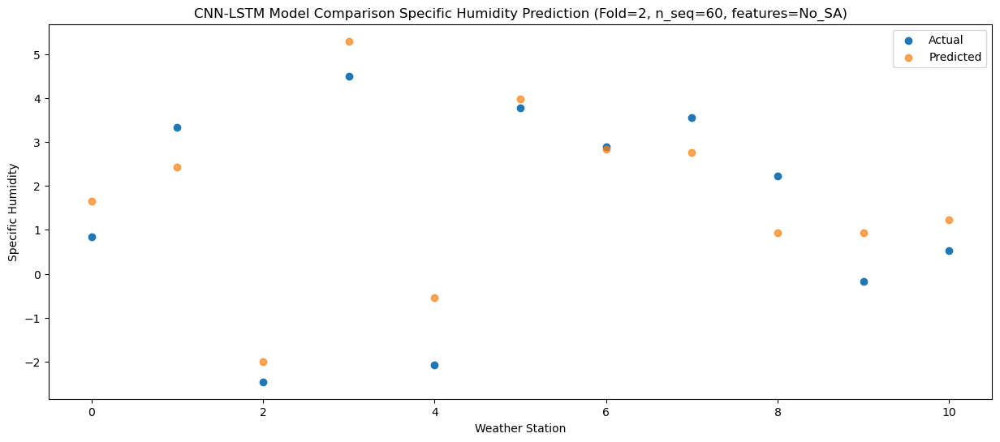

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.35   1.258434
1                 1    2.83   2.100650
2                 2   -2.15  -1.858832
3                 3    3.93   5.178546
4                 4   -1.27  -0.720525
5                 5    2.58   3.571526
6                 6    1.79   2.359023
7                 7    3.10   2.633737
8                 8    2.05   0.890658
9                 9   -0.06   0.869026
10               10    0.97   1.119652


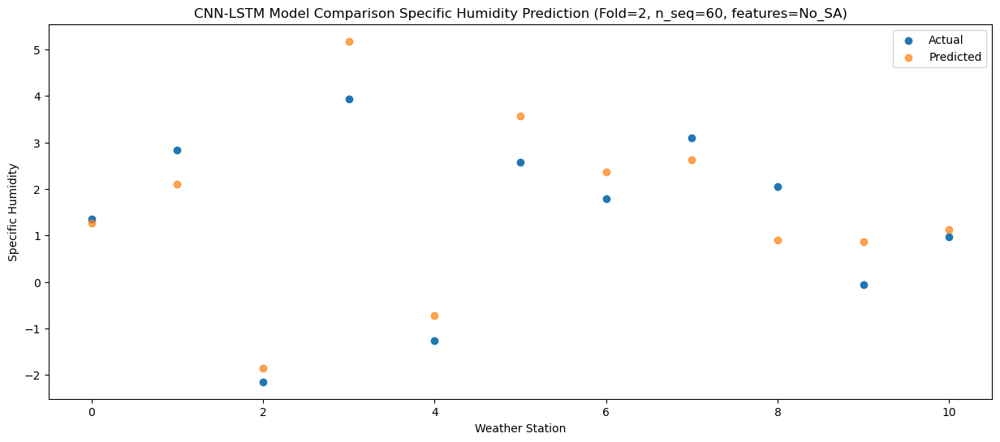

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.06   1.083216
1                 1    2.81   1.879694
2                 2   -3.71  -2.332639
3                 3    3.75   4.796951
4                 4   -1.24  -0.994118
5                 5    3.41   3.441437
6                 6    2.47   2.257044
7                 7    2.15   2.365113
8                 8    1.84   0.627855
9                 9   -0.08   0.465889
10               10    0.77   0.736996


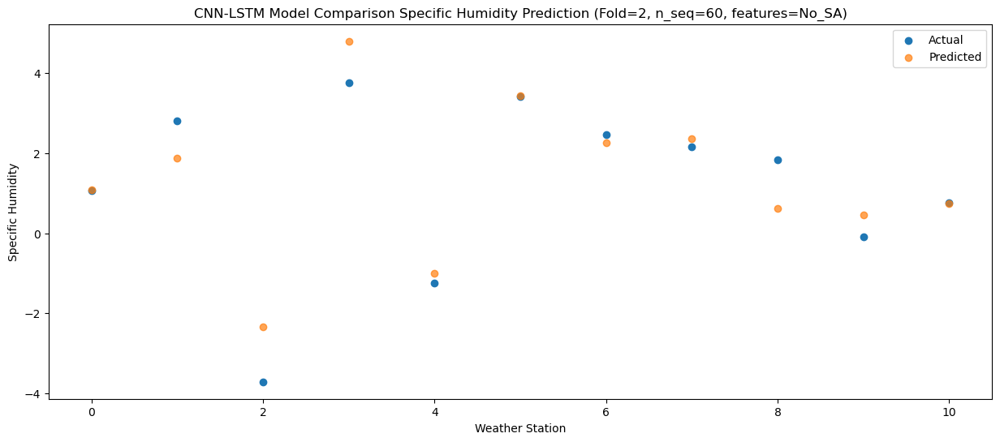

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.74   0.947825
1                 1    2.87   1.675457
2                 2   -2.83  -2.005232
3                 3    3.77   4.705726
4                 4   -0.92  -0.842963
5                 5    2.74   3.364056
6                 6    1.91   2.106185
7                 7    2.68   2.195381
8                 8    1.12   0.403546
9                 9    0.31   0.549382
10               10    0.88   0.745144


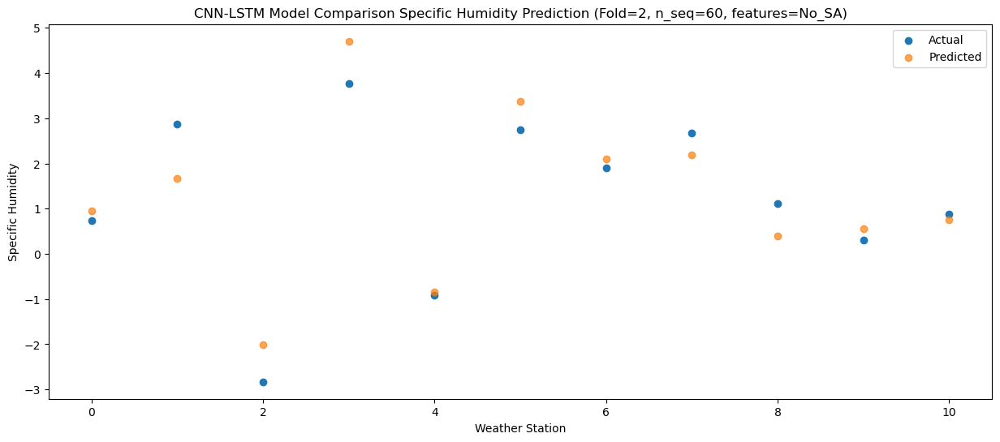

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.67   3.159879
1                 1    4.66   3.378205
2                 2   -1.66  -0.305349
3                 3    4.29   5.923196
4                 4    2.57   1.516129
5                 5    7.35   5.878390
6                 6    6.13   4.632007
7                 7    4.14   3.391794
8                 8    2.76   1.209838
9                 9    1.94   2.147011
10               10    2.73   2.257620


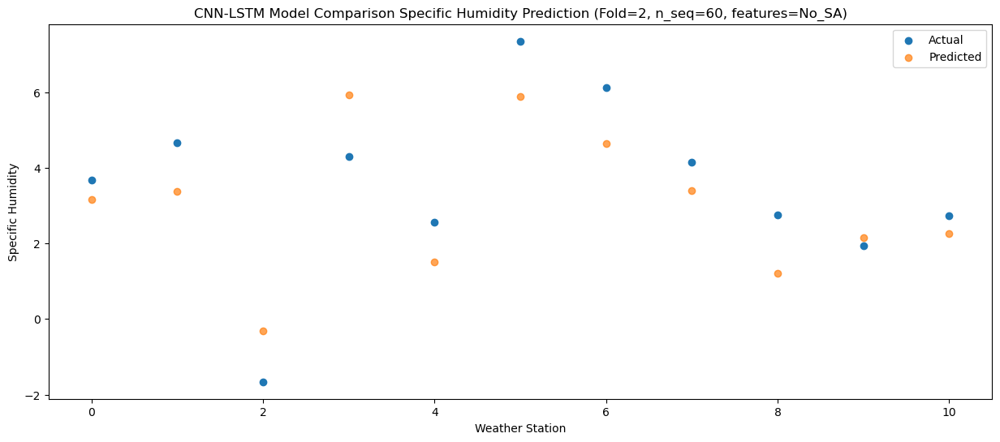

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.51   3.165756
1                 1    4.95   3.598345
2                 2   -0.18  -0.205636
3                 3    4.67   6.176236
4                 4    1.61   1.438229
5                 5    6.83   5.815939
6                 6    5.71   4.572841
7                 7    2.74   3.822357
8                 8    4.17   1.804032
9                 9    1.85   2.256996
10               10    2.16   2.410005


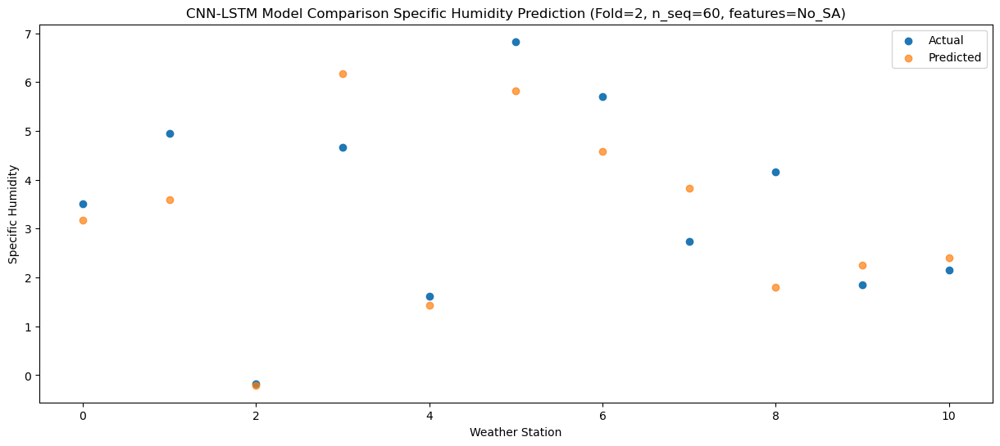

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.50   6.072869
1                 1    7.85   6.282215
2                 2    0.93   1.507510
3                 3    6.92   8.806308
4                 4    3.73   3.729037
5                 5    8.91   8.532527
6                 6    8.65   7.473892
7                 7    2.98   5.823058
8                 8    4.93   3.316503
9                 9    5.18   4.669322
10               10    4.95   4.953714


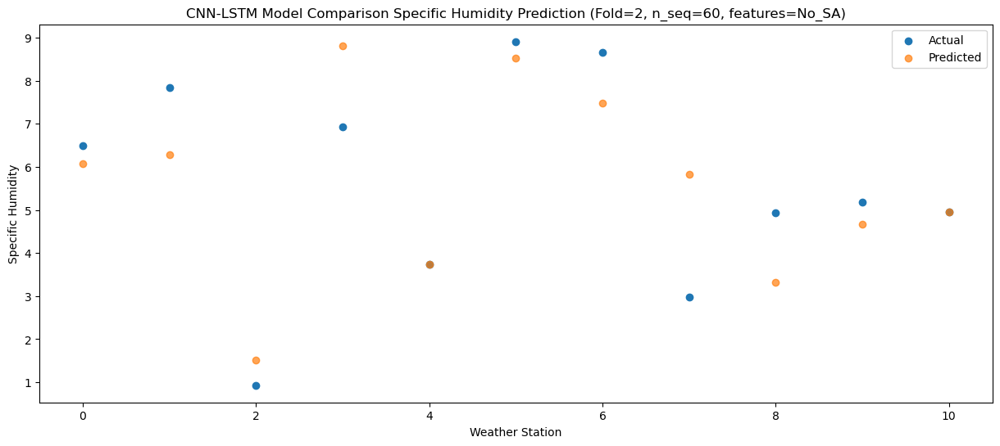

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.65   9.873716
1                 1    9.27   9.668790
2                 2    4.27   4.933953
3                 3   10.93  12.656437
4                 4    7.07   7.352648
5                 5   11.03  12.131777
6                 6   10.93  11.131036
7                 7    4.66   8.474948
8                 8    4.91   5.259176
9                 9    8.69   8.522198
10               10    8.39   8.817698


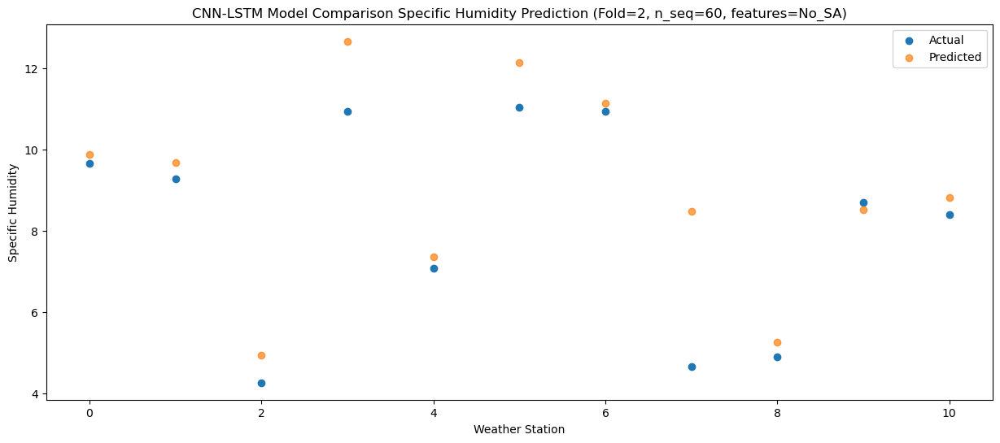

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.35  12.652176
1                 1   14.08  11.989001
2                 2    5.29   6.618612
3                 3   14.31  15.306095
4                 4    9.20   9.568237
5                 5   13.61  14.619381
6                 6   13.84  13.785890
7                 7    8.10   9.805165
8                 8    5.68   5.756760
9                 9   11.54  11.016599
10               10   11.09  11.412547


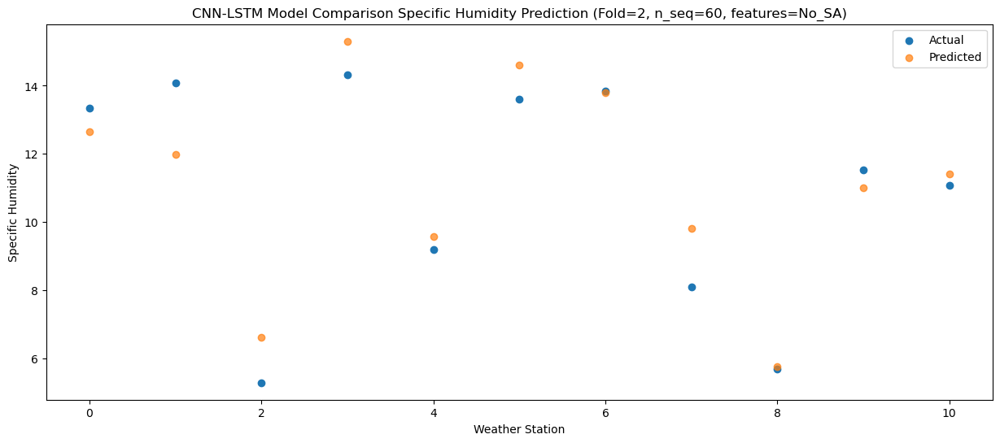

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.19  11.078274
1                 1   12.65  10.697993
2                 2    5.99   7.262912
3                 3   13.48  14.454890
4                 4    8.47   9.088377
5                 5   12.17  13.242251
6                 6   11.14  12.086103
7                 7    6.37   9.489716
8                 8    6.76   6.025333
9                 9   11.53  10.555541
10               10   10.85  10.706111


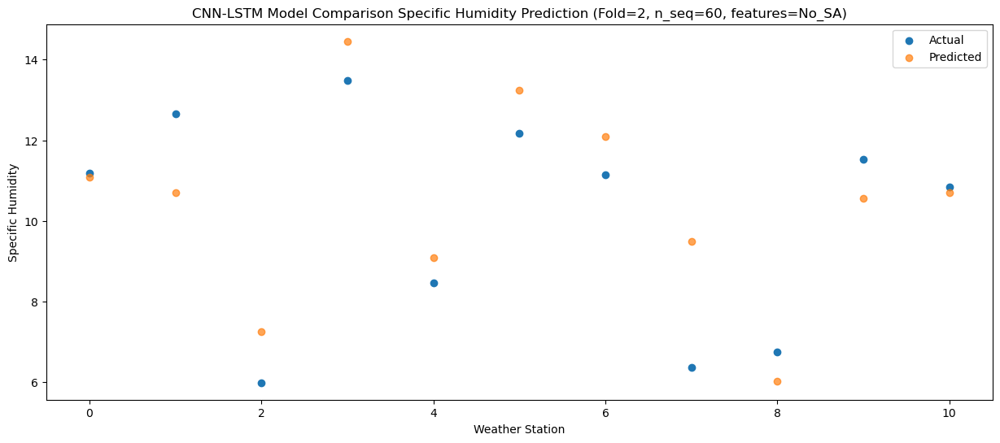

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.73   8.058868
1                 1    8.59   7.909238
2                 2    5.29   4.707506
3                 3   10.39  11.118486
4                 4    6.67   6.451341
5                 5   10.72  10.567206
6                 6   10.20   9.307900
7                 7    5.72   7.358468
8                 8    4.98   4.499419
9                 9    7.81   7.401759
10               10    8.24   7.474405


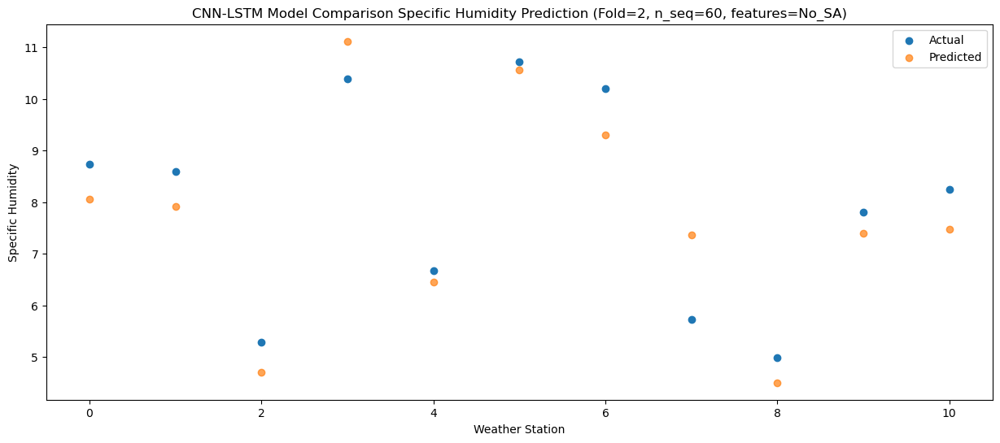

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.14   4.527694
1                 1    4.86   4.891601
2                 2    2.70   2.830532
3                 3    7.88   8.380048
4                 4    3.46   3.574554
5                 5    6.85   7.113150
6                 6    5.71   5.632903
7                 7    2.65   5.367874
8                 8    3.85   3.232377
9                 9    5.19   4.743251
10               10    5.05   4.704173


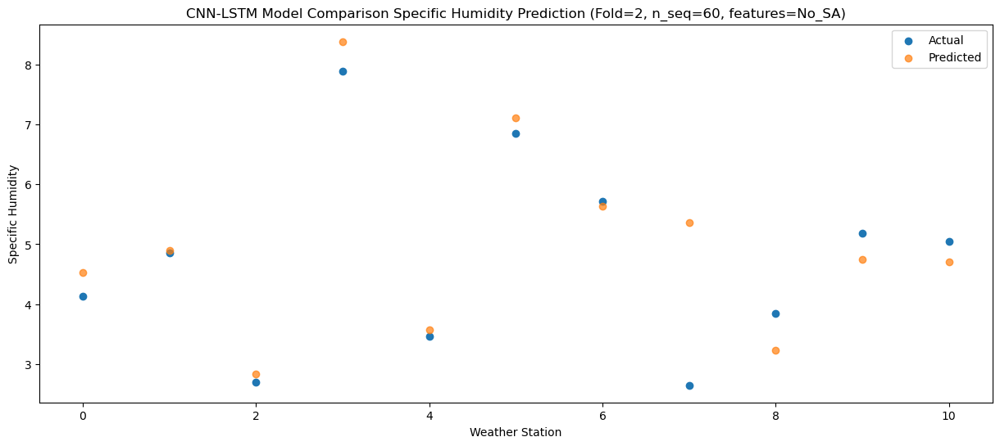

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.89   2.907326
1                 1    4.64   3.565841
2                 2   -0.25  -0.010708
3                 3    6.01   6.679008
4                 4    0.73   1.135127
5                 5    4.79   5.283659
6                 6    4.12   4.018740
7                 7    2.70   3.923104
8                 8    1.61   1.870447
9                 9    2.54   2.564397
10               10    1.93   2.752900


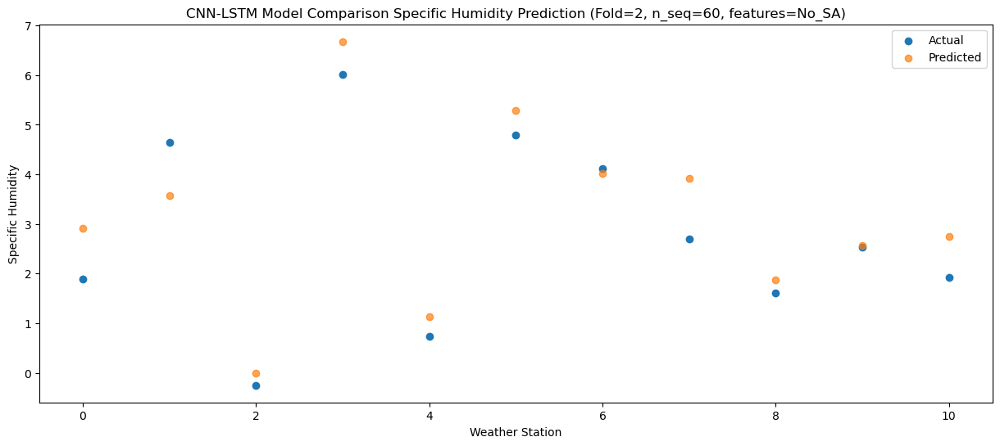

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.16   0.655620
1                 1    2.91   1.805415
2                 2   -4.92  -3.134339
3                 3    4.09   4.658509
4                 4   -2.55  -1.862705
5                 5    2.47   2.798050
6                 6    1.41   1.704722
7                 7    1.44   2.391857
8                 8    0.04   0.717115
9                 9   -0.68  -0.016247
10               10    0.14   0.401521


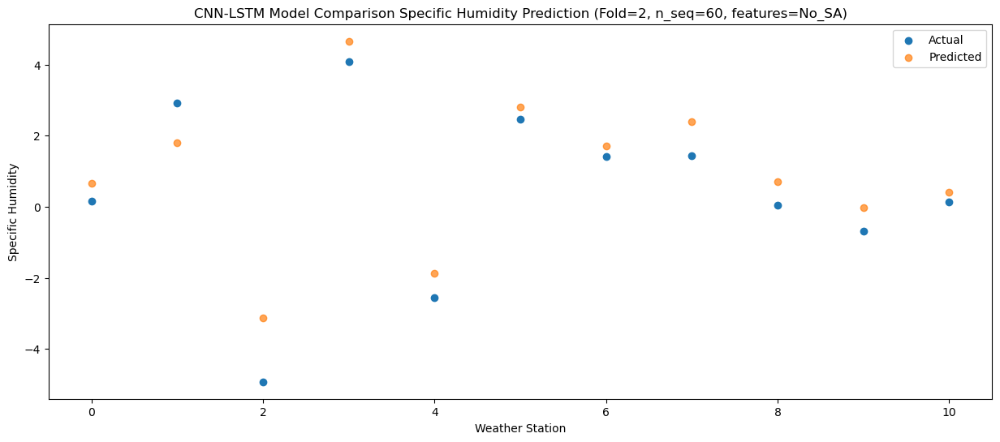

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.07   0.437550
1                 1    2.86   1.656972
2                 2   -4.43  -3.143584
3                 3    3.01   4.331186
4                 4   -2.42  -1.911387
5                 5    2.34   2.718470
6                 6    1.31   1.580045
7                 7    1.72   2.455899
8                 8    0.89   0.964754
9                 9   -0.80  -0.263485
10               10    0.15   0.116347


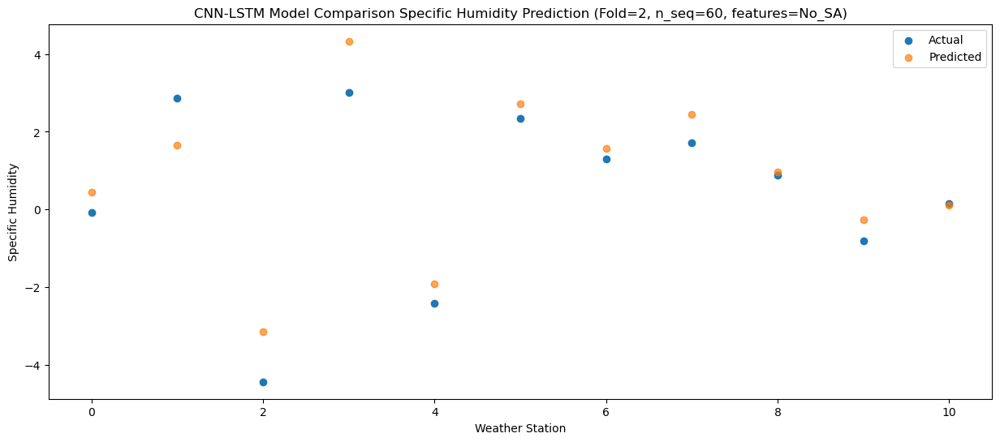

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.79  -0.052515
1                 1    2.18   1.128917
2                 2   -2.30  -2.571388
3                 3    3.18   4.003025
4                 4   -2.44  -1.769314
5                 5    2.29   2.401422
6                 6    0.98   1.086243
7                 7    1.59   2.245159
8                 8    1.42   0.876725
9                 9   -0.73  -0.286970
10               10    0.39  -0.064857


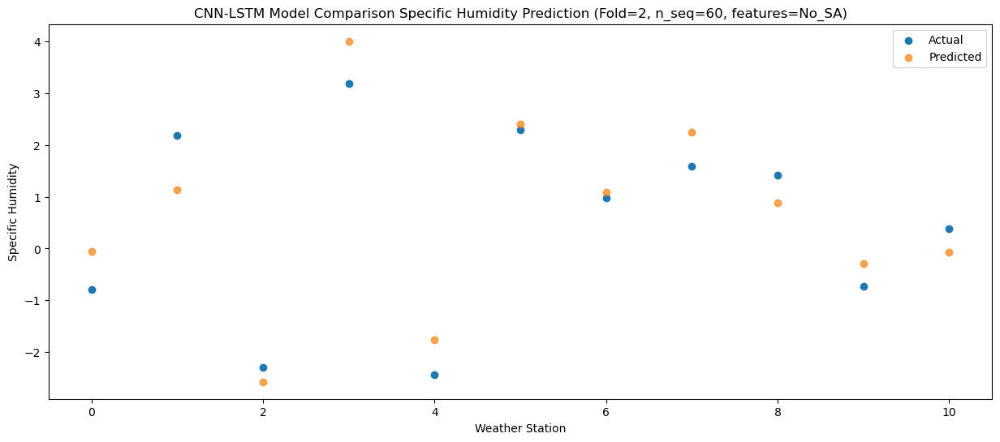

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.49   2.132051
1                 1    4.03   2.931898
2                 2   -2.08  -1.539480
3                 3    3.82   5.452775
4                 4    0.85   0.043230
5                 5    5.28   4.650107
6                 6    3.84   3.467545
7                 7    1.68   3.360773
8                 8    1.53   1.514483
9                 9    1.00   1.164484
10               10    1.42   1.443123


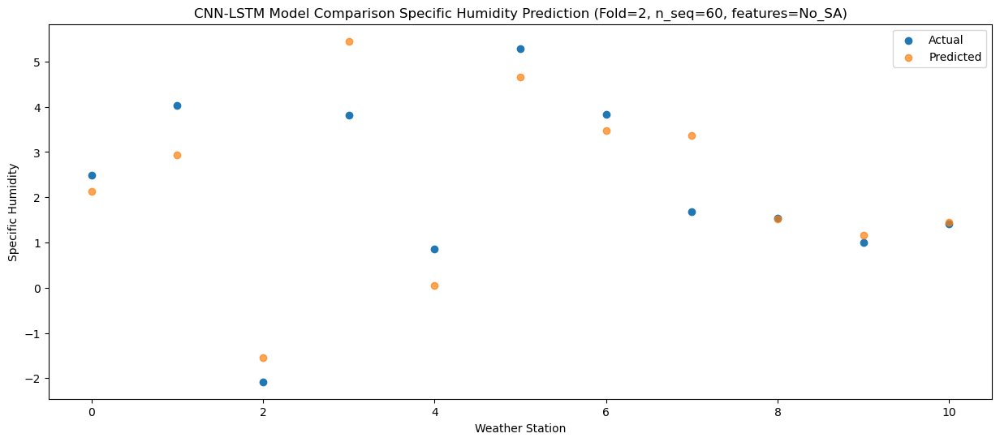

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.88   3.148642
1                 1    4.15   3.868792
2                 2   -1.11  -0.939781
3                 3    5.17   6.555716
4                 4    0.87   0.772814
5                 5    6.85   5.496535
6                 6    5.16   4.388022
7                 7    1.98   4.004049
8                 8    2.85   1.918552
9                 9    1.53   2.123938
10               10    2.03   2.469171


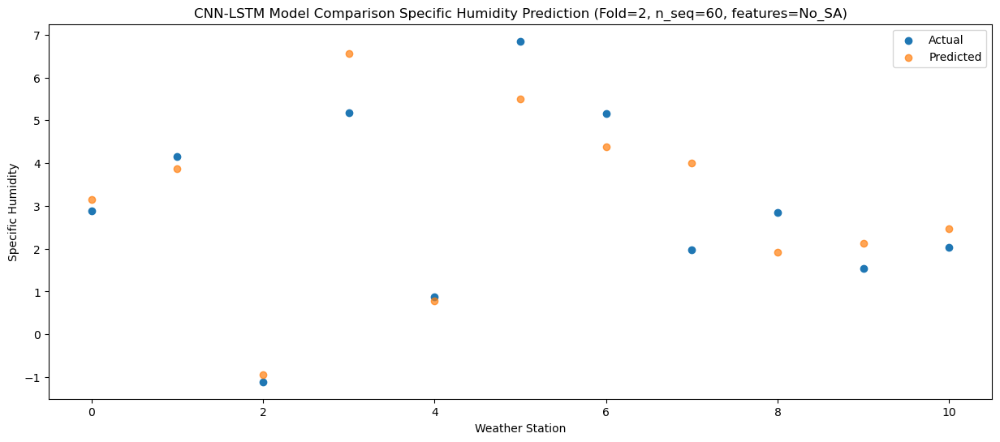

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.55   6.090170
1                 1    9.27   6.424495
2                 2    0.20   1.169498
3                 3    6.85   8.606146
4                 4    4.07   3.591242
5                 5   11.68   8.632490
6                 6    9.36   7.600962
7                 7    2.10   6.054514
8                 8    4.33   3.627846
9                 9    4.24   4.367676
10               10    4.70   4.703395


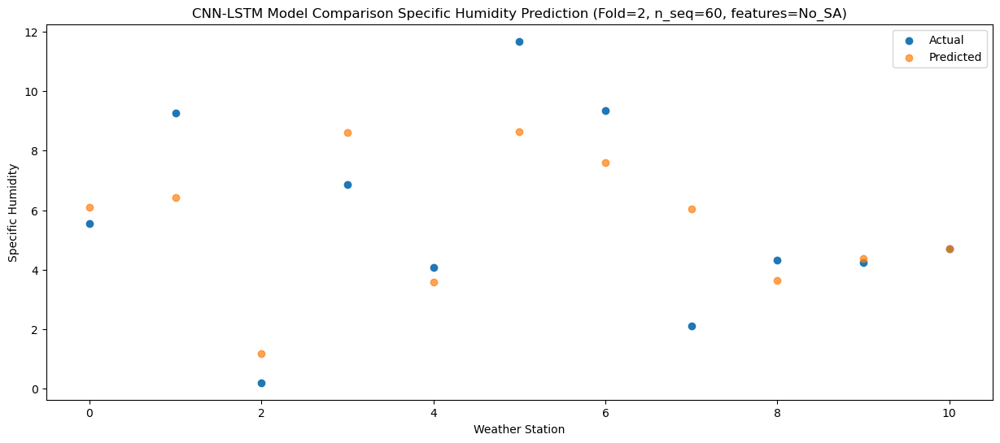

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.20  10.339848
1                 1   12.18  10.206190
2                 2    3.98   5.089645
3                 3   11.45  13.015885
4                 4    7.96   7.664249
5                 5   14.32  12.614701
6                 6   13.11  11.644136
7                 7    4.76   8.988978
8                 8    5.58   5.739089
9                 9    8.74   8.780491
10               10    8.80   9.120559


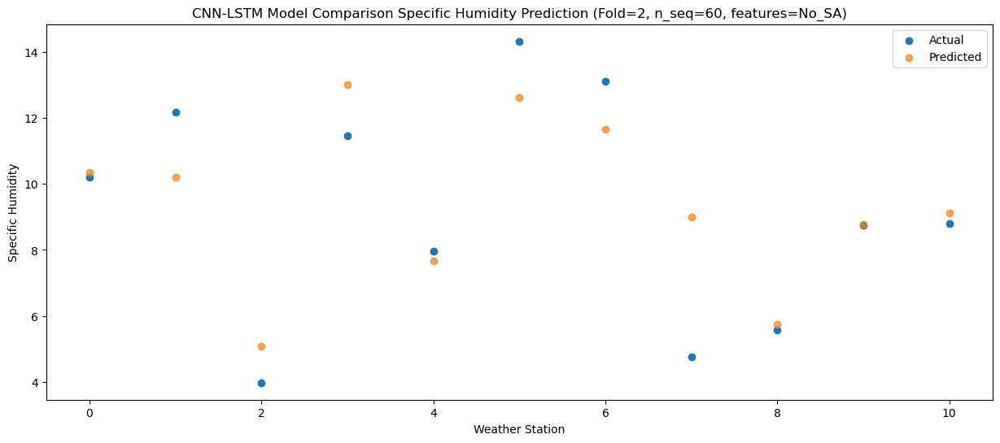

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.30  11.977652
1                 1   13.79  11.848846
2                 2    4.38   6.754990
3                 3   14.05  14.848742
4                 4    8.99   9.230386
5                 5   13.28  14.141143
6                 6   13.93  13.180991
7                 7   10.00  10.578875
8                 8    6.73   7.253632
9                 9   10.26  10.553097
10               10   10.21  10.914096


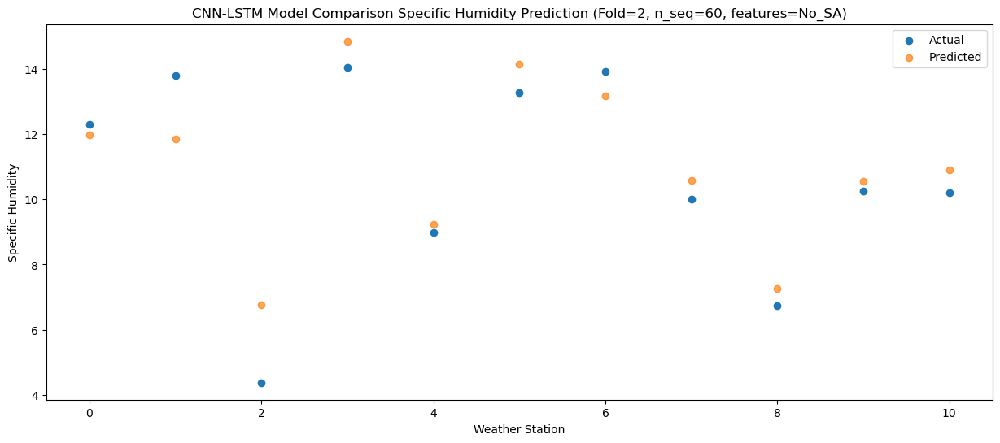

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.00  12.078886
1                 1   12.17  11.831405
2                 2    5.00   6.893568
3                 3   14.79  15.268894
4                 4    8.59   9.266341
5                 5   13.41  14.057341
6                 6   14.31  13.108200
7                 7   10.29  10.280178
8                 8    6.13   6.653317
9                 9   10.84  10.911998
10               10   10.60  11.281112


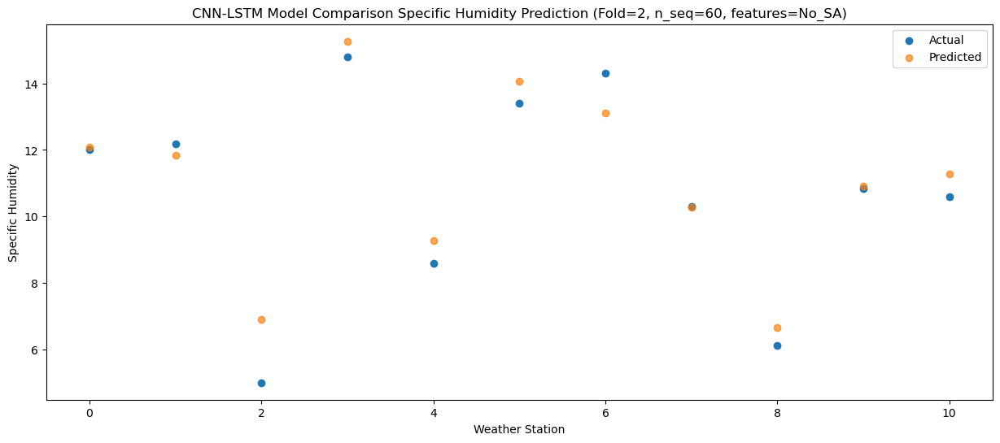

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.23   8.935337
1                 1    9.35   9.027275
2                 2    3.72   5.045717
3                 3   12.13  12.300969
4                 4    6.45   6.815557
5                 5    9.85  11.207645
6                 6    9.86  10.051921
7                 7    7.53   8.388206
8                 8    5.67   5.453174
9                 9    7.24   8.186199
10               10    7.39   8.415208


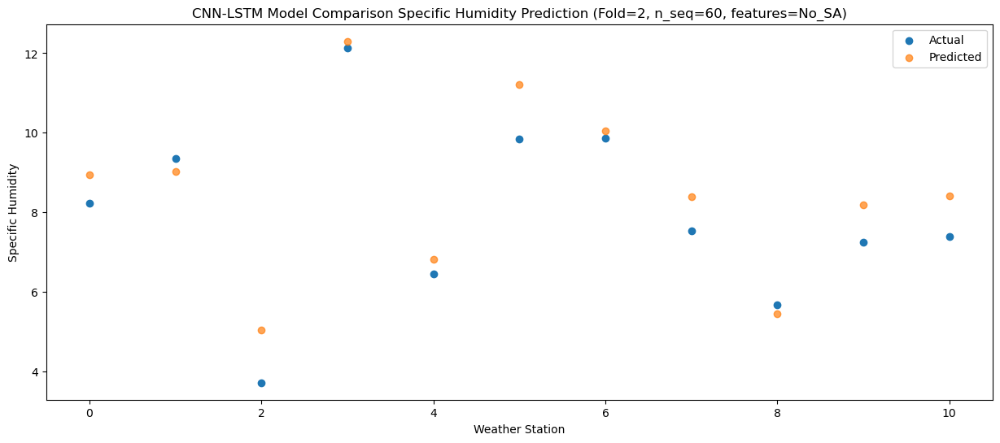

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.78   6.256030
1                 1    5.96   6.724182
2                 2    1.06   2.475614
3                 3    9.17  10.088734
4                 4    3.92   3.951525
5                 5    8.26   8.380880
6                 6    7.25   7.245320
7                 7    3.82   6.430949
8                 8    2.87   3.813390
9                 9    5.08   5.701925
10               10    5.66   6.012353


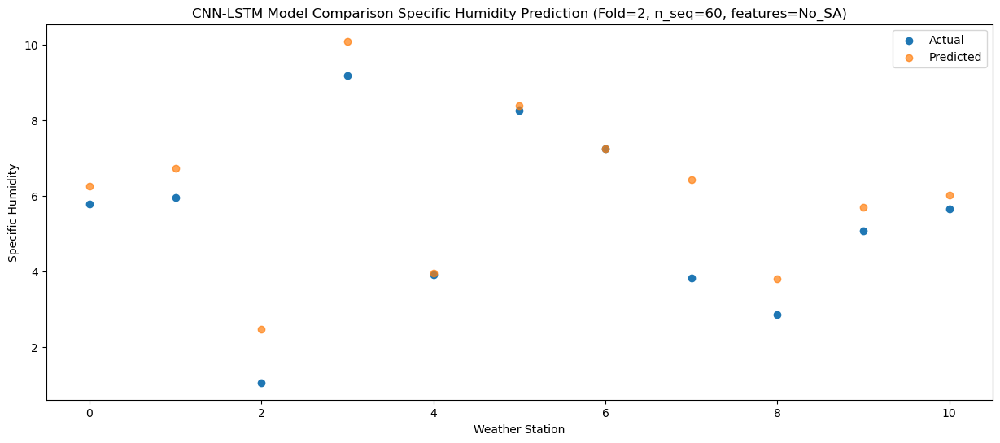

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.59   1.815097
1                 1    3.53   3.136064
2                 2   -2.89  -1.738948
3                 3    4.72   5.580003
4                 4   -1.74  -0.497669
5                 5    4.07   4.189668
6                 6    3.26   3.030940
7                 7    2.17   4.082077
8                 8    2.33   2.712020
9                 9   -0.48   1.000532
10               10    0.30   1.382573


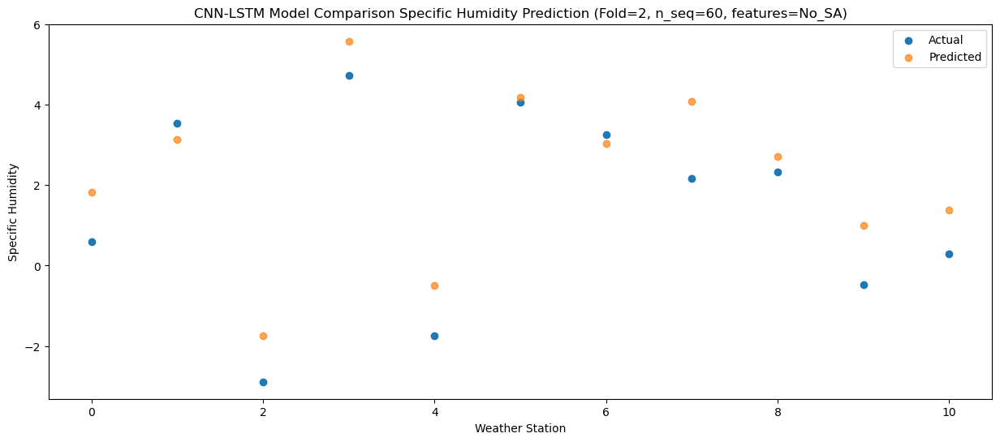

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.99   2.521149
1                 1    2.47   3.205919
2                 2   -1.49  -0.310117
3                 3    4.36   5.648619
4                 4    1.54   1.047159
5                 5    6.94   5.291978
6                 6    5.76   3.954475
7                 7    2.30   3.844655
8                 8    2.15   2.061948
9                 9    1.37   1.773753
10               10    1.86   1.888163


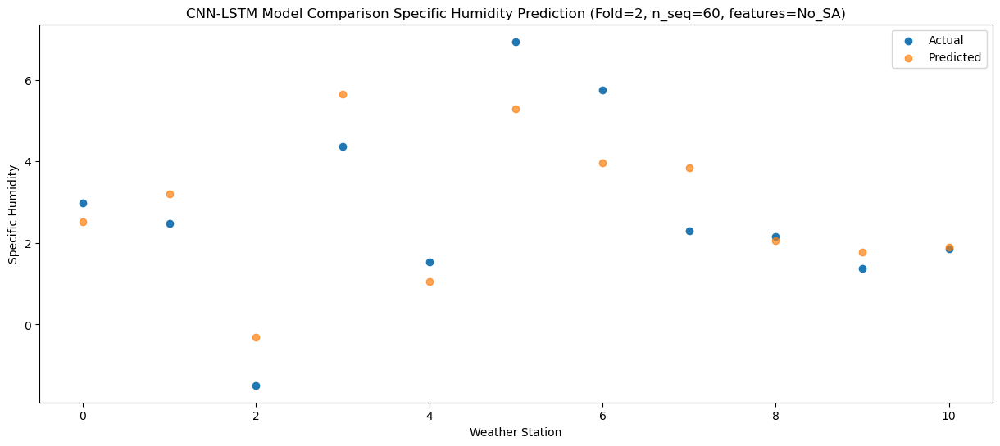

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.00   0.258928
1                 1    2.14   1.768904
2                 2   -5.14  -2.635014
3                 3    3.03   4.385287
4                 4   -3.37  -1.803546
5                 5    1.31   2.633674
6                 6    0.47   1.392329
7                 7    2.02   3.059959
8                 8    0.79   1.896113
9                 9   -1.41  -0.166006
10               10   -0.56   0.170839


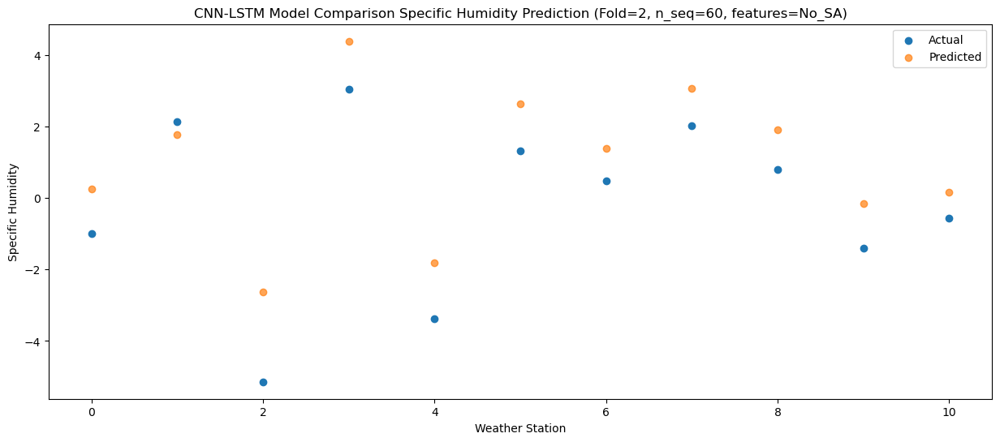

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.34   0.912314
1                 1    2.05   2.235760
2                 2   -3.95  -1.477282
3                 3    3.60   5.109760
4                 4   -1.91  -0.812962
5                 5    1.53   3.340180
6                 6    0.94   2.010515
7                 7    1.03   3.454938
8                 8    0.05   2.115905
9                 9   -0.10   0.766659
10               10    0.34   1.004392


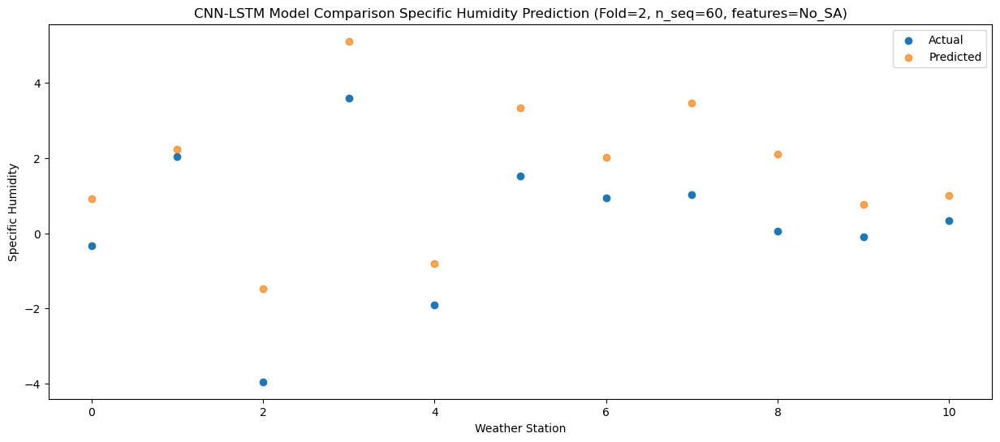

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.09   2.158687
1                 1    2.93   3.427958
2                 2   -2.14  -0.409774
3                 3    4.36   6.225737
4                 4   -1.06   0.386815
5                 5    3.15   4.617182
6                 6    2.57   3.304239
7                 7    1.43   4.573841
8                 8    1.79   3.205202
9                 9    0.86   1.881222
10               10    0.96   2.124414


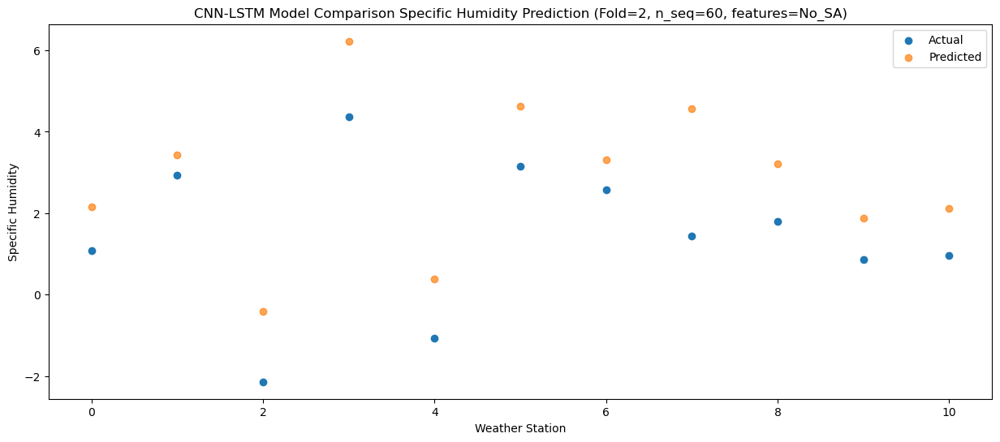

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.99   3.659475
1                 1    4.08   4.436295
2                 2   -0.78   0.241572
3                 3    5.06   6.805057
4                 4    1.37   1.778763
5                 5    7.11   6.304768
6                 6    6.47   5.067894
7                 7    1.44   4.922303
8                 8    2.63   3.057071
9                 9    1.90   2.687769
10               10    2.23   2.911363


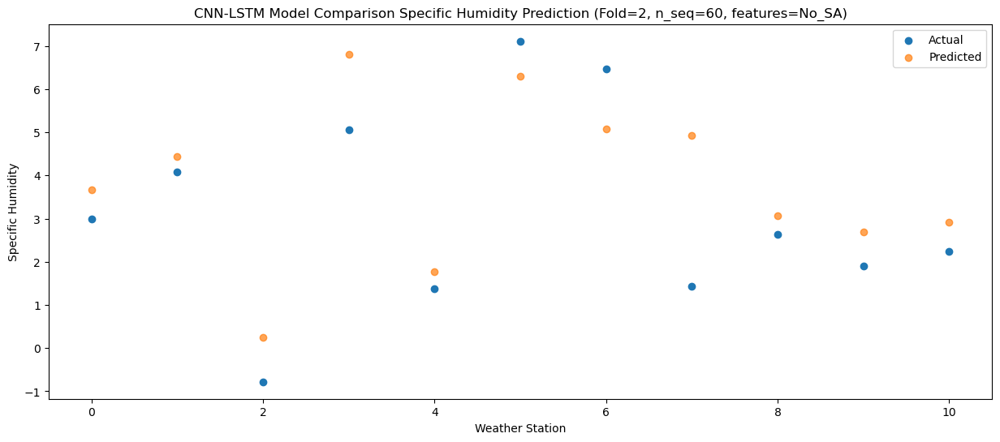

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.25   7.856488
1                 1    6.47   8.024413
2                 2    2.32   3.546894
3                 3    8.36  10.570898
4                 4    5.40   5.698941
5                 5   10.76  10.403916
6                 6   10.56   9.276639
7                 7    1.37   7.520817
8                 8    3.89   4.822619
9                 9    6.22   6.532365
10               10    6.39   6.767127


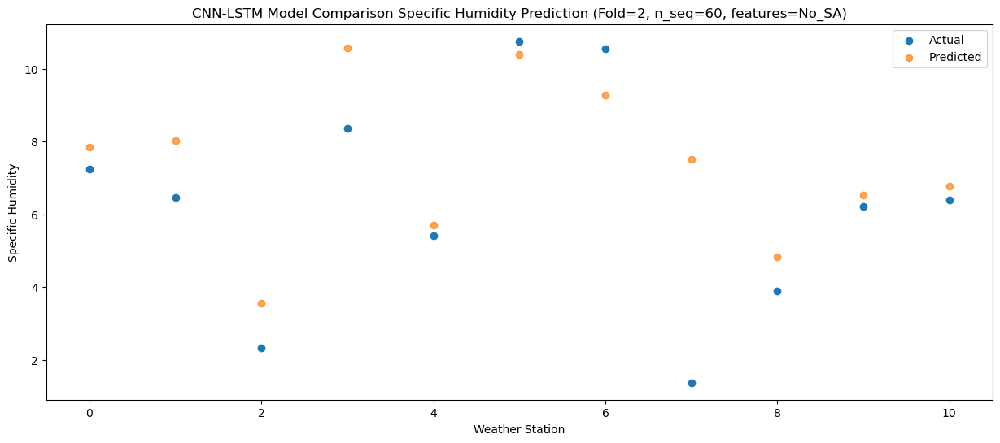

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.30  10.443131
1                 1   10.83  10.577533
2                 2    4.25   5.737717
3                 3   10.62  12.902622
4                 4    7.70   8.119653
5                 5   11.79  13.000406
6                 6   11.36  11.930134
7                 7    6.87   9.893604
8                 8    5.66   7.077103
9                 9    8.02   8.847239
10               10    8.35   9.120149


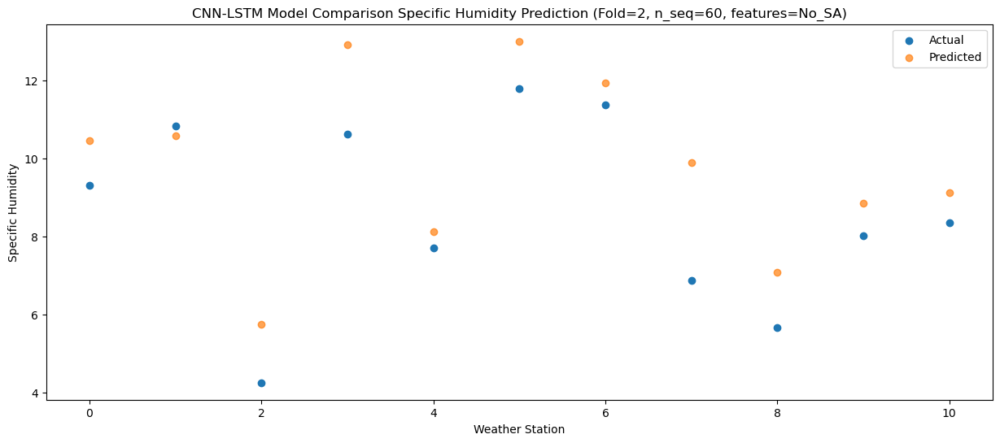

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.52  12.404634
1                 1   12.17  12.511171
2                 2    5.08   8.062546
3                 3   13.98  15.610879
4                 4    8.99  10.040167
5                 5   12.89  14.640190
6                 6   10.68  13.559469
7                 7    9.43  11.621502
8                 8    6.55   8.491801
9                 9   11.60  11.419440
10               10   11.56  11.704465


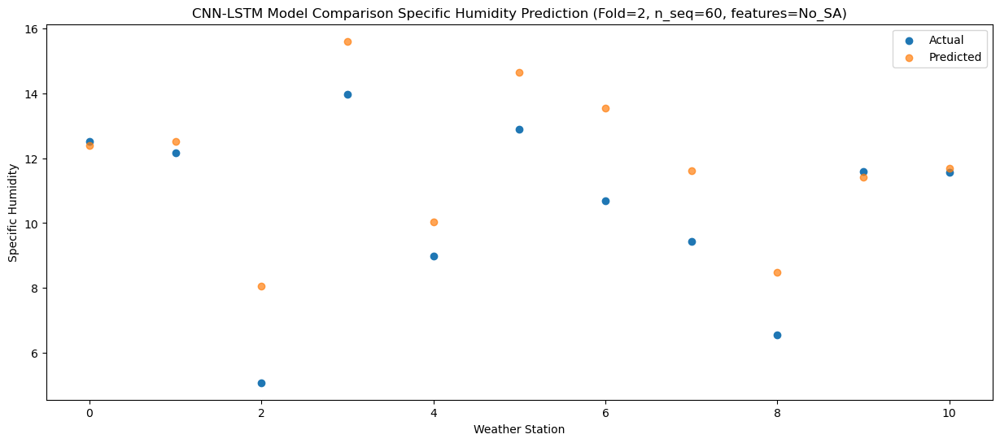

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.04  12.294894
1                 1   11.67  12.491565
2                 2    4.97   7.669303
3                 3   14.66  15.397510
4                 4    9.39   9.777664
5                 5   13.35  14.554029
6                 6   11.74  13.509755
7                 7   11.40  11.676942
8                 8    6.65   8.667899
9                 9   10.03  11.106733
10               10   10.57  11.437362


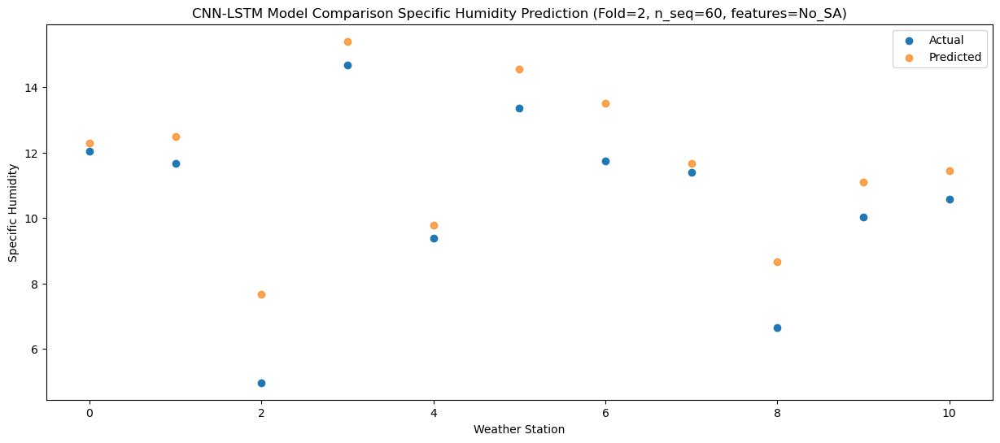

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.29   8.673962
1                 1    9.10   9.377601
2                 2    4.82   5.127272
3                 3   10.86  12.419371
4                 4    5.88   6.491495
5                 5    9.99  10.933884
6                 6    9.07   9.762113
7                 7    8.36   9.391565
8                 8    7.50   7.010090
9                 9    6.60   8.080710
10               10    7.09   8.376185


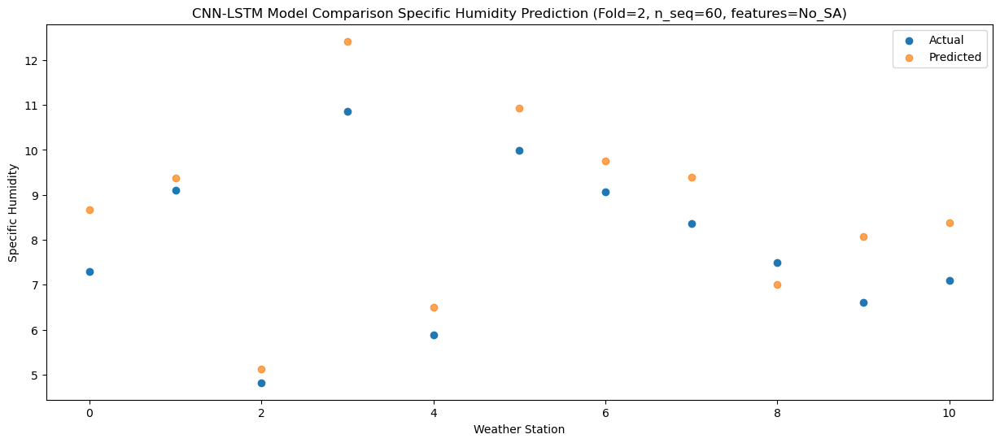

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.57   4.515267
1                 1    5.42   5.935643
2                 2    0.43   1.723233
3                 3    7.99   8.648332
4                 4    0.70   2.526597
5                 5    5.17   6.896690
6                 6    4.29   5.633220
7                 7    6.28   7.067187
8                 8    5.73   5.682326
9                 9    2.24   4.162343
10               10    2.43   4.473909


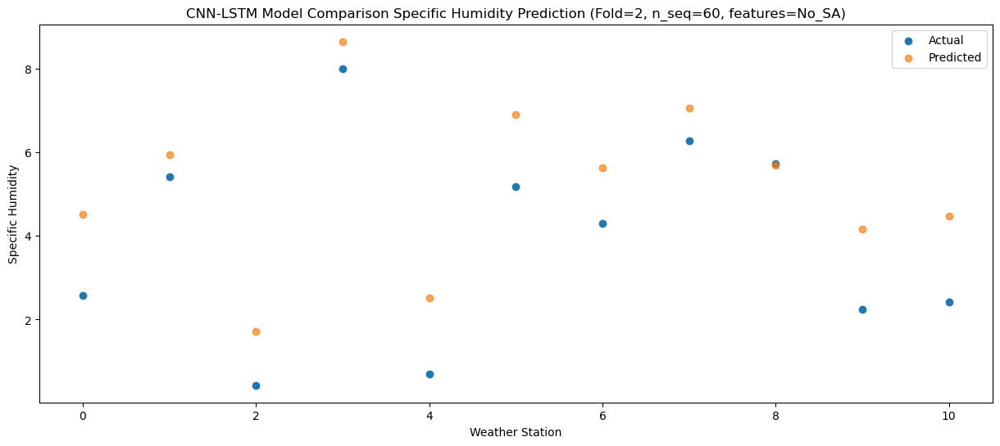

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.63   3.295239
1                 1    3.92   4.328589
2                 2    0.32   0.595187
3                 3    6.17   7.169578
4                 4    0.26   1.543740
5                 5    5.03   5.756696
6                 6    3.84   4.454222
7                 7    2.31   5.101397
8                 8    1.09   3.354706
9                 9    1.77   2.956054
10               10    1.81   3.171716


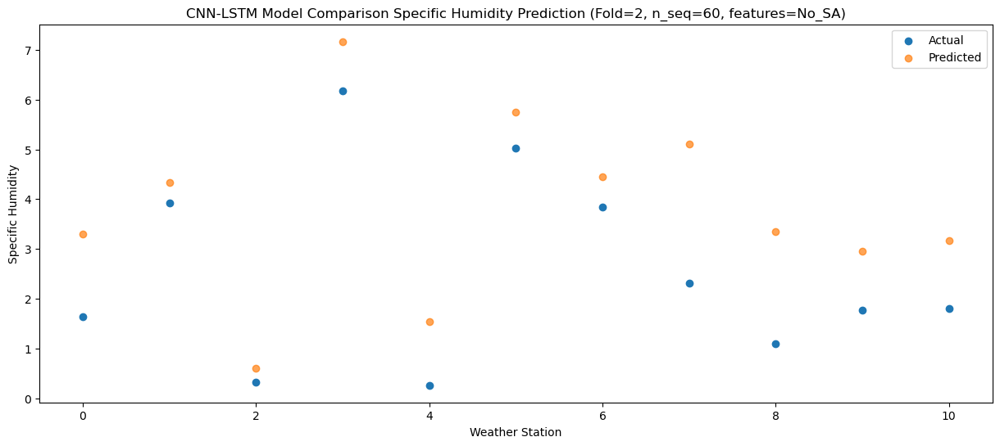

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.00   1.866225
1                 1    2.73   3.190250
2                 2   -3.34  -1.271234
3                 3    4.08   5.504033
4                 4   -0.29  -0.139621
5                 5    4.12   4.409336
6                 6    2.67   3.166499
7                 7    3.13   4.282920
8                 8    1.94   2.939903
9                 9   -0.47   1.115126
10               10    0.72   1.420647


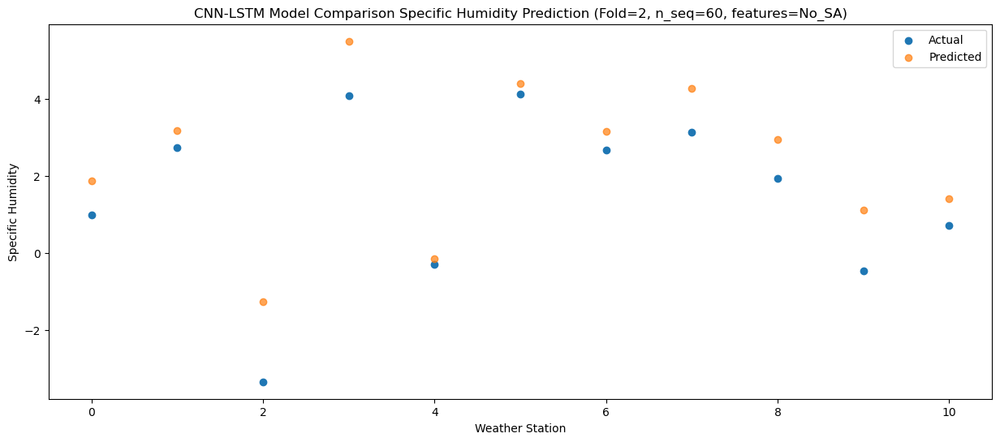

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.41   2.285435
1                 1    2.72   3.702276
2                 2   -3.72  -0.805670
3                 3    4.59   6.225889
4                 4   -0.38   0.181182
5                 5    3.74   4.700331
6                 6    1.89   3.470518
7                 7    2.24   4.827370
8                 8    2.03   3.495126
9                 9    0.39   1.704822
10               10    0.99   2.043515


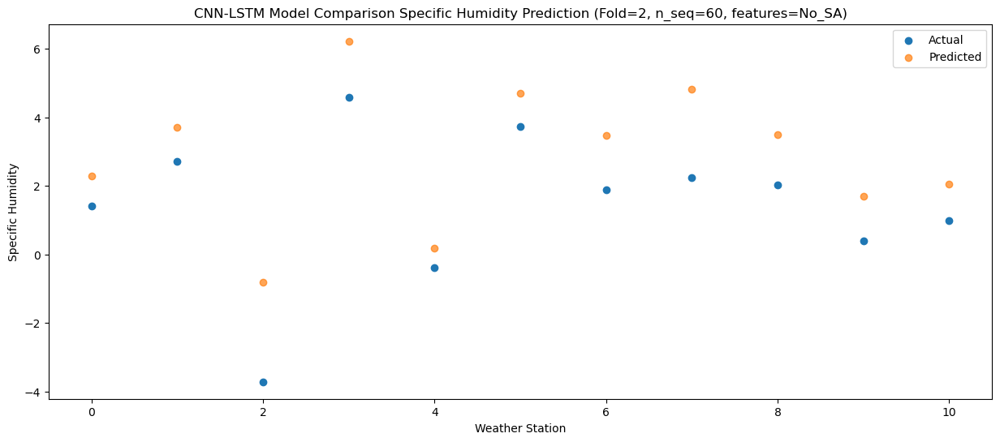

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.63   2.488924
1                 1    2.64   3.595575
2                 2   -1.87  -0.047776
3                 3    3.83   6.098210
4                 4    0.92   0.930588
5                 5    4.19   5.154863
6                 6    2.29   3.801441
7                 7    2.12   4.674908
8                 8    0.62   3.208533
9                 9    1.15   1.997124
10               10    1.39   2.171928


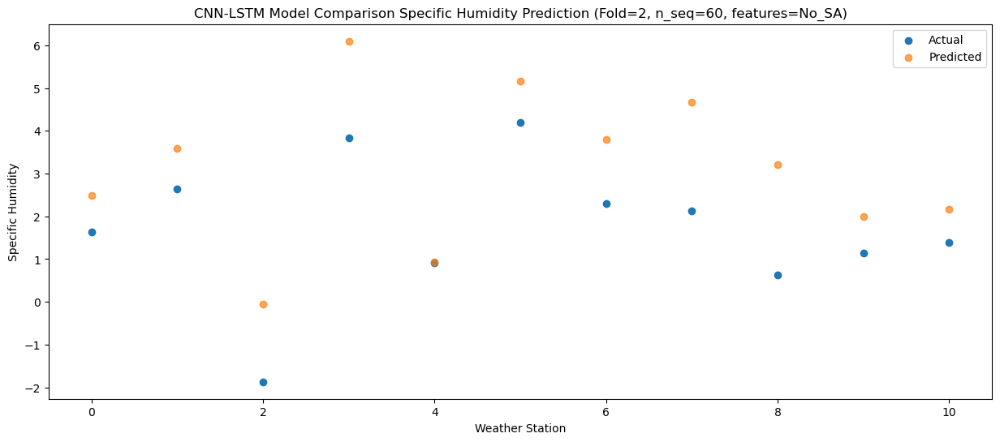

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.98   3.002628
1                 1    3.33   4.072069
2                 2   -1.48  -0.022668
3                 3    4.08   6.187731
4                 4    1.80   1.309455
5                 5    5.97   5.790992
6                 6    4.20   4.484846
7                 7    2.46   5.057278
8                 8    2.54   3.594702
9                 9    0.84   2.080271
10               10    0.99   2.284160


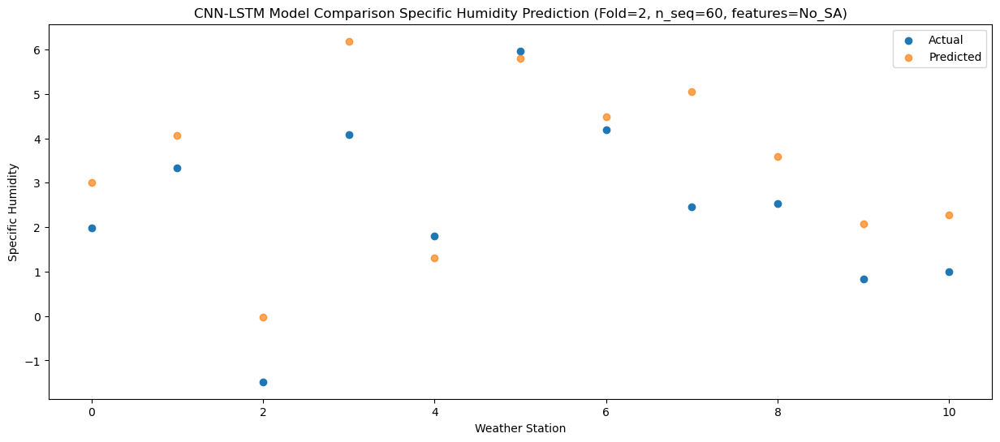

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.92   4.629974
1                 1    3.95   5.605176
2                 2    0.03   1.912250
3                 3    6.16   8.238843
4                 4    2.35   3.001482
5                 5    6.52   7.249100
6                 6    4.87   5.916652
7                 7    1.62   6.437054
8                 8    3.24   4.756088
9                 9    2.97   4.116564
10               10    2.63   4.295093


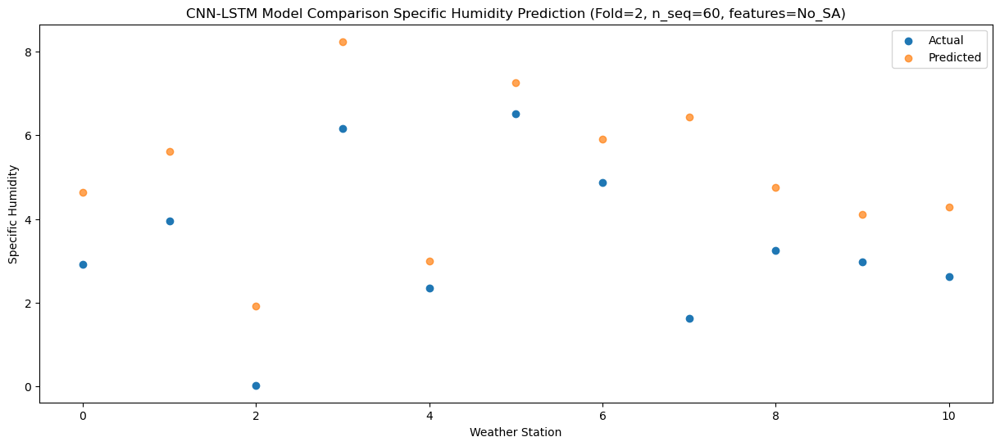

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.53   7.711401
1                 1    9.73   8.528720
2                 2    0.84   3.527073
3                 3    6.97   9.929386
4                 4    5.41   5.689793
5                 5   10.22  10.678987
6                 6    8.76   9.501805
7                 7    3.62   9.080891
8                 8    4.64   7.408487
9                 9    4.50   5.887969
10               10    5.22   6.143051


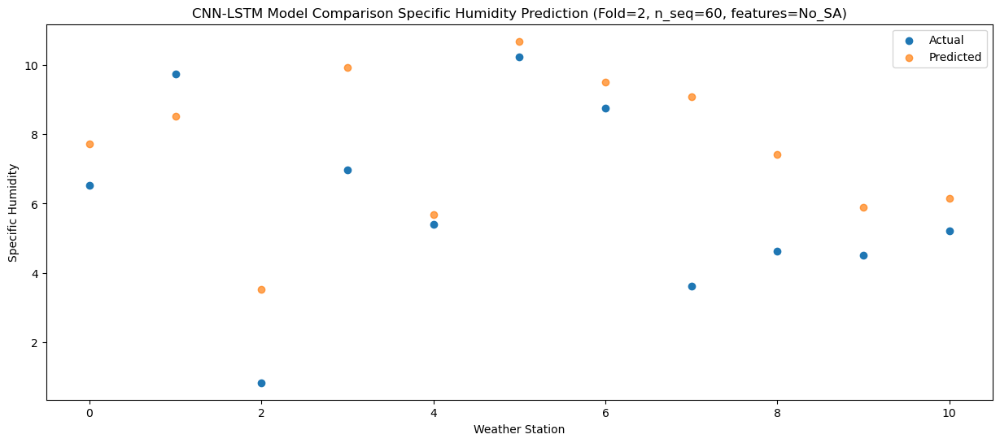

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.50  10.744148
1                 1   12.38  11.131990
2                 2    4.00   6.003339
3                 3   10.87  12.842164
4                 4    8.72   8.506063
5                 5   13.68  13.554057
6                 6   12.66  12.458653
7                 7    3.42  10.922356
8                 8    5.02   8.569455
9                 9    7.36   8.816407
10               10    7.06   9.085580


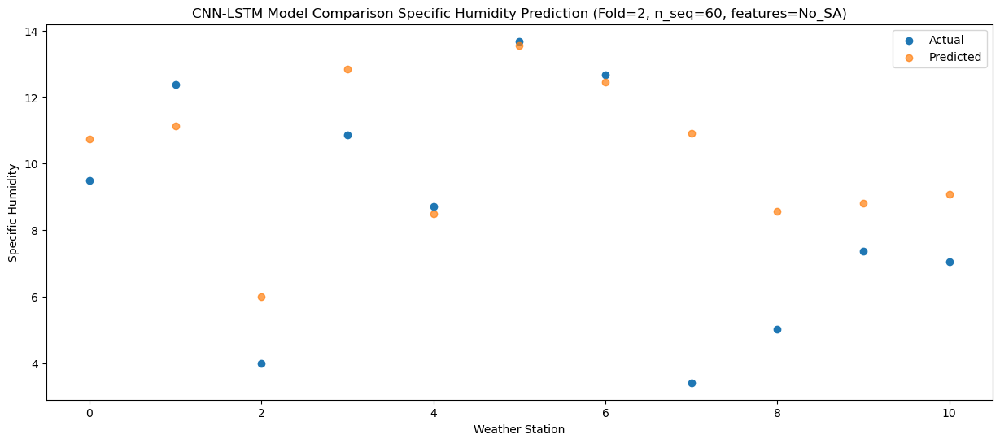

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.68  13.239149
1                 1   14.44  13.331020
2                 2    4.97   8.725049
3                 3   15.13  16.303170
4                 4   10.06  10.848695
5                 5   13.39  15.525904
6                 6   11.95  14.451415
7                 7    6.77  12.437585
8                 8    6.36   9.305794
9                 9   11.20  12.106735
10               10   10.37  12.394114


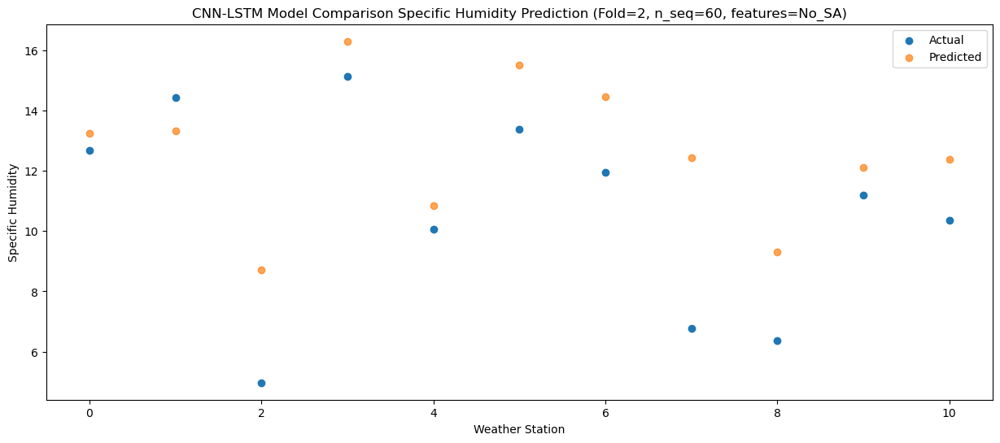

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.03  12.828558
1                 1   12.55  13.129295
2                 2    5.69   8.607382
3                 3   12.79  15.719127
4                 4   10.09  10.634012
5                 5   11.96  15.311469
6                 6    9.90  14.181397
7                 7    8.96  12.648584
8                 8    6.97   9.883483
9                 9   10.71  11.612311
10               10   10.48  11.870306


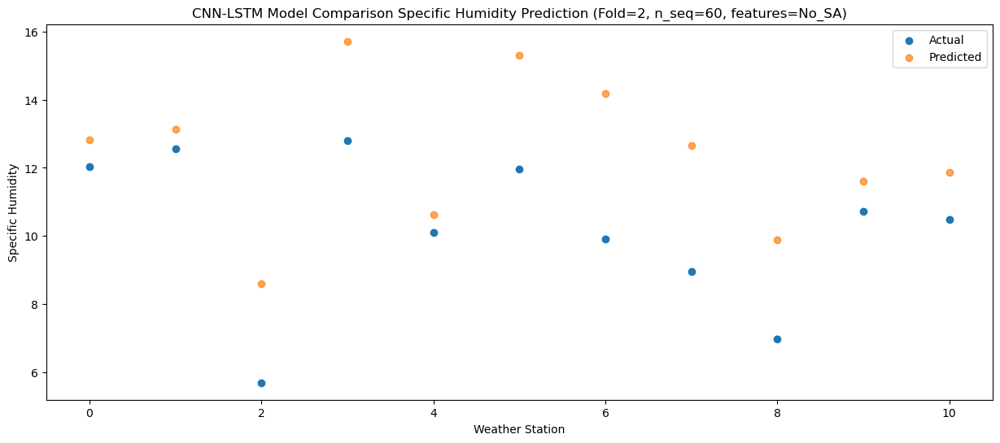

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.00   9.912686
1                 1    9.96  10.603671
2                 2    3.30   5.911328
3                 3   11.78  13.232780
4                 4    7.74   7.620835
5                 5   11.41  12.304885
6                 6    9.27  11.169719
7                 7    7.15  10.565412
8                 8    6.72   8.187344
9                 9    7.57   8.893852
10               10    8.06   9.213210


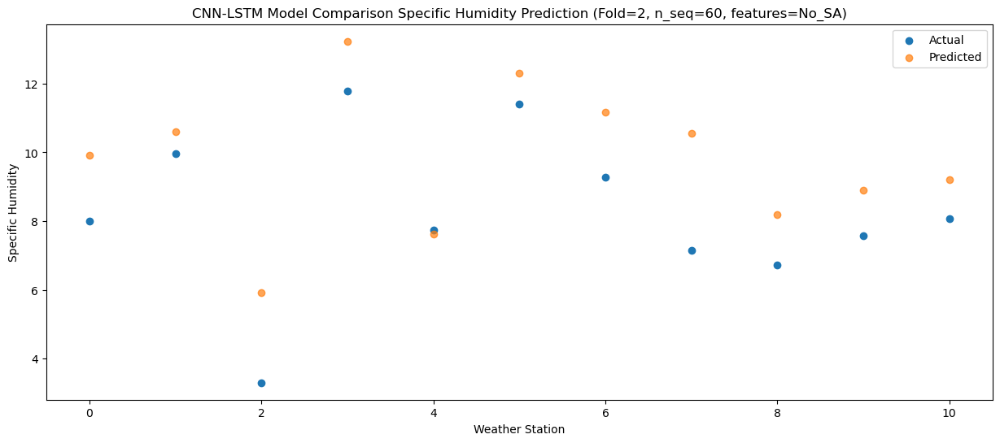

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.90   6.437062
1                 1    6.50   7.612206
2                 2    0.38   2.798340
3                 3    8.42  10.136657
4                 4    2.51   4.143632
5                 5    7.88   8.825885
6                 6    6.12   7.658930
7                 7    4.70   8.245587
8                 8    4.42   6.473505
9                 9    3.38   5.596355
10               10    3.95   5.959831


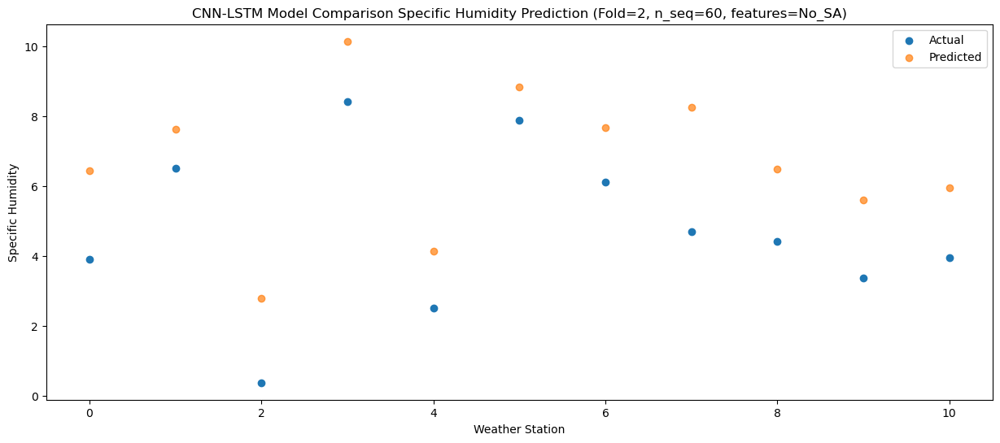

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.26   3.503155
1                 1    3.94   4.879218
2                 2   -2.12   0.275310
3                 3    4.59   6.994620
4                 4   -0.01   1.504725
5                 5    4.71   6.138607
6                 6    3.50   4.891400
7                 7    3.78   6.029403
8                 8    1.39   4.717143
9                 9    0.27   2.601668
10               10    1.00   2.908202


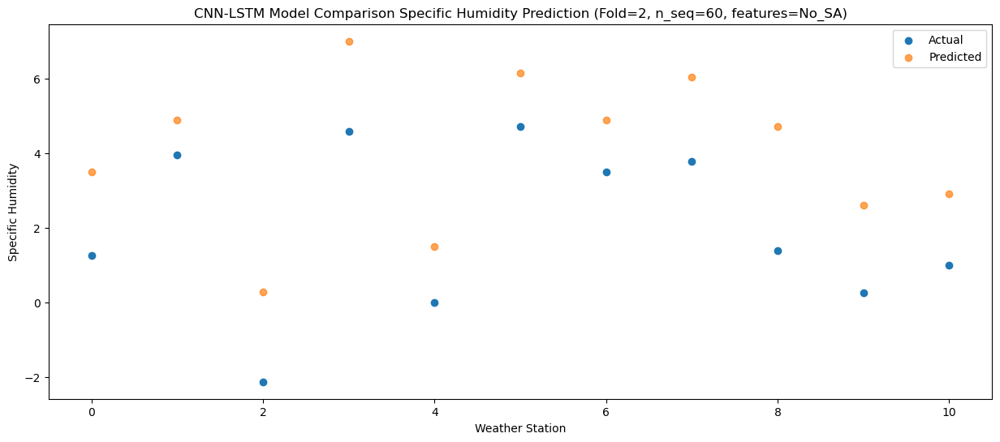

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.34   3.107744
1                 1    3.55   4.743895
2                 2   -2.69  -0.252800
3                 3    4.88   7.267003
4                 4   -1.60   0.726617
5                 5    2.78   5.418907
6                 6    1.68   4.240103
7                 7    2.26   5.913299
8                 8    2.18   4.598815
9                 9    0.18   2.480708
10               10    0.79   2.908144


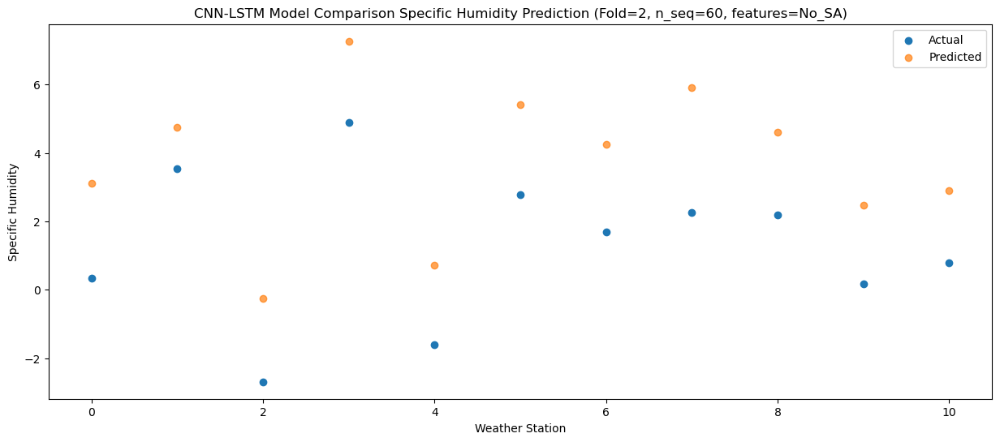

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.55   1.792718
1                 1    2.96   3.596609
2                 2   -3.76  -1.061675
3                 3    3.55   6.123515
4                 4   -2.47  -0.350322
5                 5    1.77   4.184202
6                 6    0.56   2.928958
7                 7    2.68   5.142686
8                 8    2.15   4.112028
9                 9   -0.51   1.377925
10               10    0.17   1.759781


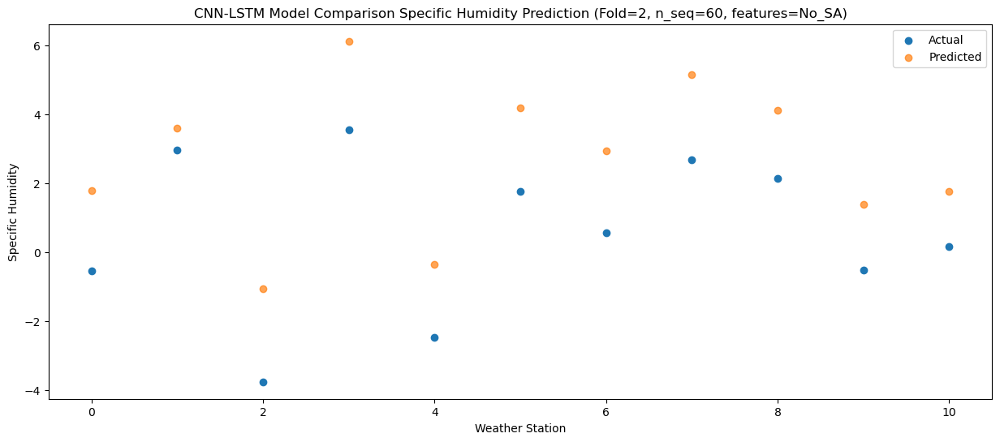

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.32   2.612672
1                 1    3.78   4.214281
2                 2   -4.18  -1.197119
3                 3    3.50   6.133732
4                 4   -1.41   0.206106
5                 5    4.17   5.169356
6                 6    3.03   4.018787
7                 7    2.70   5.435283
8                 8    3.12   4.271178
9                 9   -0.37   1.438461
10               10    0.57   1.861885


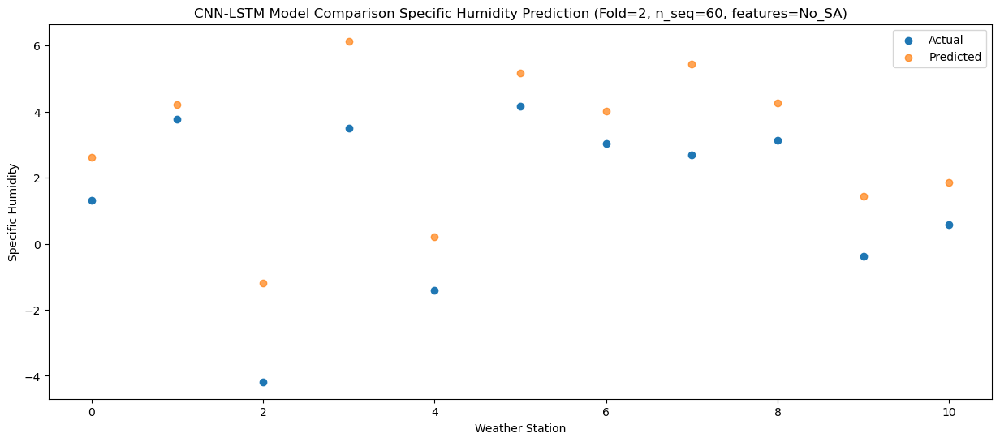

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.14   3.687605
1                 1    4.03   4.939678
2                 2   -1.02   0.353463
3                 3    4.55   6.916294
4                 4    0.19   1.761157
5                 5    5.81   6.442381
6                 6    4.65   5.185033
7                 7    2.92   5.982134
8                 8    1.56   4.549848
9                 9    1.04   2.612072
10               10    1.67   2.886233


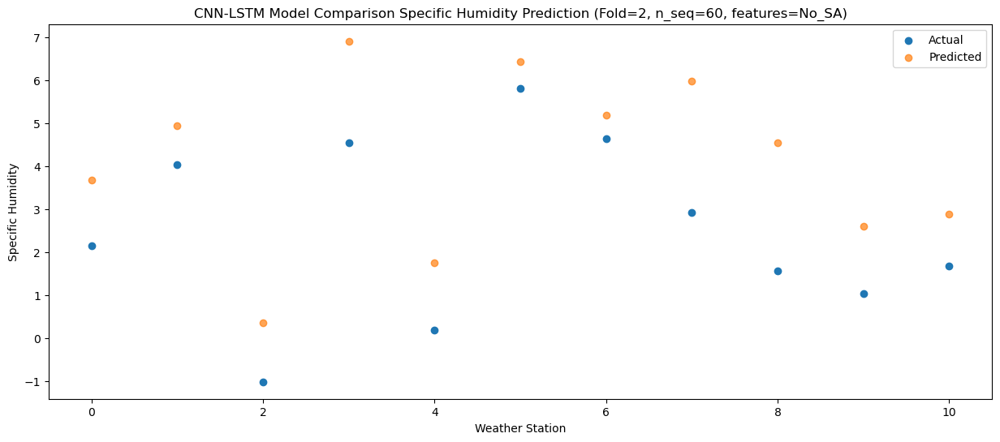

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.35   5.478911
1                 1    4.99   6.400147
2                 2   -2.23   1.351048
3                 3    5.44   8.411909
4                 4    2.26   3.236229
5                 5    8.09   8.153542
6                 6    6.85   6.996511
7                 7    2.25   6.866398
8                 8    0.66   4.997222
9                 9    3.26   4.056296
10               10    3.78   4.377200


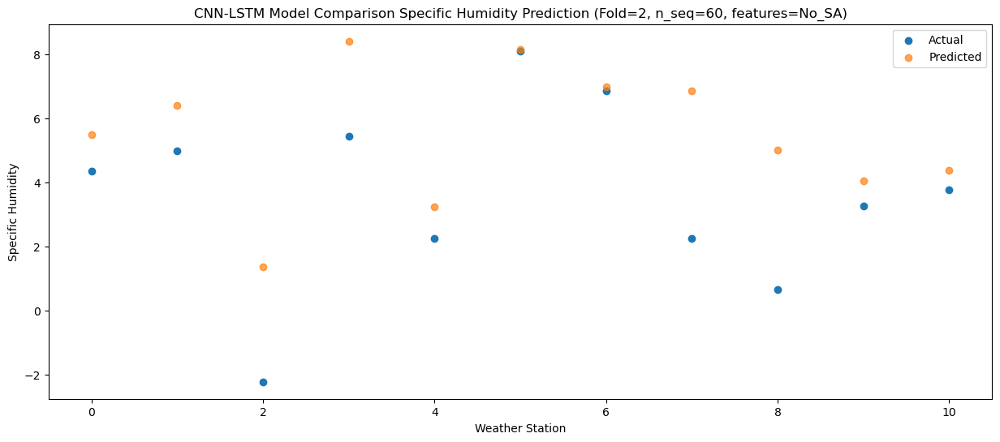

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.61   9.242419
1                 1    8.02   9.586776
2                 2    2.63   4.767850
3                 3    8.62  11.761435
4                 4    6.69   7.055907
5                 5   12.19  11.944800
6                 6   10.63  10.805024
7                 7    1.94   9.299397
8                 8    4.76   6.726855
9                 9    7.14   7.646787
10               10    7.64   7.902549


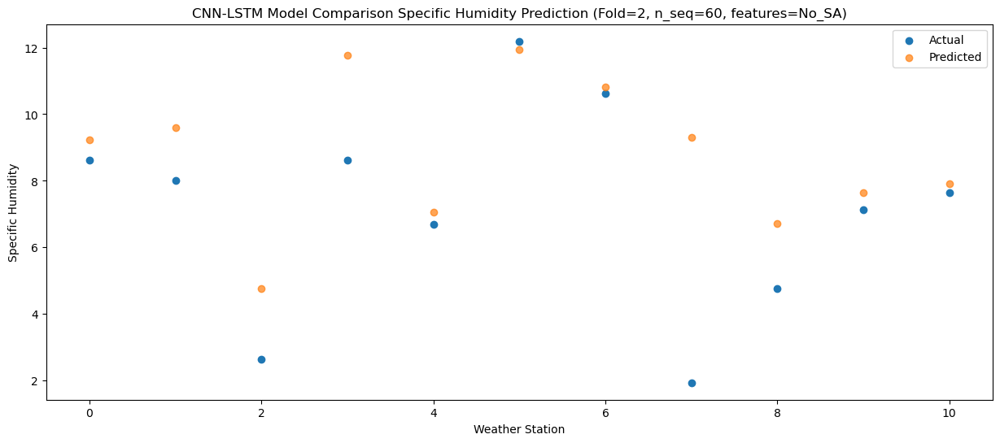

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.58  11.869989
1                 1   14.03  12.224604
2                 2    4.69   6.343840
3                 3   11.54  14.265794
4                 4    8.66   9.034765
5                 5   13.85  14.358564
6                 6   12.22  13.402380
7                 7    5.99  11.508266
8                 8    6.36   8.675039
9                 9    9.01   9.853565
10               10    9.19  10.269292


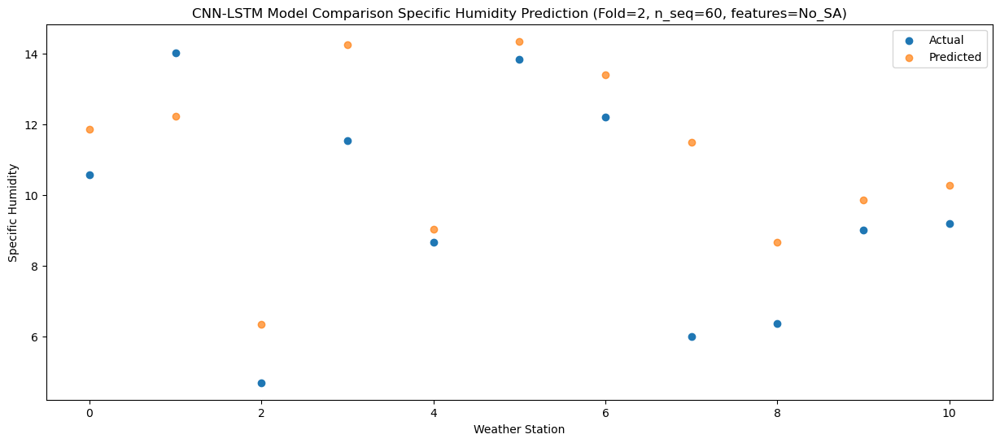

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.05  13.429271
1                 1   12.58  13.692543
2                 2    5.74   8.926945
3                 3   14.71  16.475281
4                 4   10.30  11.025430
5                 5   14.15  15.802346
6                 6   12.45  14.713467
7                 7    9.59  12.996245
8                 8    7.59   9.975309
9                 9   11.62  12.196411
10               10   11.23  12.502319


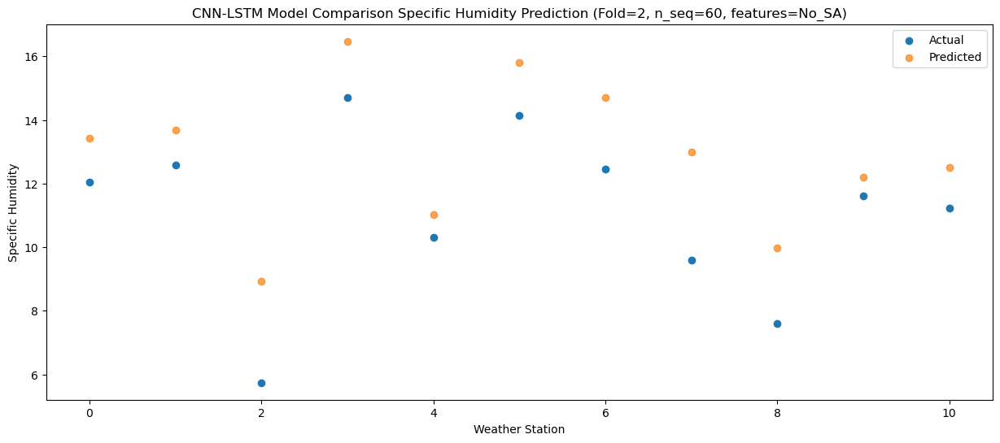

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.05  12.583044
1                 1   13.56  13.154479
2                 2    6.34   7.934322
3                 3   13.21  15.746987
4                 4    9.13   9.964143
5                 5   14.19  14.897541
6                 6   12.27  13.854403
7                 7    9.27  12.708997
8                 8    6.77   9.955242
9                 9   10.36  11.277314
10               10   10.22  11.664345


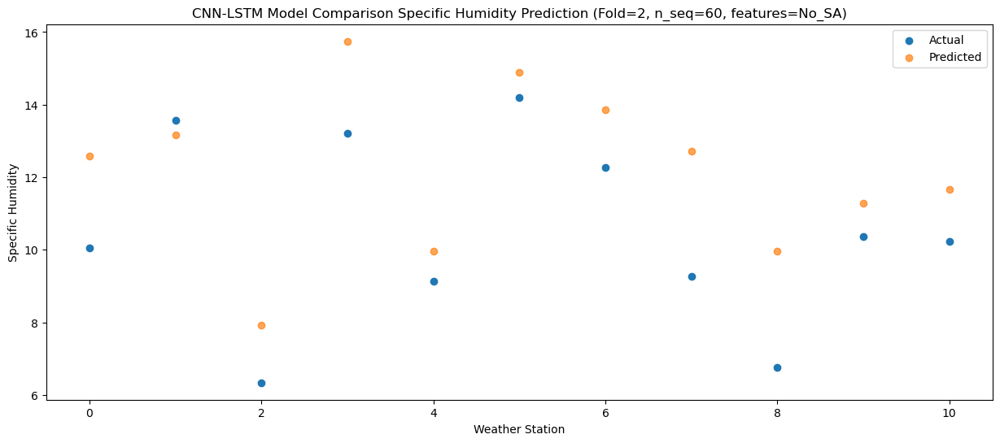

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.43   9.732807
1                 1    9.61  10.486149
2                 2    6.77   6.604730
3                 3   10.32  13.121714
4                 4    7.53   7.961672
5                 5   11.70  12.332889
6                 6    9.37  11.045302
7                 7    6.53  10.799964
8                 8    6.38   8.538609
9                 9    8.51   9.011191
10               10    8.12   9.207460


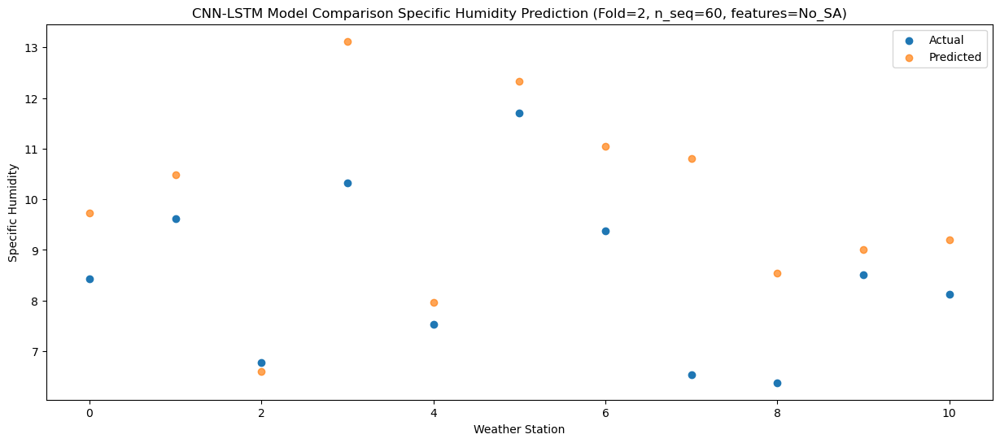

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    4.05   5.858291
1                 1    6.75   7.213804
2                 2    1.79   2.964940
3                 3    7.08   9.516133
4                 4    2.67   4.009703
5                 5    7.38   8.490619
6                 6    5.95   7.193792
7                 7    3.64   8.290274
8                 8    4.48   6.749955
9                 9    3.89   5.169328
10               10    4.05   5.438276


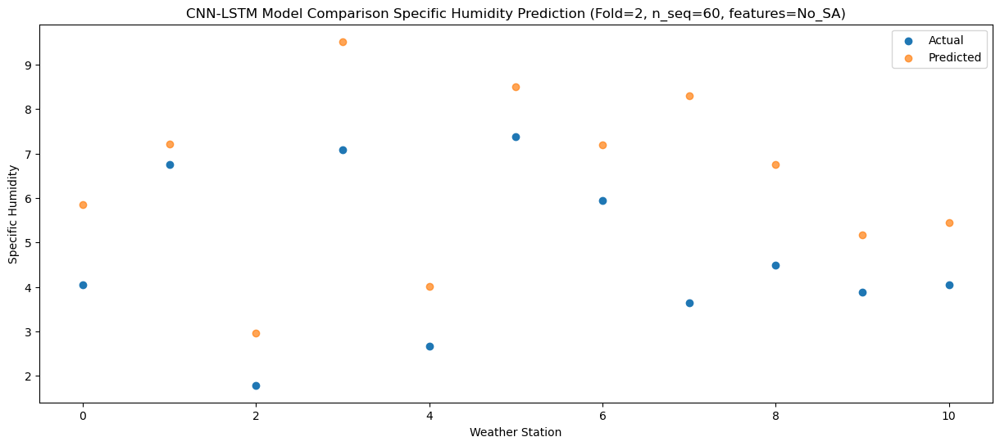

f, t:
[[ 8.500e-01  3.340e+00 -2.460e+00  4.490e+00 -2.070e+00  3.770e+00
   2.890e+00  3.550e+00  2.230e+00 -1.700e-01  5.200e-01]
 [ 1.350e+00  2.830e+00 -2.150e+00  3.930e+00 -1.270e+00  2.580e+00
   1.790e+00  3.100e+00  2.050e+00 -6.000e-02  9.700e-01]
 [ 1.060e+00  2.810e+00 -3.710e+00  3.750e+00 -1.240e+00  3.410e+00
   2.470e+00  2.150e+00  1.840e+00 -8.000e-02  7.700e-01]
 [ 7.400e-01  2.870e+00 -2.830e+00  3.770e+00 -9.200e-01  2.740e+00
   1.910e+00  2.680e+00  1.120e+00  3.100e-01  8.800e-01]
 [ 3.670e+00  4.660e+00 -1.660e+00  4.290e+00  2.570e+00  7.350e+00
   6.130e+00  4.140e+00  2.760e+00  1.940e+00  2.730e+00]
 [ 3.510e+00  4.950e+00 -1.800e-01  4.670e+00  1.610e+00  6.830e+00
   5.710e+00  2.740e+00  4.170e+00  1.850e+00  2.160e+00]
 [ 6.500e+00  7.850e+00  9.300e-01  6.920e+00  3.730e+00  8.910e+00
   8.650e+00  2.980e+00  4.930e+00  5.180e+00  4.950e+00]
 [ 9.650e+00  9.270e+00  4.270e+00  1.093e+01  7.070e+00  1.103e+01
   1.093e+01  4.660e+00  4.910e+00  8.690e+0

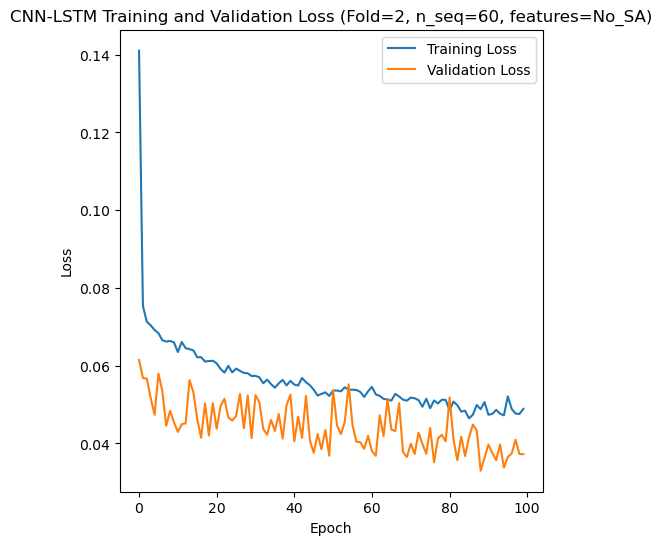

[[ 5.11  3.7   4.74 ... 13.5   8.68  7.66]
 [ 3.73  2.91  5.05 ... 11.19  6.96  6.57]
 [ 5.56  5.41  5.55 ...  8.56  7.45  5.59]
 ...
 [ 2.73  2.21  3.23 ...  5.    3.95  3.09]
 [ 5.93  5.59  5.49 ...  8.63  7.04  6.11]
 [ 3.71  2.55  2.84 ...  9.78  6.68  4.77]]
Epoch 1/100
84/84 [==============================] - 19s 87ms/step - loss: 0.1346 - accuracy: 0.1667 - mae: 0.1145 - rmse: 0.1346 - mape: 24.4206 - pearson: 0.6077 - val_loss: 0.0770 - val_accuracy: 0.5000 - val_mae: 0.0618 - val_rmse: 0.0770 - val_mape: 13.1348 - val_pearson: 0.6430
Epoch 2/100
84/84 [==============================] - 3s 33ms/step - loss: 0.0740 - accuracy: 0.3333 - mae: 0.0581 - rmse: 0.0740 - mape: 13.1178 - pearson: 0.7614 - val_loss: 0.0664 - val_accuracy: 0.0000e+00 - val_mae: 0.0524 - val_rmse: 0.0664 - val_mape: 11.8779 - val_pearson: 0.7018
Epoch 3/100
84/84 [==============================] - 3s 33ms/step - loss: 0.0693 - accuracy: 0.3810 - mae: 0.0547 - rmse: 0.0693 - mape: 12.3364 - pearson: 0.7808 

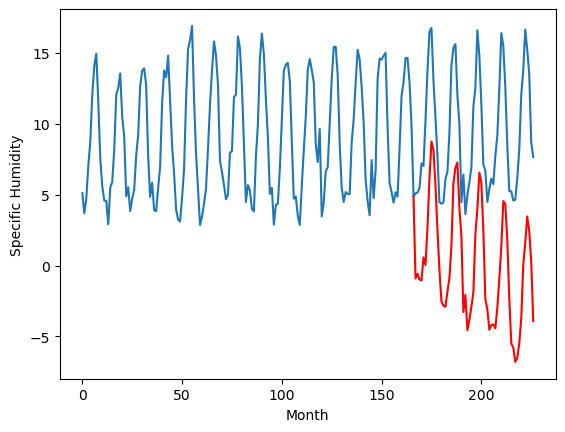

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.24		1.54		-0.70
1.83		1.49		-0.34
1.80		1.33		-0.47
1.44		0.95		-0.49
4.04		3.18		-0.86
4.19		2.64		-1.55
7.16		5.27		-1.89
10.69		8.36		-2.33
13.43		10.96		-2.47
10.76		9.59		-1.17
9.32		7.38		-1.94
4.75		3.63		-1.12
3.25		1.47		-1.78
1.21		-0.40		-1.61
1.12		-0.55		-1.67
0.56		-1.05		-1.61
3.07		0.51		-2.56
4.24		1.54		-2.70
7.76		4.50		-3.26
12.29		8.35		-3.94
13.17		9.33		-3.84
13.34		9.33		-4.01
9.37		5.95		-3.42
7.18		3.94		-3.24
2.75		-0.63		-3.38
3.72		0.24		-3.48
0.53		-2.25		-2.78
0.90		-1.90		-2.80
2.37		-0.86		-3.23
4.67		0.80		-3.87
9.12		4.70		-4.42
11.74		6.64		-5.10
11.95		8.51		-3.44
12.56		8.13		-4.43
8.71		4.54		-4.17
4.25		-0.13		-4.38
3.22		-1.13		-4.35
2.03		-2.09		-4.12
1.95		-2.05		-4.00
2.11		-2.23		-4.34
3.05		-1.88		-4.93
3.92		-0.84		-4.76
8.33		2.31		-6.02
10.97		4.49		-6.48
13.24		6.57		-6.67
13.48		6.38		-7.10
9.41		4.09		-5.32
5.97		0.20		-5.77
3.09		-2.84		-

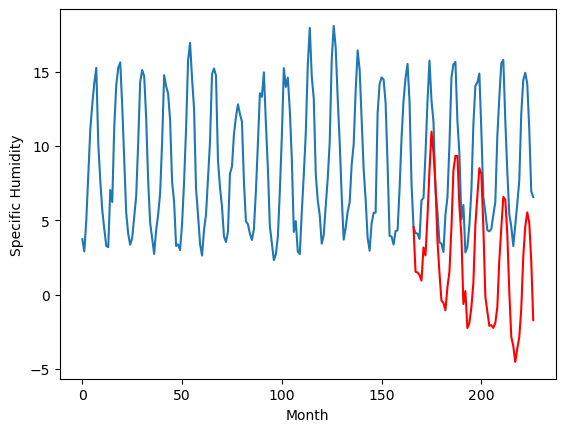

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.79		3.26		-0.53
4.33		2.95		-1.38
3.95		2.69		-1.26
3.26		2.25		-1.01
4.34		2.52		-1.82
5.71		2.99		-2.72
5.52		4.38		-1.14
7.06		5.90		-1.16
7.28		6.66		-0.62
8.80		6.45		-2.35
8.32		5.69		-2.63
6.44		4.14		-2.30
3.75		2.74		-1.01
3.15		1.70		-1.45
3.59		1.69		-1.90
3.53		1.53		-2.00
3.61		1.13		-2.48
4.23		1.37		-2.86
4.63		3.35		-1.28
7.08		5.16		-1.92
7.78		5.71		-2.07
7.31		5.37		-1.94
6.02		3.99		-2.03
4.88		2.62		-2.26
5.46		1.91		-3.55
3.96		0.33		-3.63
3.68		0.55		-3.13
2.90		0.26		-2.64
4.24		1.05		-3.19
3.91		0.80		-3.11
4.09		2.28		-1.81
5.26		4.27		-0.99
6.43		5.73		-0.70
7.22		6.03		-1.19
6.93		4.19		-2.74
5.76		3.00		-2.76
3.04		0.48		-2.56
3.88		-0.12		-4.00
4.03		-0.15		-4.18
2.90		-0.83		-3.73
4.42		-0.69		-5.11
4.62		0.12		-4.50
5.56		2.73		-2.83
6.33		3.25		-3.08
7.43		3.40		-4.03
8.50		4.05		-4.45
6.96		2.99		-3.97
5.80		1.24		-4.56
3.69		-0.55		-4.24
3.92		-0.52		-4.44

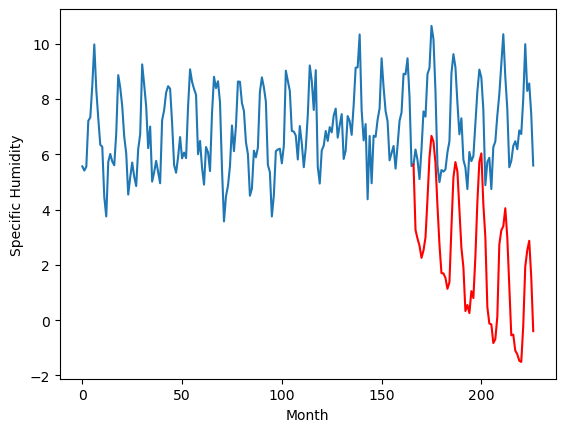

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.02		1.63		0.61
1.55		1.80		0.25
1.15		1.46		0.31
0.97		1.18		0.21
2.83		2.67		-0.16
2.75		2.30		-0.45
6.18		5.06		-1.12
9.42		8.54		-0.88
12.52		11.33		-1.19
11.44		10.27		-1.17
8.87		7.62		-1.25
5.18		4.21		-0.97
2.29		1.79		-0.50
0.68		0.06		-0.62
0.41		-0.29		-0.70
0.34		-0.70		-1.04
1.64		0.48		-1.16
2.83		1.59		-1.24
5.36		3.87		-1.49
10.78		8.26		-2.52
11.41		9.42		-1.99
12.29		9.78		-2.51
8.82		6.29		-2.53
6.76		4.48		-2.28
1.07		-0.60		-1.67
2.21		0.02		-2.19
-0.11		-1.99		-1.88
0.41		-1.48		-1.89
1.39		-0.52		-1.91
2.66		0.49		-2.17
7.08		4.54		-2.54
9.34		6.36		-2.98
12.38		8.89		-3.49
11.25		8.37		-2.88
8.00		4.88		-3.12
2.85		0.21		-2.64
2.04		-0.77		-2.81
1.01		-2.02		-3.03
1.55		-1.67		-3.22
1.37		-2.02		-3.39
1.24		-2.13		-3.37
2.78		-0.68		-3.46
5.69		1.50		-4.19
7.71		3.78		-3.93
11.36		6.98		-4.38
10.81		6.63		-4.18
8.34		4.30		-4.04
4.81		0.36		-4.45
1.42		-2.91		-4.33
1.

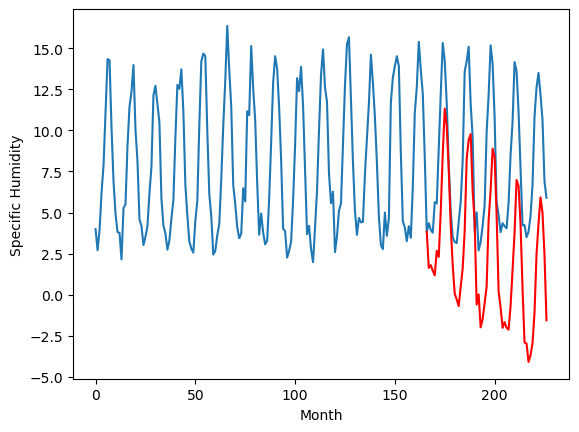

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.49		0.51		-1.98
0.99		0.60		-0.39
-1.30		0.30		1.60
-2.06		-0.05		2.01
0.01		1.36		1.35
0.33		1.06		0.73
4.03		3.90		-0.13
7.12		7.30		0.18
11.07		10.07		-1.00
8.69		8.82		0.13
5.73		6.06		0.33
1.01		2.58		1.57
-0.09		0.51		0.60
-2.02		-1.05		0.97
-2.22		-1.37		0.85
-3.05		-1.92		1.13
-0.57		-0.72		-0.15
0.49		0.42		-0.07
2.91		2.74		-0.17
7.37		7.01		-0.36
9.32		8.19		-1.13
9.41		8.42		-0.99
5.64		4.94		-0.70
3.69		3.14		-0.55
-1.43		-1.63		-0.20
-0.73		-1.39		-0.66
-3.19		-3.06		0.13
-2.57		-2.68		-0.11
-1.00		-1.72		-0.72
0.56		-0.71		-1.27
4.65		3.23		-1.42
6.75		5.14		-1.61
9.34		7.60		-1.74
8.84		7.14		-1.70
5.74		3.68		-2.06
0.74		-0.85		-1.59
-0.65		-1.97		-1.32
-1.77		-3.14		-1.37
-1.39		-2.80		-1.41
-0.51		-3.27		-2.76
-0.84		-3.27		-2.43
0.39		-1.86		-2.25
3.57		0.50		-3.07
5.70		2.71		-2.99
9.47		5.74		-3.73
9.86		5.44		-4.42
5.75		3.15		-2.60
2.13		-0.67		-2.80
-1.04		-3.90		-2

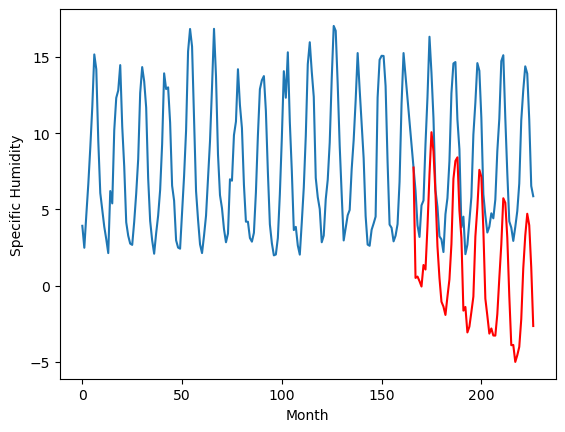

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.44		0.25		-0.19
0.73		0.37		-0.36
0.23		0.05		-0.18
-0.02		-0.27		-0.25
1.97		1.17		-0.80
2.09		0.84		-1.25
5.30		3.66		-1.64
8.03		7.11		-0.92
11.19		9.91		-1.28
9.97		8.73		-1.24
6.79		6.00		-0.79
3.37		2.53		-0.84
1.60		0.31		-1.29
-0.06		-1.31		-1.25
-0.37		-1.66		-1.29
-0.89		-2.15		-1.26
1.14		-0.95		-2.09
2.44		0.19		-2.25
4.68		2.48		-2.20
9.90		6.83		-3.07
11.15		8.01		-3.14
11.32		8.30		-3.02
8.02		4.80		-3.22
6.40		3.00		-3.40
0.53		-1.94		-2.47
1.58		-1.54		-3.12
-0.93		-3.35		-2.42
-0.40		-2.92		-2.52
0.91		-1.96		-2.87
2.44		-0.94		-3.38
6.67		3.06		-3.61
8.74		4.92		-3.82
11.52		7.43		-4.09
10.32		6.95		-3.37
7.55		3.46		-4.09
2.25		-1.15		-3.40
1.03		-2.21		-3.24
0.27		-3.41		-3.68
0.85		-3.06		-3.91
0.52		-3.49		-4.01
0.95		-3.55		-4.50
2.26		-2.11		-4.37
4.86		0.16		-4.70
7.02		2.42		-4.60
11.53		5.55		-5.98
10.65		5.21		-5.44
7.42		2.91		-4.51
4.04		-0.97		-5.01
0.85		-4.

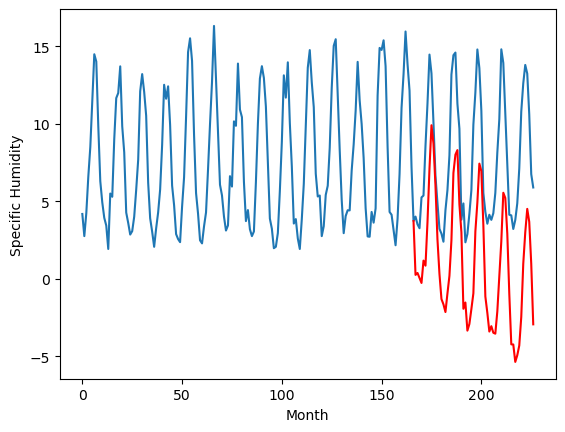

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.78		2.99		-1.79
4.41		2.73		-1.68
4.37		2.53		-1.84
4.33		2.08		-2.25
4.96		2.88		-2.08
5.31		3.06		-2.25
6.44		4.98		-1.46
7.50		7.01		-0.49
9.02		8.44		-0.58
7.81		7.71		-0.10
6.67		6.28		-0.39
5.02		3.93		-1.09
4.96		2.55		-2.41
4.15		1.39		-2.76
4.32		1.35		-2.97
4.38		0.96		-3.42
4.69		1.22		-3.47
5.16		1.75		-3.41
6.56		4.04		-2.52
7.89		6.52		-1.37
10.34		7.28		-3.06
8.91		6.97		-1.94
7.21		4.89		-2.32
6.12		3.31		-2.81
5.41		1.48		-3.93
4.70		0.40		-4.30
4.22		0.05		-4.17
4.01		-0.10		-4.11
4.69		0.78		-3.91
5.19		1.11		-4.08
6.00		3.38		-2.62
7.94		5.43		-2.51
10.93		7.04		-3.89
10.77		7.14		-3.63
7.82		4.73		-3.09
6.21		2.43		-3.78
4.55		0.32		-4.23
4.58		-0.37		-4.95
4.55		-0.35		-4.90
4.17		-0.96		-5.13
4.47		-0.70		-5.17
5.10		0.18		-4.92
7.26		3.07		-4.19
7.49		4.10		-3.39
8.33		4.91		-3.42
9.98		5.32		-4.66
7.36		3.85		-3.51
6.11		1.44		-4.67
4.78		-0.78		-5.56
4.65		-0.85		-

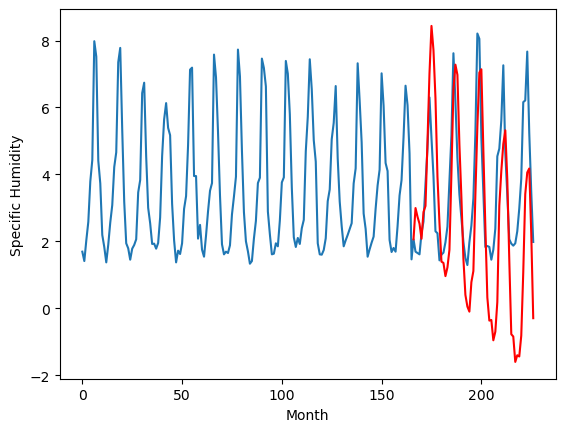

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.69		1.28		-1.41
3.68		0.93		-2.75
2.56		0.71		-1.85
2.14		0.24		-1.90
3.88		0.61		-3.27
3.69		1.03		-2.66
2.99		2.57		-0.42
3.32		4.14		0.82
3.80		5.03		1.23
4.67		4.63		-0.04
3.41		3.68		0.27
2.40		1.91		-0.49
2.38		0.67		-1.71
1.55		-0.33		-1.88
2.36		-0.32		-2.68
1.88		-0.59		-2.47
2.18		-0.82		-3.00
1.87		-0.53		-2.40
2.43		1.58		-0.85
3.85		3.46		-0.39
9.21		4.06		-5.15
6.78		3.65		-3.13
5.06		2.12		-2.94
3.96		0.69		-3.27
2.69		-0.10		-2.79
2.83		-1.73		-4.56
1.84		-1.51		-3.35
1.41		-1.83		-3.24
2.03		-1.01		-3.04
2.03		-1.12		-3.15
2.29		0.48		-1.81
4.05		2.53		-1.52
7.48		3.96		-3.52
10.55		4.25		-6.30
6.64		2.29		-4.35
3.91		0.92		-2.99
2.14		-1.58		-3.72
2.89		-2.16		-5.05
3.28		-2.20		-5.48
2.03		-2.90		-4.93
3.07		-2.67		-5.74
2.22		-1.88		-4.10
3.76		0.91		-2.85
4.26		1.49		-2.77
5.23		1.67		-3.56
7.81		2.30		-5.51
6.87		1.16		-5.71
3.81		-0.68		-4.49
2.80		-2.53		-5.33
2.72		

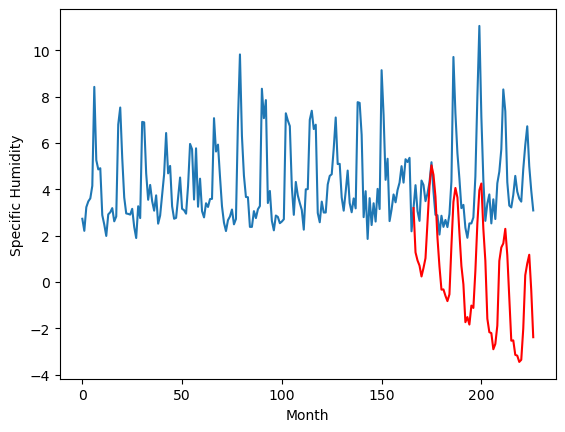

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.33		2.07		-1.26
4.56		1.81		-2.75
3.88		1.51		-2.37
2.99		1.13		-1.86
3.47		1.34		-2.13
4.53		1.83		-2.70
5.39		3.05		-2.34
5.61		4.54		-1.07
6.08		5.17		-0.91
6.88		5.21		-1.67
6.49		4.65		-1.84
4.29		3.32		-0.97
3.13		1.67		-1.46
2.79		0.52		-2.27
3.46		0.50		-2.96
3.11		0.49		-2.62
2.76		-0.06		-2.82
3.69		0.10		-3.59
4.13		1.99		-2.14
5.56		3.74		-1.82
6.04		4.24		-1.80
6.43		3.98		-2.45
5.79		2.75		-3.04
4.76		1.40		-3.36
4.98		0.70		-4.28
3.73		-0.71		-4.44
3.40		-0.61		-4.01
2.56		-0.83		-3.39
3.56		-0.05		-3.61
3.66		-0.41		-4.07
4.03		0.99		-3.04
5.52		2.93		-2.59
6.35		4.41		-1.94
6.81		4.69		-2.12
6.21		2.95		-3.26
4.90		1.88		-3.02
2.65		-0.62		-3.27
3.44		-1.26		-4.70
3.27		-1.29		-4.56
2.41		-1.88		-4.29
3.21		-1.83		-5.04
3.59		-1.01		-4.60
5.18		1.42		-3.76
5.24		1.90		-3.34
6.08		2.03		-4.05
7.35		2.71		-4.64
6.80		1.69		-5.11
5.37		-0.03		-5.40
4.28		-1.75		-6.03
4.66		-1.

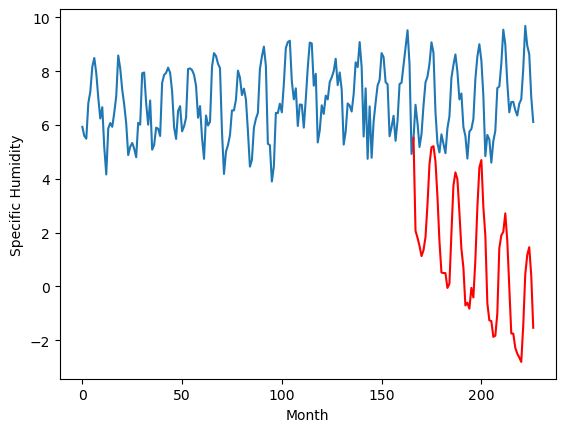

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.63		0.38
1.89		2.76		0.87
1.61		2.39		0.78
1.69		2.05		0.36
2.18		3.04		0.86
2.68		2.93		0.25
4.91		5.55		0.64
9.02		8.87		-0.15
13.00		11.48		-1.52
11.93		10.51		-1.42
8.56		7.94		-0.62
6.03		4.90		-1.13
3.87		2.71		-1.16
1.91		1.35		-0.56
0.82		0.96		0.14
0.97		0.52		-0.45
1.75		1.30		-0.45
3.13		2.35		-0.78
4.70		4.31		-0.39
9.60		8.49		-1.11
11.81		9.62		-2.19
12.19		10.01		-2.18
9.59		6.77		-2.82
7.05		5.17		-1.88
2.52		0.71		-1.81
2.22		0.65		-1.57
0.74		-0.63		-1.37
1.33		-0.26		-1.59
2.17		0.66		-1.51
2.82		1.24		-1.58
6.21		4.90		-1.31
8.55		6.68		-1.87
11.71		9.29		-2.42
11.85		8.91		-2.94
8.18		5.69		-2.49
5.55		1.66		-3.89
3.70		0.35		-3.35
1.73		-0.82		-2.55
2.30		-0.40		-2.70
1.59		-1.02		-2.61
1.80		-1.21		-3.01
4.04		0.31		-3.73
4.56		2.19		-2.37
8.26		4.27		-3.99
13.11		7.37		-5.74
10.54		7.05		-3.49
9.57		5.03		-4.54
6.18		1.49		-4.69
2.38		-1.67		-4.05
2.71		-1.39	

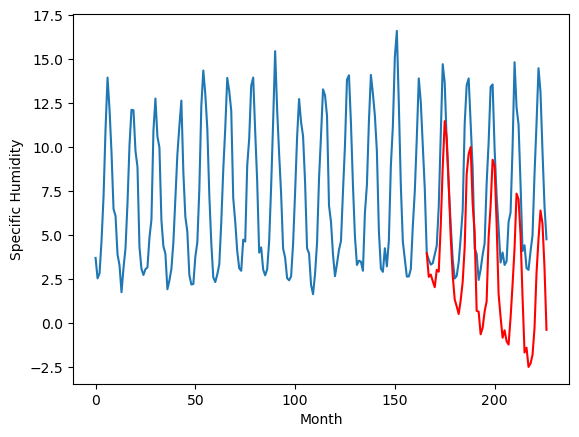

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		0.18		0.72
-0.66		0.32		0.98
-0.74		-0.04		0.70
-0.75		-0.37		0.38
0.21		0.80		0.59
0.64		0.59		-0.05
3.17		3.30		0.13
6.74		6.71		-0.03
10.09		9.43		-0.66
9.45		8.38		-1.07
6.16		5.74		-0.42
3.39		2.53		-0.86
1.06		0.27		-0.79
-0.79		-1.20		-0.41
-1.48		-1.58		-0.10
-1.62		-2.04		-0.42
-0.34		-1.09		-0.75
1.07		0.01		-1.06
2.66		2.08		-0.58
7.53		6.38		-1.15
9.22		7.54		-1.68
9.54		7.92		-1.62
6.62		4.54		-2.08
4.72		2.87		-1.85
-0.20		-1.87		-1.67
-0.30		-1.69		-1.39
-1.81		-3.23		-1.42
-1.11		-2.81		-1.70
-0.17		-1.88		-1.71
0.47		-1.13		-1.60
4.65		2.70		-1.95
6.05		4.50		-1.55
9.03		7.10		-1.93
8.66		6.67		-1.99
5.64		3.32		-2.32
2.22		-0.98		-3.20
1.00		-2.16		-3.16
-0.92		-3.37		-2.45
-0.14		-2.96		-2.82
-0.89		-3.50		-2.61
-0.76		-3.67		-2.91
1.67		-2.16		-3.83
2.14		-0.17		-2.31
5.83		2.00		-3.83
9.81		5.19		-4.62
8.57		4.84		-3.73
6.88		2.70		-4.18
3.61		-1.00		-4.61
-0.07		

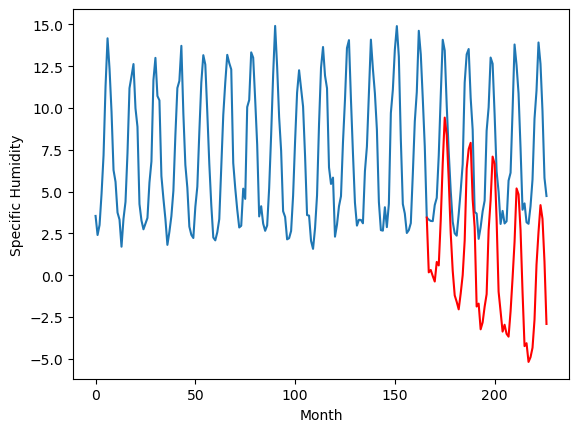

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.29  -0.899776
1                 1    2.24   1.543301
2                 2    3.79   3.259986
3                 3    1.02   1.630984
4                 4    2.49   0.511986
5                 5    0.44   0.246899
6                 6    4.78   2.993588
7                 7    2.69   1.279365
8                 8    3.33   2.066562
9                 9    2.25   2.634104
10               10   -0.54   0.176103


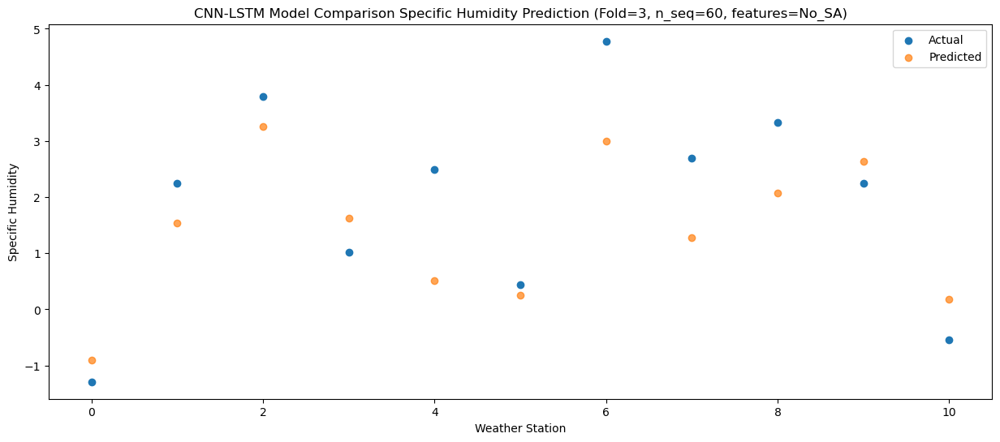

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.08  -0.574797
1                 1    1.83   1.494877
2                 2    4.33   2.949214
3                 3    1.55   1.798296
4                 4    0.99   0.601075
5                 5    0.73   0.369899
6                 6    4.41   2.734247
7                 7    3.68   0.933401
8                 8    4.56   1.807296
9                 9    1.89   2.764800
10               10   -0.66   0.316696


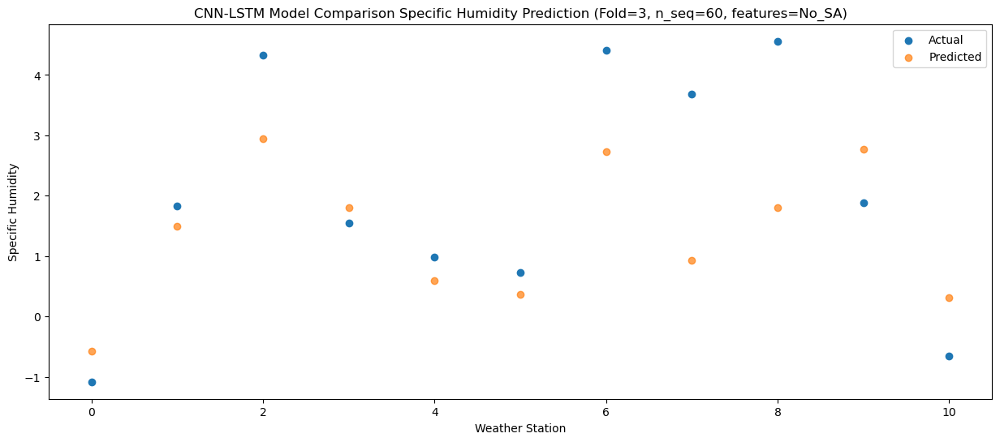

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.03  -0.979137
1                 1    1.80   1.325069
2                 2    3.95   2.690941
3                 3    1.15   1.456130
4                 4   -1.30   0.298433
5                 5    0.23   0.050777
6                 6    4.37   2.525526
7                 7    2.56   0.710429
8                 8    3.88   1.507124
9                 9    1.61   2.389222
10               10   -0.74  -0.044658


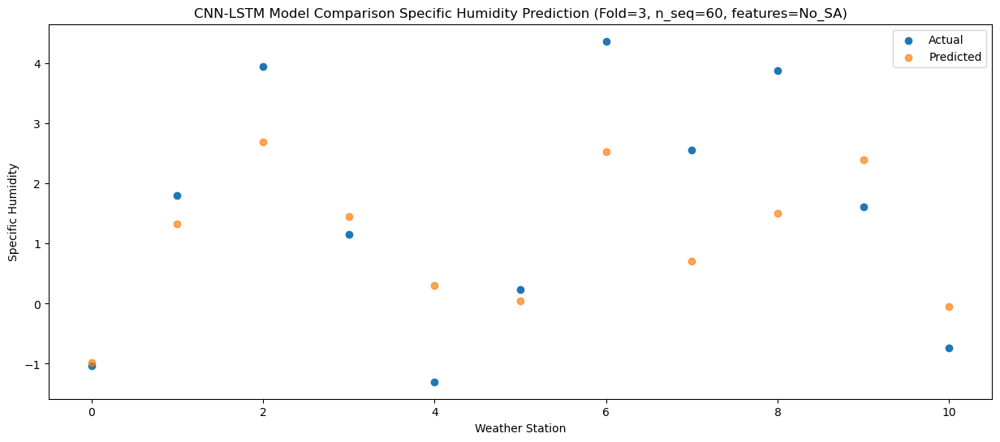

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.70  -1.052186
1                 1    1.44   0.949149
2                 2    3.26   2.251537
3                 3    0.97   1.180149
4                 4   -2.06  -0.052792
5                 5   -0.02  -0.274048
6                 6    4.33   2.075342
7                 7    2.14   0.240899
8                 8    2.99   1.126908
9                 9    1.69   2.045913
10               10   -0.75  -0.371846


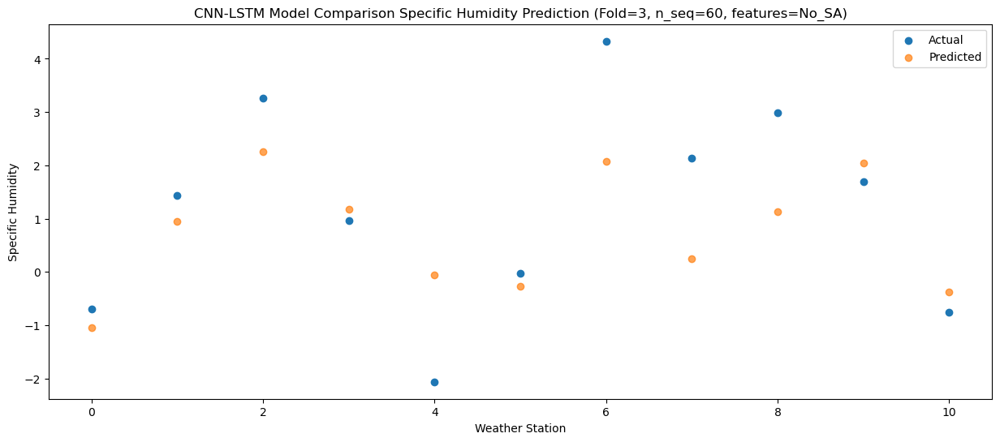

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.03   0.581167
1                 1    4.04   3.175688
2                 2    4.34   2.520513
3                 3    2.83   2.671080
4                 4    0.01   1.360939
5                 5    1.97   1.170348
6                 6    4.96   2.875054
7                 7    3.88   0.608017
8                 8    3.47   1.344271
9                 9    2.18   3.035624
10               10    0.21   0.798563


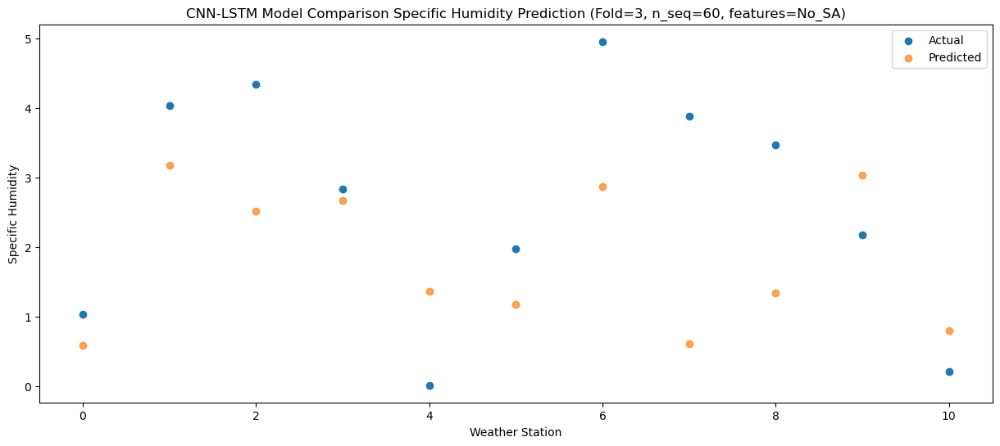

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.85   0.045232
1                 1    4.19   2.641596
2                 2    5.71   2.989738
3                 3    2.75   2.298446
4                 4    0.33   1.062001
5                 5    2.09   0.841611
6                 6    5.31   3.056035
7                 7    3.69   1.029468
8                 8    4.53   1.829198
9                 9    2.68   2.927782
10               10    0.64   0.589718


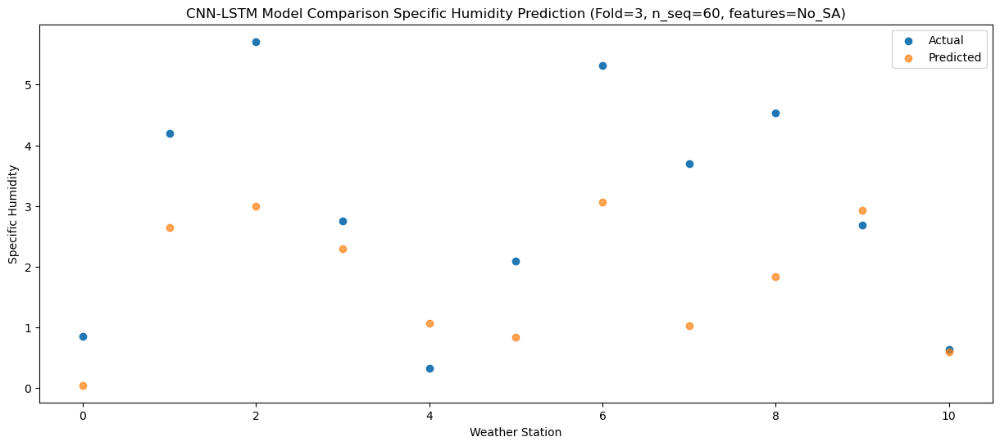

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    4.07   2.666754
1                 1    7.16   5.271042
2                 2    5.52   4.383247
3                 3    6.18   5.062507
4                 4    4.03   3.901377
5                 5    5.30   3.660455
6                 6    6.44   4.983402
7                 7    2.99   2.573301
8                 8    5.39   3.054418
9                 9    4.91   5.552587
10               10    3.17   3.300743


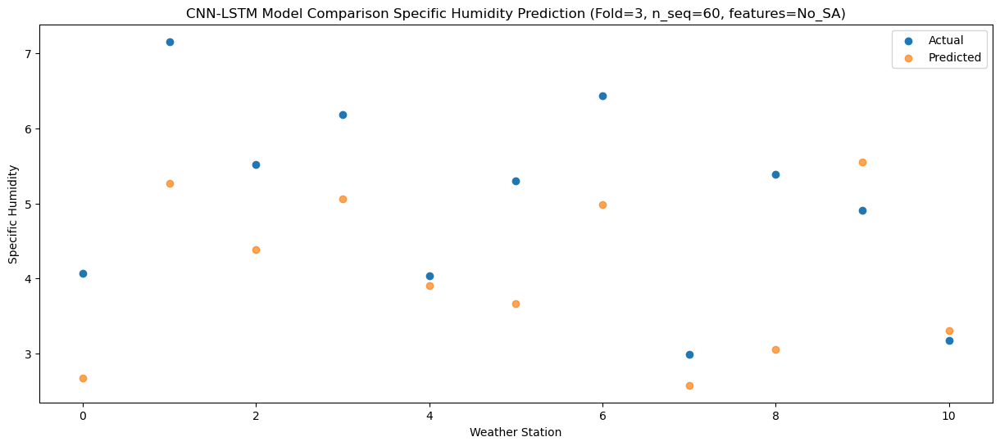

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.61   6.209274
1                 1   10.69   8.362552
2                 2    7.06   5.895978
3                 3    9.42   8.541844
4                 4    7.12   7.299525
5                 5    8.03   7.106717
6                 6    7.50   7.013248
7                 7    3.32   4.142817
8                 8    5.61   4.540083
9                 9    9.02   8.873954
10               10    6.74   6.708700


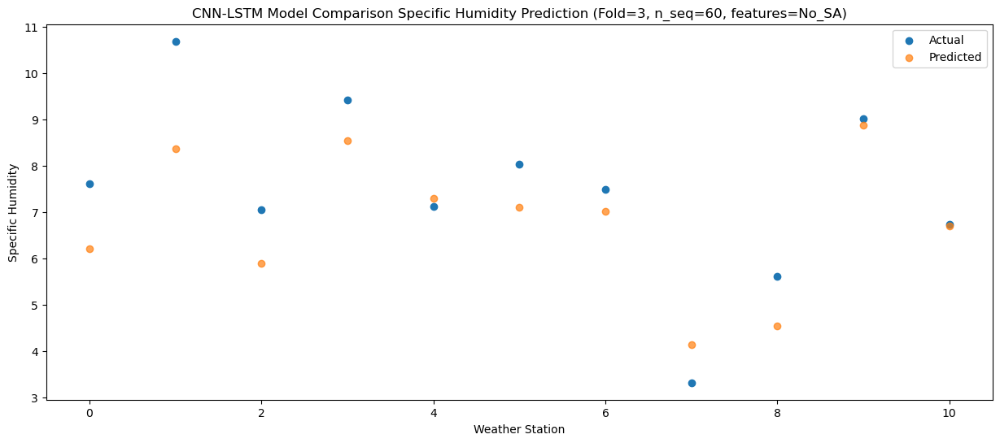

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.30   8.745186
1                 1   13.43  10.960890
2                 2    7.28   6.663889
3                 3   12.52  11.328276
4                 4   11.07  10.067624
5                 5   11.19   9.908463
6                 6    9.02   8.436775
7                 7    3.80   5.034606
8                 8    6.08   5.169994
9                 9   13.00  11.484431
10               10   10.09   9.429984


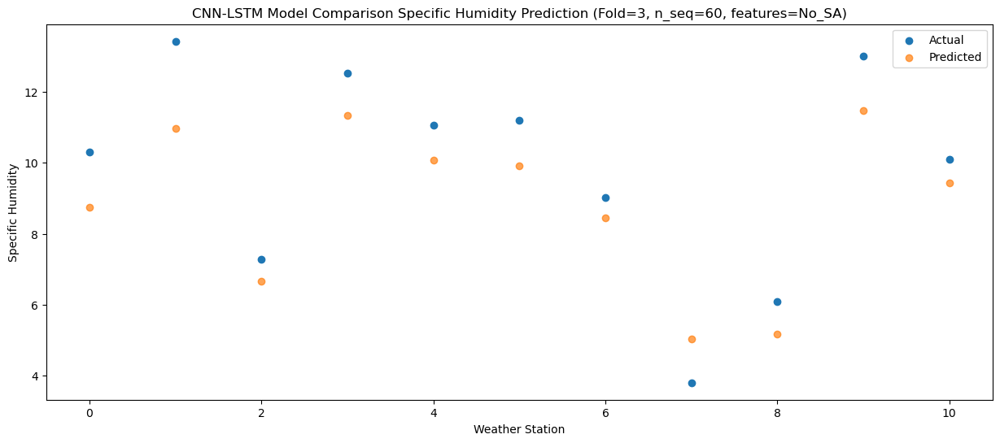

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.59   8.163963
1                 1   10.76   9.586746
2                 2    8.80   6.454407
3                 3   11.44  10.271165
4                 4    8.69   8.821476
5                 5    9.97   8.727554
6                 6    7.81   7.712288
7                 7    4.67   4.628043
8                 8    6.88   5.210322
9                 9   11.93  10.507672
10               10    9.45   8.384659


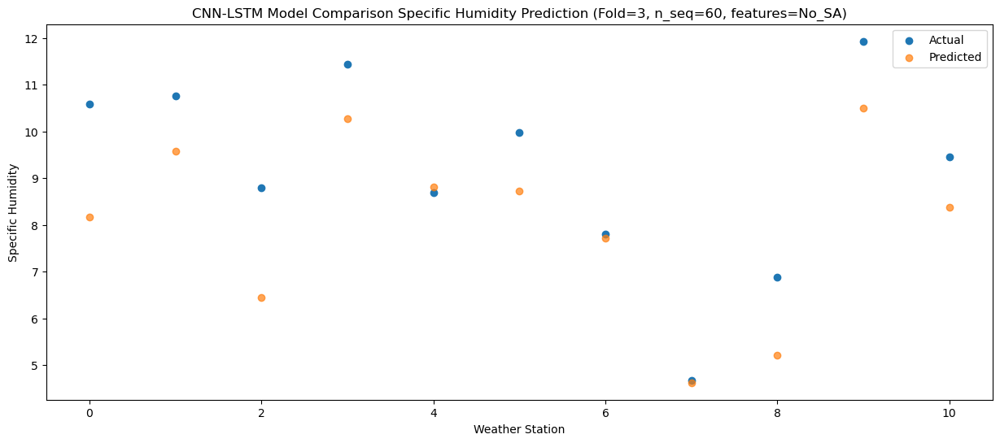

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    6.85   5.659374
1                 1    9.32   7.381694
2                 2    8.32   5.688256
3                 3    8.87   7.618077
4                 4    5.73   6.059939
5                 5    6.79   6.000095
6                 6    6.67   6.277613
7                 7    3.41   3.680841
8                 8    6.49   4.646550
9                 9    8.56   7.942961
10               10    6.16   5.739010


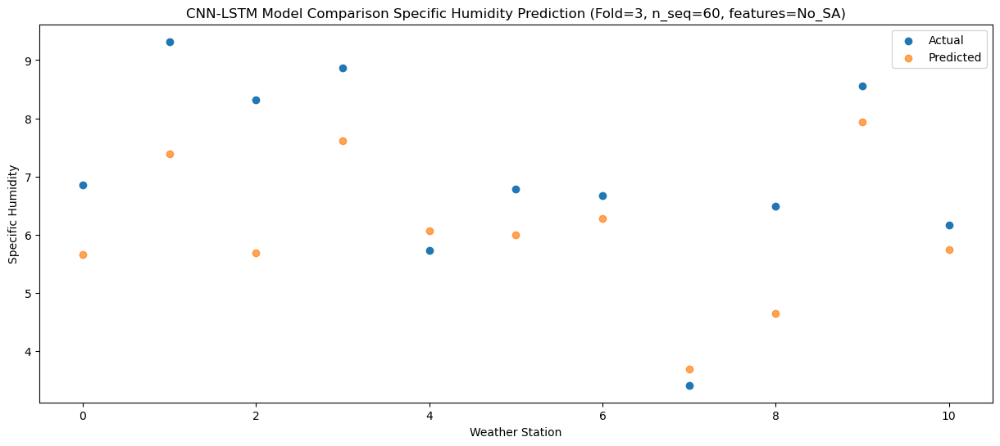

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.27   2.518403
1                 1    4.75   3.626698
2                 2    6.44   4.136829
3                 3    5.18   4.207925
4                 4    1.01   2.577938
5                 5    3.37   2.532012
6                 6    5.02   3.932174
7                 7    2.40   1.906475
8                 8    4.29   3.320506
9                 9    6.03   4.904939
10               10    3.39   2.527075


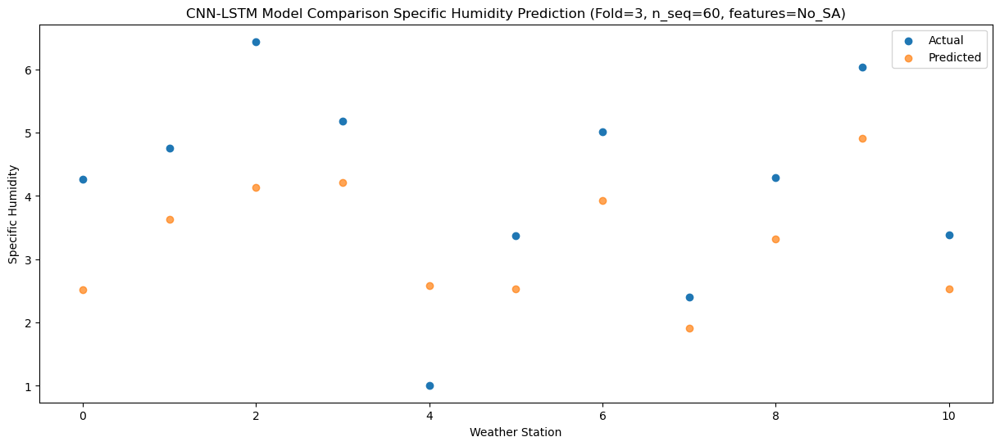

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.53  -0.337920
1                 1    3.25   1.465688
2                 2    3.75   2.735666
3                 3    2.29   1.794689
4                 4   -0.09   0.511242
5                 5    1.60   0.310319
6                 6    4.96   2.550496
7                 7    2.38   0.670731
8                 8    3.13   1.671945
9                 9    3.87   2.714498
10               10    1.06   0.272669


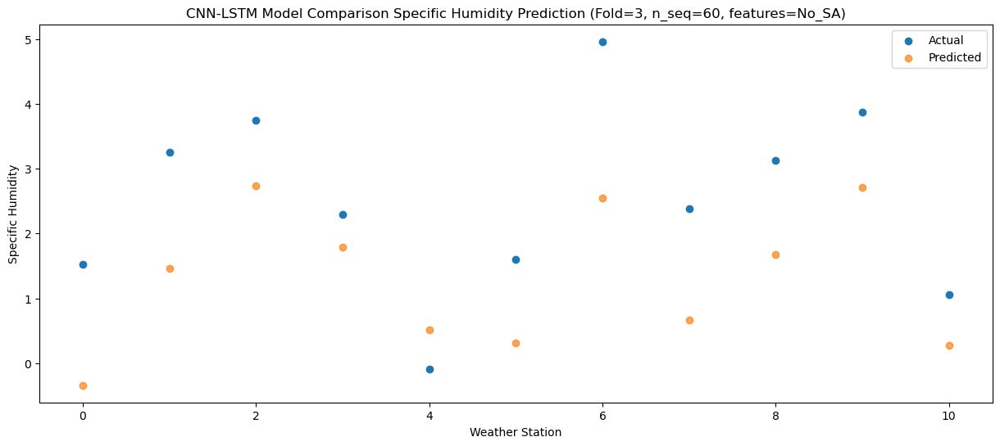

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -2.534376
1                 1    1.21  -0.395630
2                 2    3.15   1.699734
3                 3    0.68   0.060997
4                 4   -2.02  -1.047989
5                 5   -0.06  -1.313540
6                 6    4.15   1.392710
7                 7    1.55  -0.326701
8                 8    2.79   0.515487
9                 9    1.91   1.350235
10               10   -0.79  -1.197930


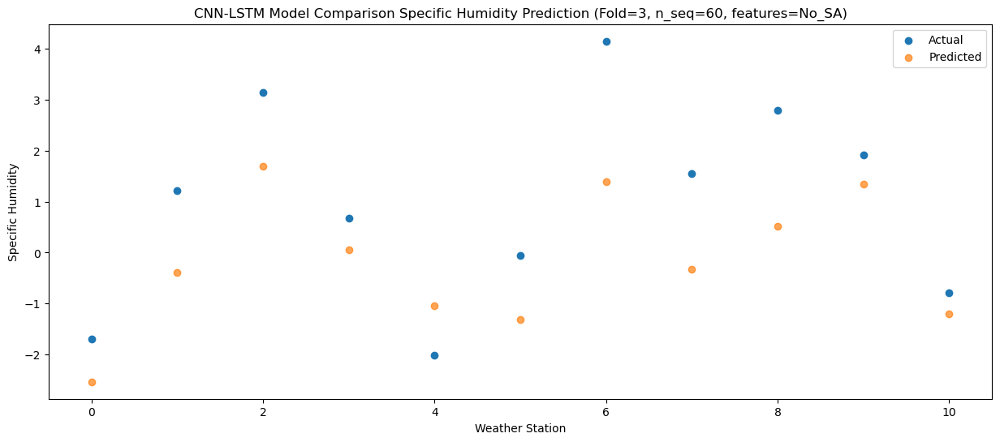

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -2.815541
1                 1    1.12  -0.546132
2                 2    3.59   1.690145
3                 3    0.41  -0.288389
4                 4   -2.22  -1.367807
5                 5   -0.37  -1.655224
6                 6    4.32   1.353663
7                 7    2.36  -0.317503
8                 8    3.46   0.497246
9                 9    0.82   0.956231
10               10   -1.48  -1.584541


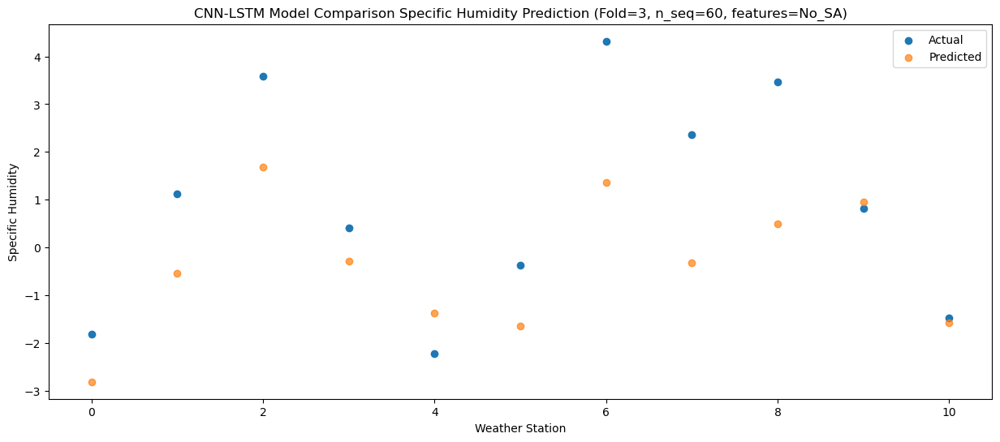

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.73  -2.907946
1                 1    0.56  -1.045768
2                 2    3.53   1.528806
3                 3    0.34  -0.695052
4                 4   -3.05  -1.917362
5                 5   -0.89  -2.152258
6                 6    4.38   0.958963
7                 7    1.88  -0.594146
8                 8    3.11   0.494869
9                 9    0.97   0.521147
10               10   -1.62  -2.036599


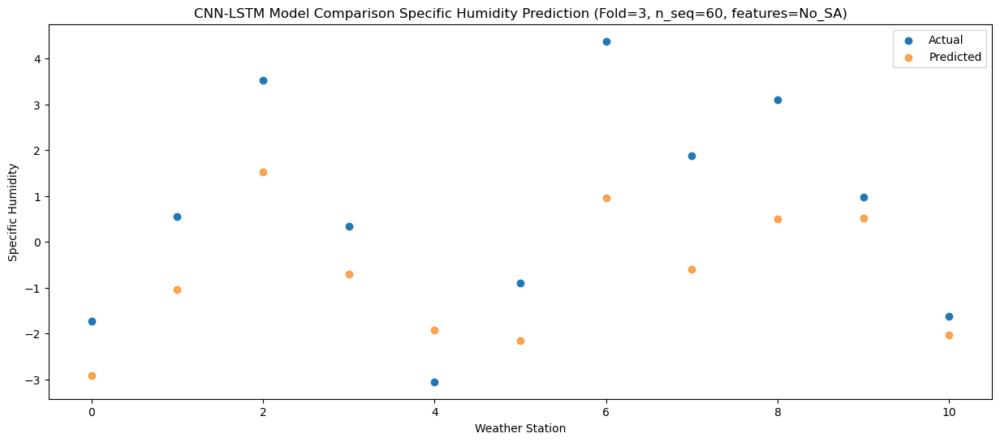

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.08  -1.823820
1                 1    3.07   0.512089
2                 2    3.61   1.132124
3                 3    1.64   0.476854
4                 4   -0.57  -0.715271
5                 5    1.14  -0.954805
6                 6    4.69   1.220775
7                 7    2.18  -0.822039
8                 8    2.76  -0.056858
9                 9    1.75   1.304718
10               10   -0.34  -1.088390


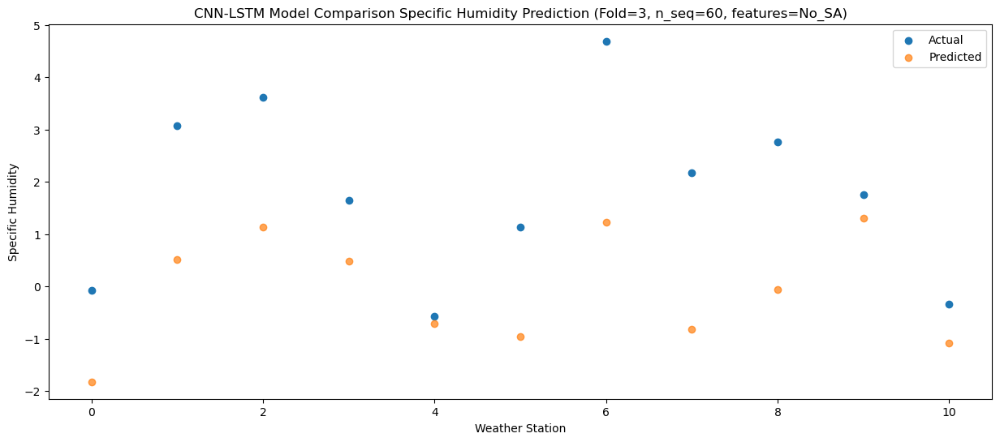

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.44  -0.857043
1                 1    4.24   1.538600
2                 2    4.23   1.365727
3                 3    2.83   1.594352
4                 4    0.49   0.418347
5                 5    2.44   0.187116
6                 6    5.16   1.745530
7                 7    1.87  -0.529132
8                 8    3.69   0.102763
9                 9    3.13   2.354109
10               10    1.07   0.011313


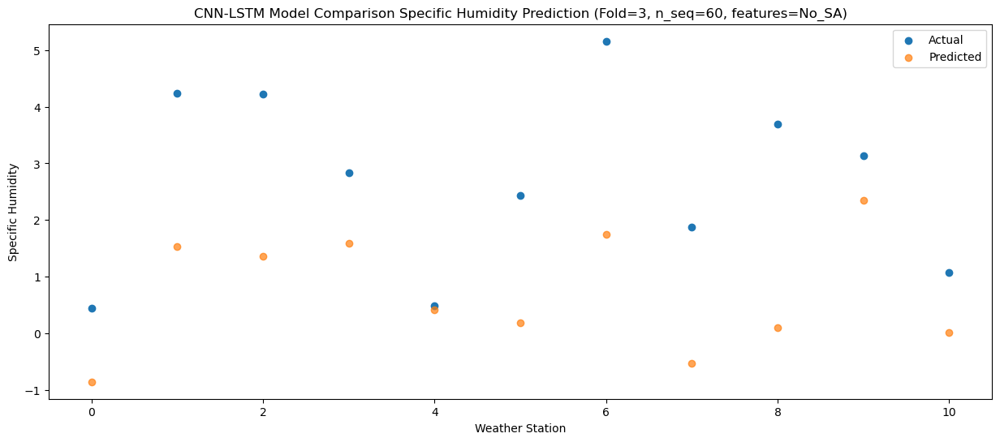

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.22   1.412339
1                 1    7.76   4.499747
2                 2    4.63   3.351769
3                 3    5.36   3.872968
4                 4    2.91   2.735908
5                 5    4.68   2.483993
6                 6    6.56   4.039073
7                 7    2.43   1.575532
8                 8    4.13   1.985220
9                 9    4.70   4.308327
10               10    2.66   2.081682


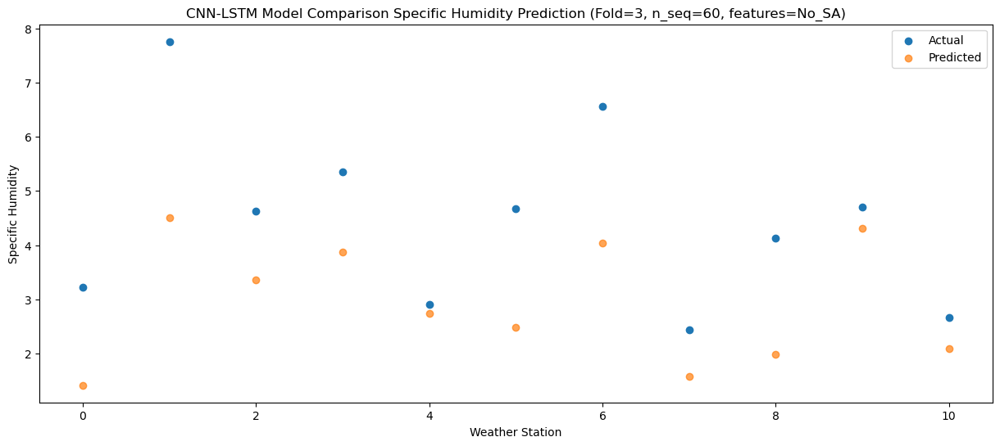

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.94   5.791957
1                 1   12.29   8.345468
2                 2    7.08   5.160247
3                 3   10.78   8.261954
4                 4    7.37   7.008165
5                 5    9.90   6.831522
6                 6    7.89   6.520289
7                 7    3.85   3.456979
8                 8    5.56   3.741906
9                 9    9.60   8.485906
10               10    7.53   6.377497


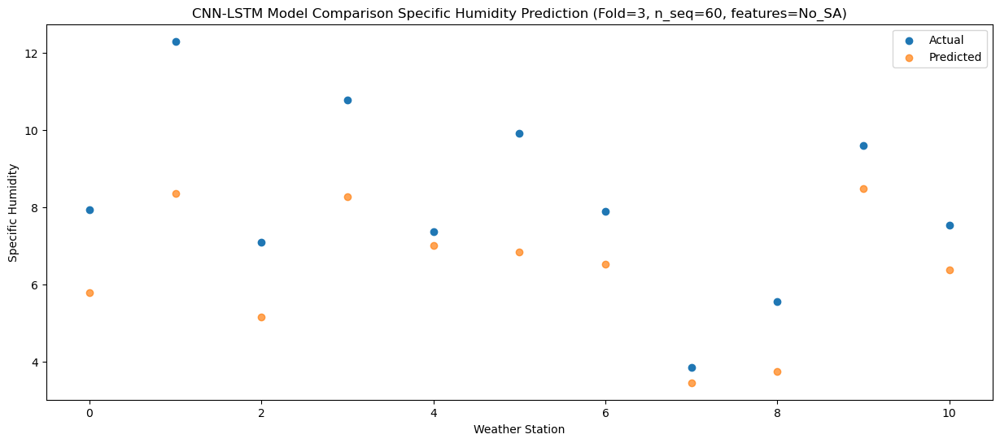

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.18   6.905374
1                 1   13.17   9.330435
2                 2    7.78   5.714669
3                 3   11.41   9.424312
4                 4    9.32   8.189041
5                 5   11.15   8.009925
6                 6   10.34   7.278548
7                 7    9.21   4.060075
8                 8    6.04   4.237305
9                 9   11.81   9.624402
10               10    9.22   7.542232


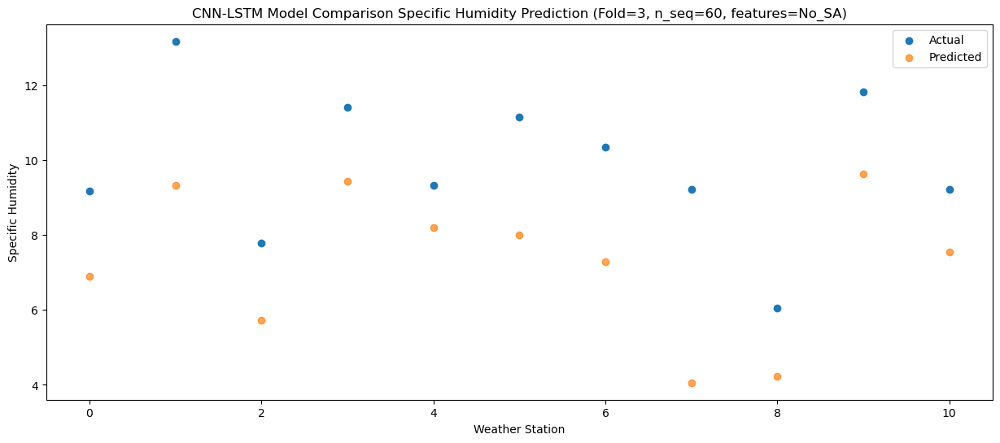

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.45   7.274046
1                 1   13.34   9.329086
2                 2    7.31   5.374855
3                 3   12.29   9.775673
4                 4    9.41   8.420920
5                 5   11.32   8.303992
6                 6    8.91   6.974647
7                 7    6.78   3.647724
8                 8    6.43   3.981783
9                 9   12.19  10.010268
10               10    9.54   7.921525


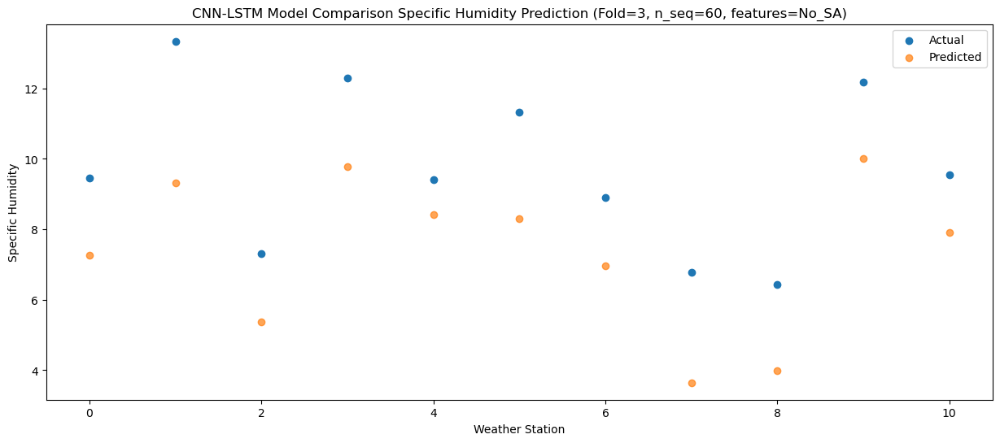

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.83   4.026885
1                 1    9.37   5.946858
2                 2    6.02   3.991375
3                 3    8.82   6.291708
4                 4    5.64   4.937746
5                 5    8.02   4.795733
6                 6    7.21   4.887312
7                 7    5.06   2.119961
8                 8    5.79   2.747691
9                 9    9.59   6.771413
10               10    6.62   4.544068


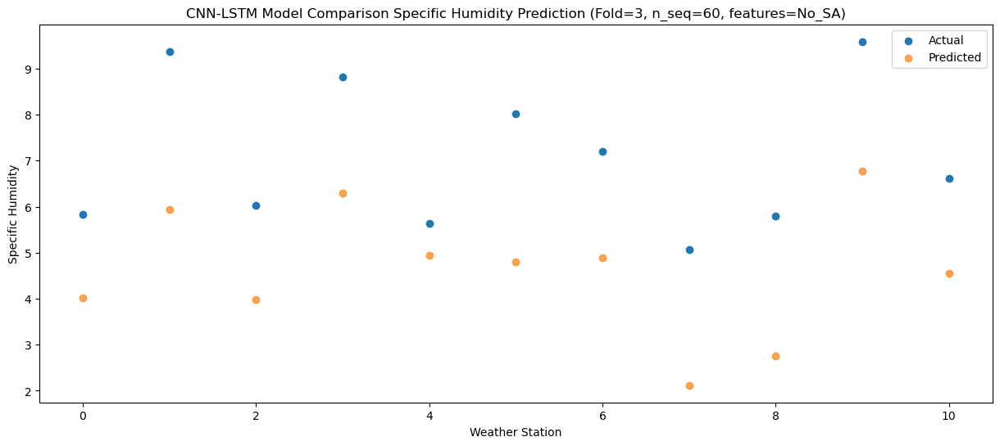

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.79   2.092458
1                 1    7.18   3.941055
2                 2    4.88   2.616355
3                 3    6.76   4.477581
4                 4    3.69   3.143034
5                 5    6.40   2.995642
6                 6    6.12   3.314171
7                 7    3.96   0.694450
8                 8    4.76   1.397581
9                 9    7.05   5.166681
10               10    4.72   2.866223


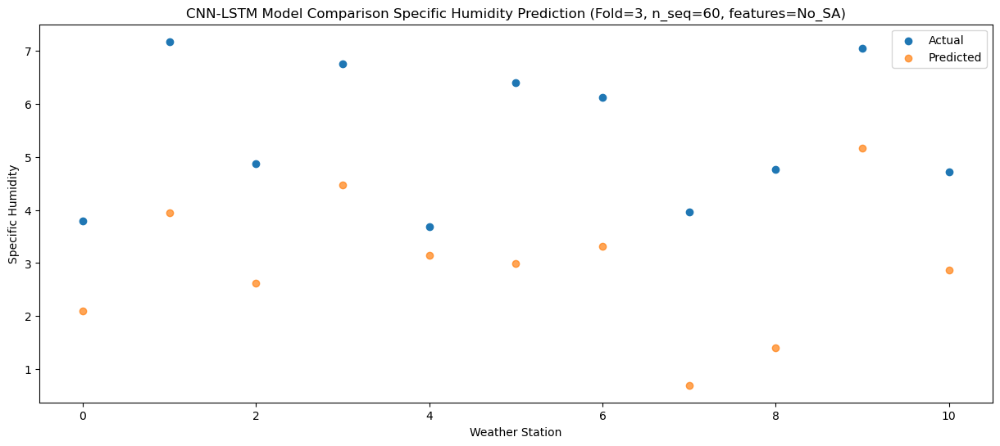

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.71  -3.273853
1                 1    2.75  -0.629772
2                 2    5.46   1.914587
3                 3    1.07  -0.599171
4                 4   -1.43  -1.633116
5                 5    0.53  -1.939377
6                 6    5.41   1.480419
7                 7    2.69  -0.096466
8                 8    4.98   0.698460
9                 9    2.52   0.706532
10               10   -0.20  -1.865564


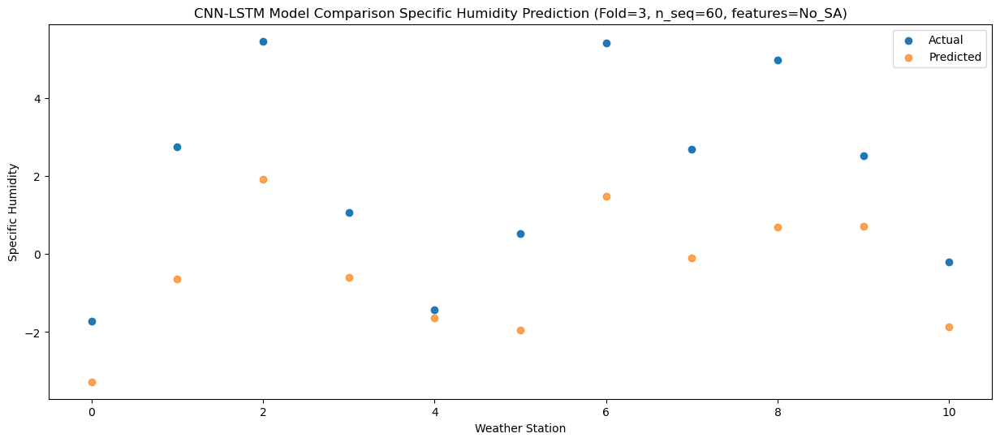

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.24  -2.069764
1                 1    3.72   0.240120
2                 2    3.96   0.328991
3                 3    2.21   0.015754
4                 4   -0.73  -1.392457
5                 5    1.58  -1.535813
6                 6    4.70   0.398435
7                 7    2.83  -1.731964
8                 8    3.73  -0.706878
9                 9    2.22   0.653723
10               10   -0.30  -1.692529


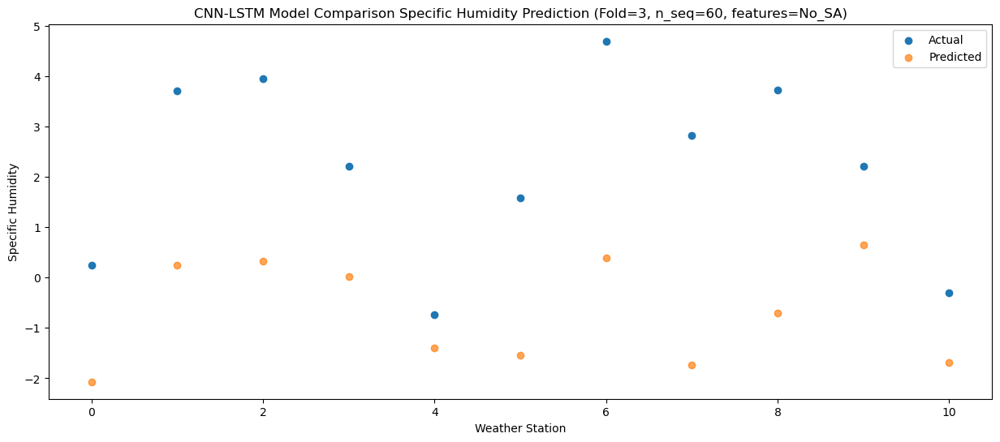

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -4.555120
1                 1    0.53  -2.246920
2                 2    3.68   0.546492
3                 3   -0.11  -1.985546
4                 4   -3.19  -3.063820
5                 5   -0.93  -3.353054
6                 6    4.22   0.048862
7                 7    1.84  -1.511280
8                 8    3.40  -0.607673
9                 9    0.74  -0.630572
10               10   -1.81  -3.229991


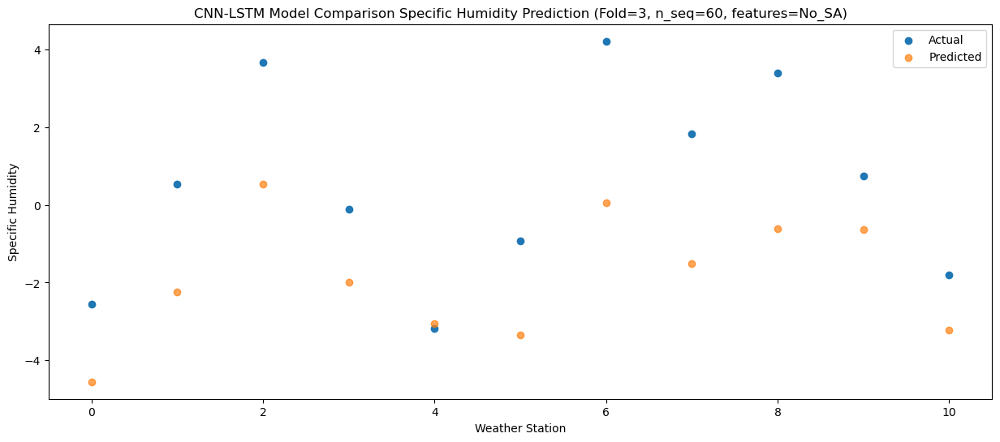

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.19  -3.831082
1                 1    0.90  -1.901774
2                 2    2.90   0.255545
3                 3    0.41  -1.484122
4                 4   -2.57  -2.683632
5                 5   -0.40  -2.921596
6                 6    4.01  -0.102183
7                 7    1.41  -1.834394
8                 8    2.56  -0.827661
9                 9    1.33  -0.260281
10               10   -1.11  -2.813627


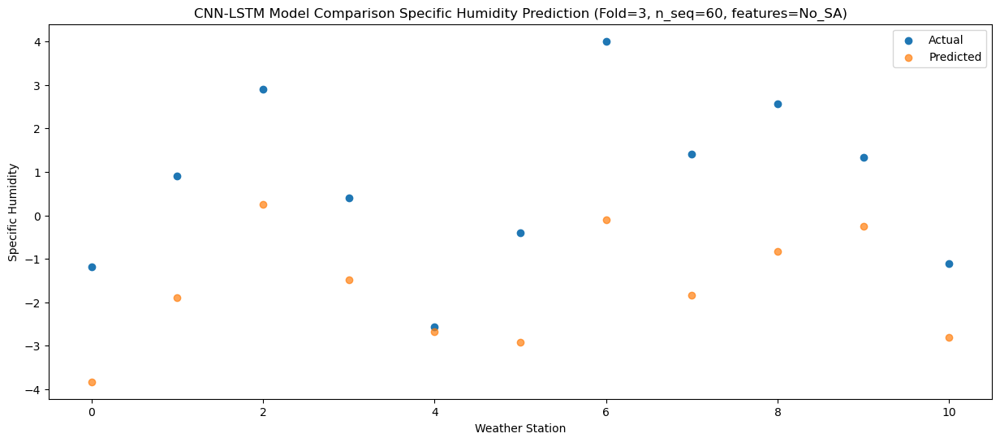

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.29  -2.910763
1                 1    2.37  -0.861262
2                 2    4.24   1.049164
3                 3    1.39  -0.524550
4                 4   -1.00  -1.721122
5                 5    0.91  -1.958220
6                 6    4.69   0.778373
7                 7    2.03  -1.014428
8                 8    3.56  -0.053514
9                 9    2.17   0.662116
10               10   -0.17  -1.876106


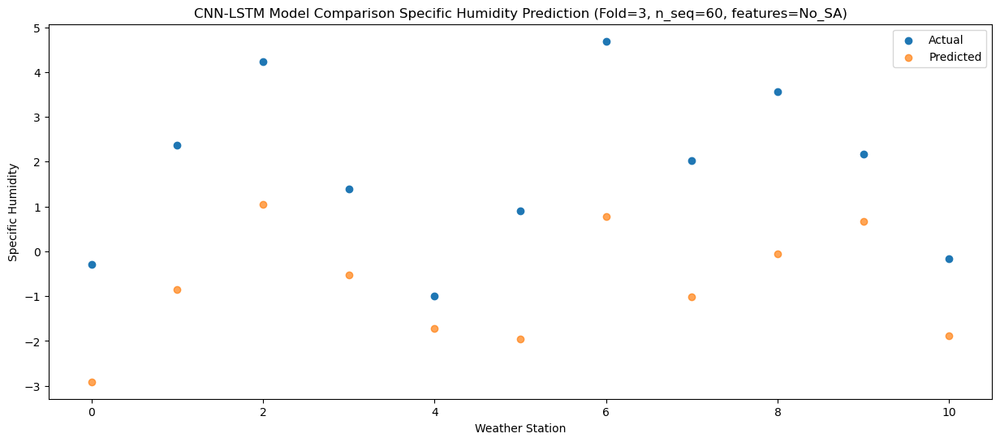

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.74  -1.883533
1                 1    4.67   0.795488
2                 2    3.91   0.799895
3                 3    2.66   0.494432
4                 4    0.56  -0.713315
5                 5    2.44  -0.942748
6                 6    5.19   1.111616
7                 7    2.03  -1.116168
8                 8    3.66  -0.410570
9                 9    2.82   1.240874
10               10    0.47  -1.126570


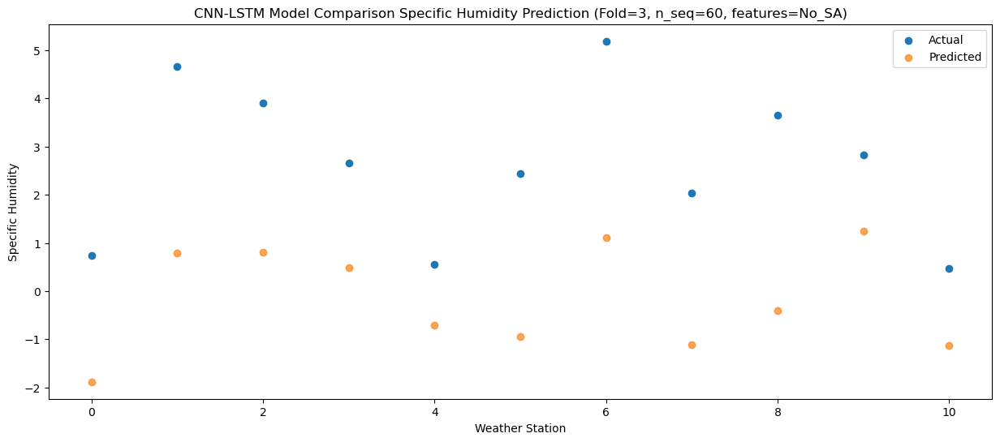

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.05   2.219837
1                 1    9.12   4.704400
2                 2    4.09   2.278918
3                 3    7.08   4.537818
4                 4    4.65   3.228348
5                 5    6.67   3.058775
6                 6    6.00   3.378573
7                 7    2.29   0.479566
8                 8    4.03   0.994032
9                 9    6.21   4.900031
10               10    4.65   2.704767


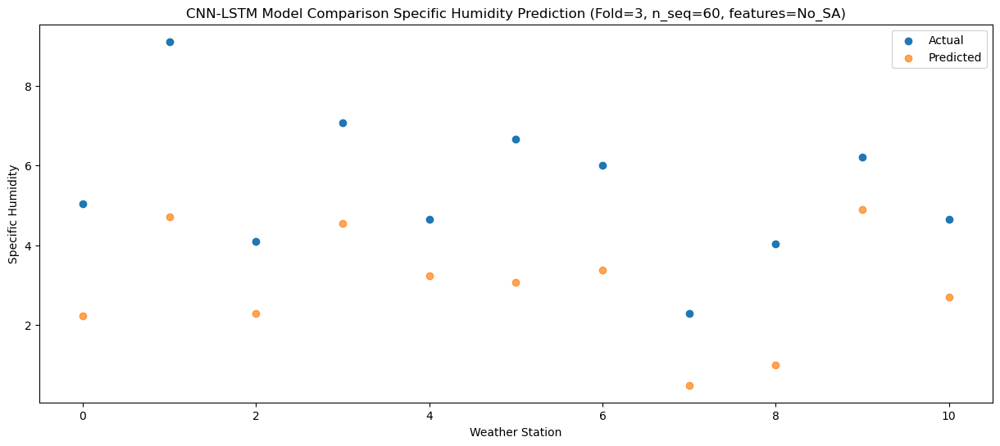

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    6.35   4.016933
1                 1   11.74   6.643604
2                 2    5.26   4.272315
3                 3    9.34   6.356692
4                 4    6.75   5.135536
5                 5    8.74   4.921791
6                 6    7.94   5.433555
7                 7    4.05   2.533457
8                 8    5.52   2.930032
9                 9    8.55   6.682756
10               10    6.05   4.495435


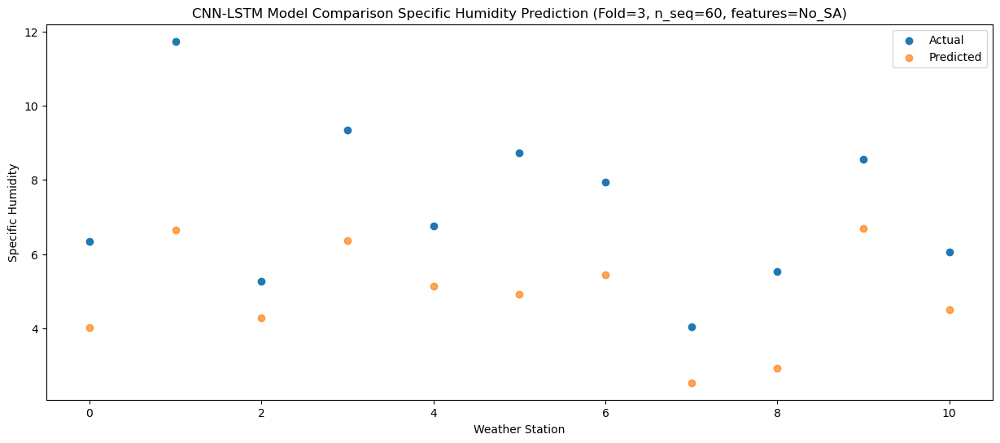

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.42   6.561325
1                 1   11.95   8.508833
2                 2    6.43   5.726937
3                 3   12.38   8.889684
4                 4    9.34   7.601145
5                 5   11.52   7.429430
6                 6   10.93   7.041954
7                 7    7.48   3.961720
8                 8    6.35   4.412286
9                 9   11.71   9.287461
10               10    9.03   7.096164


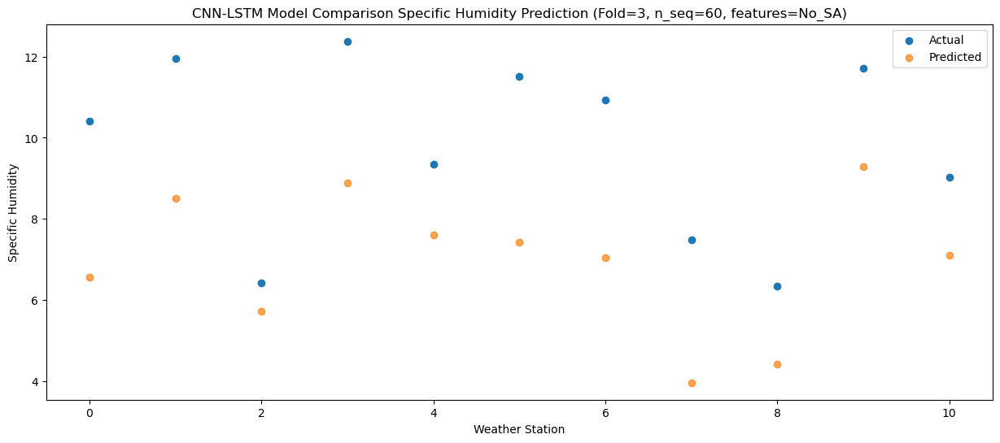

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.61   5.860022
1                 1   12.56   8.128384
2                 2    7.22   6.029738
3                 3   11.25   8.370934
4                 4    8.84   7.142346
5                 5   10.32   6.945983
6                 6   10.77   7.141210
7                 7   10.55   4.250373
8                 8    6.81   4.693923
9                 9   11.85   8.912442
10               10    8.66   6.669742


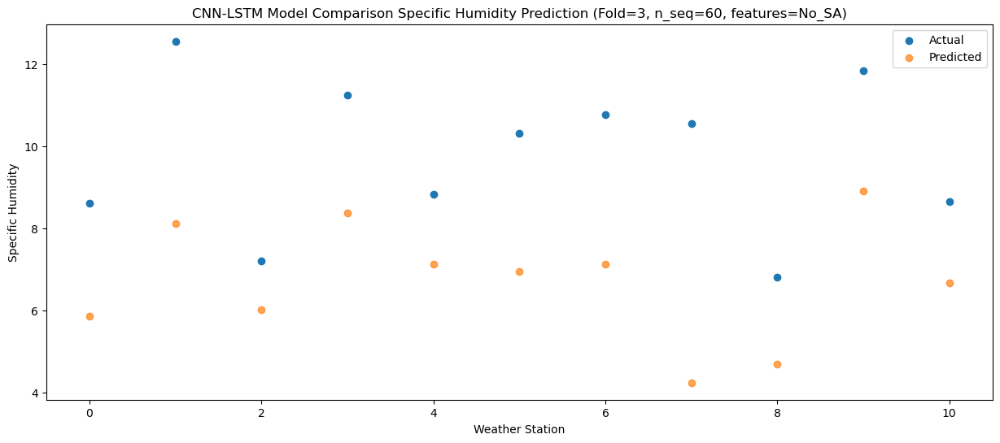

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    5.19   2.445356
1                 1    8.71   4.537308
2                 2    6.93   4.187052
3                 3    8.00   4.879641
4                 4    5.74   3.679426
5                 5    7.55   3.457568
6                 6    7.82   4.726402
7                 7    6.64   2.289537
8                 8    6.21   2.951983
9                 9    8.18   5.690673
10               10    5.64   3.323512


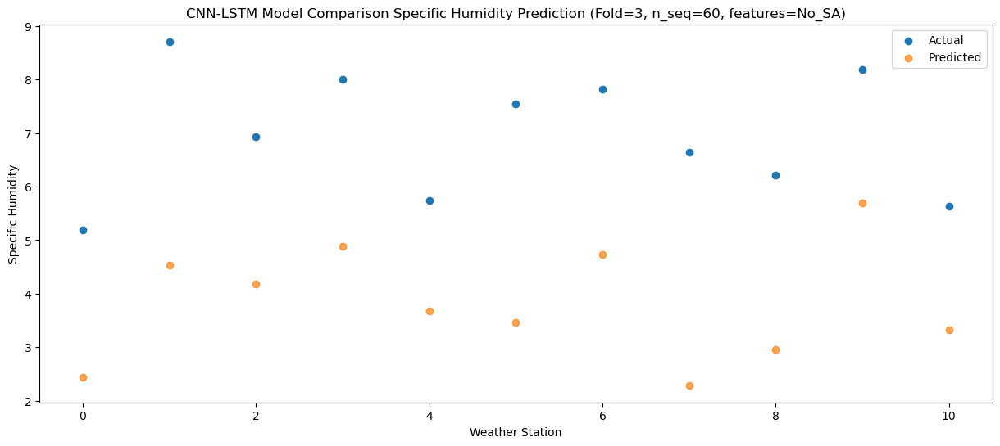

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    0.96  -2.344227
1                 1    4.25  -0.132574
2                 2    5.76   3.002793
3                 3    2.85   0.213718
4                 4    0.74  -0.847546
5                 5    2.25  -1.147565
6                 6    6.21   2.431632
7                 7    3.91   0.917183
8                 8    4.90   1.884943
9                 9    5.55   1.658106
10               10    2.22  -0.979530


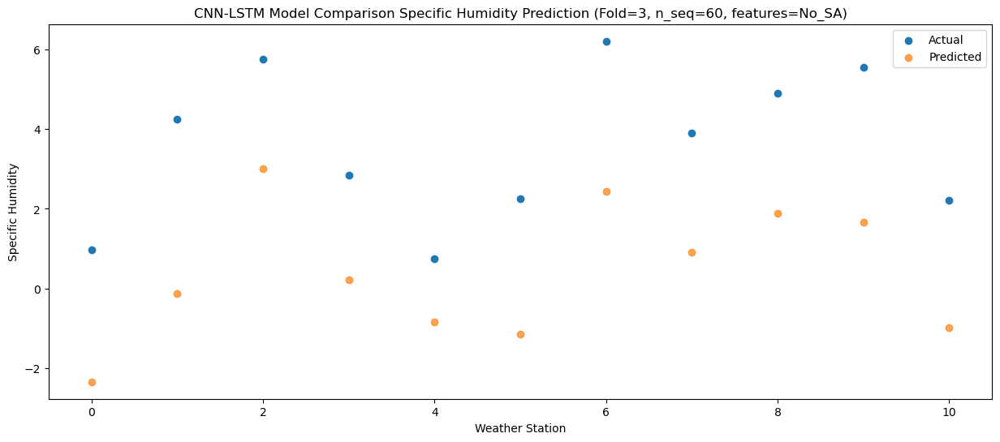

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.51  -3.092584
1                 1    3.22  -1.128914
2                 2    3.04   0.476312
3                 3    2.04  -0.772204
4                 4   -0.65  -1.969211
5                 5    1.03  -2.206513
6                 6    4.55   0.320562
7                 7    2.14  -1.581648
8                 8    2.65  -0.618454
9                 9    3.70   0.351199
10               10    1.00  -2.161507


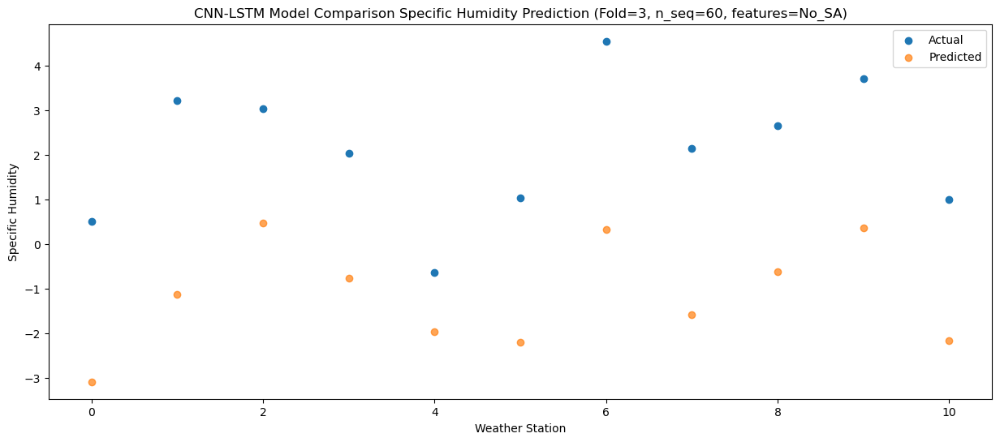

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -4.518326
1                 1    2.03  -2.091822
2                 2    3.88  -0.122299
3                 3    1.01  -2.018993
4                 4   -1.77  -3.141115
5                 5    0.27  -3.411926
6                 6    4.58  -0.370653
7                 7    2.89  -2.162267
8                 8    3.44  -1.261955
9                 9    1.73  -0.823979
10               10   -0.92  -3.366534


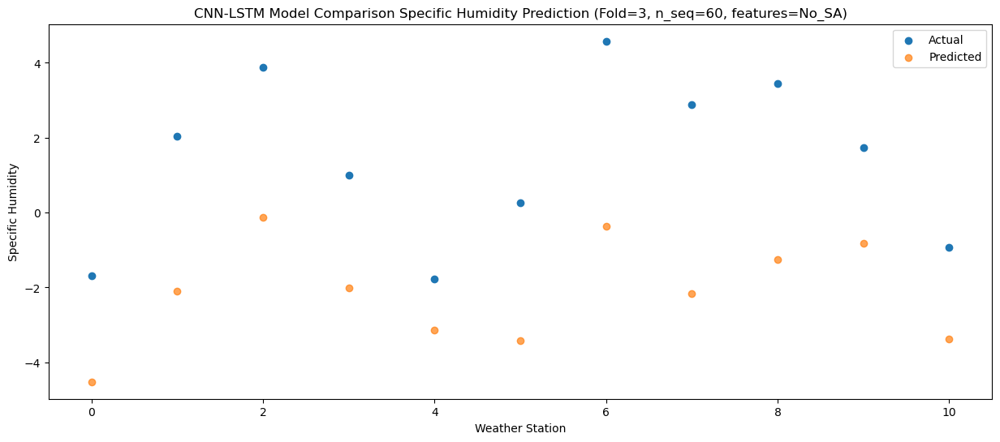

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.78  -4.202182
1                 1    1.95  -2.047270
2                 2    4.03  -0.152270
3                 3    1.55  -1.670084
4                 4   -1.39  -2.803496
5                 5    0.85  -3.064162
6                 6    4.55  -0.351347
7                 7    3.28  -2.203360
8                 8    3.27  -1.288021
9                 9    2.30  -0.399823
10               10   -0.14  -2.955058


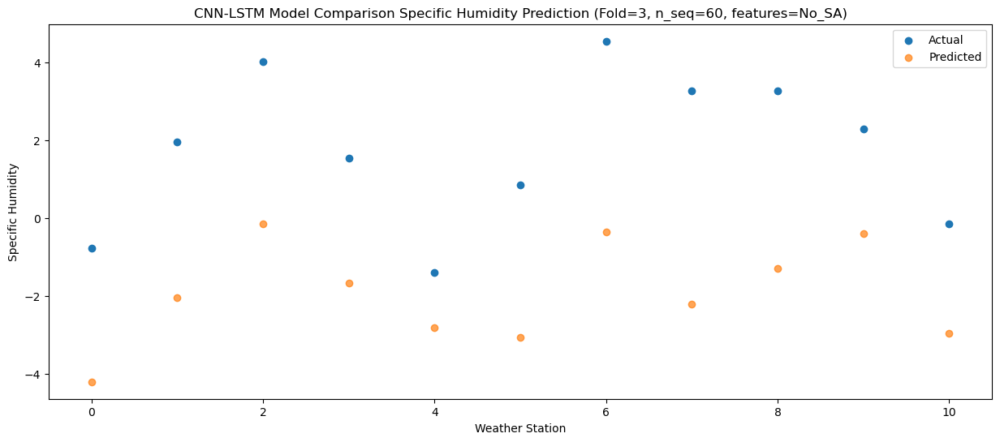

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.05  -4.144972
1                 1    2.11  -2.231101
2                 2    2.90  -0.828961
3                 3    1.37  -2.015853
4                 4   -0.51  -3.265368
5                 5    0.52  -3.490077
6                 6    4.17  -0.958138
7                 7    2.03  -2.899274
8                 8    2.41  -1.875009
9                 9    1.59  -1.020697
10               10   -0.89  -3.499879


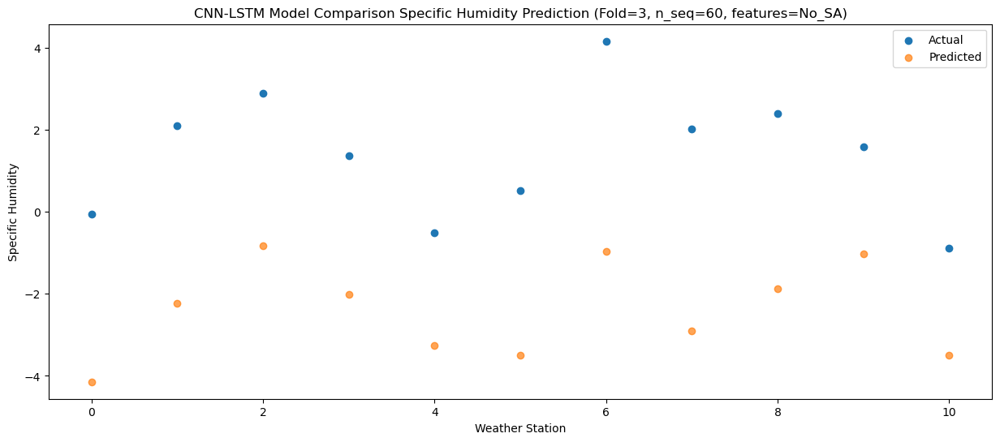

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.44  -4.426787
1                 1    3.05  -1.883608
2                 2    4.42  -0.687783
3                 3    1.24  -2.134483
4                 4   -0.84  -3.271825
5                 5    0.95  -3.547479
6                 6    4.47  -0.702367
7                 7    3.07  -2.671149
8                 8    3.21  -1.832861
9                 9    1.80  -1.213105
10               10   -0.76  -3.667980


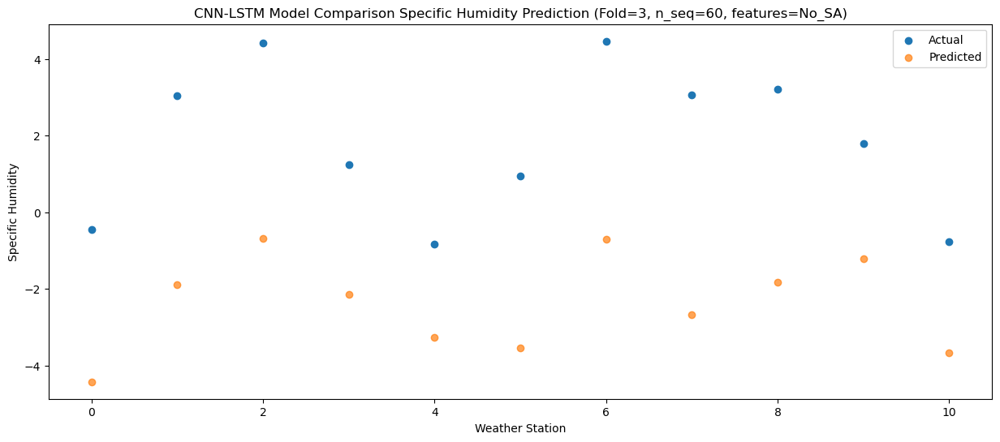

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.55  -2.964433
1                 1    3.92  -0.840959
2                 2    4.62   0.119674
3                 3    2.78  -0.682572
4                 4    0.39  -1.859027
5                 5    2.26  -2.109430
6                 6    5.10   0.183493
7                 7    2.22  -1.880813
8                 8    3.59  -1.007165
9                 9    4.04   0.308828
10               10    1.67  -2.158771


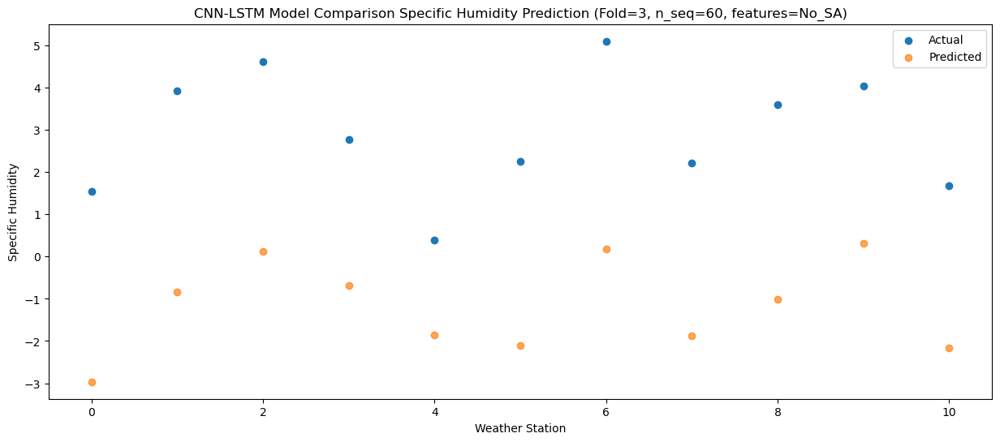

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    3.00  -0.931329
1                 1    8.33   2.312848
2                 2    5.56   2.731343
3                 3    5.69   1.500010
4                 4    3.57   0.500429
5                 5    4.86   0.161910
6                 6    7.26   3.065043
7                 7    3.76   0.911498
8                 8    5.18   1.421886
9                 9    4.56   2.194111
10               10    2.14  -0.171415


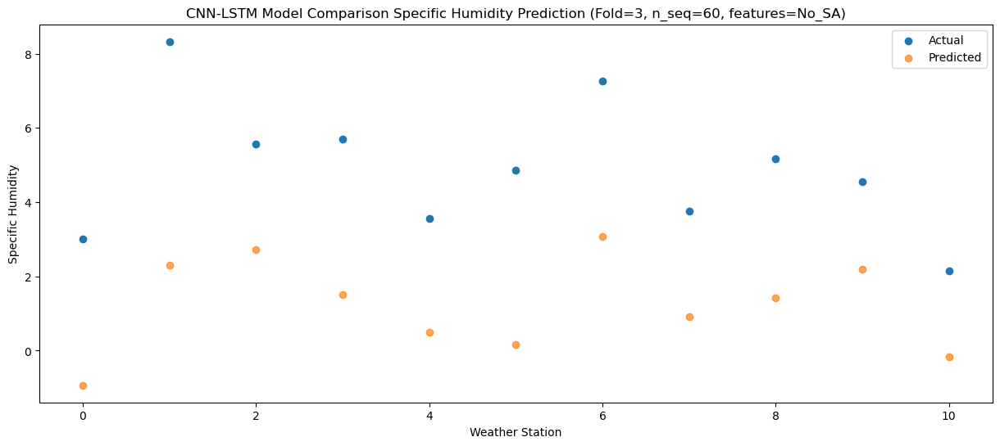

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.27   1.348251
1                 1   10.97   4.491154
2                 2    6.33   3.248121
3                 3    7.71   3.777816
4                 4    5.70   2.712735
5                 5    7.02   2.415372
6                 6    7.49   4.097057
7                 7    4.26   1.491927
8                 8    5.24   1.895872
9                 9    8.26   4.267181
10               10    5.83   2.001702


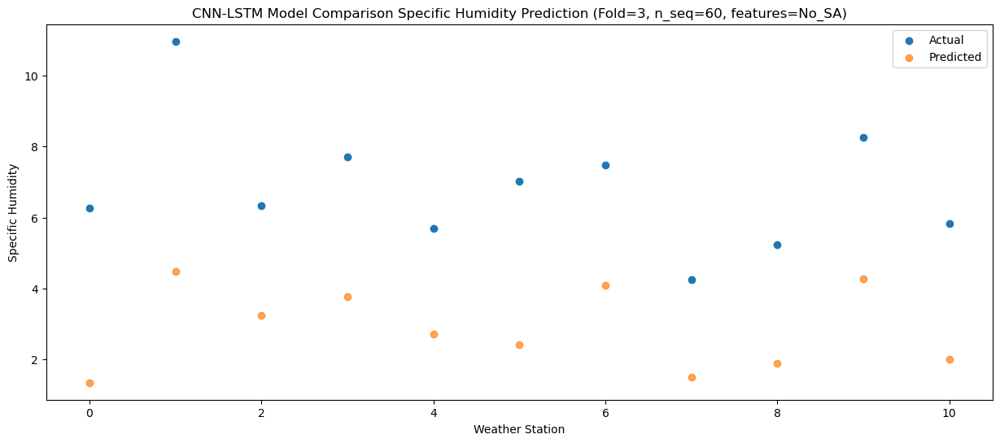

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.22   4.549077
1                 1   13.24   6.574410
2                 2    7.43   3.397701
3                 3   11.36   6.979305
4                 4    9.47   5.737684
5                 5   11.53   5.549902
6                 6    8.33   4.909651
7                 7    5.23   1.666784
8                 8    6.08   2.030228
9                 9   13.11   7.366610
10               10    9.81   5.194962


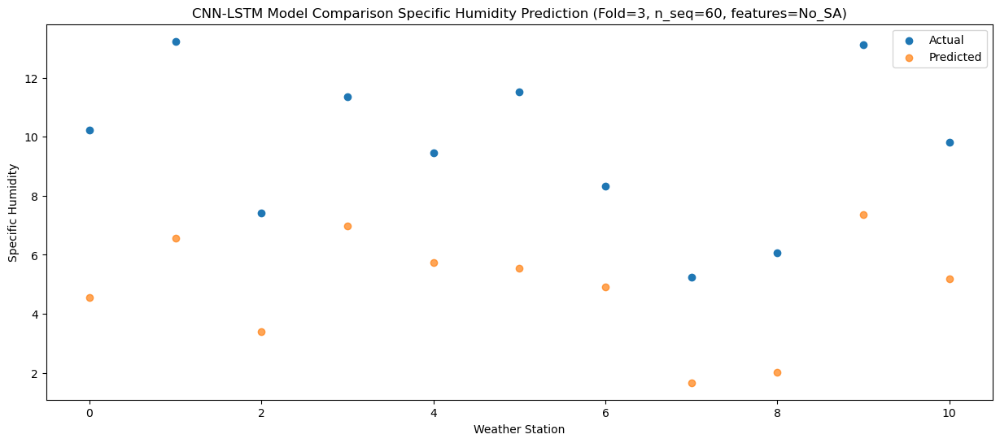

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.32   4.339966
1                 1   13.48   6.382603
2                 2    8.50   4.046343
3                 3   10.81   6.628226
4                 4    9.86   5.438622
5                 5   10.65   5.210383
6                 6    9.98   5.316212
7                 7    7.81   2.296335
8                 8    7.35   2.713561
9                 9   10.54   7.048747
10               10    8.57   4.838432


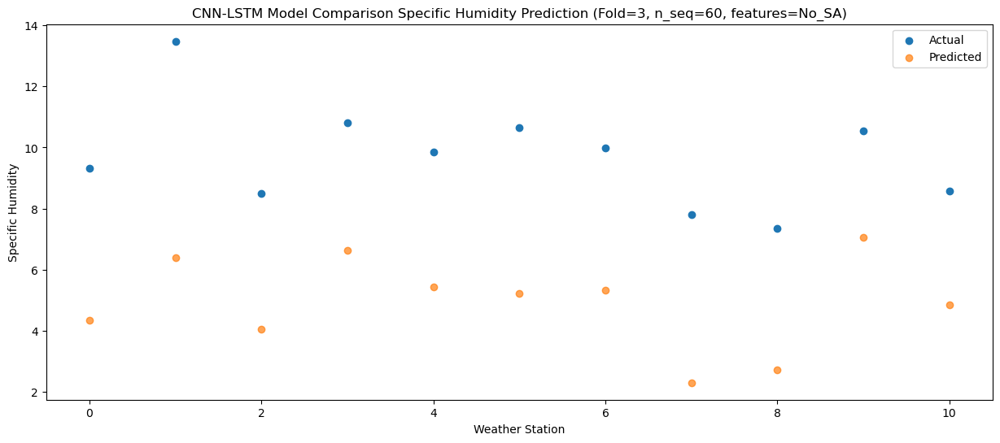

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    6.41   1.805138
1                 1    9.41   4.094061
2                 2    6.96   2.988254
3                 3    8.34   4.297607
4                 4    5.75   3.152782
5                 5    7.42   2.906675
6                 6    7.36   3.846055
7                 7    6.87   1.161084
8                 8    6.80   1.685169
9                 9    9.57   5.025784
10               10    6.88   2.696975


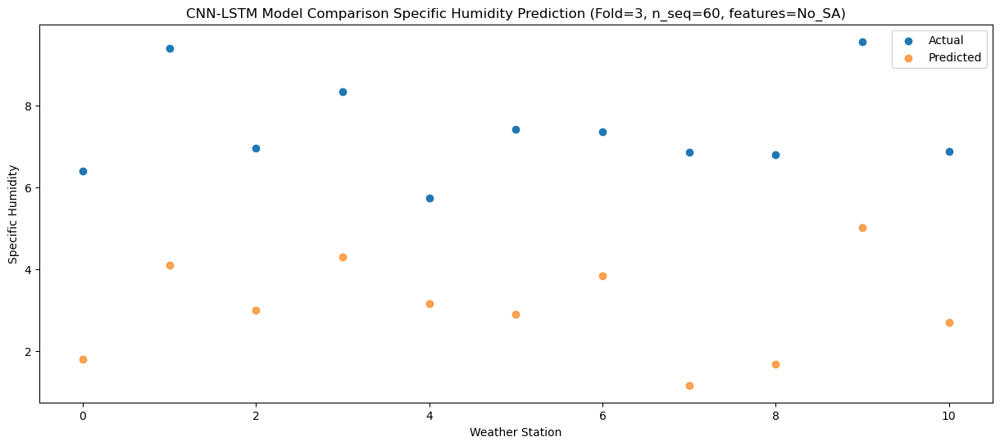

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.30  -2.326778
1                 1    5.97   0.196794
2                 2    5.80   1.235872
3                 3    4.81   0.362455
4                 4    2.13  -0.674066
5                 5    4.04  -0.972136
6                 6    6.11   1.438846
7                 7    3.81  -0.681406
8                 8    5.37  -0.033200
9                 9    6.18   1.492315
10               10    3.61  -0.998962


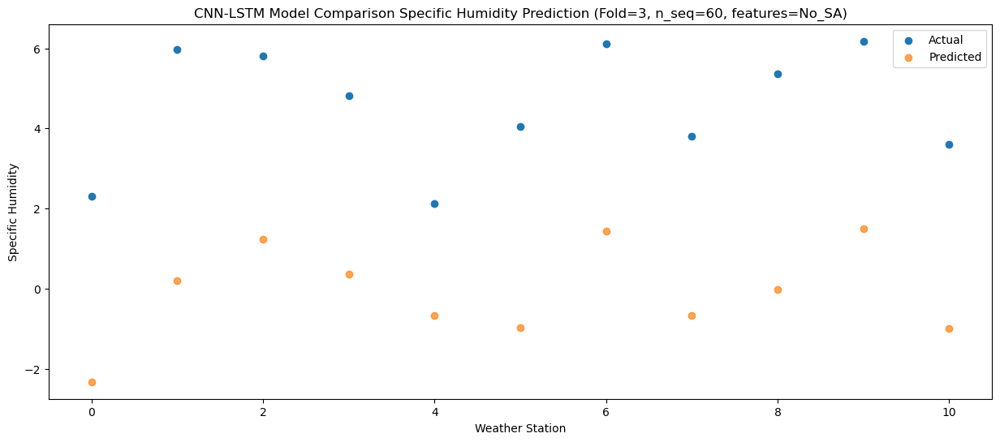

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -5.498028
1                 1    3.09  -2.840872
2                 2    3.69  -0.550740
3                 3    1.42  -2.911661
4                 4   -1.04  -3.900926
5                 5    0.85  -4.237431
6                 6    4.78  -0.776667
7                 7    2.80  -2.530165
8                 8    4.28  -1.748868
9                 9    2.38  -1.667038
10               10   -0.07  -4.234683


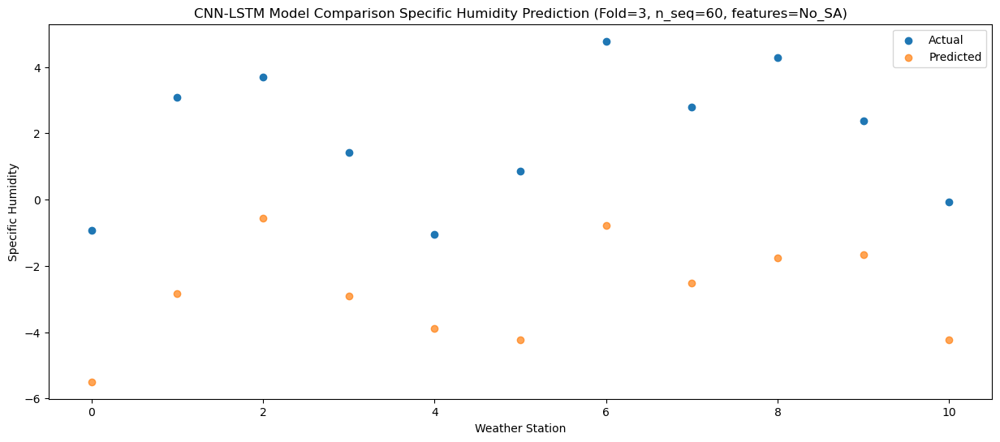

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.94  -5.783429
1                 1    2.27  -3.449896
2                 2    3.92  -0.521599
3                 3    1.44  -2.975540
4                 4   -1.45  -3.883691
5                 5    0.81  -4.245726
6                 6    4.65  -0.846670
7                 7    2.72  -2.516732
8                 8    4.66  -1.753685
9                 9    2.71  -1.389767
10               10    0.31  -4.058890


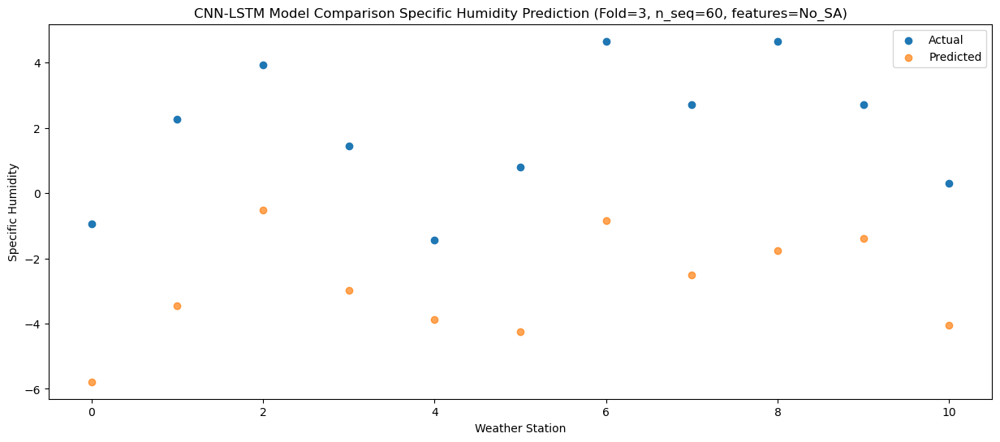

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.59  -6.793864
1                 1    0.96  -4.519120
2                 2    4.46  -1.104560
3                 3    0.70  -4.093767
4                 4   -2.32  -4.997530
5                 5   -0.07  -5.371925
6                 6    4.59  -1.604955
7                 7    3.26  -3.140368
8                 8    4.67  -2.279294
9                 9    1.41  -2.483583
10               10   -0.82  -5.178593


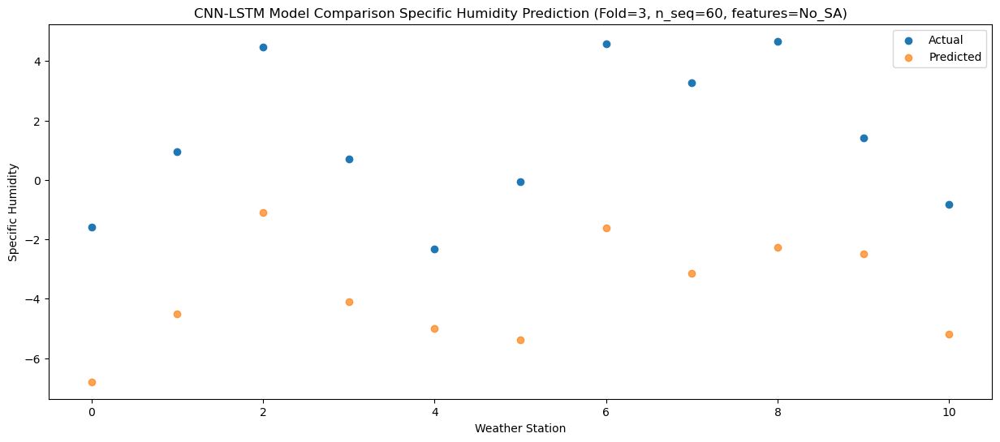

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.53  -6.510593
1                 1    2.38  -3.621628
2                 2    4.63  -1.232475
3                 3    1.02  -3.685536
4                 4   -1.41  -4.560715
5                 5    0.51  -4.942158
6                 6    4.66  -1.404862
7                 7    4.08  -3.174852
8                 8    4.36  -2.498410
9                 9    1.31  -2.290355
10               10   -0.91  -4.897056


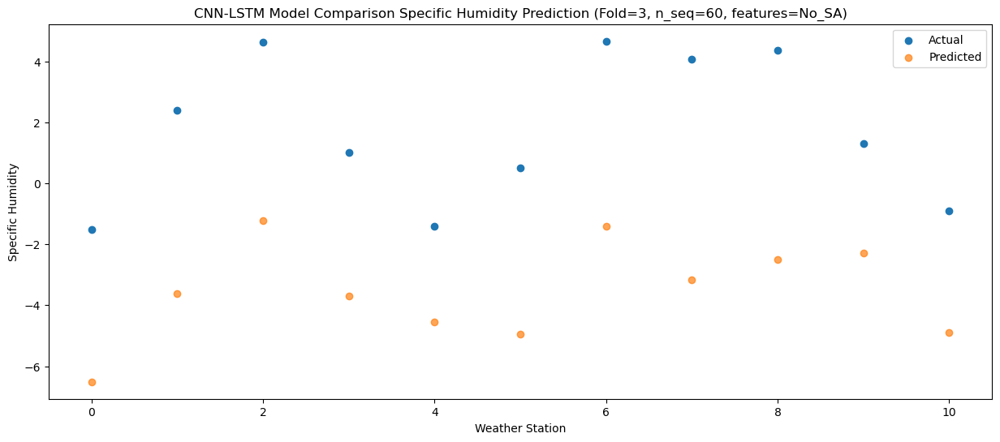

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.03  -5.482685
1                 1    3.80  -2.856533
2                 2    4.34  -1.467558
3                 3    1.98  -2.955771
4                 4   -0.37  -4.010406
5                 5    1.59  -4.315255
6                 6    5.02  -1.441784
7                 7    3.40  -3.445528
8                 8    4.16  -2.638384
9                 9    2.36  -1.805698
10               10    0.14  -4.331633


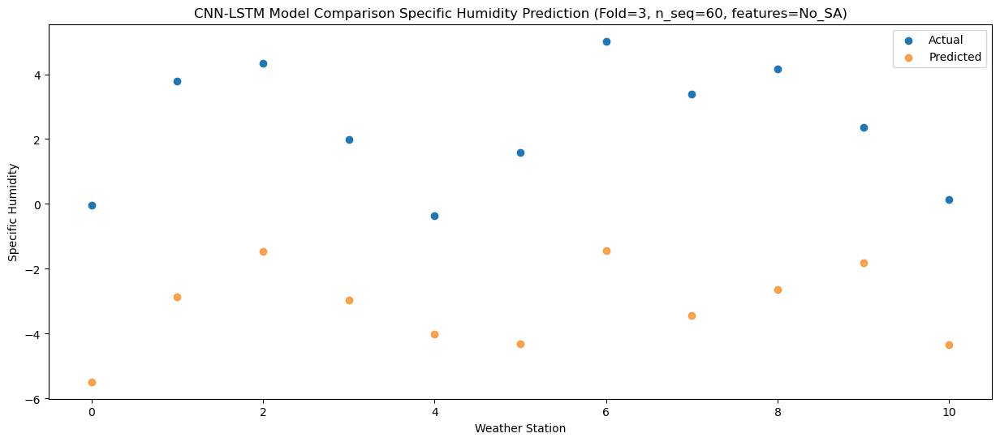

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    2.01  -3.702161
1                 1    5.34  -0.940845
2                 2    5.02  -1.511297
3                 3    3.89  -1.108260
4                 4    1.45  -2.188060
5                 5    3.84  -2.467560
6                 6    5.70  -0.819851
7                 7    3.10  -3.353722
8                 8    4.60  -2.806568
9                 9    3.27  -0.280593
10               10    1.74  -2.655003


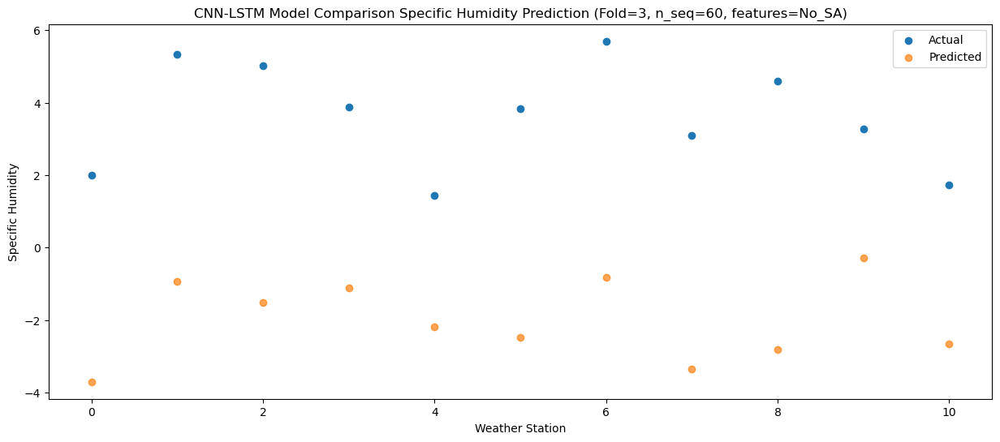

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.88   0.043087
1                 1    9.84   2.550791
2                 2    4.89  -0.189676
3                 3    8.00   2.435100
4                 4    5.59   1.130495
5                 5    7.51   0.962250
6                 6    6.59   1.075656
7                 7    2.97  -2.008089
8                 8    4.76  -1.444166
9                 9    6.73   2.834439
10               10    5.37   0.632755


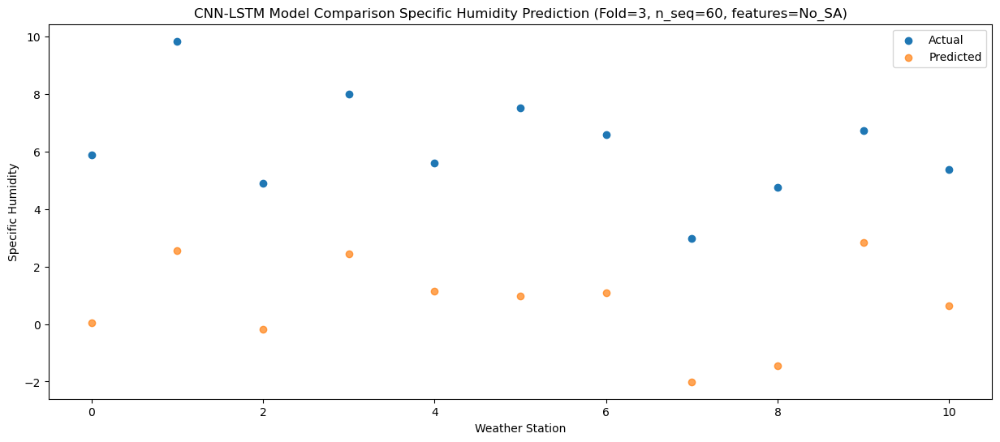

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.61   1.612604
1                 1   12.12   4.560399
2                 2    6.16   1.929009
3                 3    9.80   4.305898
4                 4    7.56   3.277542
5                 5    9.33   2.985567
6                 6    8.88   3.410266
7                 7    4.37   0.295345
8                 8    5.91   0.444031
9                 9    9.60   4.786563
10               10    7.05   2.572676


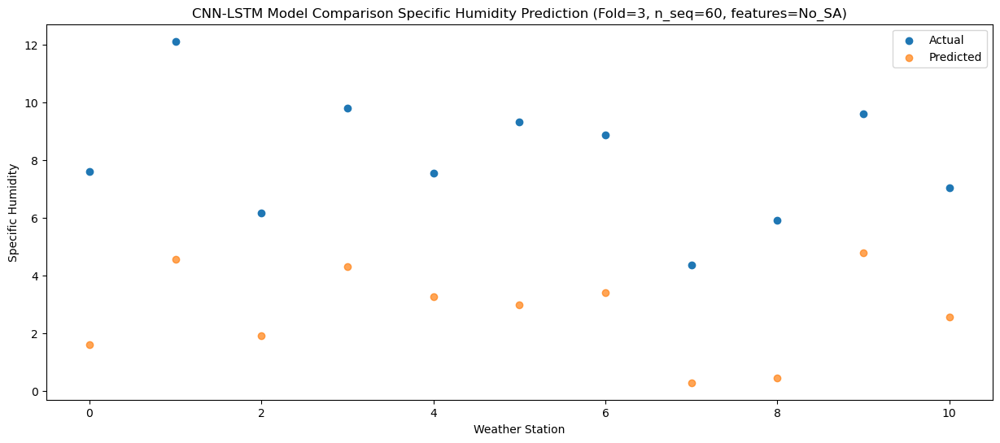

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.47   3.468746
1                 1   12.61   5.536087
2                 2    8.14   2.526727
3                 3   10.70   5.920096
4                 4    9.13   4.720082
5                 5   10.52   4.508421
6                 6    8.93   4.055771
7                 7    5.40   0.800013
8                 8    7.49   1.169625
9                 9   12.77   6.405078
10               10    9.93   4.196016


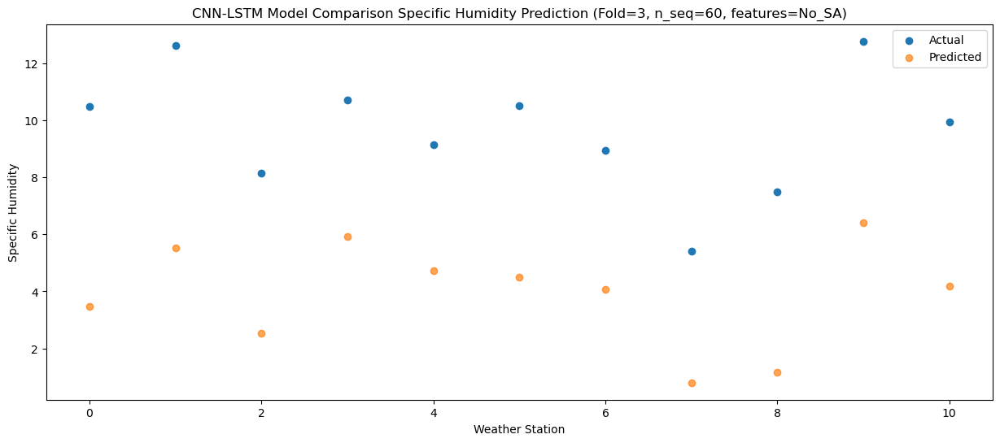

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.03   2.432177
1                 1   11.87   4.871243
2                 2    6.45   2.869829
3                 3    9.38   5.003090
4                 4    8.65   3.965093
5                 5    9.96   3.670530
6                 6   10.39   4.175409
7                 7    6.22   1.177696
8                 8    6.76   1.456375
9                 9   11.42   5.653483
10               10    8.65   3.373746


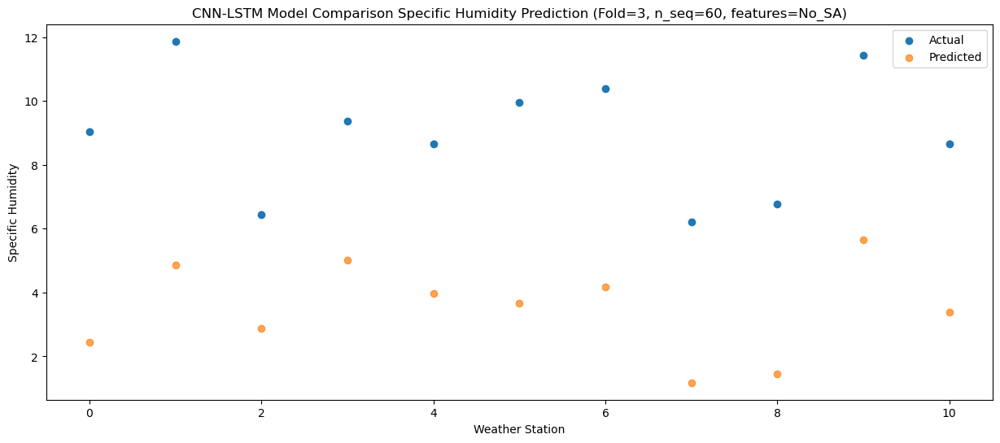

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.32   0.262262
1                 1    8.88   2.265607
2                 2    6.72   1.560523
3                 3    7.84   2.422078
4                 4    5.64   1.204601
5                 5    7.34   0.969014
6                 6    7.97   2.249417
7                 7    4.50  -0.346227
8                 8    6.44   0.411272
9                 9    8.06   3.176134
10               10    5.83   0.810199


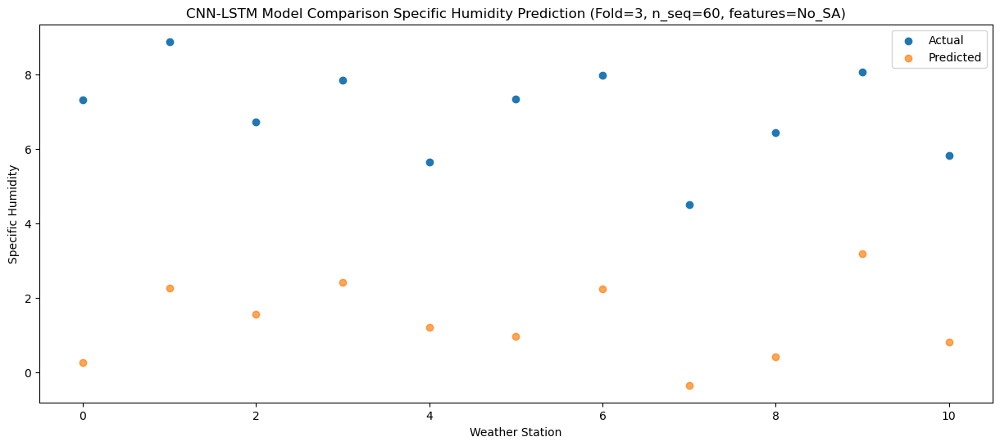

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.50  -3.919776
1                 1    4.65  -1.709069
2                 2    5.61  -0.398822
3                 3    4.09  -1.559666
4                 4    1.28  -2.643506
5                 5    3.47  -2.945284
6                 6    6.21  -0.298089
7                 7    3.45  -2.379311
8                 8    4.85  -1.537410
9                 9    4.96  -0.376138
10               10    1.83  -2.908095


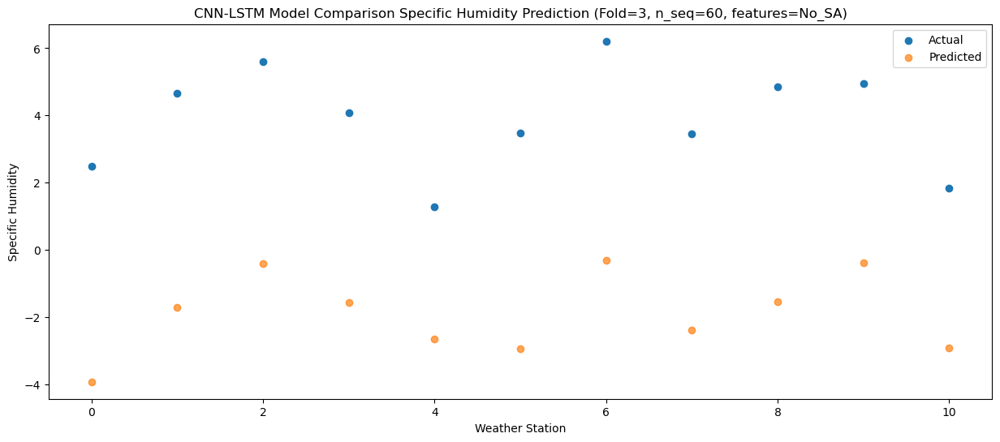

f, t:
[[-1.290e+00  2.240e+00  3.790e+00  1.020e+00  2.490e+00  4.400e-01
   4.780e+00  2.690e+00  3.330e+00  2.250e+00 -5.400e-01]
 [-1.080e+00  1.830e+00  4.330e+00  1.550e+00  9.900e-01  7.300e-01
   4.410e+00  3.680e+00  4.560e+00  1.890e+00 -6.600e-01]
 [-1.030e+00  1.800e+00  3.950e+00  1.150e+00 -1.300e+00  2.300e-01
   4.370e+00  2.560e+00  3.880e+00  1.610e+00 -7.400e-01]
 [-7.000e-01  1.440e+00  3.260e+00  9.700e-01 -2.060e+00 -2.000e-02
   4.330e+00  2.140e+00  2.990e+00  1.690e+00 -7.500e-01]
 [ 1.030e+00  4.040e+00  4.340e+00  2.830e+00  1.000e-02  1.970e+00
   4.960e+00  3.880e+00  3.470e+00  2.180e+00  2.100e-01]
 [ 8.500e-01  4.190e+00  5.710e+00  2.750e+00  3.300e-01  2.090e+00
   5.310e+00  3.690e+00  4.530e+00  2.680e+00  6.400e-01]
 [ 4.070e+00  7.160e+00  5.520e+00  6.180e+00  4.030e+00  5.300e+00
   6.440e+00  2.990e+00  5.390e+00  4.910e+00  3.170e+00]
 [ 7.610e+00  1.069e+01  7.060e+00  9.420e+00  7.120e+00  8.030e+00
   7.500e+00  3.320e+00  5.610e+00  9.020e+0

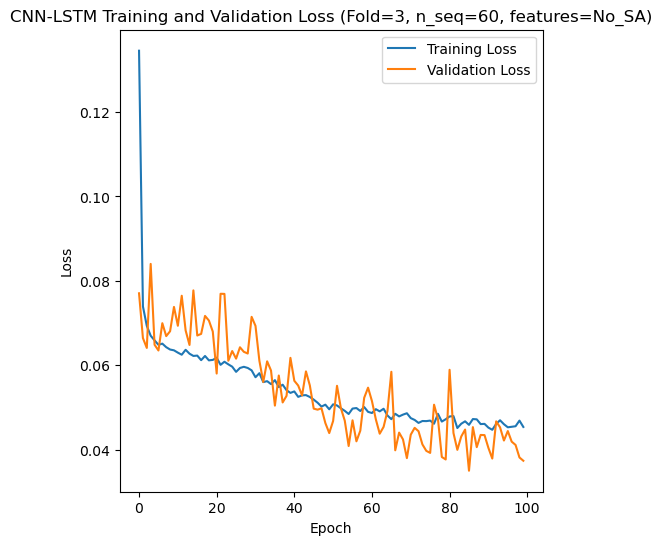

[[ 3.4   2.19  4.28 ... 10.54  6.41  5.39]
 [ 7.94  7.22  7.86 ... 18.27 13.85 11.85]
 [ 5.92  4.91  6.84 ... 14.38  9.59 10.48]
 ...
 [ 3.92  3.    4.93 ... 11.51  7.19  6.46]
 [ 3.98  2.61  4.   ... 10.23  6.65  5.8 ]
 [ 3.84  2.35  4.25 ... 10.6   6.5   5.9 ]]
Epoch 1/100
84/84 [==============================] - 21s 87ms/step - loss: 0.1291 - accuracy: 0.2024 - mae: 0.1094 - rmse: 0.1291 - mape: 23.1920 - pearson: 0.5811 - val_loss: 0.0822 - val_accuracy: 0.0000e+00 - val_mae: 0.0655 - val_rmse: 0.0822 - val_mape: 14.1417 - val_pearson: 0.6993
Epoch 2/100
84/84 [==============================] - 3s 33ms/step - loss: 0.0742 - accuracy: 0.3571 - mae: 0.0584 - rmse: 0.0742 - mape: 13.0489 - pearson: 0.7391 - val_loss: 0.0880 - val_accuracy: 0.7000 - val_mae: 0.0718 - val_rmse: 0.0880 - val_mape: 15.3577 - val_pearson: 0.7176
Epoch 3/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0702 - accuracy: 0.3929 - mae: 0.0552 - rmse: 0.0702 - mape: 12.4889 - pearson: 0.7587 

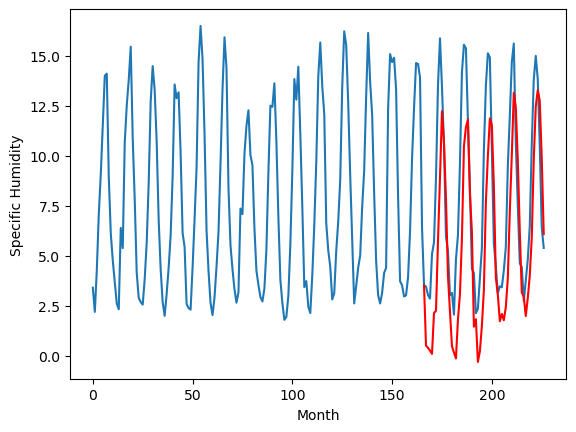

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.88		-0.60		1.28
-1.74		-0.55		1.19
-3.30		-0.69		2.61
-2.46		-0.68		1.78
-1.08		1.77		2.85
0.13		1.56		1.43
0.78		5.00		4.22
4.11		8.25		4.14
5.85		11.35		5.50
6.09		10.25		4.16
5.51		7.51		2.00
3.47		3.77		0.30
0.41		1.43		1.02
-4.33		-0.82		3.51
-3.98		-0.99		2.99
-1.99		-1.03		0.96
-2.02		1.03		3.05
-1.27		2.04		3.31
0.06		5.13		5.07
4.35		9.61		5.26
5.56		10.55		4.99
5.95		10.80		4.85
5.15		7.27		2.12
2.23		5.17		2.94
-2.43		0.07		2.50
-0.69		1.36		2.05
-4.55		-1.53		3.02
-2.97		-0.80		2.17
-1.44		0.46		1.90
-0.15		2.43		2.58
2.24		7.07		4.83
5.14		9.37		4.23
6.17		11.36		5.19
6.25		10.62		4.37
5.38		7.38		2.00
0.60		2.51		1.91
0.77		1.97		1.20
-2.75		0.57		3.32
-3.26		0.93		4.19
-1.32		1.12		2.44
-0.94		1.62		2.56
0.55		3.00		2.45
1.35		6.62		5.27
4.86		9.32		4.46
6.77		12.31		5.54
7.07		11.83		4.76
4.62		8.74		4.12
1.00		4.82		3.82
-1.30		1.87		3.17
-2.39		1.33		3.72
-3.43		0.51		3.9

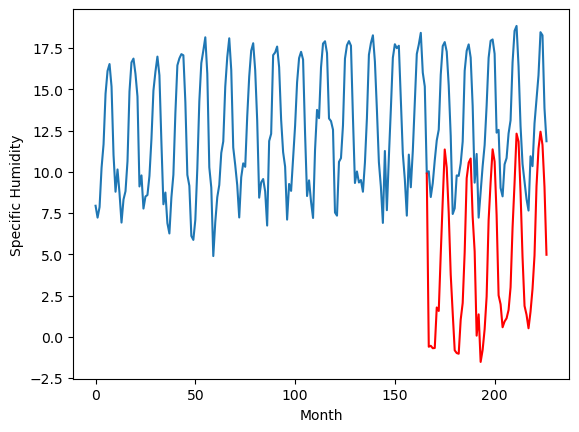

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.90		3.85		0.95
3.74		3.93		0.19
3.60		3.78		0.18
3.41		3.82		0.41
6.96		6.33		-0.63
5.84		6.07		0.23
8.08		9.50		1.42
11.38		12.76		1.38
14.31		15.83		1.52
12.80		14.79		1.99
10.75		12.06		1.31
7.40		8.34		0.94
4.73		5.93		1.20
2.35		3.61		1.26
2.24		3.46		1.22
2.12		3.45		1.33
5.18		5.53		0.35
5.43		6.51		1.08
8.87		9.62		0.75
13.11		14.09		0.98
14.76		15.03		0.27
14.77		15.27		0.50
11.83		11.76		-0.07
9.05		9.63		0.58
3.61		4.48		0.87
6.56		5.89		-0.67
1.83		2.91		1.08
2.68		3.66		0.98
3.73		4.91		1.18
6.18		6.91		0.73
10.78		11.58		0.80
13.16		13.88		0.72
15.00		15.88		0.88
14.82		15.09		0.27
10.58		11.82		1.24
5.62		6.92		1.30
4.87		6.42		1.55
4.33		5.02		0.69
4.23		5.37		1.14
4.90		5.63		0.73
5.23		6.11		0.88
6.07		7.48		1.41
9.45		11.13		1.68
13.02		13.82		0.80
14.61		16.79		2.18
13.03		16.34		3.31
10.01		13.20		3.19
6.08		9.23		3.15
4.10		6.29		2.19
2.79		5.71		2.92
2.07		4.91		2.84


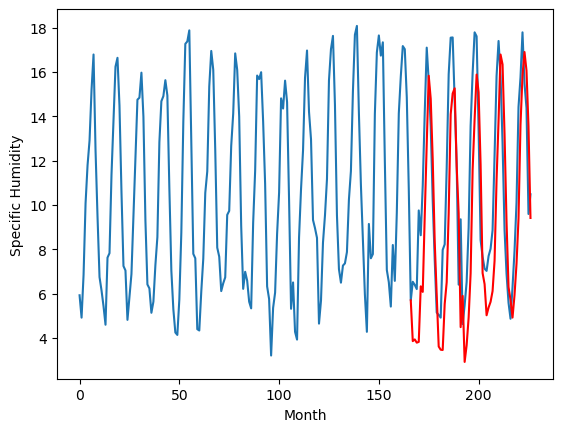

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.20		2.40		-0.80
2.20		2.34		0.14
2.84		2.20		-0.64
2.22		2.08		-0.14
6.17		4.23		-1.94
5.77		4.26		-1.51
8.93		7.74		-1.19
11.09		10.93		-0.16
14.32		14.20		-0.12
11.73		12.78		1.05
10.52		9.97		-0.55
5.95		6.12		0.17
4.31		4.21		-0.10
1.71		2.32		0.61
1.60		2.05		0.45
1.28		1.82		0.54
3.94		3.80		-0.14
5.23		4.99		-0.24
9.23		7.87		-1.36
12.92		12.44		-0.48
13.49		13.40		-0.09
13.88		13.75		-0.13
9.87		10.08		0.21
7.02		8.13		1.11
3.40		3.28		-0.12
5.26		3.89		-1.37
0.60		1.56		0.96
1.13		2.15		1.02
2.72		3.41		0.69
6.23		5.26		-0.97
10.22		9.72		-0.50
11.99		12.02		0.03
11.41		13.94		2.53
12.42		13.49		1.07
9.14		10.42		1.28
4.68		5.74		1.06
4.50		4.96		0.46
2.92		3.62		0.70
2.23		3.98		1.75
2.59		3.80		1.21
4.65		4.42		-0.23
5.33		5.84		0.51
9.59		9.27		-0.32
13.53		12.05		-1.48
13.38		15.14		1.76
11.28		14.47		3.19
10.38		11.72		1.34
6.66		8.05		1.39
4.13		5.02		0.89
2.38		4.73		2.35
1.

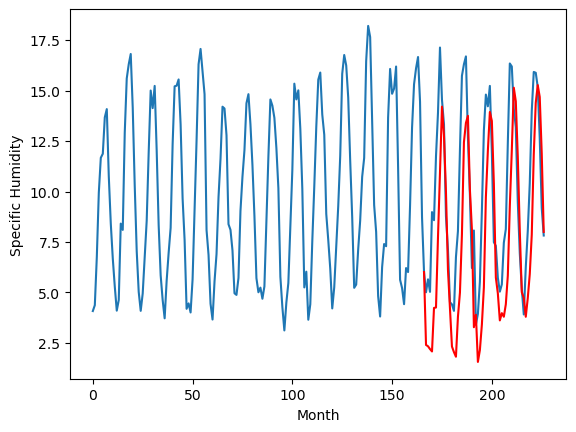

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.29		0.64		-0.65
0.32		0.56		0.24
1.01		0.42		-0.59
0.35		0.28		-0.07
4.25		2.38		-1.87
3.74		2.44		-1.30
6.98		5.93		-1.05
8.96		9.12		0.16
12.11		12.41		0.30
9.46		10.93		1.47
8.57		8.11		-0.46
3.80		4.25		0.45
2.44		2.41		-0.03
-0.13		0.58		0.71
-0.17		0.29		0.46
-0.62		0.03		0.65
1.96		1.99		0.03
3.32		3.22		-0.10
7.61		6.06		-1.55
11.49		10.65		-0.84
11.87		11.61		-0.26
11.98		11.97		-0.01
8.08		8.29		0.21
5.35		6.35		1.00
1.74		1.55		-0.19
3.15		2.05		-1.10
-1.18		-0.19		0.99
-0.74		0.38		1.12
0.78		1.64		0.86
4.46		3.46		-1.00
8.34		7.90		-0.44
10.02		10.20		0.18
9.52		12.10		2.58
10.69		11.71		1.02
7.54		8.66		1.12
3.08		4.01		0.93
2.66		3.19		0.53
1.07		1.86		0.79
0.32		2.22		1.90
0.72		1.98		1.26
2.69		2.61		-0.08
3.54		4.04		0.50
7.81		7.45		-0.36
11.29		10.24		-1.05
10.39		13.34		2.95
9.01		12.64		3.63
8.68		9.95		1.27
5.02		6.32		1.30
2.60		3.27		0.67
0.84		3.03		2.19
-0.58		2.0

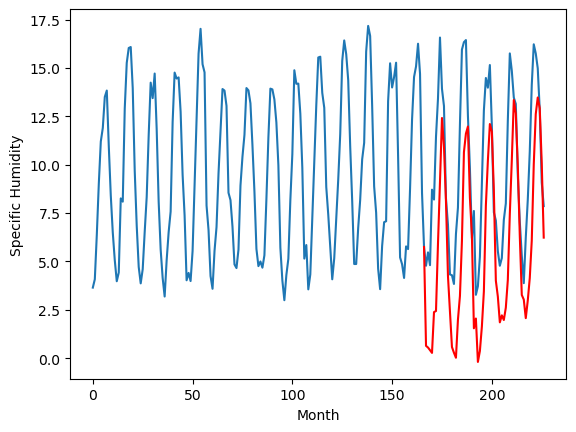

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.63		1.03		-1.60
1.39		0.96		-0.43
1.27		0.82		-0.45
1.15		0.63		-0.52
3.95		2.54		-1.41
3.20		2.79		-0.41
5.47		5.94		0.47
7.18		8.70		1.52
8.41		11.59		3.18
7.10		10.35		3.25
6.91		7.91		1.00
3.26		4.31		1.05
2.80		2.66		-0.14
0.24		1.14		0.90
0.94		0.96		0.02
0.30		0.74		0.44
1.79		2.44		0.65
2.75		3.59		0.84
7.30		6.24		-1.06
9.60		10.35		0.75
10.63		11.34		0.71
10.35		11.50		1.15
7.10		8.21		1.11
4.05		6.31		2.26
2.33		2.49		0.16
1.48		2.57		1.09
0.02		0.82		0.80
0.01		1.14		1.13
0.60		2.40		1.80
2.63		4.00		1.37
4.89		7.81		2.92
7.74		10.17		2.43
8.43		11.89		3.46
10.42		11.69		1.27
9.17		9.07		-0.10
5.66		5.03		-0.63
2.96		3.80		0.84
2.32		2.86		0.54
0.77		3.17		2.40
0.89		2.78		1.89
2.18		3.57		1.39
2.15		4.78		2.63
6.99		8.24		1.25
10.85		10.60		-0.25
8.52		13.26		4.74
7.66		12.86		5.20
8.17		10.47		2.30
6.04		7.22		1.18
3.74		4.45		0.71
2.16		4.30		2.14
0.89		3.51		2.62
1.24		4.37	

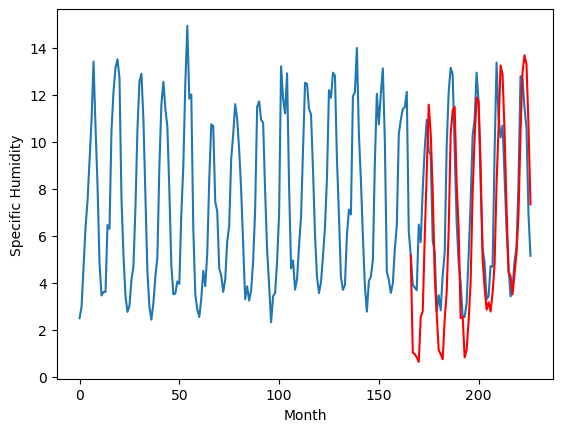

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.97		-1.49		1.48
-2.90		-1.44		1.46
-3.06		-1.59		1.47
-2.48		-1.58		0.90
-0.29		0.86		1.15
-0.96		0.66		1.62
2.16		4.10		1.94
5.99		7.35		1.36
8.58		10.46		1.88
8.79		9.34		0.55
4.95		6.60		1.65
2.30		2.85		0.55
-0.53		0.54		1.07
-3.87		-1.70		2.17
-3.99		-1.87		2.12
-3.74		-1.93		1.81
-2.03		0.13		2.16
-1.62		1.16		2.78
1.36		4.23		2.87
6.05		8.71		2.66
7.65		9.66		2.01
8.03		9.91		1.88
4.45		6.38		1.93
2.24		4.28		2.04
-3.48		-0.81		2.67
-1.62		0.45		2.07
-4.60		-2.41		2.19
-3.28		-1.68		1.60
-2.44		-0.43		2.01
-1.38		1.54		2.92
2.63		6.17		3.54
4.91		8.46		3.55
8.07		10.45		2.38
6.88		9.73		2.85
3.33		6.49		3.16
-1.35		1.64		2.99
-1.53		1.08		2.61
-3.52		-0.31		3.21
-2.89		0.04		2.93
-1.85		0.22		2.07
-2.36		0.73		3.09
-0.76		2.10		2.86
1.46		5.72		4.26
4.51		8.42		3.91
7.90		11.42		3.52
7.44		10.93		3.49
3.99		7.86		3.87
0.08		3.94		3.86
-2.87		0.99		3.86
-3.15		0.47		3.62
-3.93		-0.36

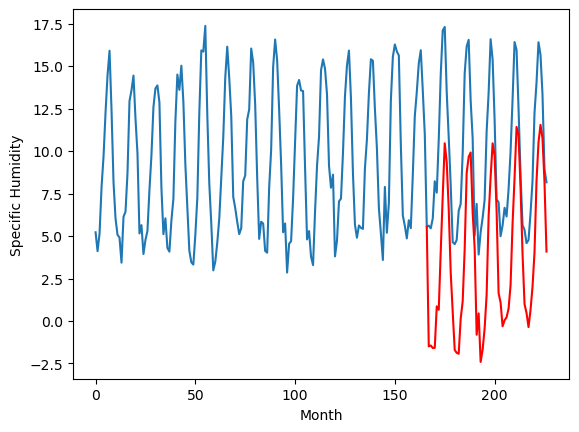

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.81		1.67		-0.14
1.54		1.61		0.07
1.30		1.47		0.17
1.07		1.36		0.29
3.62		3.54		-0.08
3.94		3.54		-0.40
7.32		7.02		-0.30
10.93		10.22		-0.71
12.98		13.48		0.50
10.33		12.08		1.75
8.73		9.27		0.54
4.18		5.43		1.25
2.51		3.49		0.98
0.58		1.58		1.00
0.43		1.31		0.88
-0.20		1.10		1.30
2.17		3.08		0.91
3.09		4.26		1.17
6.25		7.16		0.91
10.85		11.72		0.87
11.80		12.68		0.88
11.54		13.02		1.48
8.28		9.37		1.09
6.19		7.40		1.21
1.50		2.53		1.03
2.97		3.19		0.22
-0.23		0.83		1.06
0.28		1.42		1.14
1.79		2.69		0.90
3.58		4.54		0.96
8.29		9.01		0.72
10.65		11.32		0.67
11.45		13.23		1.78
11.92		12.77		0.85
8.11		9.69		1.58
3.45		4.99		1.54
2.09		4.23		2.14
1.22		2.88		1.66
1.50		3.24		1.74
1.31		3.09		1.78
2.07		3.70		1.63
2.97		5.12		2.15
7.36		8.56		1.20
9.92		11.34		1.42
12.71		14.42		1.71
12.99		13.76		0.77
8.79		10.99		2.20
5.18		7.30		2.12
2.15		4.28		2.13
1.34		3.98		2.64
0.19		3.05		2.86
1.55		3

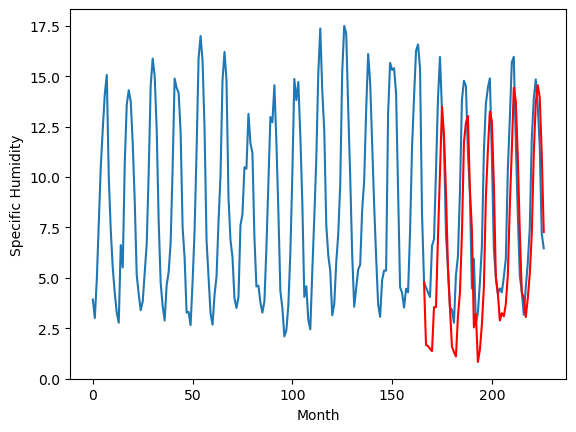

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.40		0.58		0.18
0.57		0.47		-0.10
0.20		0.33		0.13
-0.20		0.17		0.37
1.72		2.21		0.49
2.00		2.32		0.32
5.15		5.81		0.66
7.89		8.99		1.10
11.11		12.32		1.21
9.44		10.77		1.33
6.52		7.94		1.42
3.14		4.06		0.92
1.46		2.30		0.84
-0.14		0.55		0.69
-0.49		0.23		0.72
-1.06		-0.07		0.99
0.88		1.88		1.00
2.21		3.14		0.93
4.50		5.95		1.45
9.56		10.54		0.98
10.82		11.50		0.68
10.96		11.89		0.93
7.48		8.18		0.70
6.33		6.27		-0.06
0.56		1.52		0.96
1.27		1.89		0.62
-1.11		-0.24		0.87
-0.53		0.29		0.82
0.78		1.56		0.78
2.27		3.36		1.09
6.29		7.75		1.46
7.73		10.06		2.33
10.47		11.94		1.47
10.11		11.61		1.50
7.45		8.59		1.14
2.12		3.98		1.86
1.08		3.11		2.03
0.12		1.79		1.67
0.74		2.15		1.41
0.34		1.84		1.50
0.69		2.50		1.81
2.14		3.94		1.80
4.39		7.30		2.91
6.35		10.11		3.76
10.65		13.23		2.58
10.11		12.49		2.38
7.31		9.87		2.56
3.98		6.29		2.31
0.91		3.22		2.31
0.88		3.03		2.15
-0.20		2.05		2.25
0.38		2.9

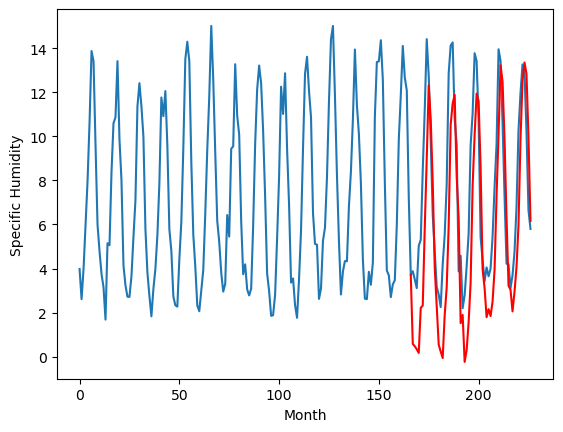

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.95		0.64		-0.31
1.12		0.53		-0.59
0.64		0.39		-0.25
0.37		0.23		-0.14
2.42		2.27		-0.15
3.01		2.38		-0.63
6.73		5.87		-0.86
9.21		9.05		-0.16
12.77		12.38		-0.39
10.58		10.83		0.25
7.80		8.00		0.20
3.64		4.12		0.48
2.55		2.36		-0.19
0.64		0.61		-0.03
0.32		0.29		-0.03
-0.32		-0.01		0.31
2.05		1.94		-0.11
3.36		3.20		-0.16
5.98		6.01		0.03
10.73		10.60		-0.13
12.13		11.56		-0.57
12.38		11.95		-0.43
8.35		8.24		-0.11
6.48		6.33		-0.15
1.19		1.58		0.39
1.73		1.95		0.22
-0.51		-0.18		0.33
0.19		0.35		0.16
1.71		1.62		-0.09
3.01		3.42		0.41
7.08		7.81		0.73
9.32		10.12		0.80
11.96		12.00		0.04
11.19		11.67		0.48
7.82		8.65		0.83
3.06		4.04		0.98
1.69		3.17		1.48
0.58		1.85		1.27
1.10		2.21		1.11
0.87		1.90		1.03
1.48		2.56		1.08
2.99		4.00		1.01
5.77		7.36		1.59
7.41		10.17		2.76
12.11		13.29		1.18
11.98		12.55		0.57
8.20		9.93		1.73
4.76		6.35		1.59
1.37		3.28		1.91
1.86		3.09		1.23
0.40		2.11

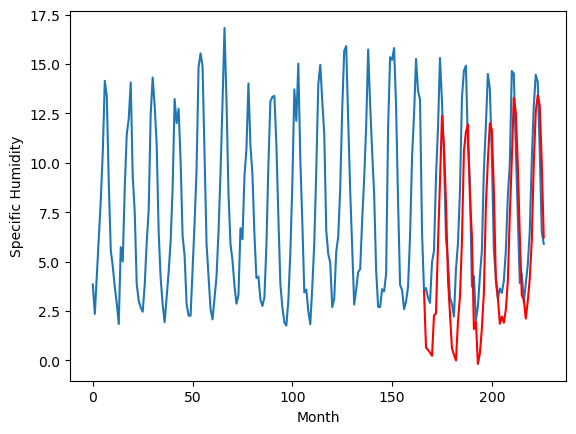

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.15		0.50		0.35
0.30		0.39		0.09
-0.04		0.25		0.29
-0.39		0.09		0.48
1.18		2.13		0.95
1.02		2.24		1.22
3.64		5.73		2.09
6.83		8.91		2.08
9.75		12.24		2.49
8.33		10.69		2.36
6.19		7.86		1.67
3.15		3.98		0.83
1.22		2.22		1.00
-0.11		0.47		0.58
-0.49		0.15		0.64
-1.06		-0.15		0.91
0.23		1.80		1.57
1.90		3.06		1.16
3.50		5.87		2.37
8.51		10.46		1.95
9.78		11.42		1.64
10.65		11.81		1.16
6.89		8.10		1.21
5.88		6.19		0.31
0.64		1.44		0.80
0.60		1.81		1.21
-1.14		-0.32		0.82
-0.69		0.21		0.90
0.46		1.48		1.02
1.45		3.28		1.83
4.91		7.67		2.76
6.82		9.98		3.16
8.55		11.86		3.31
9.01		11.53		2.52
7.02		8.51		1.49
2.20		3.90		1.70
1.48		3.03		1.55
0.03		1.71		1.68
0.65		2.07		1.42
-0.10		1.76		1.86
0.11		2.42		2.31
1.81		3.86		2.05
2.71		7.22		4.51
5.95		10.03		4.08
9.57		13.15		3.58
8.77		12.41		3.64
7.06		9.79		2.73
4.00		6.21		2.21
0.56		3.14		2.58
1.08		2.95		1.87
0.01		1.97		1.96
0.03		2.87		2.84

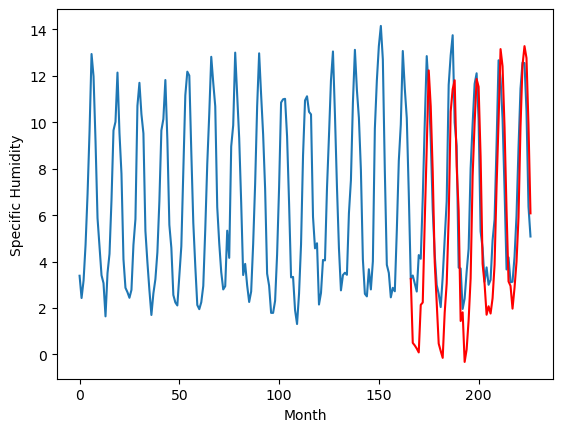

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.95   0.499166
1                 1   -1.88  -0.604629
2                 2    2.90   3.850156
3                 3    3.20   2.402182
4                 4    1.29   0.642242
5                 5    2.63   1.028388
6                 6   -2.97  -1.491607
7                 7    1.81   1.669912
8                 8    0.40   0.578258
9                 9    0.95   0.638258
10               10    0.15   0.498258


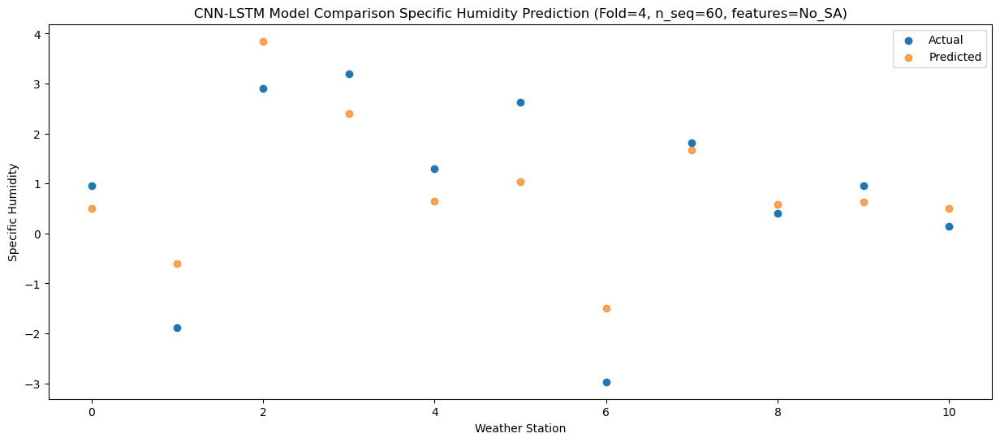

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.88   0.389065
1                 1   -1.74  -0.548978
2                 2    3.74   3.927588
3                 3    2.20   2.335474
4                 4    0.32   0.555058
5                 5    1.39   0.960129
6                 6   -2.90  -1.441807
7                 7    1.54   1.611302
8                 8    0.57   0.468120
9                 9    1.12   0.528120
10               10    0.30   0.388120


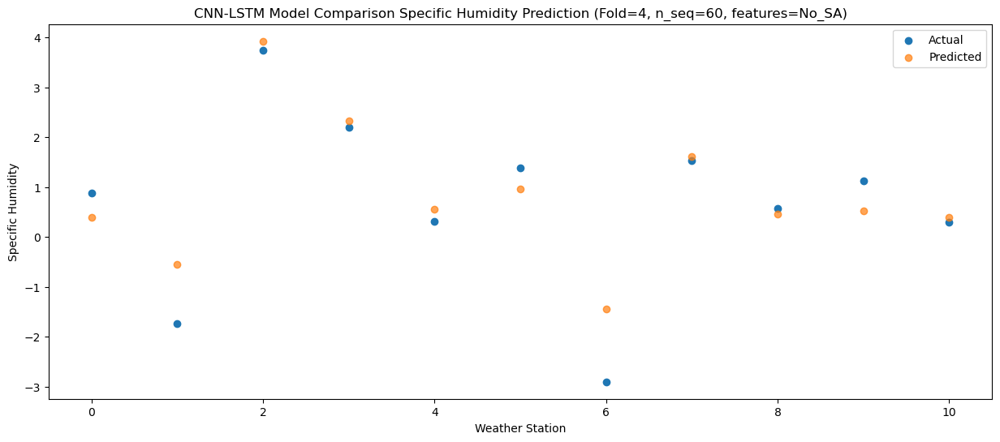

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.46   0.252868
1                 1   -3.30  -0.694064
2                 2    3.60   3.780919
3                 3    2.84   2.197081
4                 4    1.01   0.417863
5                 5    1.27   0.823357
6                 6   -3.06  -1.586660
7                 7    1.30   1.472535
8                 8    0.20   0.332133
9                 9    0.64   0.392133
10               10   -0.04   0.252133


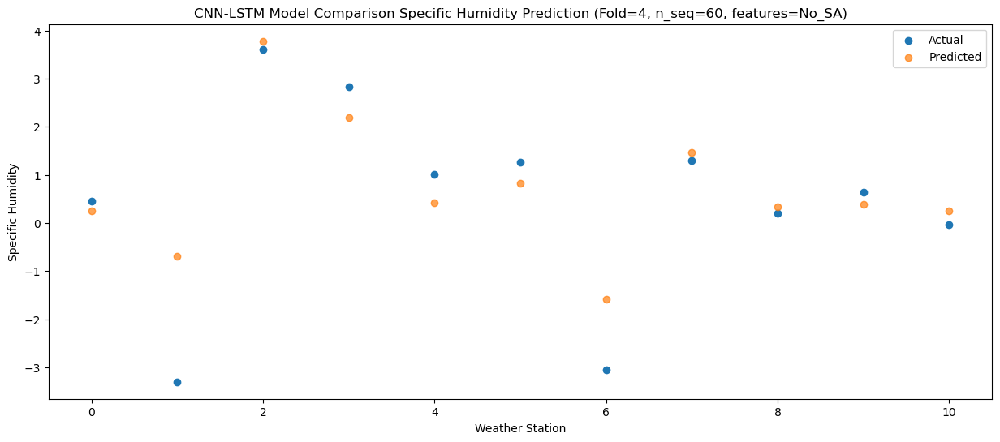

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.28   0.087314
1                 1   -2.46  -0.682536
2                 2    3.41   3.815300
3                 3    2.22   2.078608
4                 4    0.35   0.277730
5                 5    1.15   0.629515
6                 6   -2.48  -1.581288
7                 7    1.07   1.362604
8                 8   -0.20   0.166494
9                 9    0.37   0.226494
10               10   -0.39   0.086494


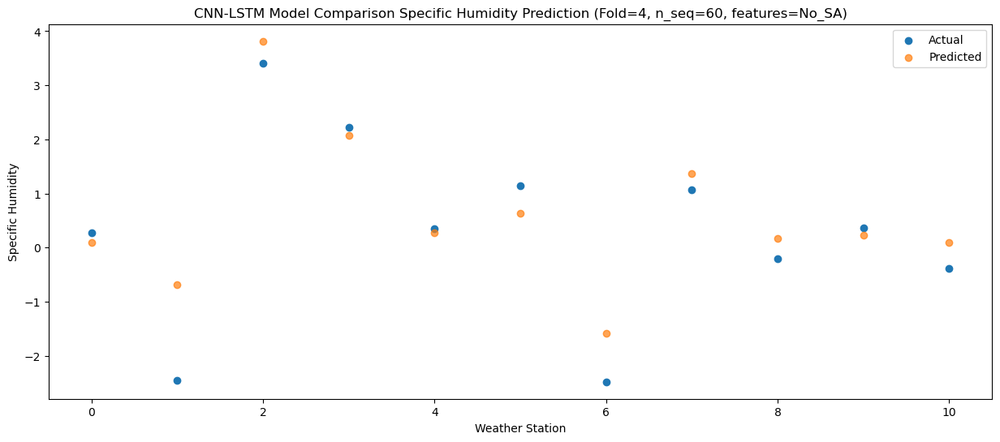

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    2.51   2.134960
1                 1   -1.08   1.774952
2                 2    6.96   6.325410
3                 3    6.17   4.235000
4                 4    4.25   2.383505
5                 5    3.95   2.542959
6                 6   -0.29   0.861640
7                 7    3.62   3.538831
8                 8    1.72   2.214406
9                 9    2.42   2.274406
10               10    1.18   2.134406


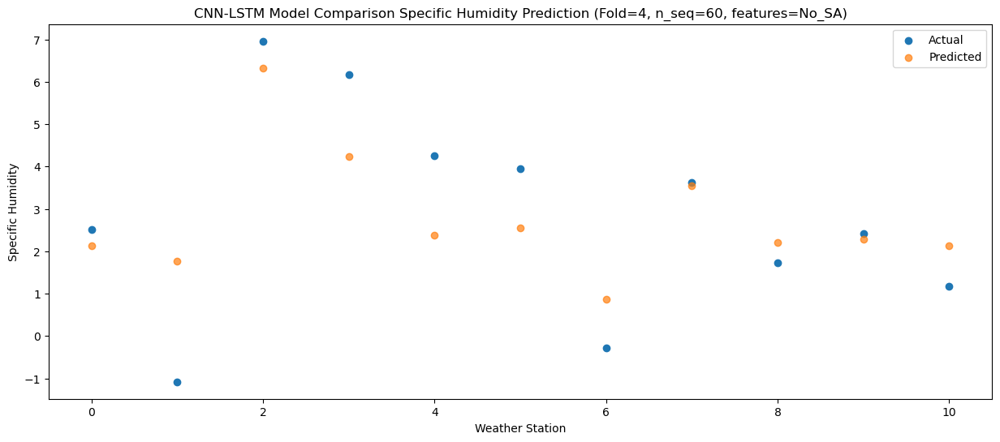

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.10   2.239845
1                 1    0.13   1.562788
2                 2    5.84   6.071954
3                 3    5.77   4.255927
4                 4    3.74   2.442105
5                 5    3.20   2.787695
6                 6   -0.96   0.660762
7                 7    3.94   3.544462
8                 8    2.00   2.318100
9                 9    3.01   2.378100
10               10    1.02   2.238100


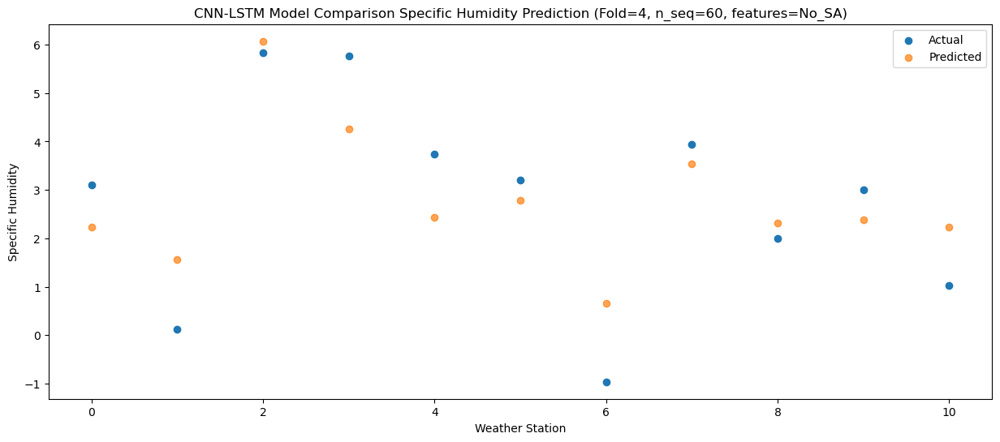

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.31   5.733772
1                 1    0.78   5.003530
2                 2    8.08   9.504806
3                 3    8.93   7.736877
4                 4    6.98   5.928891
5                 5    5.47   5.942557
6                 6    2.16   4.103560
7                 7    7.32   7.022858
8                 8    5.15   5.811601
9                 9    6.73   5.871601
10               10    3.64   5.731601


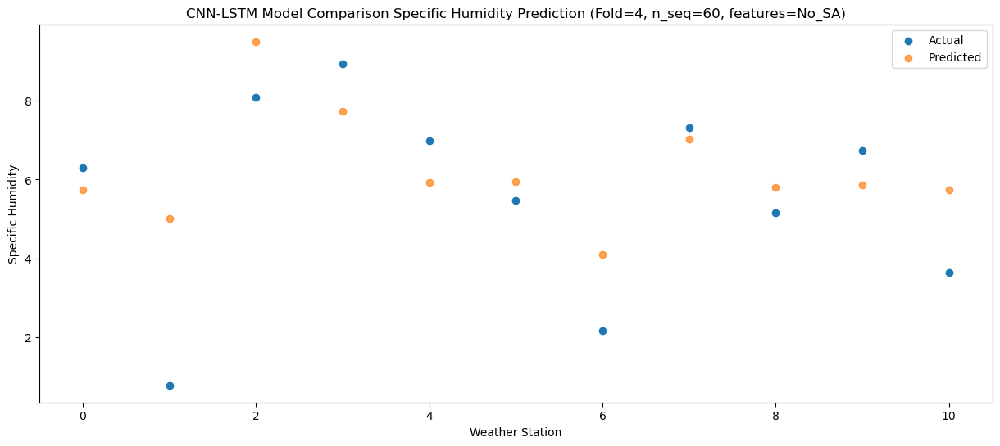

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.96   8.910186
1                 1    4.11   8.252081
2                 2   11.38  12.761831
3                 3   11.09  10.933588
4                 4    8.96   9.116388
5                 5    7.18   8.703462
6                 6    5.99   7.349859
7                 7   10.93  10.223119
8                 8    7.89   8.987874
9                 9    9.21   9.047874
10               10    6.83   8.907874


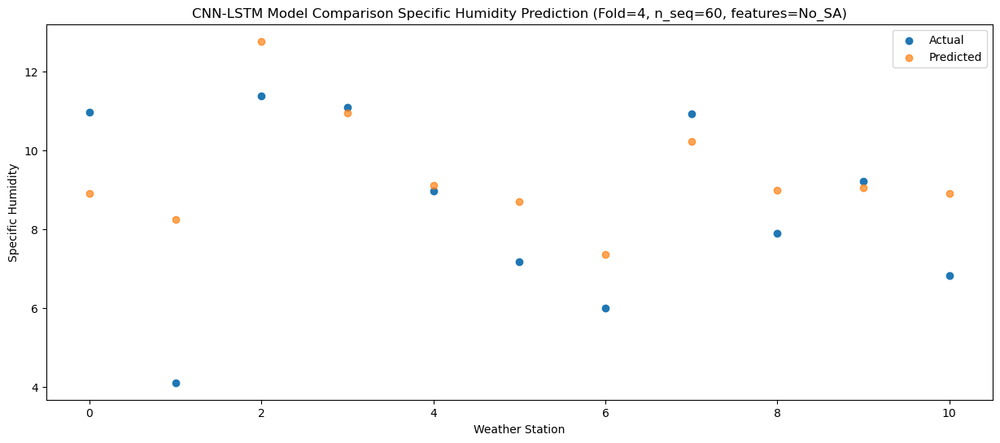

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.31  12.237585
1                 1    5.85  11.350742
2                 2   14.31  15.829041
3                 3   14.32  14.202986
4                 4   12.11  12.413501
5                 5    8.41  11.587597
6                 6    8.58  10.457034
7                 7   12.98  13.481616
8                 8   11.11  12.315113
9                 9   12.77  12.375113
10               10    9.75  12.235113


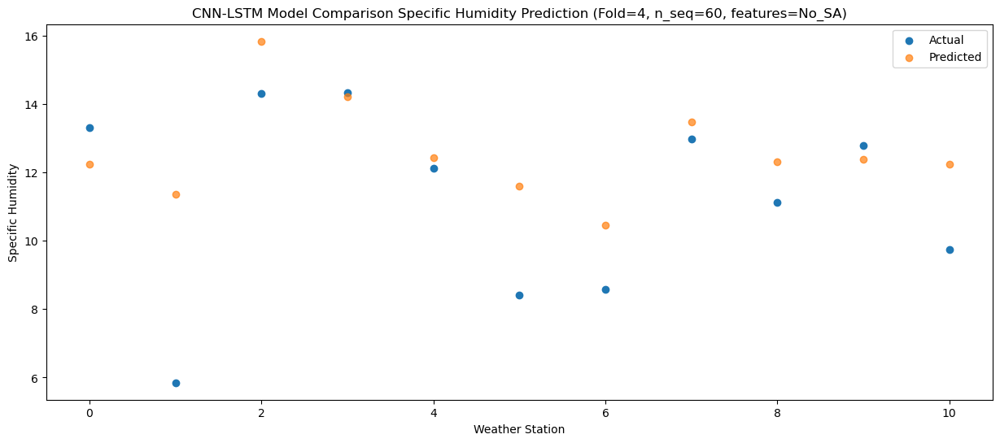

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.88  10.694297
1                 1    6.09  10.252774
2                 2   12.80  14.789736
3                 3   11.73  12.775678
4                 4    9.46  10.932390
5                 5    7.10  10.349372
6                 6    8.79   9.343105
7                 7   10.33  12.075928
8                 8    9.44  10.771824
9                 9   10.58  10.831824
10               10    8.33  10.691824


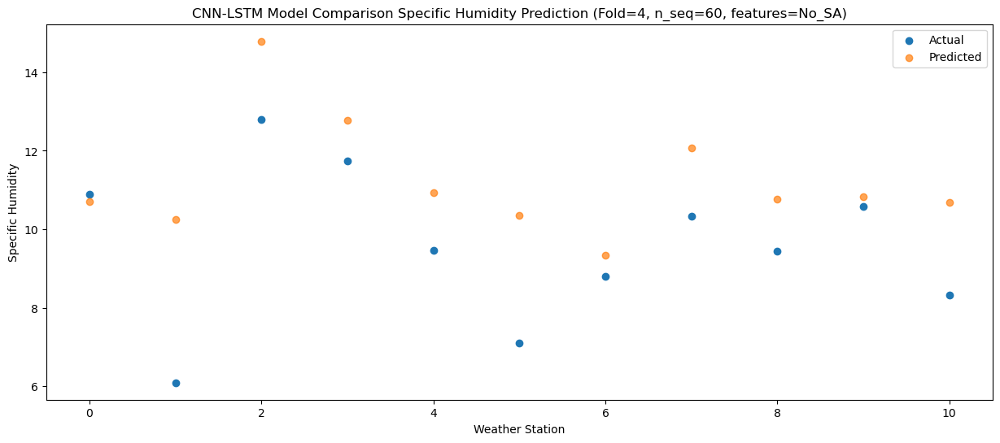

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.99   7.862549
1                 1    5.51   7.510865
2                 2   10.75  12.060255
3                 3   10.52   9.966948
4                 4    8.57   8.112414
5                 5    6.91   7.906075
6                 6    4.95   6.597965
7                 7    8.73   9.271472
8                 8    6.52   7.940426
9                 9    7.80   8.000426
10               10    6.19   7.860426


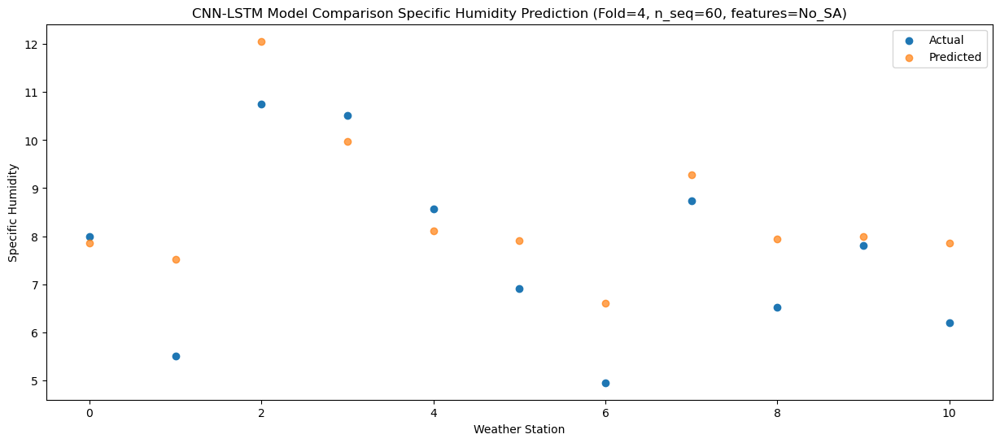

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.40   3.982600
1                 1    3.47   3.771766
2                 2    7.40   8.339895
3                 3    5.95   6.123265
4                 4    3.80   4.251643
5                 5    3.26   4.312800
6                 6    2.30   2.853727
7                 7    4.18   5.434724
8                 8    3.14   4.060193
9                 9    3.64   4.120193
10               10    3.15   3.980193


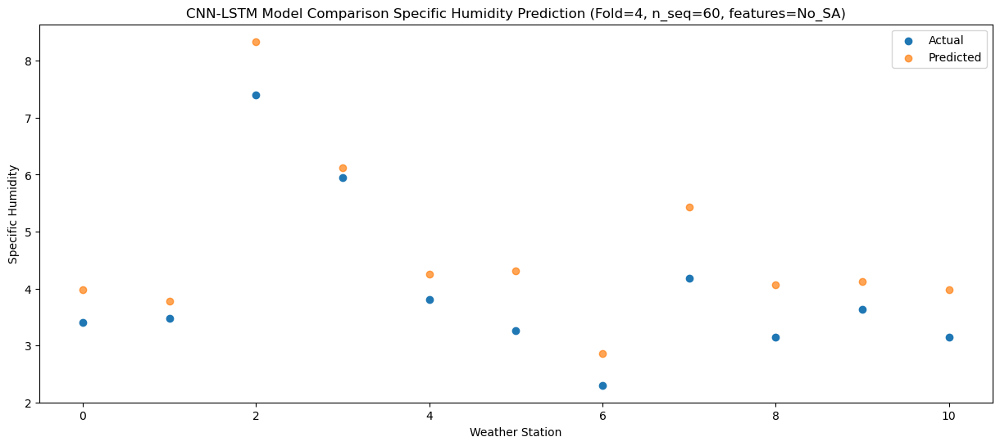

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.68   2.222966
1                 1    0.41   1.434300
2                 2    4.73   5.927087
3                 3    4.31   4.210616
4                 4    2.44   2.408670
5                 5    2.80   2.664632
6                 6   -0.53   0.536473
7                 7    2.51   3.494188
8                 8    1.46   2.299289
9                 9    2.55   2.359289
10               10    1.22   2.219289


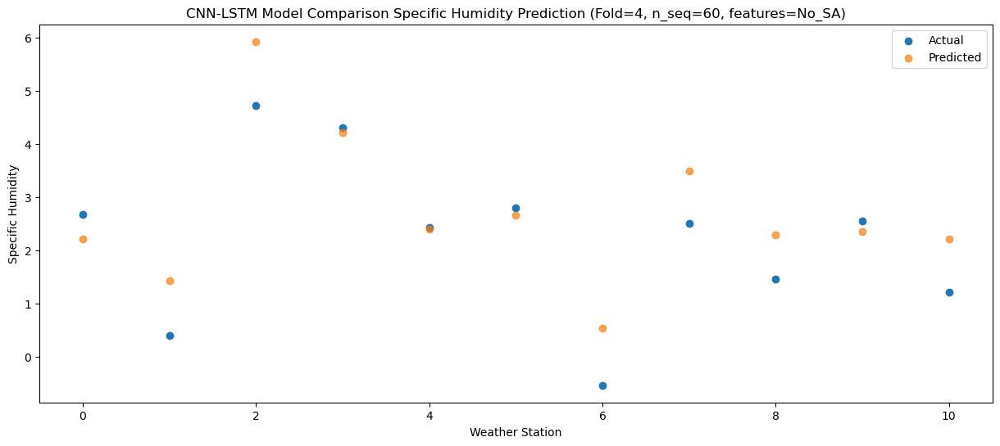

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.45   0.469537
1                 1   -4.33  -0.821698
2                 2    2.35   3.606263
3                 3    1.71   2.323870
4                 4   -0.13   0.581879
5                 5    0.24   1.139315
6                 6   -3.87  -1.701921
7                 7    0.58   1.583119
8                 8   -0.14   0.545113
9                 9    0.64   0.605113
10               10   -0.11   0.465113


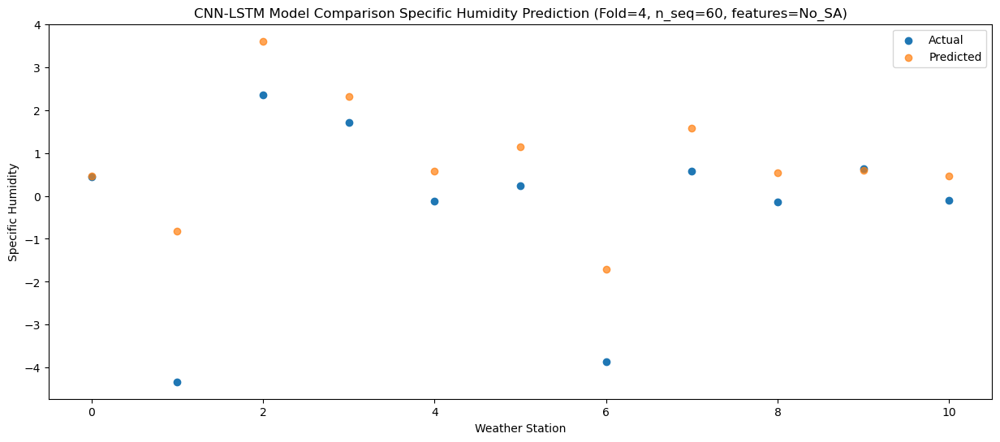

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.57   0.151840
1                 1   -3.98  -0.987524
2                 2    2.24   3.461006
3                 3    1.60   2.045841
4                 4   -0.17   0.285743
5                 5    0.94   0.960646
6                 6   -3.99  -1.873074
7                 7    0.43   1.312504
8                 8   -0.49   0.228355
9                 9    0.32   0.288355
10               10   -0.49   0.148355


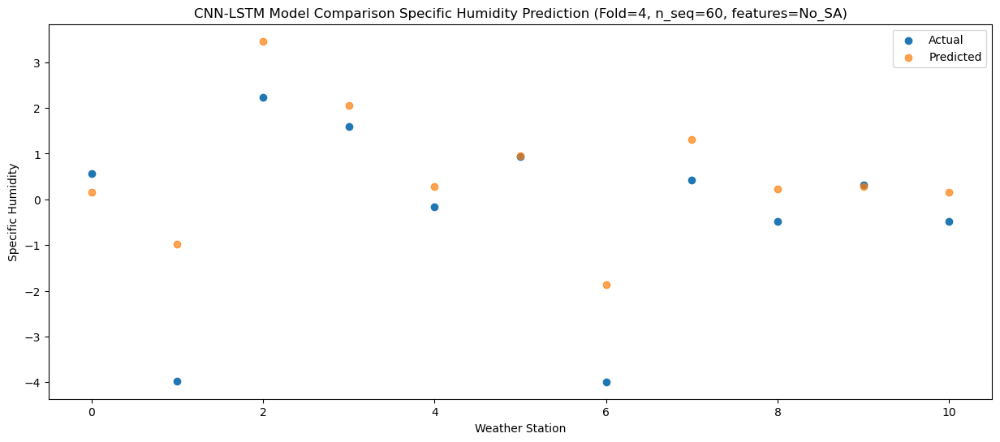

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.52  -0.142057
1                 1   -1.99  -1.030904
2                 2    2.12   3.449901
3                 3    1.28   1.817517
4                 4   -0.62   0.026762
5                 5    0.30   0.741865
6                 6   -3.74  -1.925460
7                 7   -0.20   1.096293
8                 8   -1.06  -0.066247
9                 9   -0.32  -0.006247
10               10   -1.06  -0.146247


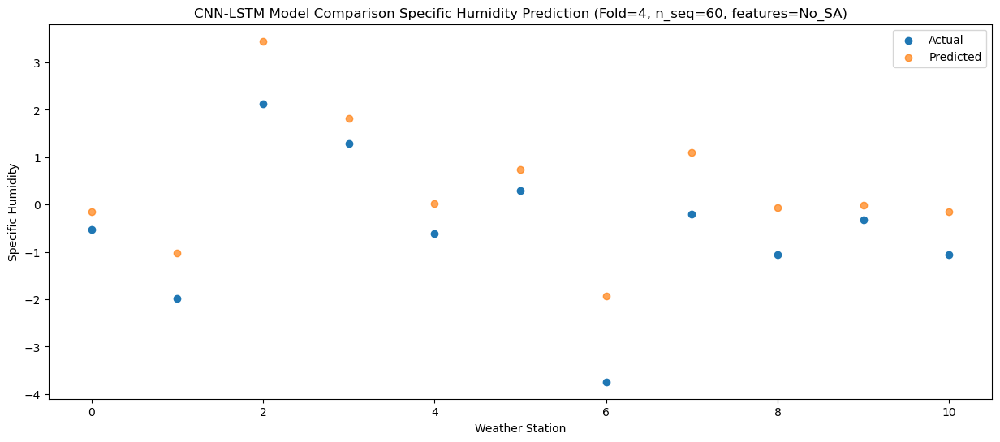

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.24   1.807558
1                 1   -2.02   1.031236
2                 2    5.18   5.526015
3                 3    3.94   3.797698
4                 4    1.96   1.992896
5                 5    1.79   2.438842
6                 6   -2.03   0.132912
7                 7    2.17   3.081893
8                 8    0.88   1.883244
9                 9    2.05   1.943244
10               10    0.23   1.803244


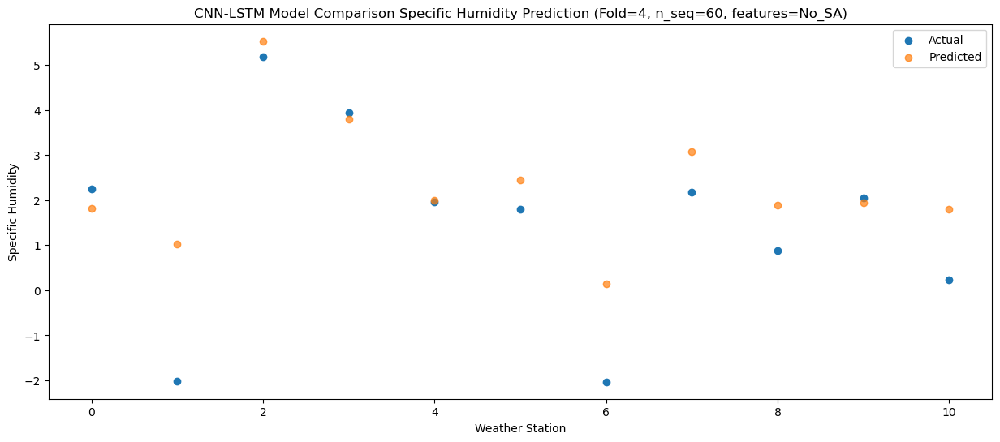

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.45   3.063792
1                 1   -1.27   2.044645
2                 2    5.43   6.507537
3                 3    5.23   4.990972
4                 4    3.32   3.216019
5                 5    2.75   3.590125
6                 6   -1.62   1.155281
7                 7    3.09   4.263646
8                 8    2.21   3.139592
9                 9    3.36   3.199592
10               10    1.90   3.059592


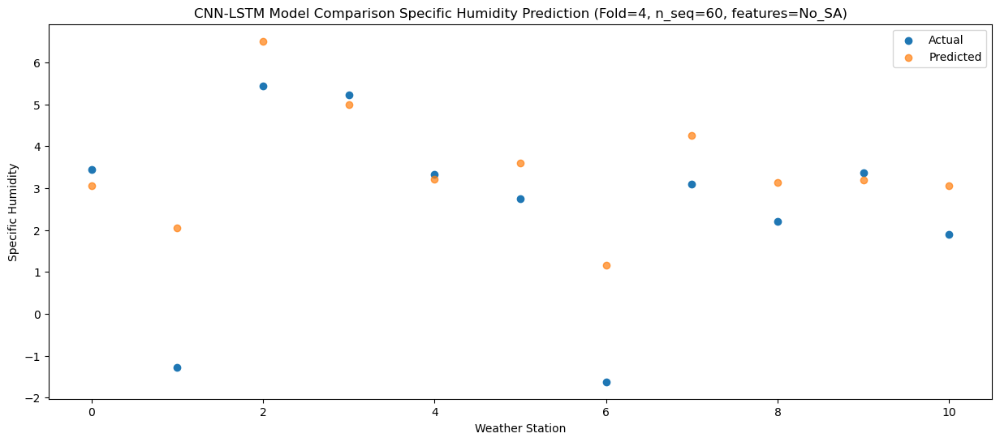

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.01   5.871771
1                 1    0.06   5.126127
2                 2    8.87   9.624141
3                 3    9.23   7.871253
4                 4    7.61   6.063668
5                 5    7.30   6.235201
6                 6    1.36   4.227169
7                 7    6.25   7.157137
8                 8    4.50   5.947117
9                 9    5.98   6.007117
10               10    3.50   5.867117


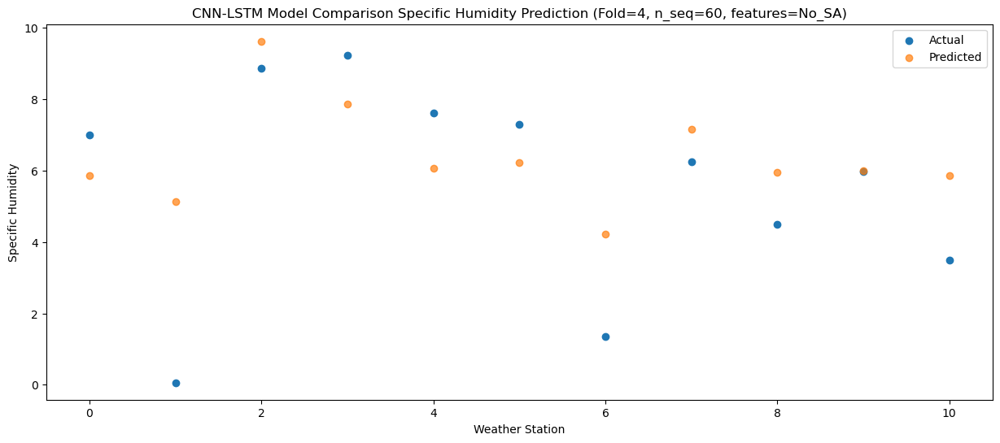

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.60  10.468871
1                 1    4.35   9.608510
2                 2   13.11  14.090677
3                 3   12.92  12.438949
4                 4   11.49  10.645764
5                 5    9.60  10.346575
6                 6    6.05   8.713975
7                 7   10.85  11.719594
8                 8    9.56  10.543394
9                 9   10.73  10.603394
10               10    8.51  10.463394


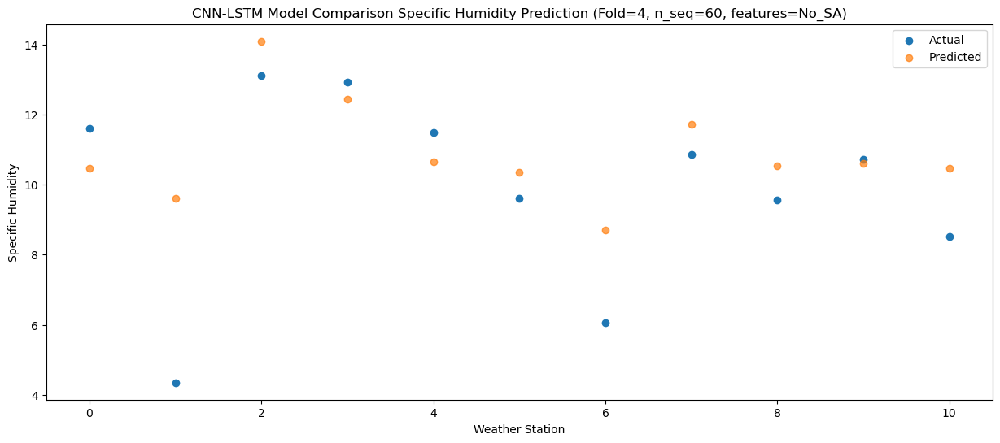

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.99  11.430959
1                 1    5.56  10.550590
2                 2   14.76  15.030101
3                 3   13.49  13.395385
4                 4   11.87  11.605103
5                 5   10.63  11.339403
6                 6    7.65   9.656980
7                 7   11.80  12.675344
8                 8   10.82  11.504733
9                 9   12.13  11.564733
10               10    9.78  11.424733


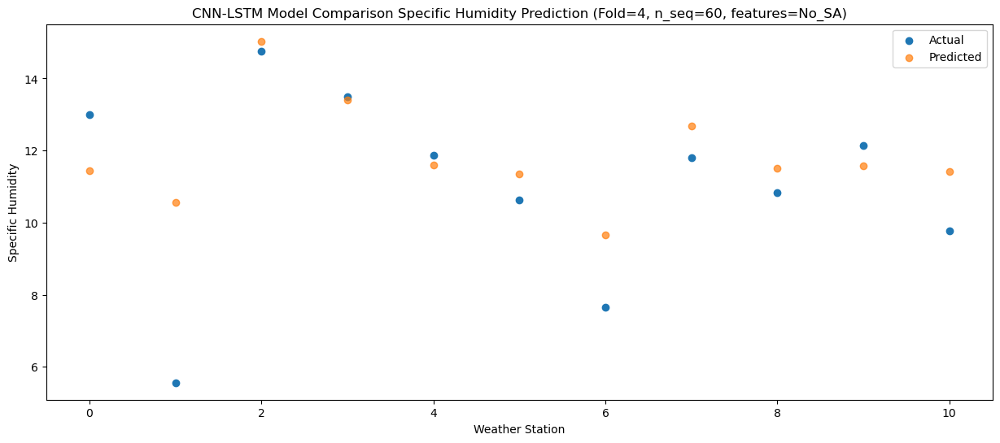

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.81  11.816508
1                 1    5.95  10.803753
2                 2   14.77  15.265055
3                 3   13.88  13.747172
4                 4   11.98  11.972435
5                 5   10.35  11.500119
6                 6    8.03   9.914984
7                 7   11.54  13.020745
8                 8   10.96  11.890037
9                 9   12.38  11.950037
10               10   10.65  11.810037


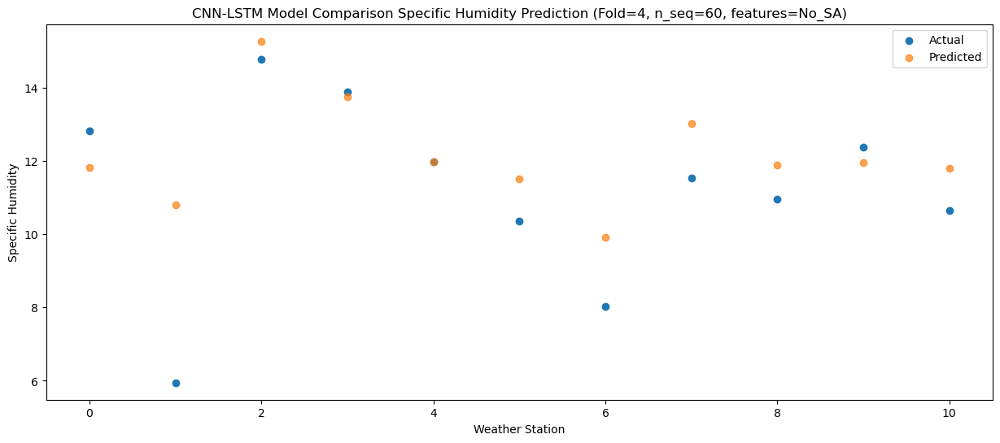

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    9.23   8.107784
1                 1    5.15   7.273584
2                 2   11.83  11.759027
3                 3    9.87  10.084236
4                 4    8.08   8.288247
5                 5    7.10   8.209486
6                 6    4.45   6.378419
7                 7    8.28   9.366474
8                 8    7.48   8.181270
9                 9    8.35   8.241270
10               10    6.89   8.101270


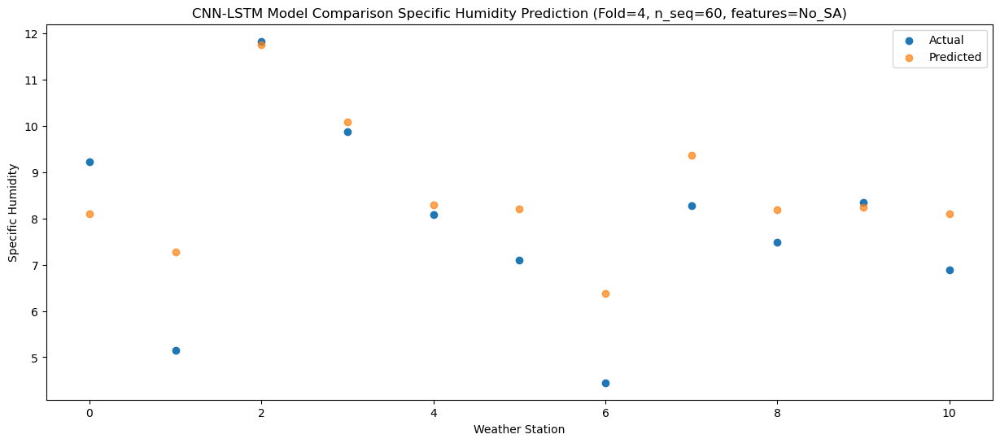

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.86   6.199920
1                 1    2.23   5.169408
2                 2    9.05   9.628952
3                 3    7.02   8.125069
4                 4    5.35   6.353136
5                 5    4.05   6.314336
6                 6    2.24   4.281407
7                 7    6.19   7.397983
8                 8    6.33   6.273352
9                 9    6.48   6.333352
10               10    5.88   6.193352


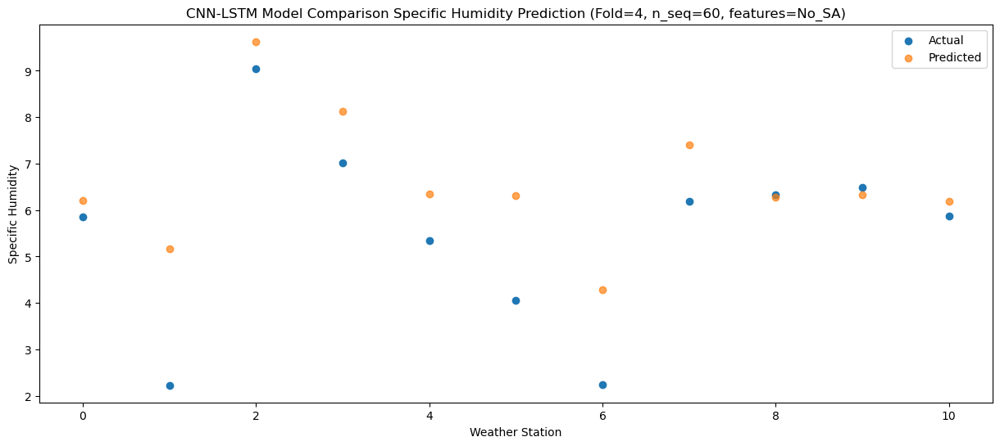

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.77   1.448189
1                 1   -2.43   0.066845
2                 2    3.61   4.481955
3                 3    3.40   3.278828
4                 4    1.74   1.549455
5                 5    2.33   2.494433
6                 6   -3.48  -0.809100
7                 7    1.50   2.534670
8                 8    0.56   1.521411
9                 9    1.19   1.581411
10               10    0.64   1.441411


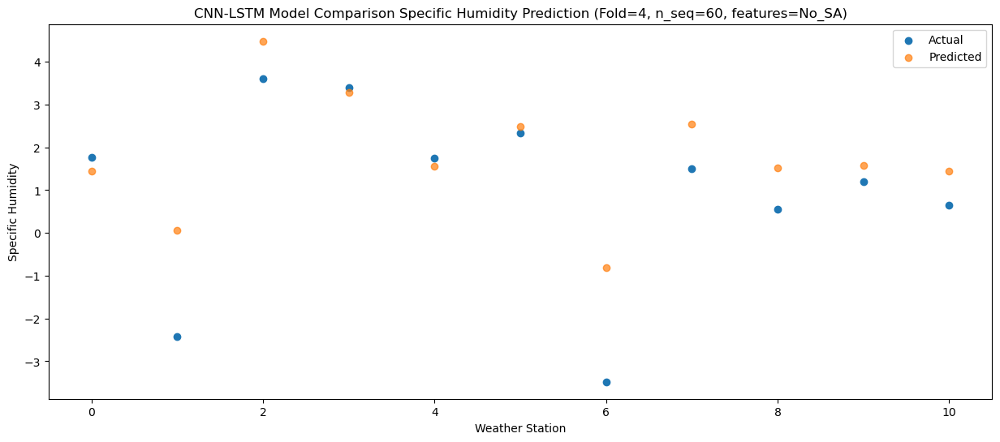

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.56   1.819776
1                 1   -0.69   1.357423
2                 2    6.56   5.891922
3                 3    5.26   3.893214
4                 4    3.15   2.053299
5                 5    1.48   2.566570
6                 6   -1.62   0.449312
7                 7    2.97   3.193555
8                 8    1.27   1.893007
9                 9    1.73   1.953007
10               10    0.60   1.813007


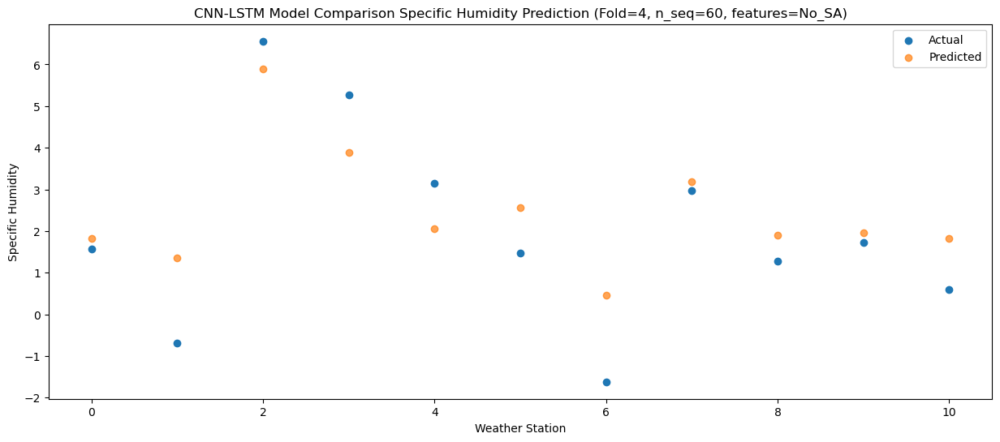

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -0.315751
1                 1   -4.55  -1.525637
2                 2    1.83   2.911265
3                 3    0.60   1.560814
4                 4   -1.18  -0.188506
5                 5    0.02   0.819824
6                 6   -4.60  -2.407572
7                 7   -0.23   0.825215
8                 8   -1.11  -0.242148
9                 9   -0.51  -0.182148
10               10   -1.14  -0.322148


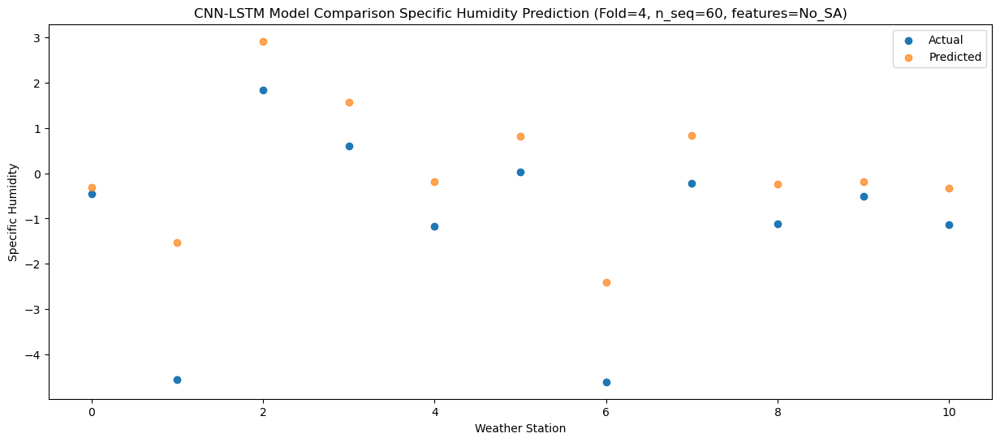

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.23   0.220036
1                 1   -2.97  -0.796173
2                 2    2.68   3.664817
3                 3    1.13   2.148583
4                 4   -0.74   0.375358
5                 5    0.01   1.139892
6                 6   -3.28  -1.684993
7                 7    0.28   1.422354
8                 8   -0.53   0.293688
9                 9    0.19   0.353688
10               10   -0.69   0.213688


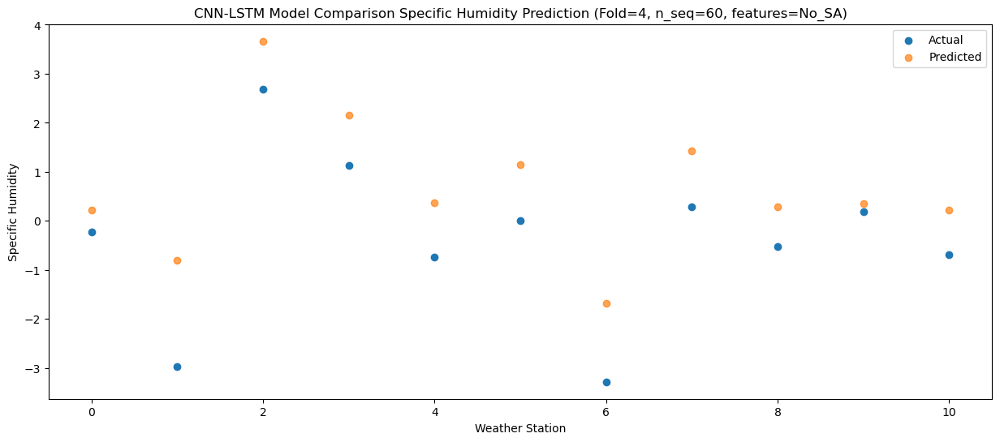

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.33   1.488312
1                 1   -1.44   0.456259
2                 2    3.73   4.914326
3                 3    2.72   3.413065
4                 4    0.78   1.641811
5                 5    0.60   2.396884
6                 6   -2.44  -0.432088
7                 7    1.79   2.686586
8                 8    0.78   1.562459
9                 9    1.71   1.622459
10               10    0.46   1.482459


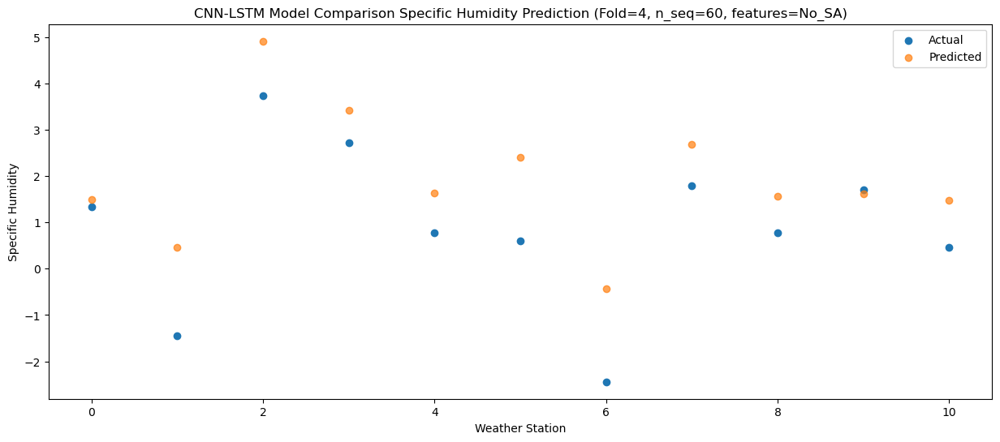

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.82   3.281467
1                 1   -0.15   2.433833
2                 2    6.18   6.914984
3                 3    6.23   5.255624
4                 4    4.46   3.461041
5                 5    2.63   4.003912
6                 6   -1.38   1.538812
7                 7    3.58   4.538067
8                 8    2.27   3.355928
9                 9    3.01   3.415928
10               10    1.45   3.275928


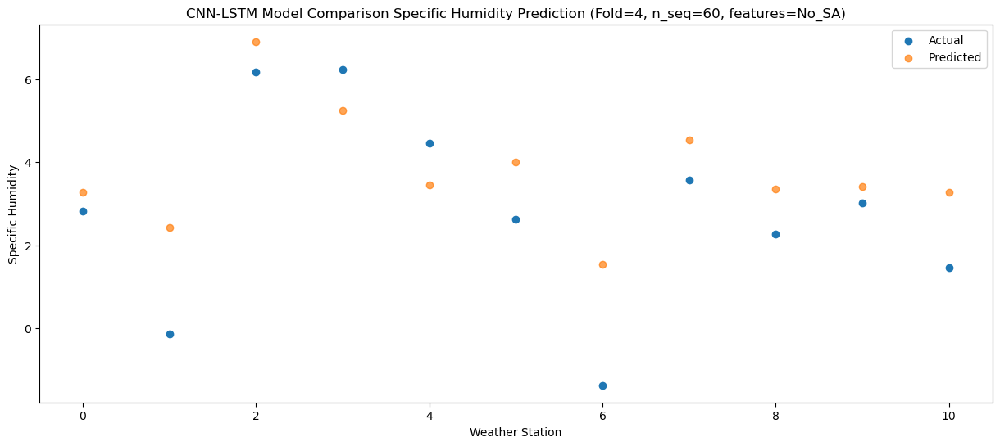

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.70   7.680749
1                 1    2.24   7.069754
2                 2   10.78  11.580140
3                 3   10.22   9.719232
4                 4    8.34   7.896602
5                 5    4.89   7.805213
6                 6    2.63   6.166741
7                 7    8.29   9.013118
8                 8    6.29   7.754775
9                 9    7.08   7.814775
10               10    4.91   7.674775


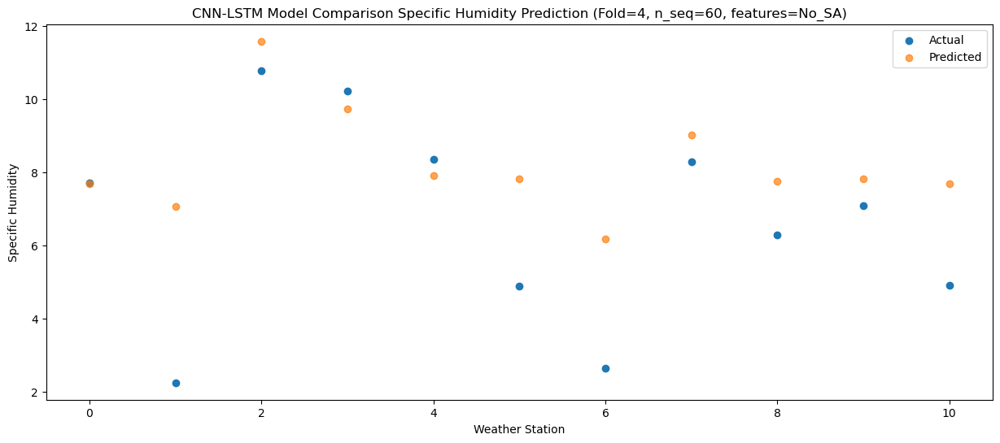

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.93   9.985392
1                 1    5.14   9.366566
2                 2   13.16  13.876149
3                 3   11.99  12.022287
4                 4   10.02  10.199696
5                 5    7.74  10.166259
6                 6    4.91   8.463895
7                 7   10.65  11.315399
8                 8    7.73  10.059470
9                 9    9.32  10.119470
10               10    6.82   9.979470


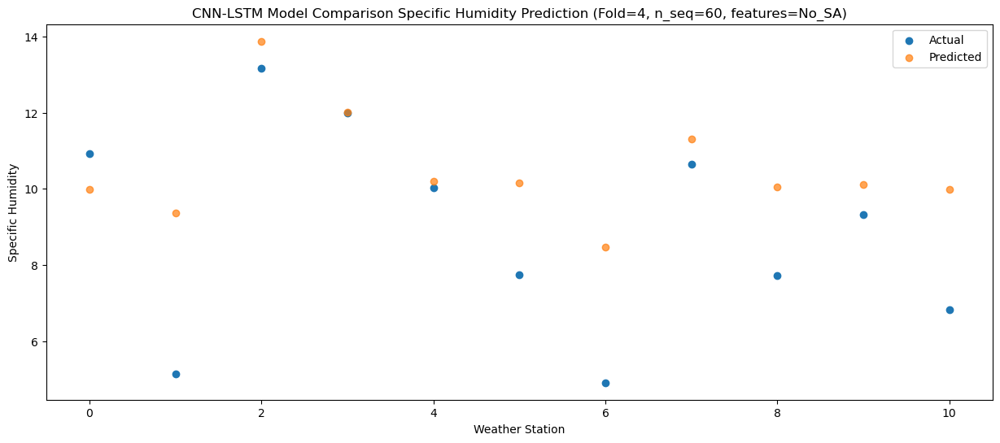

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.56  11.870251
1                 1    6.17  11.359774
2                 2   15.00  15.883303
3                 3   11.41  13.936276
4                 4    9.52  12.100359
5                 5    8.43  11.891326
6                 6    8.07  10.453574
7                 7   11.45  13.234575
8                 8   10.47  11.944231
9                 9   11.96  12.004231
10               10    8.55  11.864231


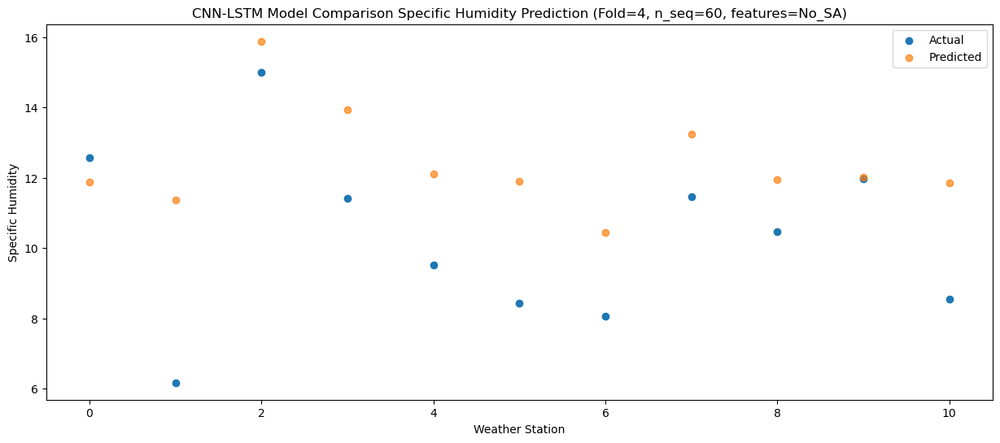

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.35  11.534640
1                 1    6.25  10.617141
2                 2   14.82  15.087656
3                 3   12.42  13.493714
4                 4   10.69  11.706952
5                 5   10.42  11.693819
6                 6    6.88   9.725387
7                 7   11.92  12.772305
8                 8   10.11  11.608589
9                 9   11.19  11.668589
10               10    9.01  11.528589


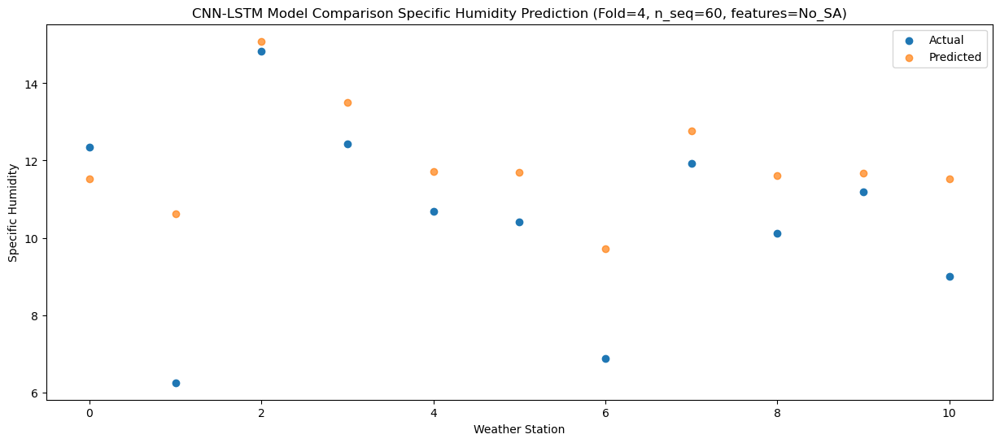

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.65   8.519116
1                 1    5.38   7.375570
2                 2   10.58  11.817842
3                 3    9.14  10.417678
4                 4    7.54   8.658278
5                 5    9.17   9.068050
6                 6    3.33   6.491917
7                 7    8.11   9.685198
8                 8    7.45   8.592534
9                 9    7.82   8.652534
10               10    7.02   8.512534


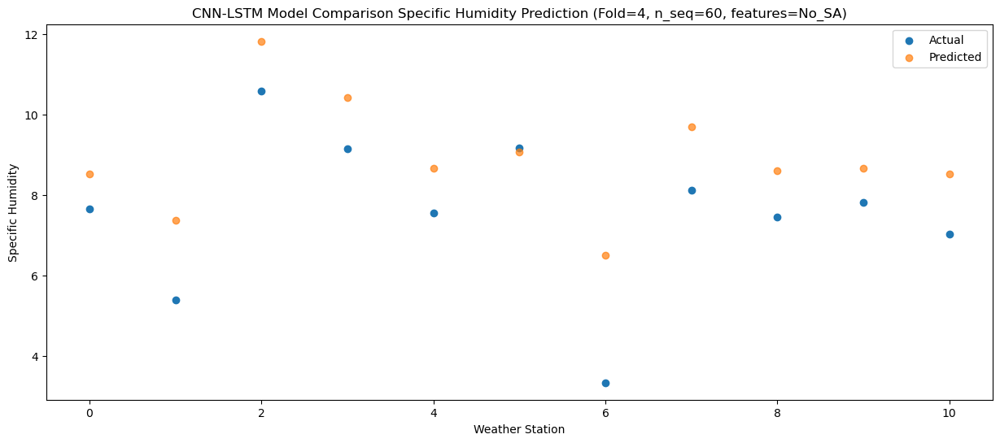

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.06   3.908369
1                 1    0.60   2.511517
2                 2    5.62   6.921867
3                 3    4.68   5.738355
4                 4    3.08   4.009001
5                 5    5.66   5.026943
6                 6   -1.35   1.636388
7                 7    3.45   4.993513
8                 8    2.12   3.981191
9                 9    3.06   4.041191
10               10    2.20   3.901191


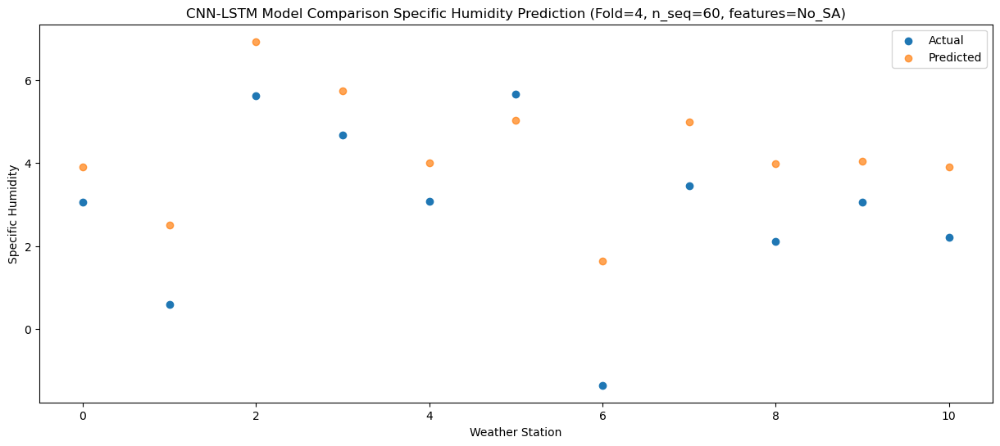

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.89   3.037899
1                 1    0.77   1.970146
2                 2    4.87   6.422502
3                 3    4.50   4.955638
4                 4    2.66   3.186838
5                 5    2.96   3.801301
6                 6   -1.53   1.083647
7                 7    2.09   4.226680
8                 8    1.08   3.110646
9                 9    1.69   3.170646
10               10    1.48   3.030646


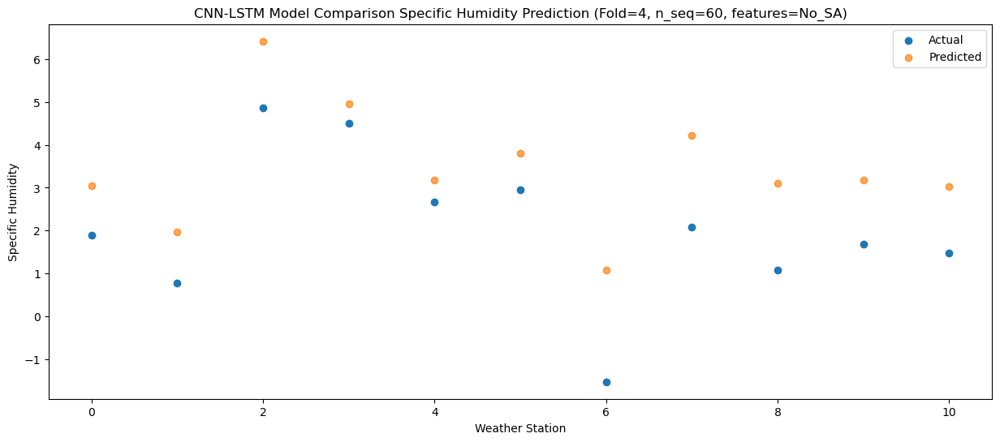

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.55   1.718378
1                 1   -2.75   0.574891
2                 2    4.33   5.017790
3                 3    2.92   3.615519
4                 4    1.07   1.855383
5                 5    2.32   2.855963
6                 6   -3.52  -0.309187
7                 7    1.22   2.882661
8                 8    0.12   1.791081
9                 9    0.58   1.851081
10               10    0.03   1.711081


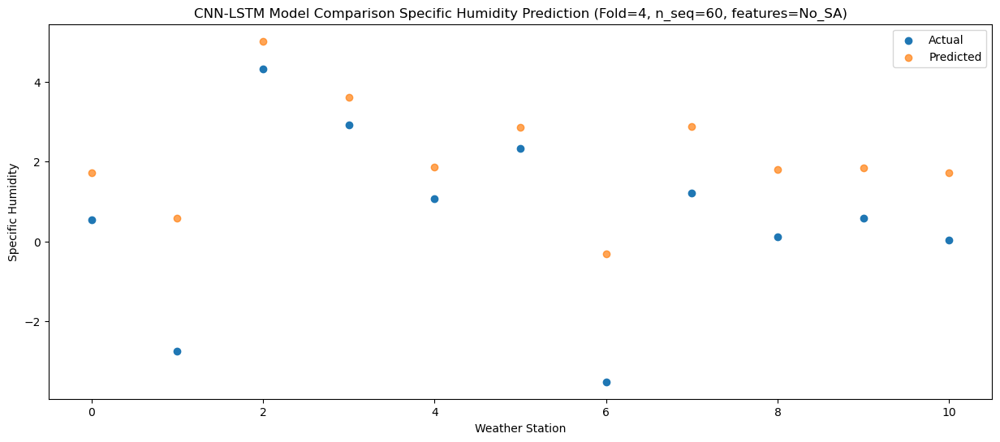

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.90   2.082555
1                 1   -3.26   0.926708
2                 2    4.23   5.367888
3                 3    2.23   3.977113
4                 4    0.32   2.218243
5                 5    0.77   3.169262
6                 6   -2.89   0.043199
7                 7    1.50   3.243362
8                 8    0.74   2.154850
9                 9    1.10   2.214850
10               10    0.65   2.074850


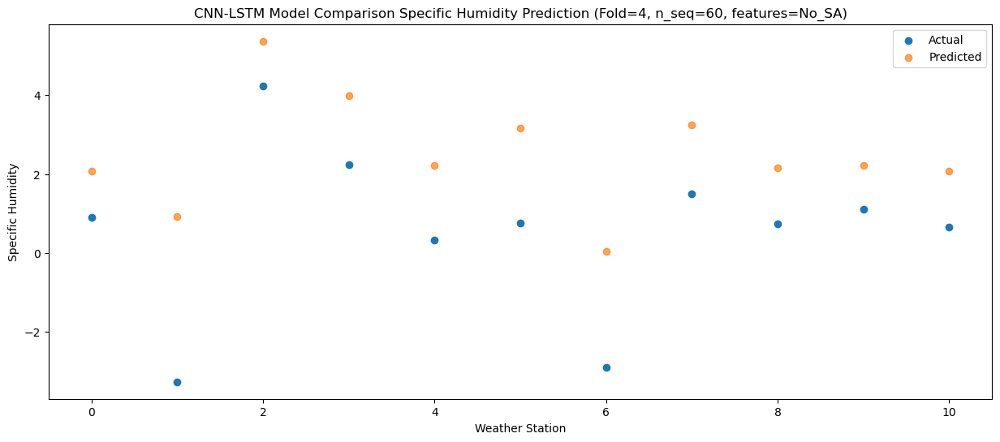

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.768412
1                 1   -1.32   1.118671
2                 2    4.90   5.625324
3                 3    2.59   3.797645
4                 4    0.72   1.977010
5                 5    0.89   2.778595
6                 6   -1.85   0.217520
7                 7    1.31   3.088322
8                 8    0.34   1.841702
9                 9    0.87   1.901702
10               10   -0.10   1.761702


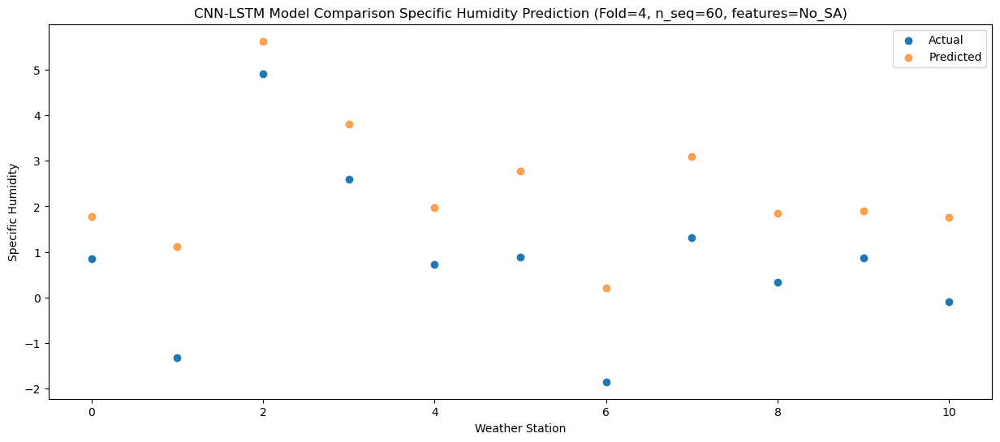

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.69   2.427625
1                 1   -0.94   1.622574
2                 2    5.23   6.108845
3                 3    4.65   4.415769
4                 4    2.69   2.614106
5                 5    2.18   3.572825
6                 6   -2.36   0.726858
7                 7    2.07   3.698902
8                 8    0.69   2.499993
9                 9    1.48   2.559993
10               10    0.11   2.419993


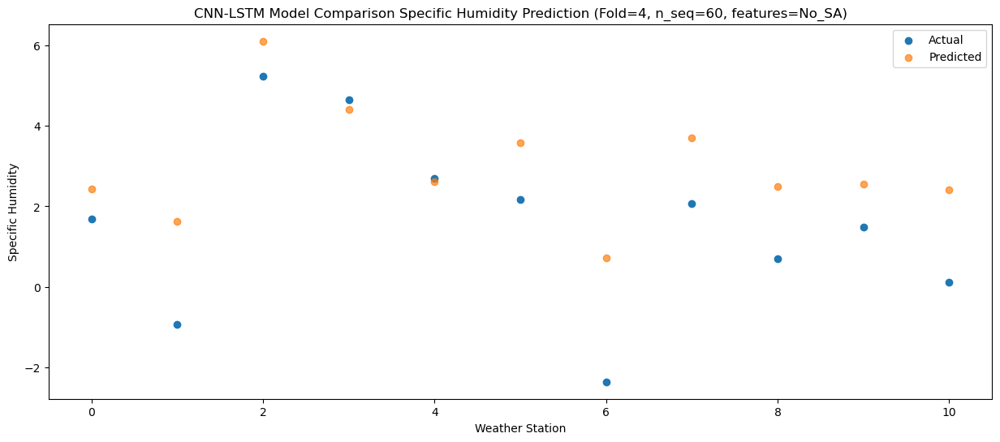

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.87   3.867420
1                 1    0.55   2.997939
2                 2    6.07   7.475281
3                 3    5.33   5.839066
4                 4    3.54   4.044169
5                 5    2.15   4.775131
6                 6   -0.76   2.104602
7                 7    2.97   5.118977
8                 8    2.14   3.939245
9                 9    2.99   3.999245
10               10    1.81   3.859245


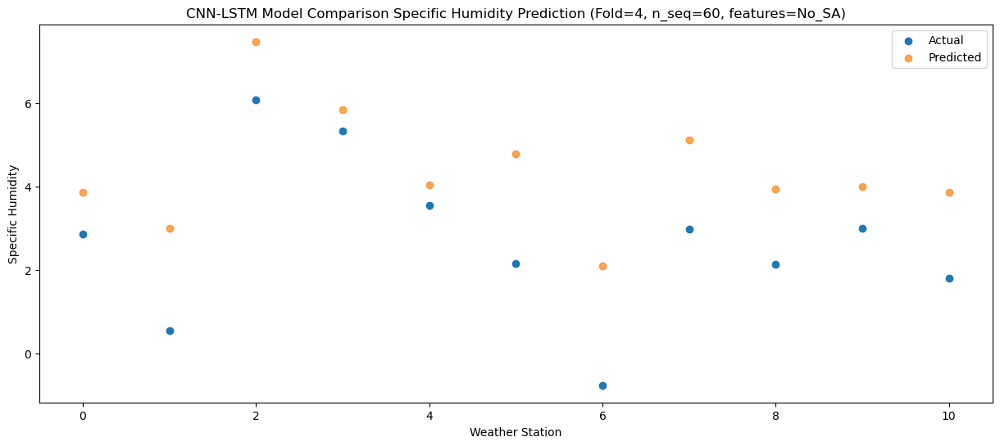

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.89   7.232739
1                 1    1.35   6.617652
2                 2    9.45  11.128518
3                 3    9.59   9.271000
4                 4    7.81   7.445905
5                 5    6.99   8.235427
6                 6    1.46   5.715471
7                 7    7.36   8.563470
8                 8    4.39   7.304760
9                 9    5.77   7.364760
10               10    2.71   7.224760


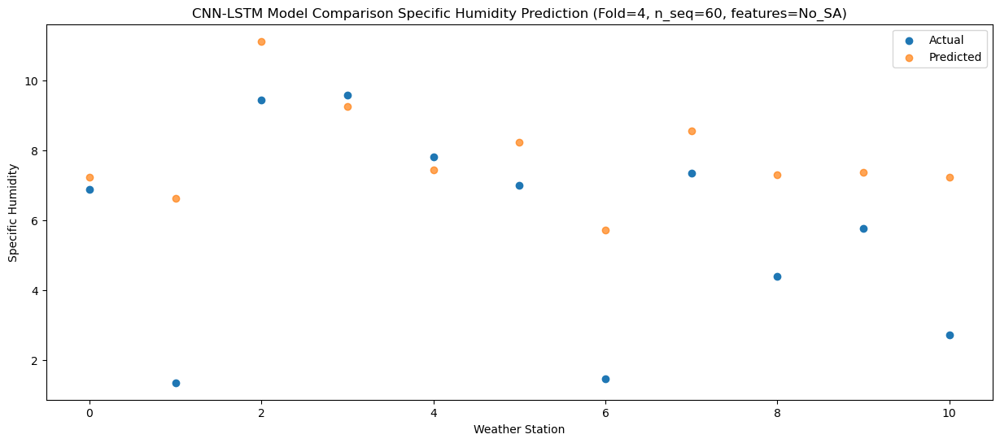

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.43  10.038391
1                 1    4.86   9.322172
2                 2   13.02  13.818683
3                 3   13.53  12.052147
4                 4   11.29  10.239860
5                 5   10.85  10.599521
6                 6    4.51   8.423991
7                 7    9.92  11.339894
8                 8    6.35  10.111023
9                 9    7.41  10.171023
10               10    5.95  10.031023


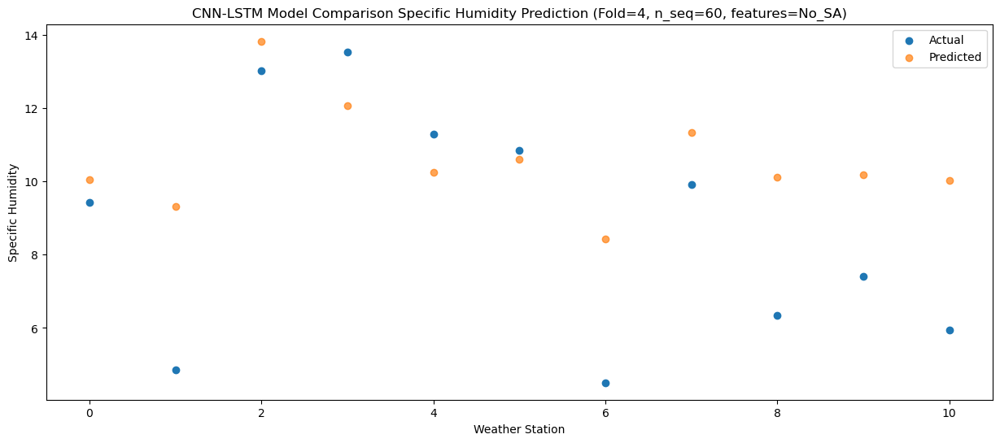

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.12  13.158991
1                 1    6.77  12.310620
2                 2   14.61  16.788351
3                 3   13.38  15.140376
4                 4   10.39  13.343802
5                 5    8.52  13.256372
6                 6    7.90  11.417365
7                 7   12.71  14.421716
8                 8   10.65  13.232098
9                 9   12.11  13.292098
10               10    9.57  13.152098


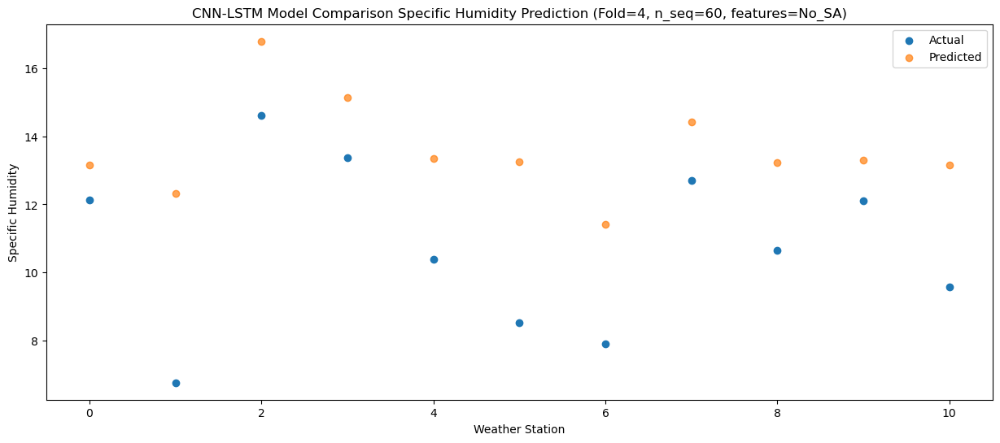

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.05  12.421466
1                 1    7.07  11.830013
2                 2   13.03  16.341610
3                 3   11.28  14.469409
4                 4    9.01  12.642282
5                 5    7.66  12.864490
6                 6    7.44  10.927438
7                 7   12.99  13.763233
8                 8   10.11  12.494550
9                 9   11.98  12.554550
10               10    8.77  12.414550


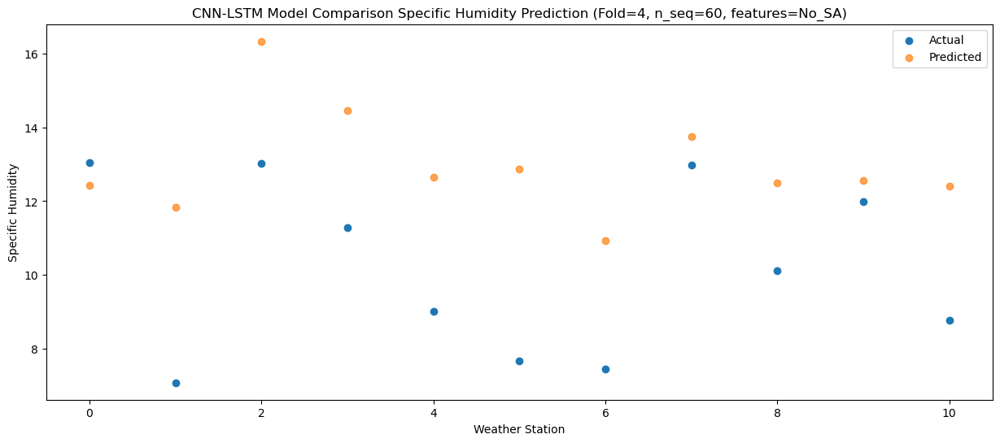

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.13   9.794832
1                 1    4.62   8.744779
2                 2   10.01  13.196610
3                 3   10.38  11.721674
4                 4    8.68   9.950116
5                 5    8.17  10.469745
6                 6    3.99   7.858362
7                 7    8.79  10.993370
8                 8    7.31   9.867571
9                 9    8.20   9.927571
10               10    7.06   9.787571


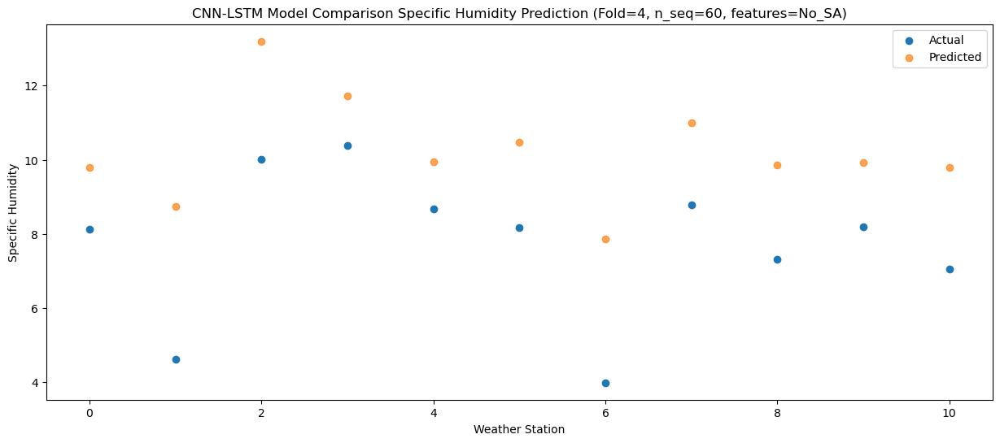

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.94   6.214571
1                 1    1.00   4.819170
2                 2    6.08   9.226614
3                 3    6.66   8.049649
4                 4    5.02   6.319987
5                 5    6.04   7.215437
6                 6    0.08   3.944858
7                 7    5.18   7.304486
8                 8    3.98   6.286629
9                 9    4.76   6.346629
10               10    4.00   6.206629


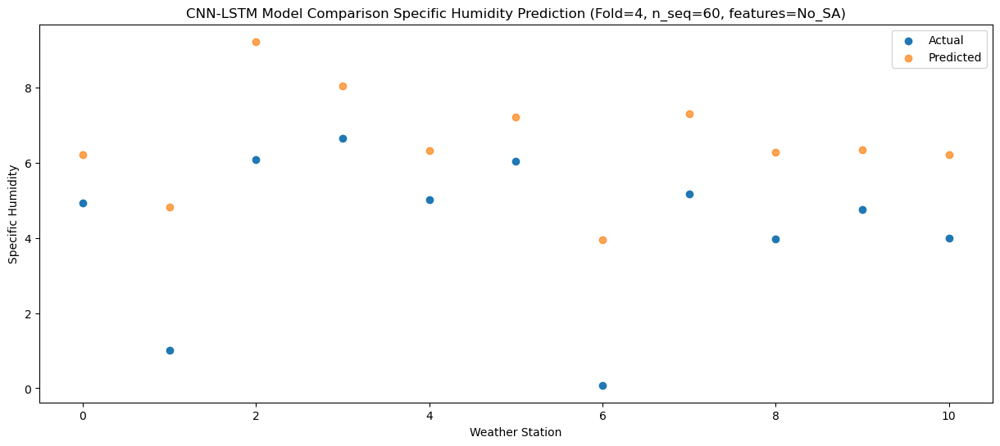

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.04   3.150512
1                 1   -1.30   1.868991
2                 2    4.10   6.291952
3                 3    4.13   5.015380
4                 4    2.60   3.271084
5                 5    3.74   4.448941
6                 6   -2.87   0.990575
7                 7    2.15   4.275159
8                 8    0.91   3.222633
9                 9    1.37   3.282633
10               10    0.56   3.142633


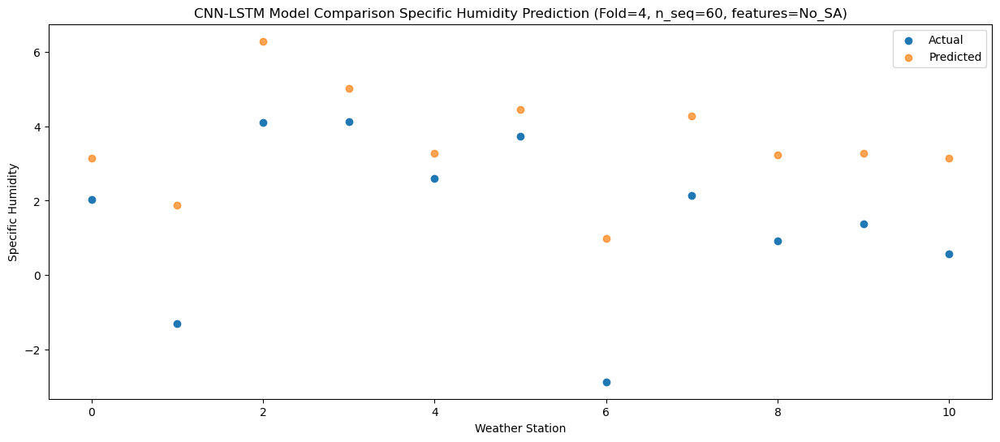

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    1.86   2.960305
1                 1   -2.39   1.334408
2                 2    2.79   5.712344
3                 3    2.38   4.734896
4                 4    0.84   3.031939
5                 5    2.16   4.295719
6                 6   -3.15   0.468241
7                 7    1.34   3.978008
8                 8    0.88   3.032688
9                 9    1.86   3.092688
10               10    1.08   2.952688


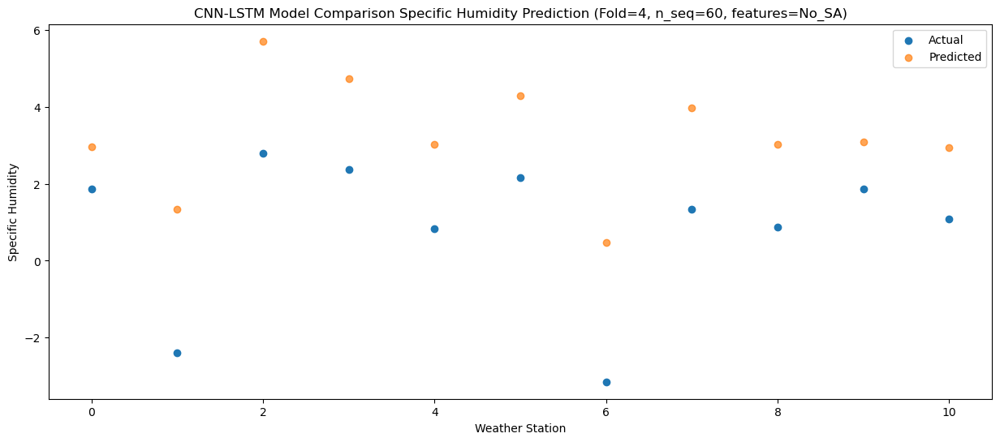

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    0.16   1.980362
1                 1   -3.43   0.513874
2                 2    2.07   4.912533
3                 3    1.10   3.796360
4                 4   -0.58   2.073751
5                 5    0.89   3.507131
6                 6   -3.93  -0.358011
7                 7    0.19   3.047240
8                 8   -0.20   2.052252
9                 9    0.40   2.112252
10               10    0.01   1.972252


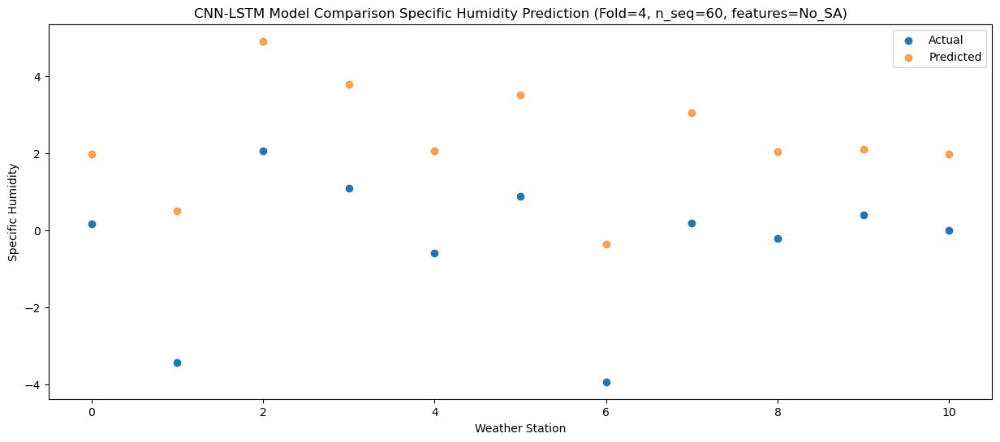

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.17   2.876071
1                 1   -4.12   1.518085
2                 2    3.50   5.930341
3                 3    3.44   4.721846
4                 4    1.77   2.986252
5                 5    1.24   4.370535
6                 6   -3.75   0.642650
7                 7    1.55   3.978164
8                 8    0.38   2.948473
9                 9    1.32   3.008473
10               10    0.03   2.868473


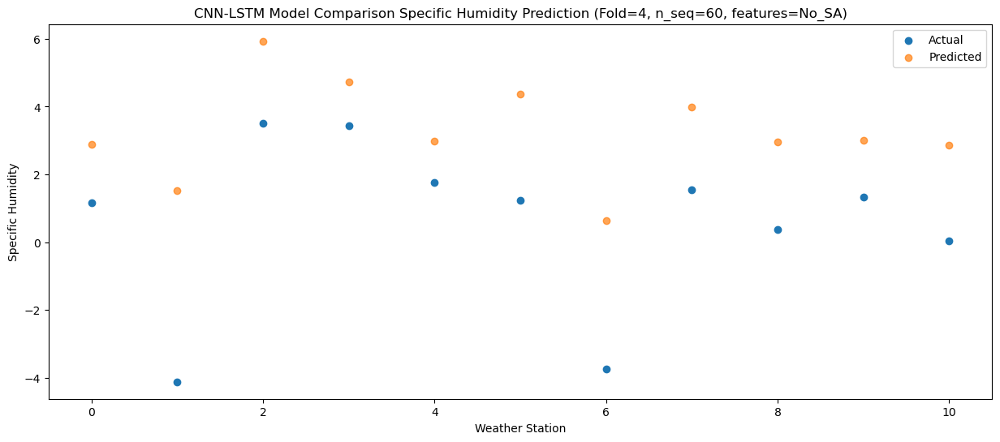

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.23   3.994244
1                 1   -0.83   2.894639
2                 2    5.13   7.339632
3                 3    5.23   5.908635
4                 4    3.72   4.141928
5                 5    2.38   5.271816
6                 6   -2.18   2.010237
7                 7    2.76   5.177782
8                 8    1.45   4.066334
9                 9    2.29   4.126334
10               10    1.10   3.986334


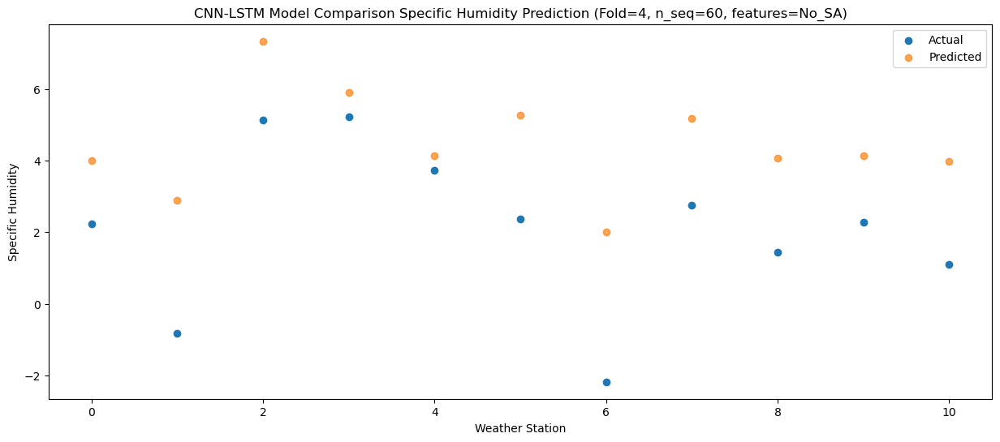

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   5.912307
1                 1   -1.43   4.923424
2                 2    7.31   9.382061
3                 3    7.60   7.856705
4                 4    6.22   6.076806
5                 5    2.98   6.924392
6                 6   -0.26   4.035457
7                 7    4.49   7.131239
8                 8    3.48   5.984109
9                 9    4.01   6.044109
10               10    2.88   5.904109


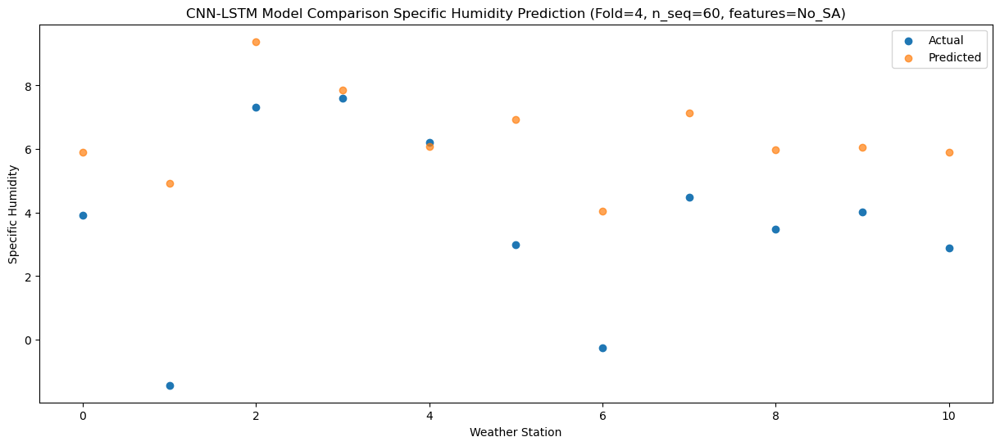

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    7.98   9.798336
1                 1    1.16   9.123177
2                 2   11.63  13.621576
3                 3   11.17  11.826853
4                 4    9.65  10.009385
5                 5    5.74  10.354553
6                 6    3.74   8.224351
7                 7    8.91  11.116641
8                 8    6.97   9.870622
9                 9    7.55   9.930622
10               10    5.80   9.790622


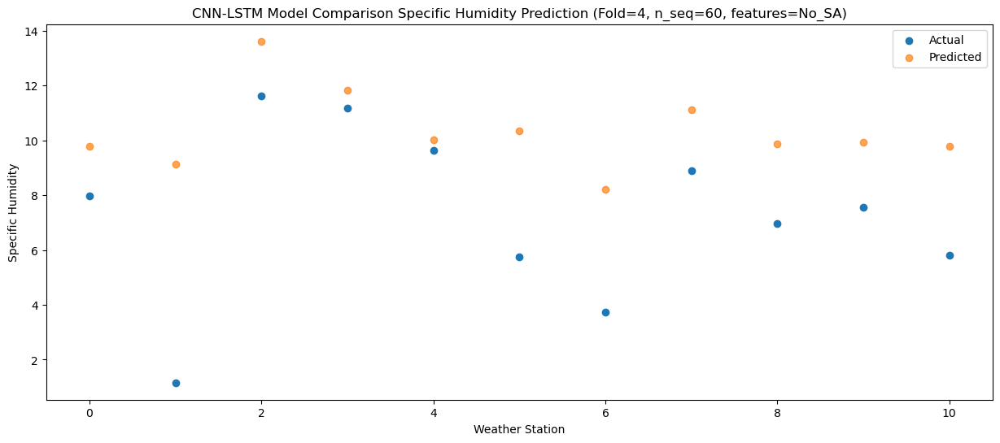

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.24  12.460169
1                 1    2.62  11.402235
2                 2   12.97  15.850616
3                 3   13.11  14.388018
4                 4   11.76  12.616734
5                 5   10.27  12.957542
6                 6    5.50  10.517060
7                 7   10.89  13.659362
8                 8    8.66  12.531860
9                 9   10.31  12.591860
10               10    8.35  12.451860


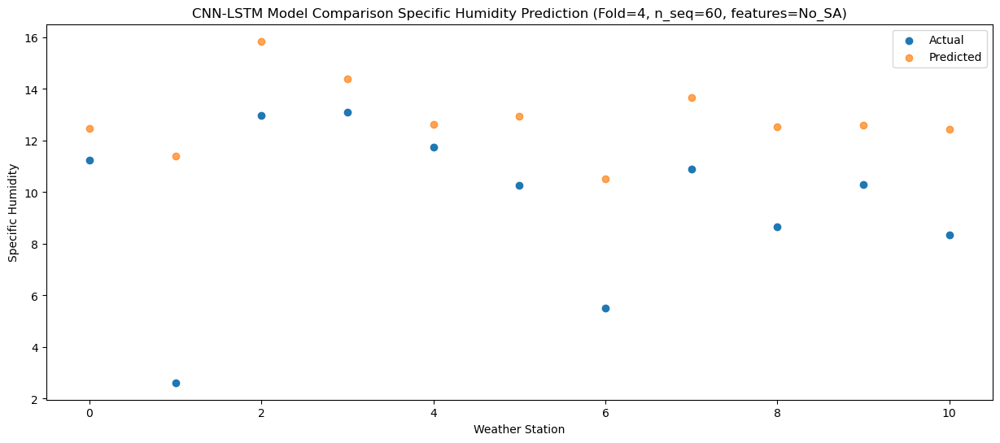

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.43  13.287004
1                 1    4.08  12.428791
2                 2   15.00  16.902582
3                 3   13.07  15.268088
4                 4   11.29  13.473008
5                 5   10.15  13.690694
6                 6    7.89  11.536496
7                 7   11.87  14.549077
8                 8    9.96  13.359207
9                 9   11.92  13.419207
10               10    9.47  13.279207


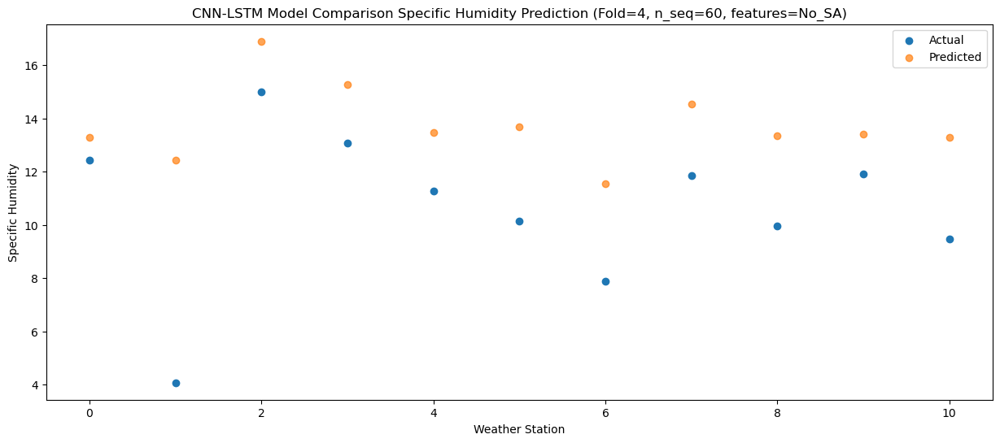

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   11.27  12.774541
1                 1    6.69  11.629272
2                 2   12.69  16.065239
3                 3   12.36  14.680150
4                 4   10.52  12.919258
5                 5    8.95  13.315645
6                 6    7.15  10.747102
7                 7   10.58  13.947367
8                 8    9.60  12.846718
9                 9   11.56  12.906718
10               10    9.45  12.766718


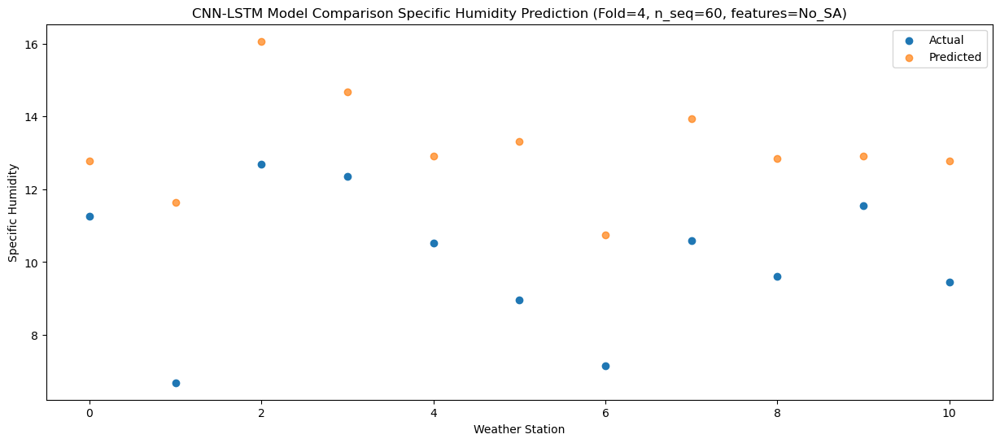

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.97   9.896802
1                 1    6.50   9.080150
2                 2   11.59  13.559197
3                 3    9.83  11.888145
4                 4    8.36  10.087719
5                 5    8.07  10.718251
6                 6    4.83   8.186252
7                 7    8.54  11.171425
8                 8    6.92   9.969132
9                 9    8.06  10.029132
10               10    7.38   9.889132


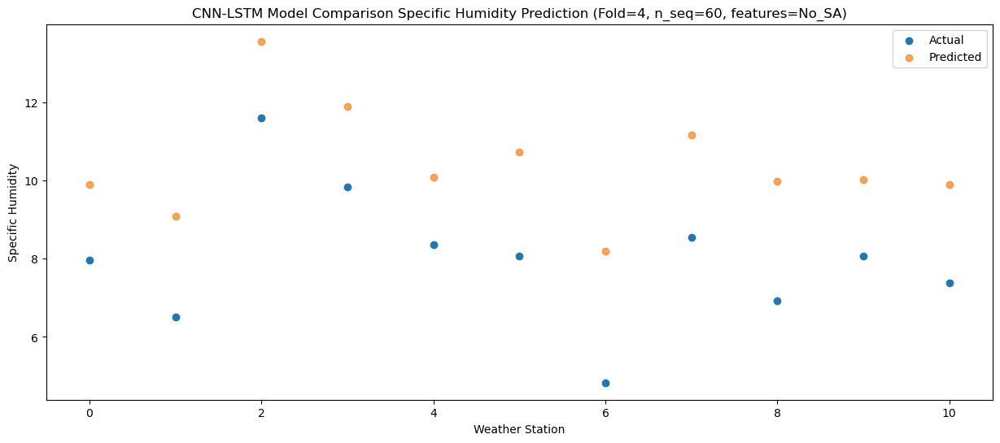

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.84   6.086462
1                 1    2.08   4.969573
2                 2    6.80   9.410205
3                 3    6.37   7.997461
4                 4    4.62   6.233304
5                 5    4.38   7.339686
6                 6    0.43   4.085963
7                 7    4.22   7.266064
8                 8    3.34   6.158016
9                 9    3.96   6.218016
10               10    3.27   6.078016


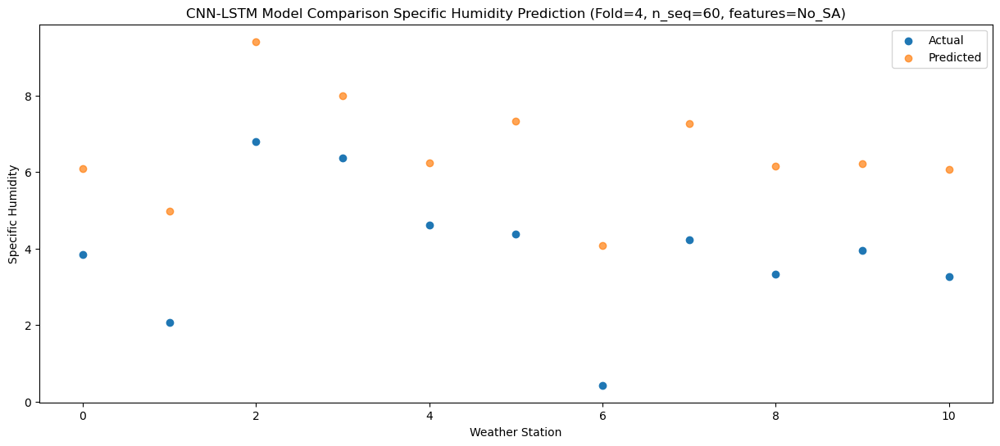

f, t:
[[ 9.500e-01 -1.880e+00  2.900e+00  3.200e+00  1.290e+00  2.630e+00
  -2.970e+00  1.810e+00  4.000e-01  9.500e-01  1.500e-01]
 [ 8.800e-01 -1.740e+00  3.740e+00  2.200e+00  3.200e-01  1.390e+00
  -2.900e+00  1.540e+00  5.700e-01  1.120e+00  3.000e-01]
 [ 4.600e-01 -3.300e+00  3.600e+00  2.840e+00  1.010e+00  1.270e+00
  -3.060e+00  1.300e+00  2.000e-01  6.400e-01 -4.000e-02]
 [ 2.800e-01 -2.460e+00  3.410e+00  2.220e+00  3.500e-01  1.150e+00
  -2.480e+00  1.070e+00 -2.000e-01  3.700e-01 -3.900e-01]
 [ 2.510e+00 -1.080e+00  6.960e+00  6.170e+00  4.250e+00  3.950e+00
  -2.900e-01  3.620e+00  1.720e+00  2.420e+00  1.180e+00]
 [ 3.100e+00  1.300e-01  5.840e+00  5.770e+00  3.740e+00  3.200e+00
  -9.600e-01  3.940e+00  2.000e+00  3.010e+00  1.020e+00]
 [ 6.310e+00  7.800e-01  8.080e+00  8.930e+00  6.980e+00  5.470e+00
   2.160e+00  7.320e+00  5.150e+00  6.730e+00  3.640e+00]
 [ 1.096e+01  4.110e+00  1.138e+01  1.109e+01  8.960e+00  7.180e+00
   5.990e+00  1.093e+01  7.890e+00  9.210e+0

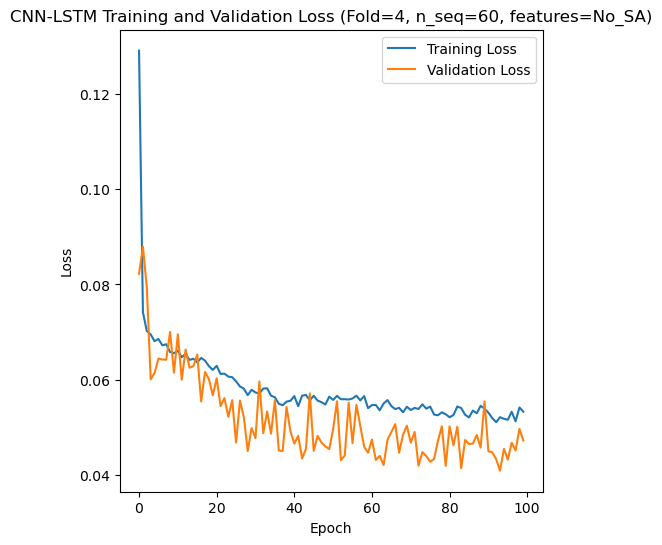

[[1.2079553519175674], [1.4393910069172116], [1.6113877021370373], [3.5368719364150922], [2.085824869751289]]
[[array(1.20795535)], [array(1.43939101)], [array(1.6113877)], [array(3.53687194)], [array(2.08582487)]]
[[0.9719036987681291], [1.120763203533367], [1.2378591828997512], [3.0300682113581883], [1.6284859240693188]]
[[1.2050047620475608], [0.8253176206906405], [1.0360811440141713], [2.117407748844326], [1.8823599253214898]]
[[0.924392090881364], [0.8953007619501727], [0.8598980209672633], [0.03455801073989129], [0.7839067465998263]]
[[array(0.24456186)], [array(0.44521718)], [array(0.26367769)], [array(0.15768891)], [array(1.26390153)]]
[[array(0.95838016)], [array(0.92646828)], [array(0.91012441)], [array(0.72602434)], [array(0.89139518)]]
[0.03 0.46 0.37 ... 9.45 7.38 3.27]
[-0.69890867 -1.43650471 -1.10923423 ... 12.76671806  9.88913218
  6.07801596]
Accuracy Results:
RMSE for each fold:
[[1.2079553519175674], [1.4393910069172116], [1.6113877021370373], [3.5368719364150922], 

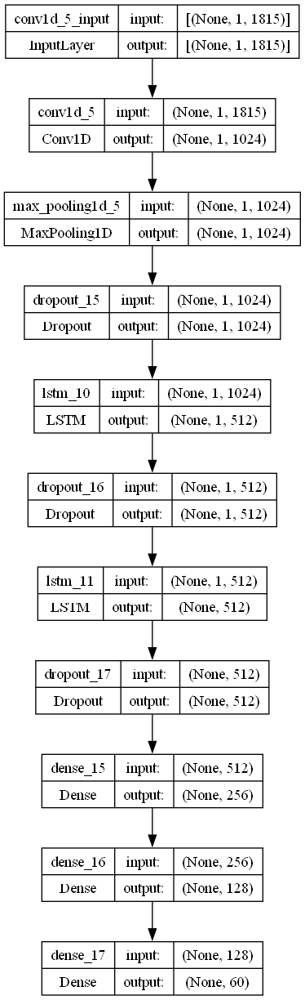

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.29999887991116414
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.36944959061462074

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))
print("")
print("Average Specific Humidity:"+str(np.mean(actual_avg_list)))
print("RMSE % of Specific Humidity:"+str(np.mean(rmse2_avg_list)/np.mean(actual_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_SH_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)